# Libraries

In [1]:
import numpy as np
import pandas as pd
import tensorflow as tf
import matplotlib.pyplot as plt
from google.colab import drive
from tensorflow import keras
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_absolute_error, r2_score, mean_squared_error

In [2]:
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
tf.random.set_seed(42)
np.random.seed(42)

# Dataframe

In [4]:
df = pd.read_csv("/content/drive/MyDrive/Colab Notebooks/Tesi/Agrimonia_scaled_Bertonico.csv")
pd.set_option('display.max_columns', None)

df.head()

,Unnamed: 0,AQ_pm10,AQ_nh3,AQ_nox,AQ_no2,WE_temp_2m,WE_wind_speed_10m_mean,WE_wind_speed_10m_max,WE_tot_precipitation,WE_precipitation_t,WE_surface_pressure,WE_solar_radiation,WE_rh_min,WE_rh_mean,WE_rh_max,WE_wind_speed_100m_mean,WE_wind_speed_100m_max,WE_blh_layer_max,WE_blh_layer_min,EM_nh3_livestock_mm,EM_nh3_agr_soils,EM_nh3_agr_waste_burn,EM_nh3_sum,EM_nox_traffic,EM_nox_sum,EM_so2_sum,LI_pigs,LI_bovine,LI_pigs_v2,LI_bovine_v2,LA_hvi,LA_lvi,LA_land_use,LA_soil_use,wind_dir_10m_N,wind_dir_100m_N,wind_dir_10m_S,wind_dir_100m_S,wind_dir_10m_E,wind_dir_100m_E,wind_dir_10m_O,wind_dir_100m_O,wind_dir_10m_NE,wind_dir_100m_NE,wind_dir_10m_NO,wind_dir_100m_NO,wind_dir_10m_SO,wind_dir_100m_SO,wind_dir_10m_SE,wind_dir_100m_SE
0,4384,0.361111,0.187541,0.169904,0.282810,0.133232,0.085441,0.112459,0.000011,0.000000,0.710983,0.209027,0.669497,0.840646,0.971037,0.060817,0.074656,0.061210,0.005039,0.003703,0.005021,0.314432,0.004290,0.505559,0.690451,0.892958,0.483245,1.000000,0.000000,0.384937,0.001179,0.003807,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
1,4385,0.270833,0.072131,0.135456,0.302741,0.096618,0.170360,0.175662,0.214557,0.166667,0.556840,0.016265,0.923586,0.964518,0.989766,0.176173,0.193587,0.037907,0.051926,0.004526,0.005889,0.304480,0.005208,0.507314,0.686191,0.890141,0.486185,0.989011,0.007823,0.380753,0.001179,0.003807,0.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,4386,0.180556,0.049836,0.127760,0.293174,0.136445,0.267975,0.301458,0.040182,0.166667,0.383430,0.122342,0.840430,0.921590,0.989959,0.293446,0.352442,0.062212,0.141779,0.005226,0.006711,0.293849,0.006062,0.509070,0.682286,0.887655,0.489124,0.989011,0.014342,0.376569,0.001179,0.003807,0.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,4387,0.201389,0.047213,0.108386,0.222380,0.125409,0.143309,0.300480,0.058296,0.166667,0.200385,0.057699,0.845923,0.897988,0.983588,0.172888,0.343952,0.059602,0.017870,0.005925,0.007491,0.282766,0.006851,0.510825,0.678026,0.885501,0.492063,0.978022,0.020860,0.376569,0.001179,0.002538,0.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,4388,0.236111,0.075410,0.162633,0.273722,0.115206,0.098820,0.099011,0.018412,0.166667,0.211946,0.043669,0.894743,0.960558,0.986098,0.120138,0.130859,0.029551,0.022666,0.006542,0.008234,0.271230,0.007577,0.511995,0.673766,0.883513,0.495003,0.967033,0.028683,0.372385,0.001179,0.002538,0.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [5]:
#df['IDStations'] = df['IDStations'].astype(float)
df['AQ_pm10'] = df['AQ_pm10'].astype(float)
df['AQ_nh3'] = df['AQ_nh3'].astype(float)
df['AQ_nox'] = df['AQ_nox'].astype(float)
df['AQ_no2'] = df['AQ_no2'].astype(float)

df['EM_nh3_livestock_mm'] = df['EM_nh3_livestock_mm'].astype(float)
df['EM_nh3_agr_soils'] = df['EM_nh3_agr_soils'].astype(float)
df['EM_nh3_agr_waste_burn'] = df['EM_nh3_agr_waste_burn'].astype(float)
df['EM_nh3_sum'] = df['EM_nh3_sum'].astype(float)
df['EM_nox_traffic'] = df['EM_nox_traffic'].astype(float)
df['EM_nox_sum'] = df['EM_nox_sum'].astype(float)
df['EM_so2_sum'] = df['EM_so2_sum'].astype(float)
df['LI_pigs'] = df['LI_pigs'].astype(float)
df['LI_bovine'] = df['LI_bovine'].astype(float)

In [6]:
df.dropna(inplace=True)
df

,Unnamed: 0,AQ_pm10,AQ_nh3,AQ_nox,AQ_no2,WE_temp_2m,WE_wind_speed_10m_mean,WE_wind_speed_10m_max,WE_tot_precipitation,WE_precipitation_t,WE_surface_pressure,WE_solar_radiation,WE_rh_min,WE_rh_mean,WE_rh_max,WE_wind_speed_100m_mean,WE_wind_speed_100m_max,WE_blh_layer_max,WE_blh_layer_min,EM_nh3_livestock_mm,EM_nh3_agr_soils,EM_nh3_agr_waste_burn,EM_nh3_sum,EM_nox_traffic,EM_nox_sum,EM_so2_sum,LI_pigs,LI_bovine,LI_pigs_v2,LI_bovine_v2,LA_hvi,LA_lvi,LA_land_use,LA_soil_use,wind_dir_10m_N,wind_dir_100m_N,wind_dir_10m_S,wind_dir_100m_S,wind_dir_10m_E,wind_dir_100m_E,wind_dir_10m_O,wind_dir_100m_O,wind_dir_10m_NE,wind_dir_100m_NE,wind_dir_10m_NO,wind_dir_100m_NO,wind_dir_10m_SO,wind_dir_100m_SO,wind_dir_10m_SE,wind_dir_100m_SE
0,4384,0.361111,0.187541,0.169904,0.282810,0.133232,0.085441,0.112459,0.000011,0.000000,0.710983,0.209027,0.669497,0.840646,0.971037,0.060817,0.074656,0.061210,0.005039,0.003703,0.005021,0.314432,0.004290,0.505559,0.690451,0.892958,0.483245,1.000000,0.000000,0.384937,0.001179,0.003807,0.0,1.000000,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
1,4385,0.270833,0.072131,0.135456,0.302741,0.096618,0.170360,0.175662,0.214557,0.166667,0.556840,0.016265,0.923586,0.964518,0.989766,0.176173,0.193587,0.037907,0.051926,0.004526,0.005889,0.304480,0.005208,0.507314,0.686191,0.890141,0.486185,0.989011,0.007823,0.380753,0.001179,0.003807,0.0,1.000000,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,4386,0.180556,0.049836,0.127760,0.293174,0.136445,0.267975,0.301458,0.040182,0.166667,0.383430,0.122342,0.840430,0.921590,0.989959,0.293446,0.352442,0.062212,0.141779,0.005226,0.006711,0.293849,0.006062,0.509070,0.682286,0.887655,0.489124,0.989011,0.014342,0.376569,0.001179,0.003807,0.0,1.000000,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,4387,0.201389,0.047213,0.108386,0.222380,0.125409,0.143309,0.300480,0.058296,0.166667,0.200385,0.057699,0.845923,0.897988,0.983588,0.172888,0.343952,0.059602,0.017870,0.005925,0.007491,0.282766,0.006851,0.510825,0.678026,0.885501,0.492063,0.978022,0.020860,0.376569,0.001179,0.002538,0.0,1.000000,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,4388,0.236111,0.075410,0.162633,0.273722,0.115206,0.098820,0.099011,0.018412,0.166667,0.211946,0.043669,0.894743,0.960558,0.986098,0.120138,0.130859,0.029551,0.022666,0.006542,0.008234,0.271230,0.007577,0.511995,0.673766,0.883513,0.495003,0.967033,0.028683,0.372385,0.001179,0.002538,0.0,1.000000,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1820,6204,0.055556,0.079344,0.165180,0.162747,0.236213,0.154064,0.233120,0.342432,0.166667,0.383430,0.012140,0.884630,0.937272,0.991311,0.169876,0.233792,0.103414,0.048313,0.016171,0.032644,0.358312,0.032485,0.212990,0.492368,0.887490,0.529688,0.175824,0.787484,0.502092,0.001179,0.005076,0.0,0.750171,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1821,6205,0.069444,0.066230,0.077282,0.125915,0.187578,0.115605,0.130552,0.000841,0.000000,0.556840,0.216996,0.529030,0.735466,0.859625,0.125796,0.179624,0.112693,0.007291,0.014155,0.027715,0.351300,0.028003,0.220597,0.494498,0.882519,0.529688,0.175824,0.787484,0.502092,0.001179,0.005076,0.0,0.750171,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1822,6206,0.180556,0.167869,0.139331,0.229555,0.104617,0.116420,0.181653,0.010648,0.000000,0.383430,0.213732,0.492071,0.648345,0.859432,0.192053,0.242633,0.104521,0.027721,0.012056,0.022862,0.344062,0.023307,0.228204,0.496273,0.877713,0.529688,0.175824,0.787484,0.502092,0.001179,0.005076,0.0,0.750171,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1825,6209,0.416667,0.104918,0.407006,0.623547,0.079270,0.258197,0.166493,0.006207,0.166667,0.300578,0.055368,0.930703,0.919531,0.913304,0.191597,0.17141

LSTM networks

In [7]:
# Define the features (independent variables) and the target (dependent variable)
X = df.drop(columns=['AQ_pm10'])
y = df['AQ_pm10']

Number of Epochs: 200
Number of Iterations: 10
8/8 [==============================] - 0s 4ms/step
MAE (Iteration 1): 0.11
R-squared (R2) (Iteration 1): -0.0
RMSE (Iteration 1): 0.14


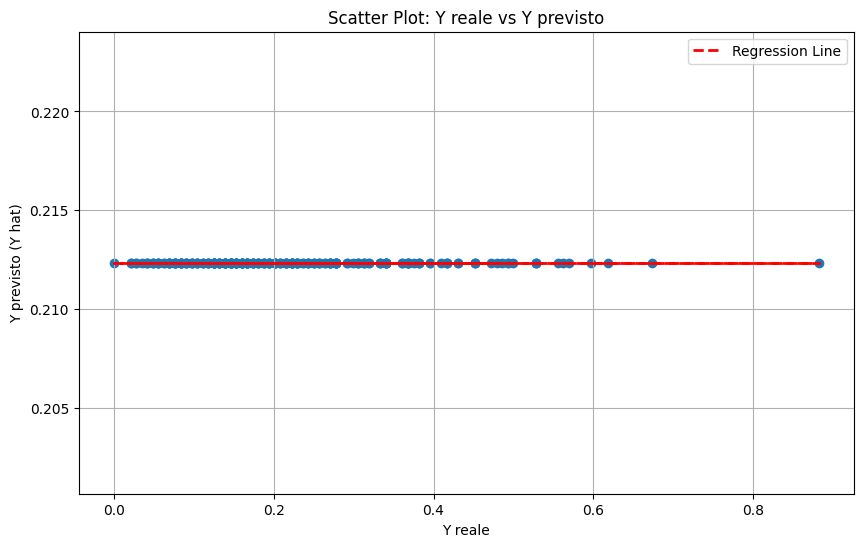

8/8 [==============================] - 0s 3ms/step

Model Completion: 1/144 (0.69%)
Saving data...
8/8 [==============================] - 0s 4ms/step
MAE (Iteration 2): 0.07
R-squared (R2) (Iteration 2): 0.42
RMSE (Iteration 2): 0.11


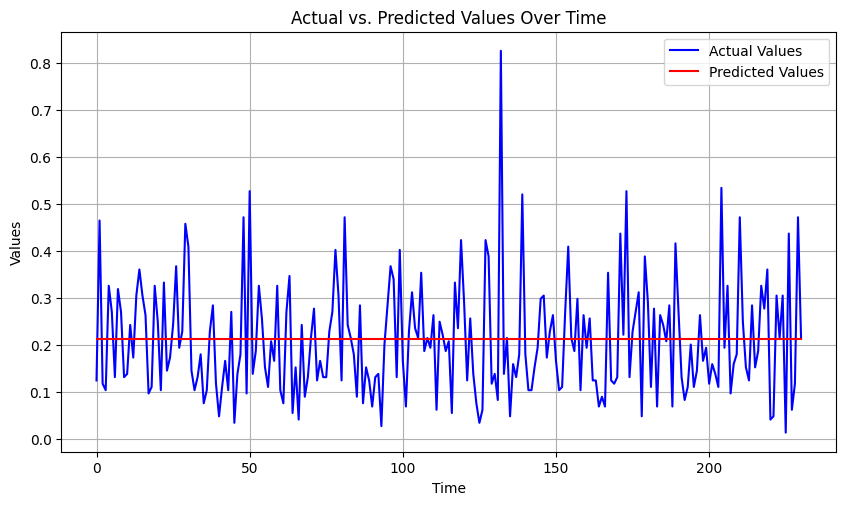

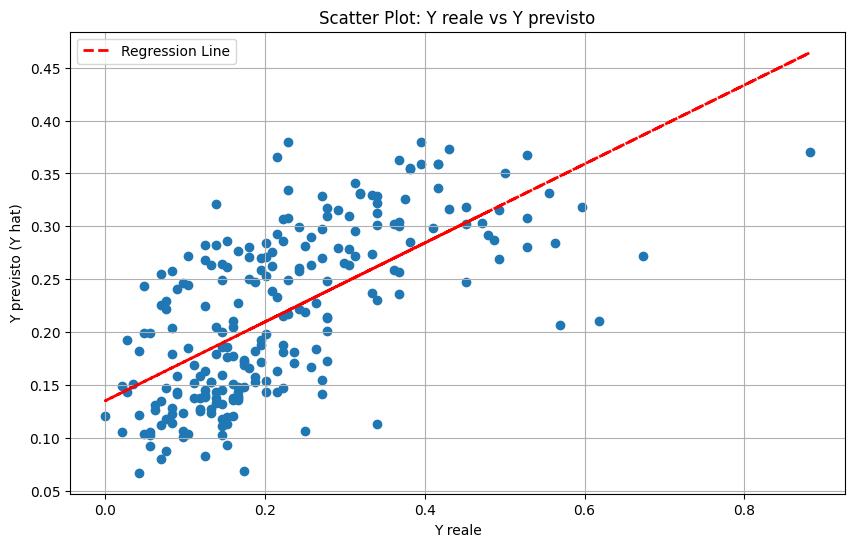

8/8 [==============================] - 0s 6ms/step

Model Completion: 2/144 (1.39%)
Saving data...
8/8 [==============================] - 0s 3ms/step
MAE (Iteration 3): 0.1
R-squared (R2) (Iteration 3): -0.02
RMSE (Iteration 3): 0.14


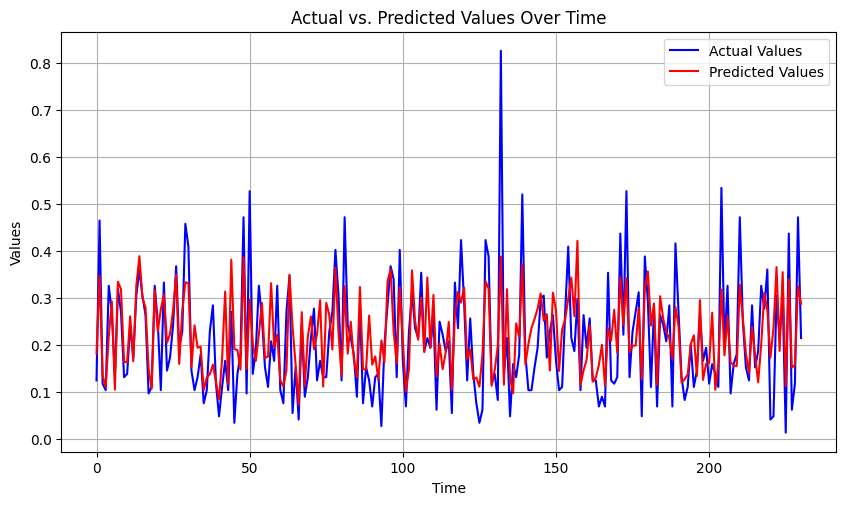

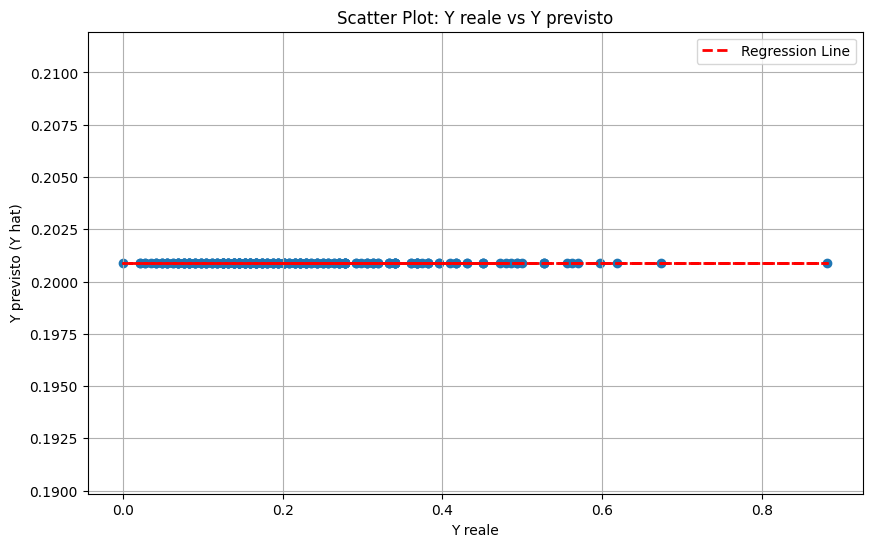

8/8 [==============================] - 0s 3ms/step

Model Completion: 3/144 (2.08%)
Saving data...
8/8 [==============================] - 0s 5ms/step
MAE (Iteration 4): 0.1
R-squared (R2) (Iteration 4): 0.27
RMSE (Iteration 4): 0.12


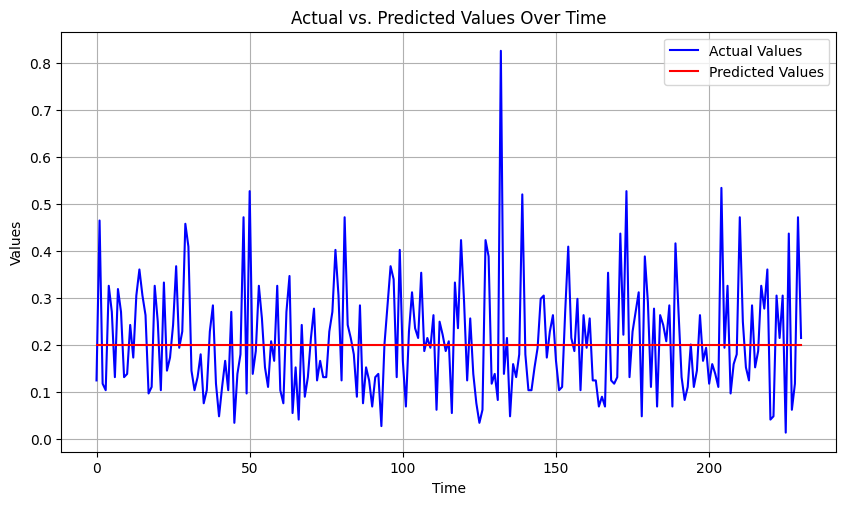

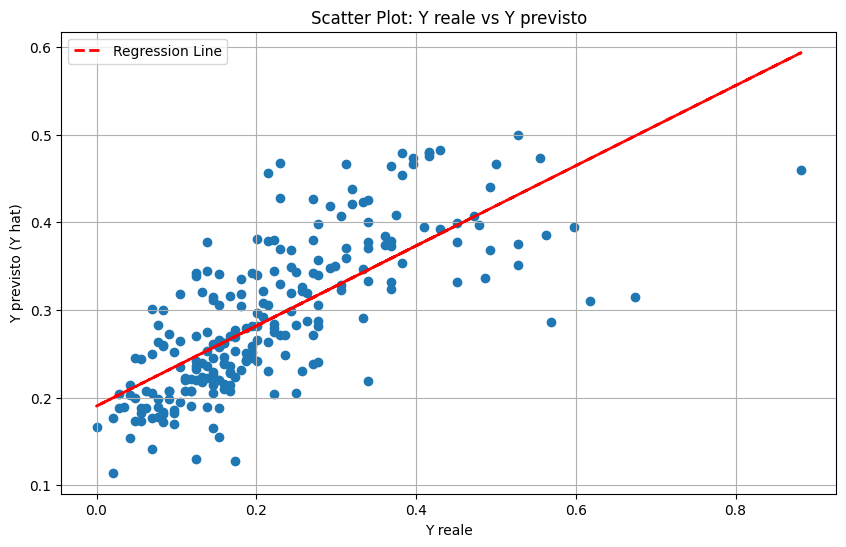

8/8 [==============================] - 0s 3ms/step

Model Completion: 4/144 (2.78%)
Saving data...
8/8 [==============================] - 0s 3ms/step
MAE (Iteration 5): 0.06
R-squared (R2) (Iteration 5): 0.53
RMSE (Iteration 5): 0.1


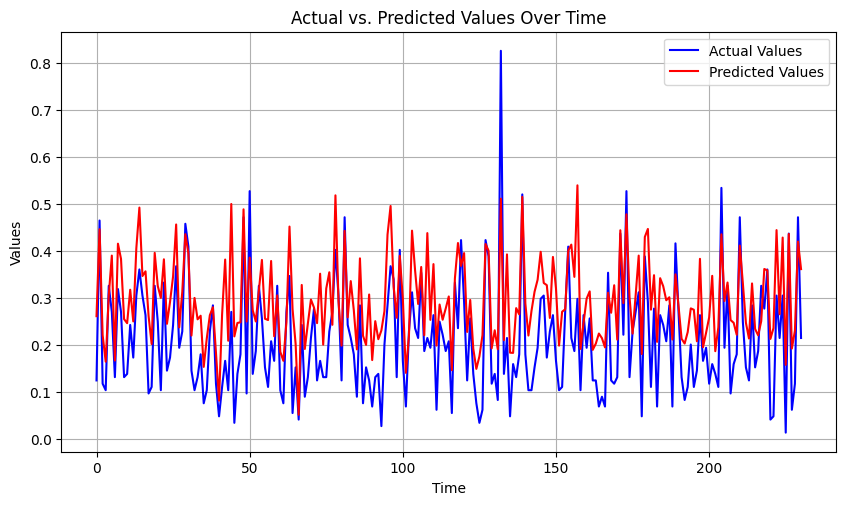

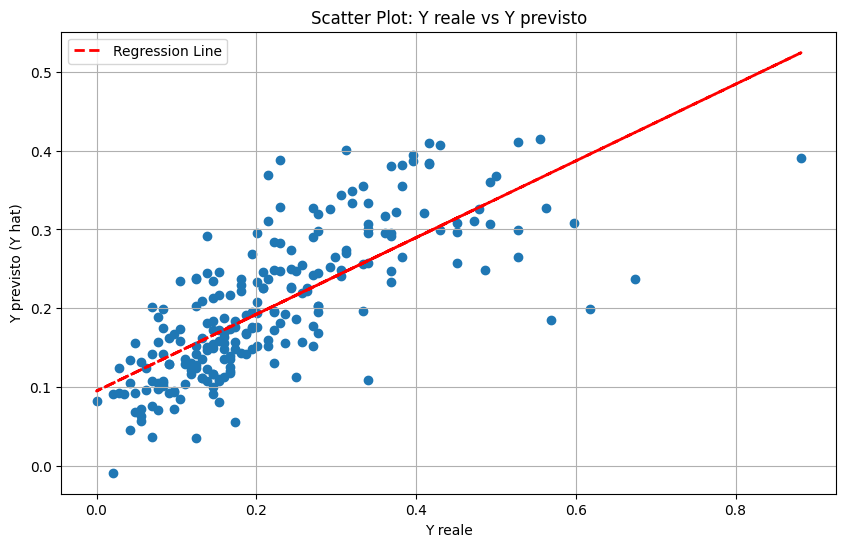

8/8 [==============================] - 0s 5ms/step

Model Completion: 5/144 (3.47%)
Saving data...
8/8 [==============================] - 0s 4ms/step
MAE (Iteration 6): 0.14
R-squared (R2) (Iteration 6): -0.45
RMSE (Iteration 6): 0.17


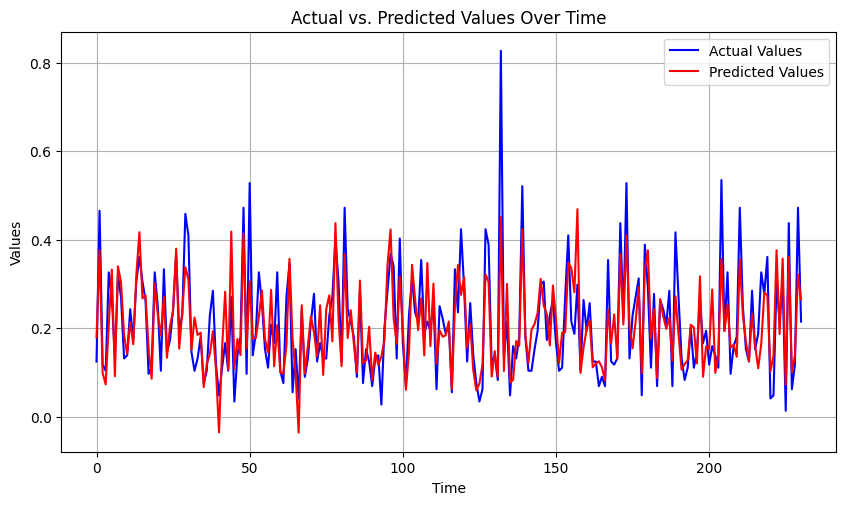

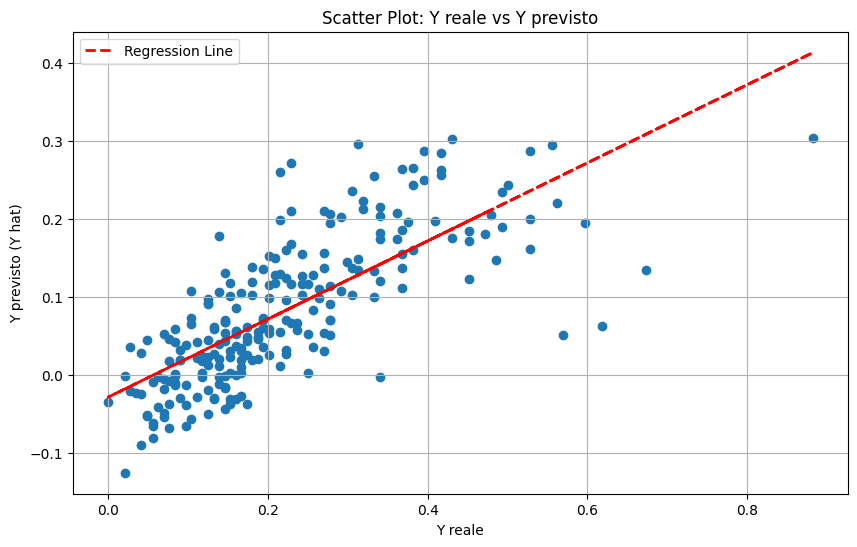

8/8 [==============================] - 0s 4ms/step

Model Completion: 6/144 (4.17%)
Saving data...
8/8 [==============================] - 0s 6ms/step
MAE (Iteration 7): 0.11
R-squared (R2) (Iteration 7): -0.1
RMSE (Iteration 7): 0.15


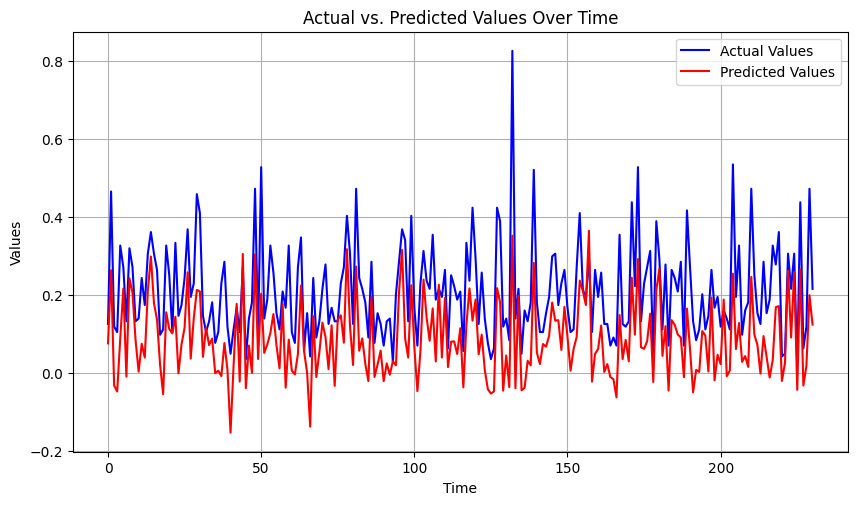

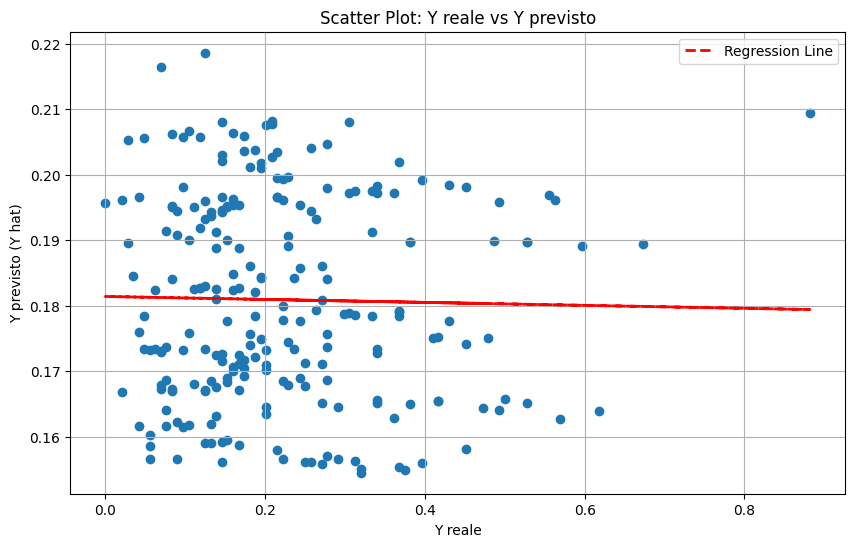

8/8 [==============================] - 0s 4ms/step

Model Completion: 7/144 (4.86%)
Saving data...
8/8 [==============================] - 0s 7ms/step
MAE (Iteration 8): 0.29
R-squared (R2) (Iteration 8): -4.01
RMSE (Iteration 8): 0.31


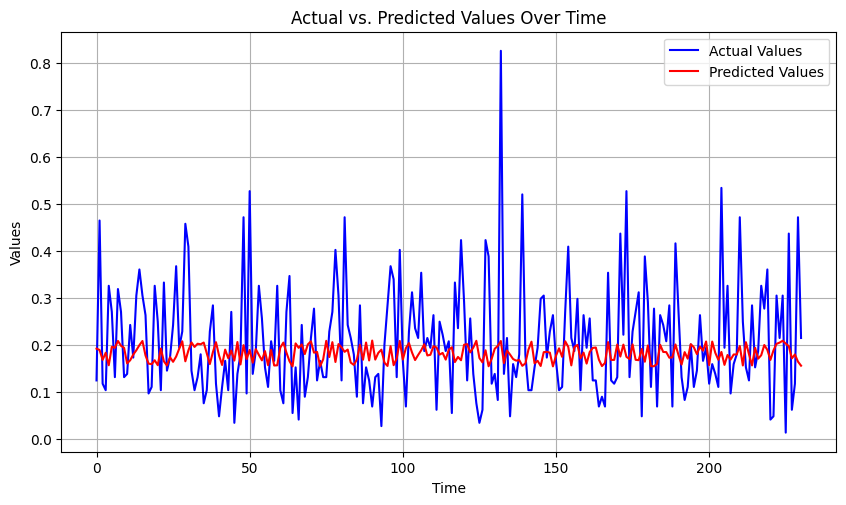

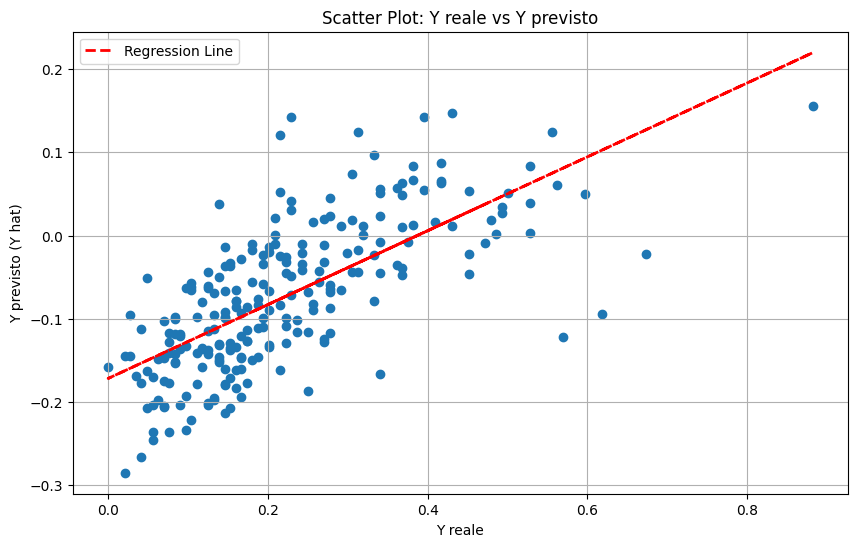

8/8 [==============================] - 0s 6ms/step

Model Completion: 8/144 (5.56%)
Saving data...
8/8 [==============================] - 0s 9ms/step
MAE (Iteration 9): 0.23
R-squared (R2) (Iteration 9): -2.16
RMSE (Iteration 9): 0.25


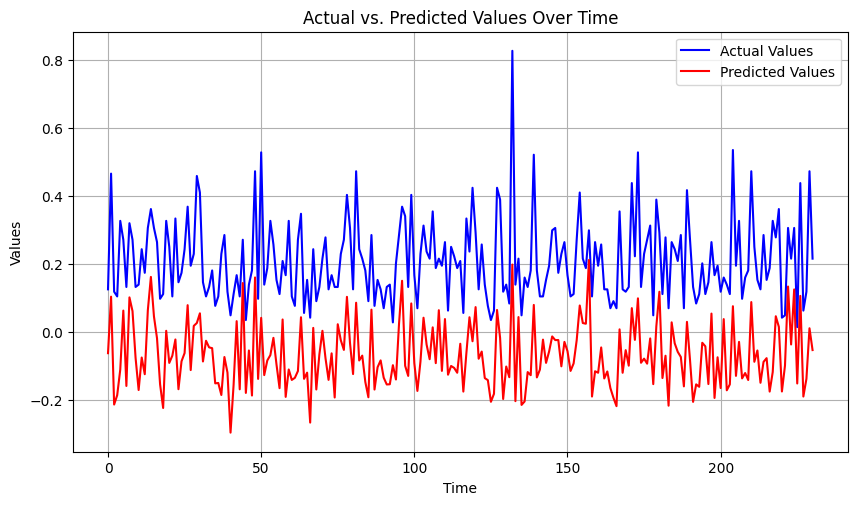

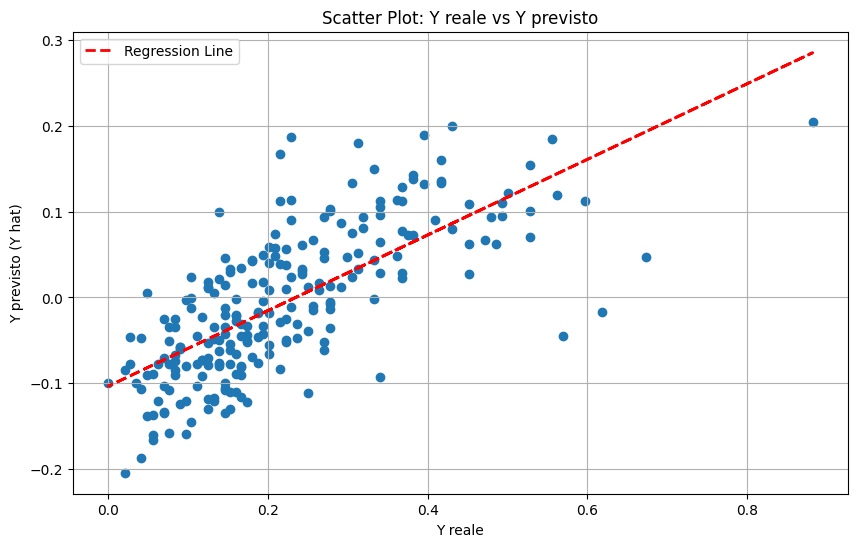

8/8 [==============================] - 0s 5ms/step

Model Completion: 9/144 (6.25%)
Saving data...
8/8 [==============================] - 0s 6ms/step
MAE (Iteration 10): 0.11
R-squared (R2) (Iteration 10): -0.01
RMSE (Iteration 10): 0.14


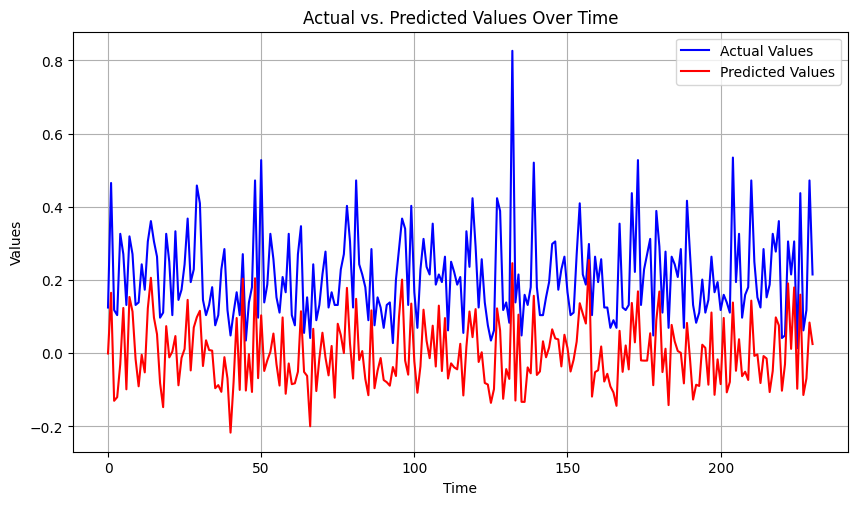

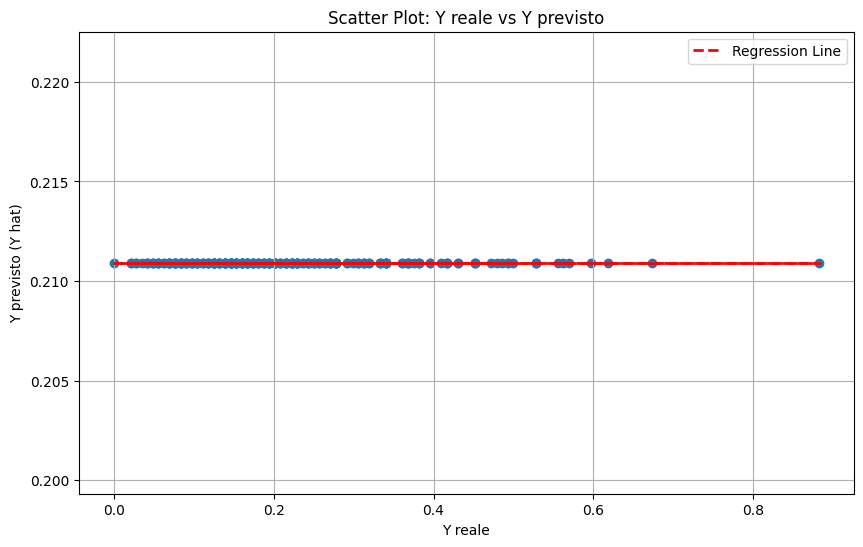

8/8 [==============================] - 0s 4ms/step

Model Completion: 10/144 (6.94%)
Saving data...
Number of Iterations: 20
8/8 [==============================] - 0s 4ms/step
MAE (Iteration 1): 0.11
R-squared (R2) (Iteration 1): -0.06
RMSE (Iteration 1): 0.14


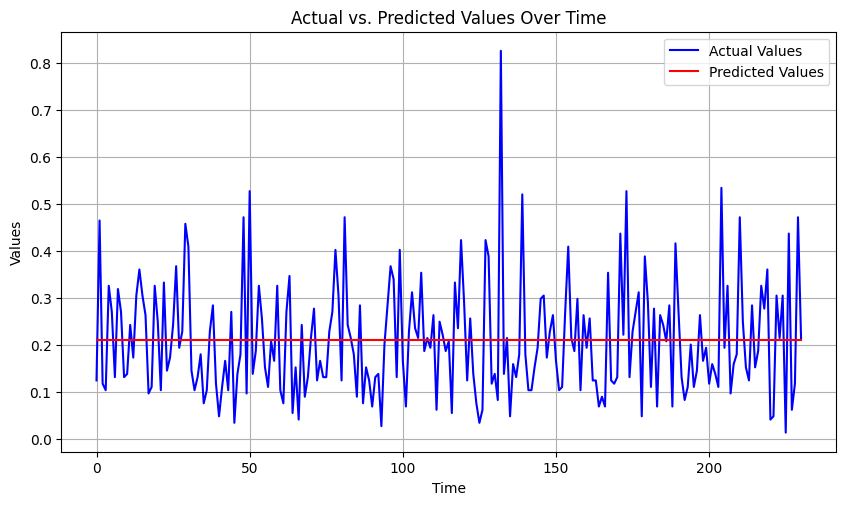

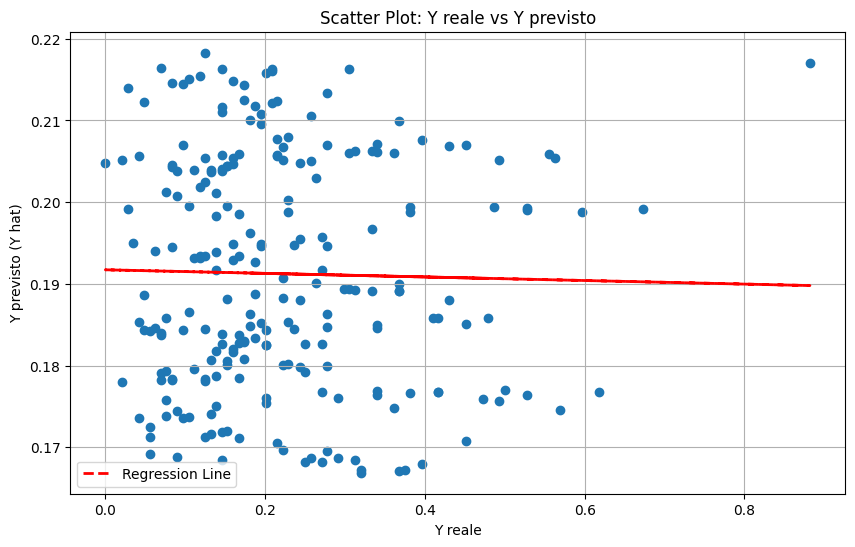

8/8 [==============================] - 0s 4ms/step

Model Completion: 11/144 (7.64%)
Saving data...
8/8 [==============================] - 0s 3ms/step
MAE (Iteration 2): 0.1
R-squared (R2) (Iteration 2): -0.07
RMSE (Iteration 2): 0.14


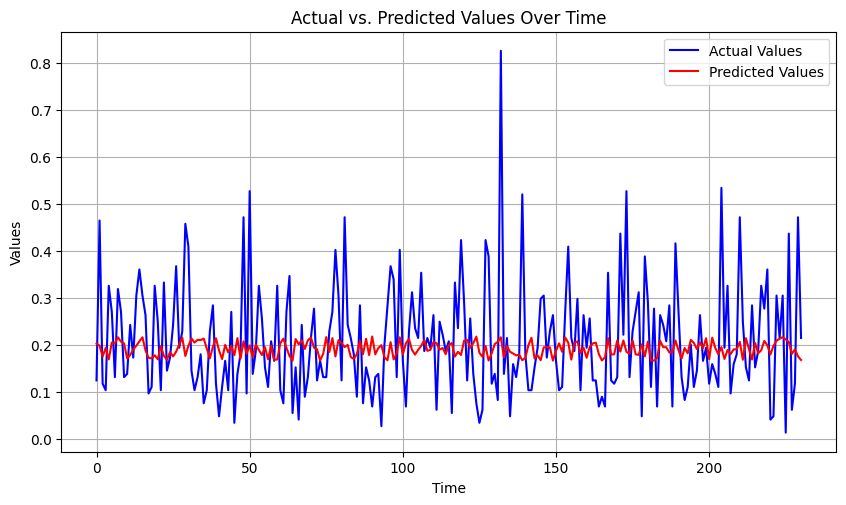

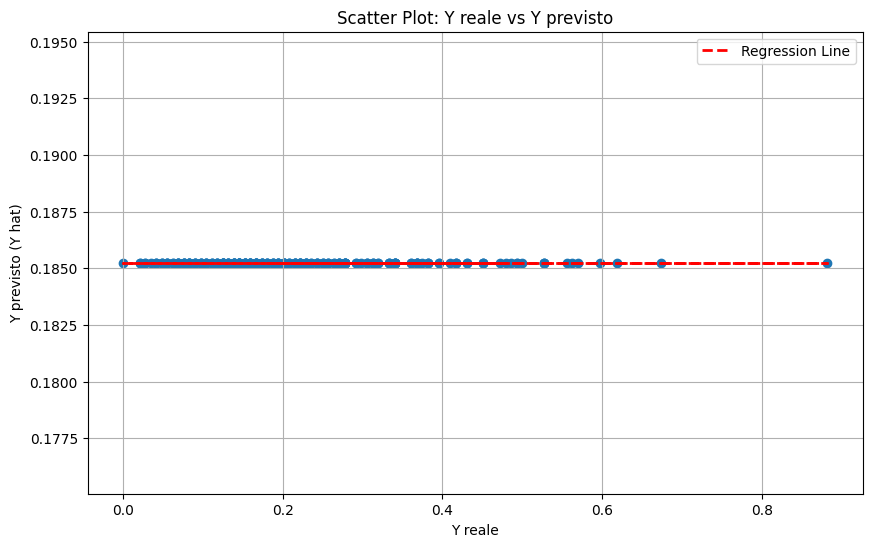

8/8 [==============================] - 0s 4ms/step

Model Completion: 12/144 (8.33%)
Saving data...
8/8 [==============================] - 0s 4ms/step
MAE (Iteration 3): 0.1
R-squared (R2) (Iteration 3): -0.1
RMSE (Iteration 3): 0.15


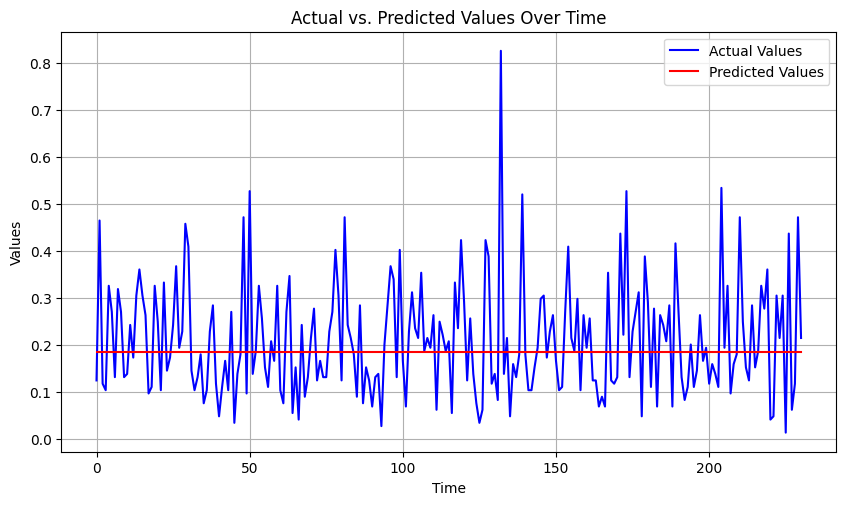

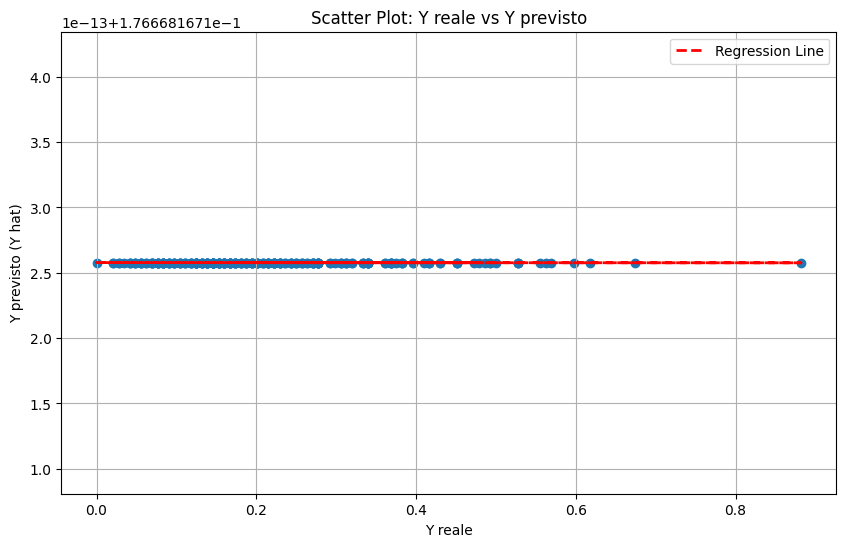

8/8 [==============================] - 0s 4ms/step

Model Completion: 13/144 (9.03%)
Saving data...
8/8 [==============================] - 0s 3ms/step
MAE (Iteration 4): 0.1
R-squared (R2) (Iteration 4): -0.08
RMSE (Iteration 4): 0.14


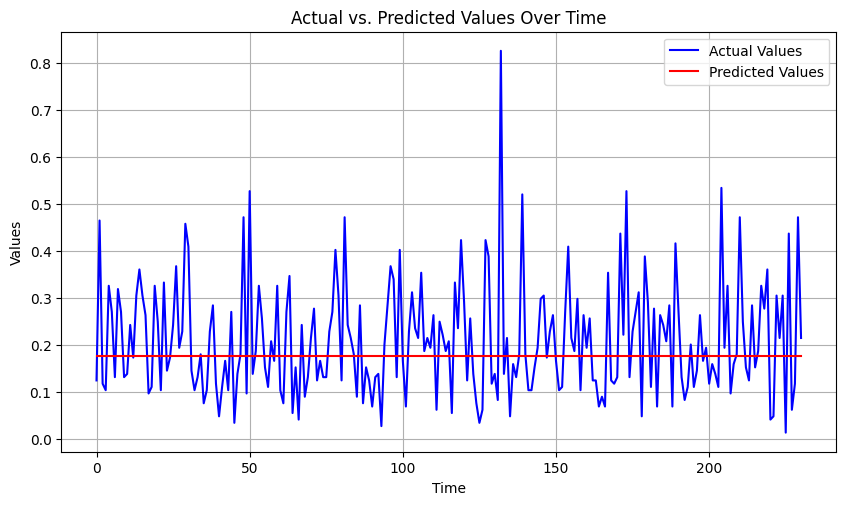

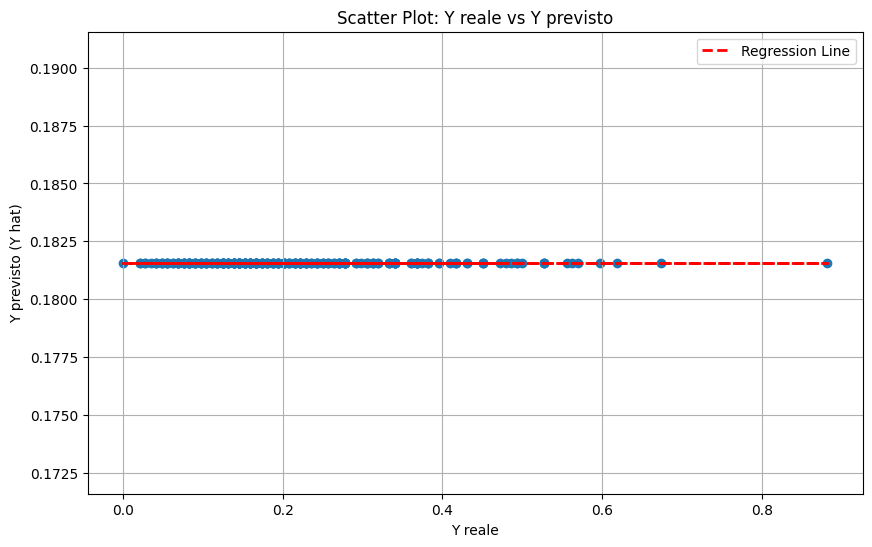

8/8 [==============================] - 0s 4ms/step

Model Completion: 14/144 (9.72%)
Saving data...
8/8 [==============================] - 0s 5ms/step
MAE (Iteration 5): 0.11
R-squared (R2) (Iteration 5): -0.01
RMSE (Iteration 5): 0.14


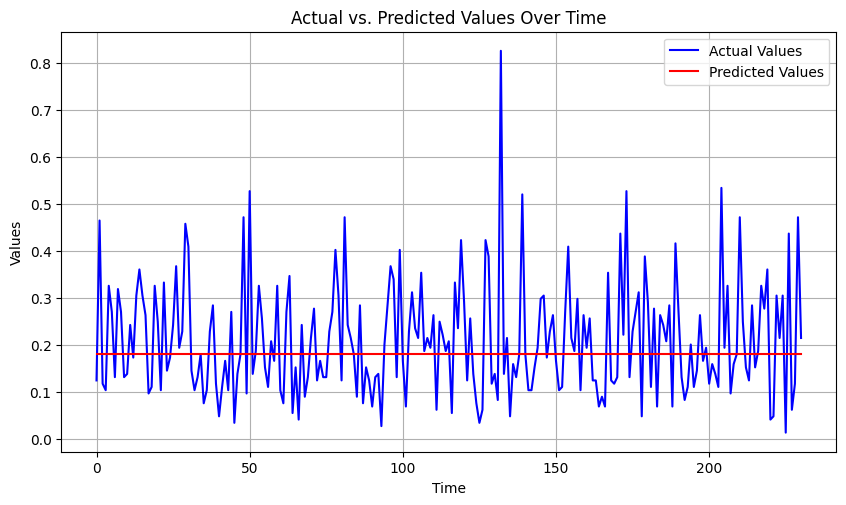

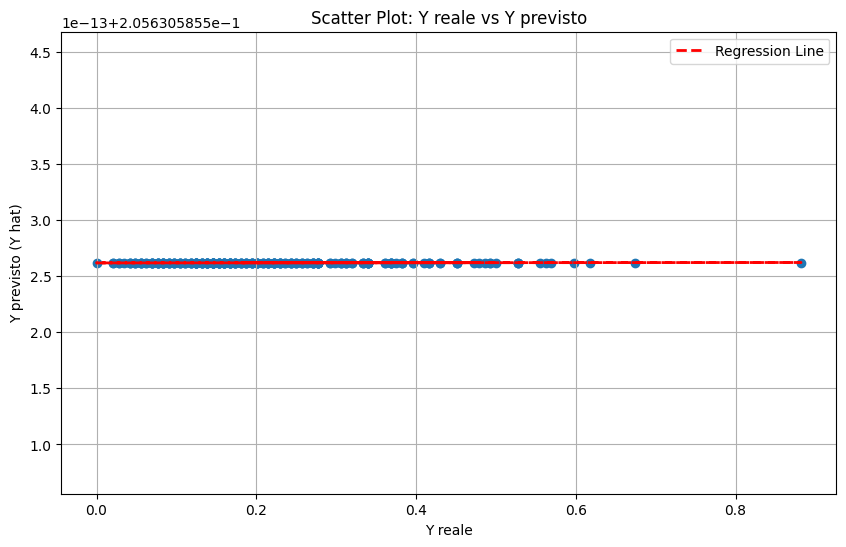

8/8 [==============================] - 0s 3ms/step

Model Completion: 15/144 (10.42%)
Saving data...
8/8 [==============================] - 0s 5ms/step
MAE (Iteration 6): 0.07
R-squared (R2) (Iteration 6): 0.47
RMSE (Iteration 6): 0.1


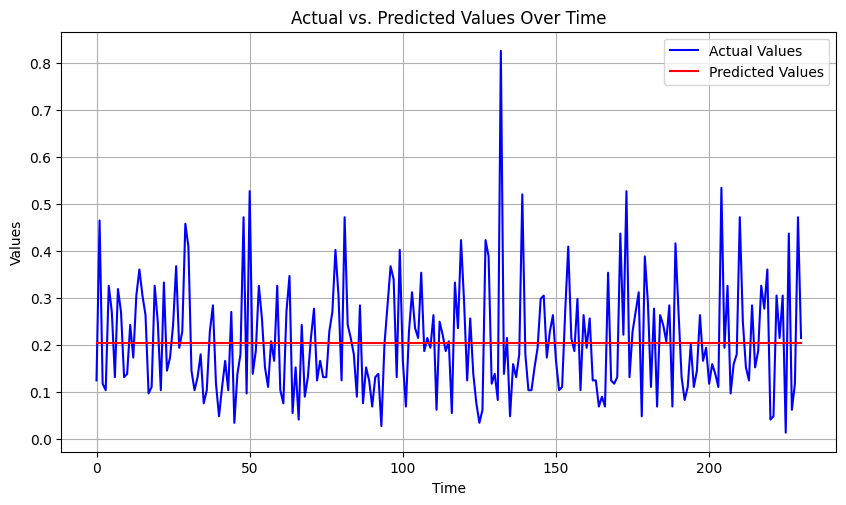

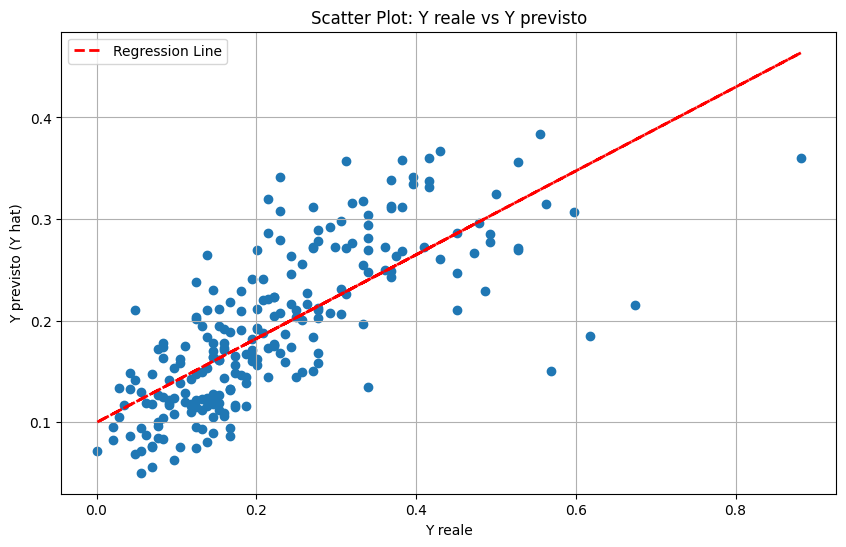

8/8 [==============================] - 0s 6ms/step

Model Completion: 16/144 (11.11%)
Saving data...
8/8 [==============================] - 0s 5ms/step
MAE (Iteration 7): 0.11
R-squared (R2) (Iteration 7): -0.08
RMSE (Iteration 7): 0.14


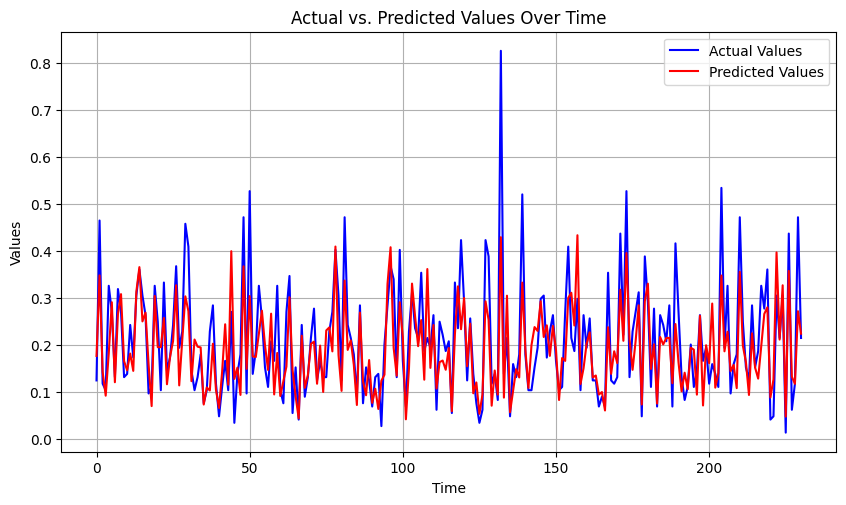

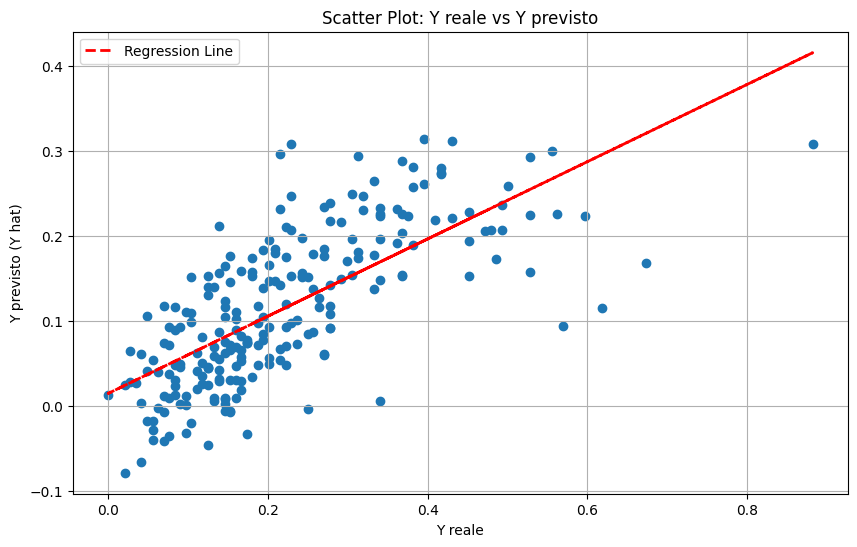

8/8 [==============================] - 0s 5ms/step

Model Completion: 17/144 (11.81%)
Saving data...
8/8 [==============================] - 0s 5ms/step
MAE (Iteration 8): 0.1
R-squared (R2) (Iteration 8): -0.04
RMSE (Iteration 8): 0.14


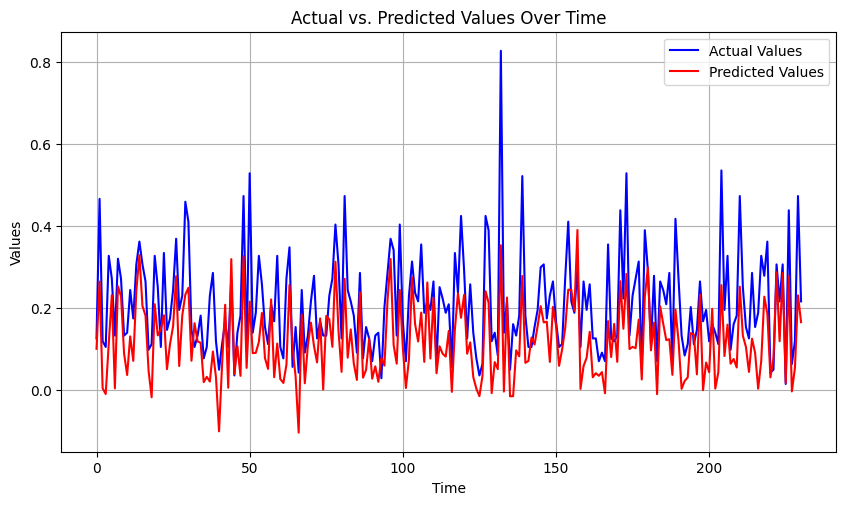

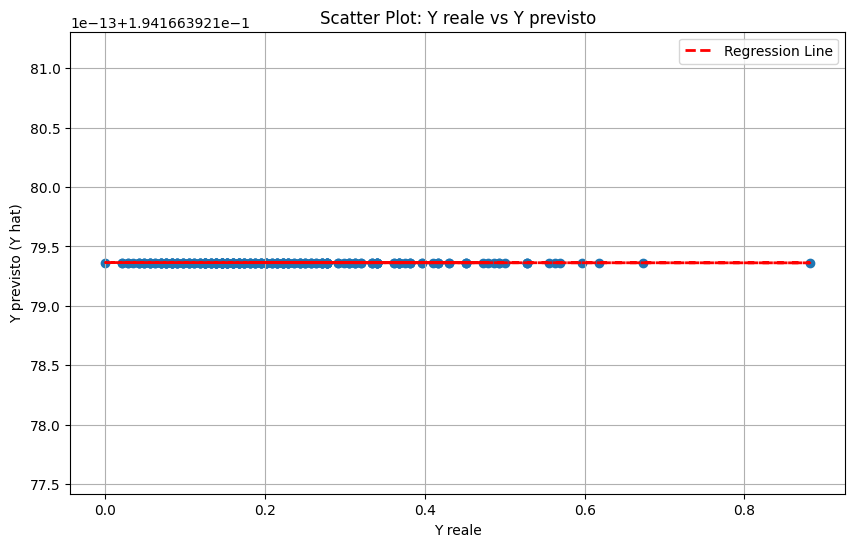

8/8 [==============================] - 0s 6ms/step

Model Completion: 18/144 (12.50%)
Saving data...
8/8 [==============================] - 0s 8ms/step
MAE (Iteration 9): 0.11
R-squared (R2) (Iteration 9): -0.0
RMSE (Iteration 9): 0.14


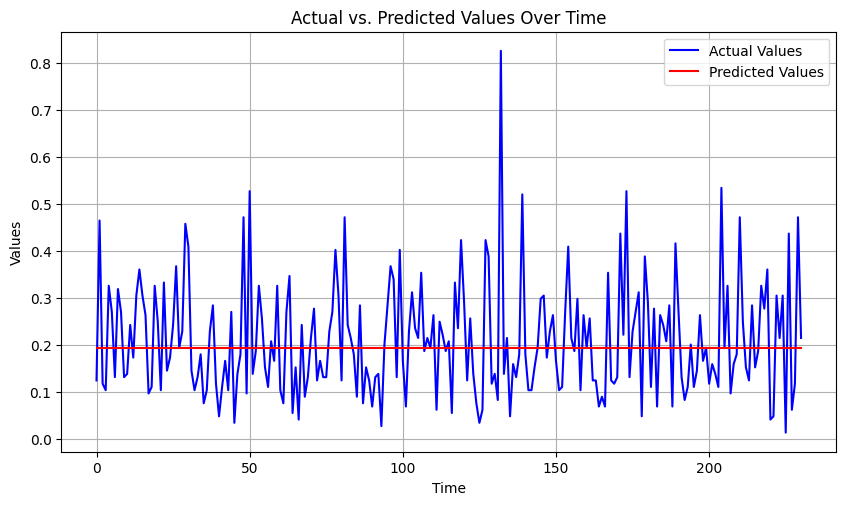

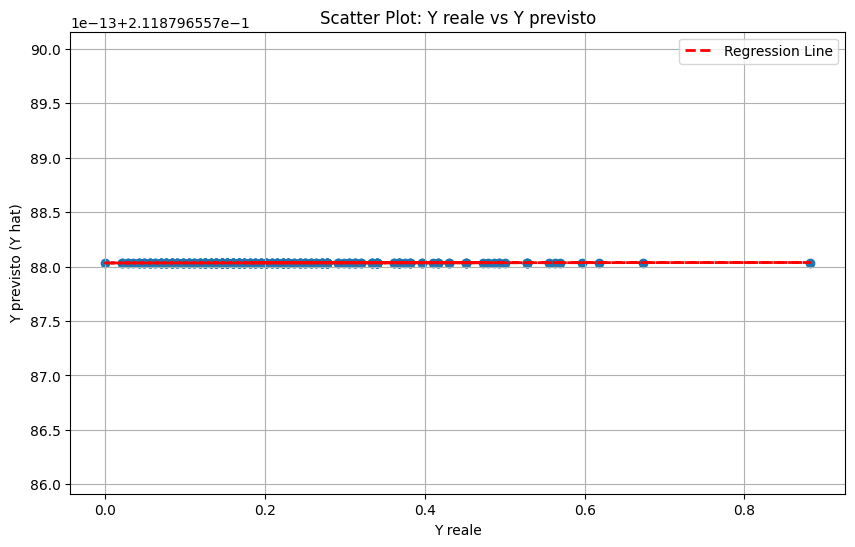

8/8 [==============================] - 0s 5ms/step

Model Completion: 19/144 (13.19%)
Saving data...
8/8 [==============================] - 0s 5ms/step
MAE (Iteration 10): 0.07
R-squared (R2) (Iteration 10): 0.52
RMSE (Iteration 10): 0.1


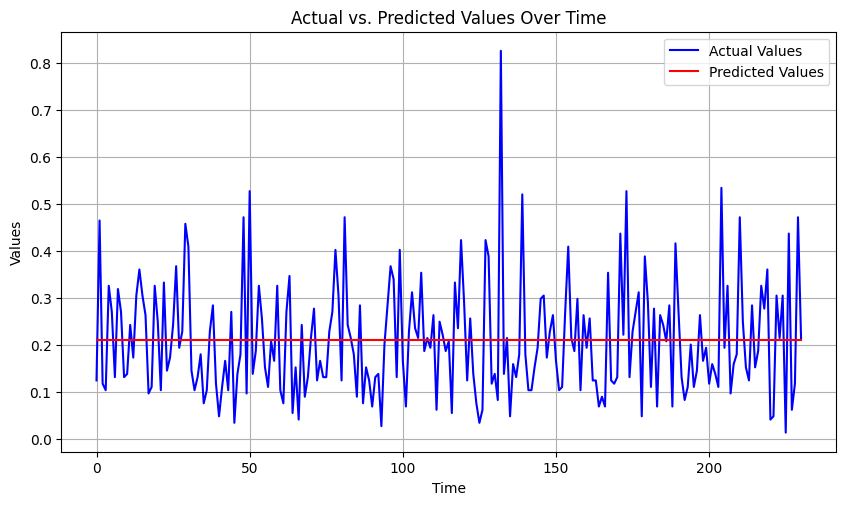

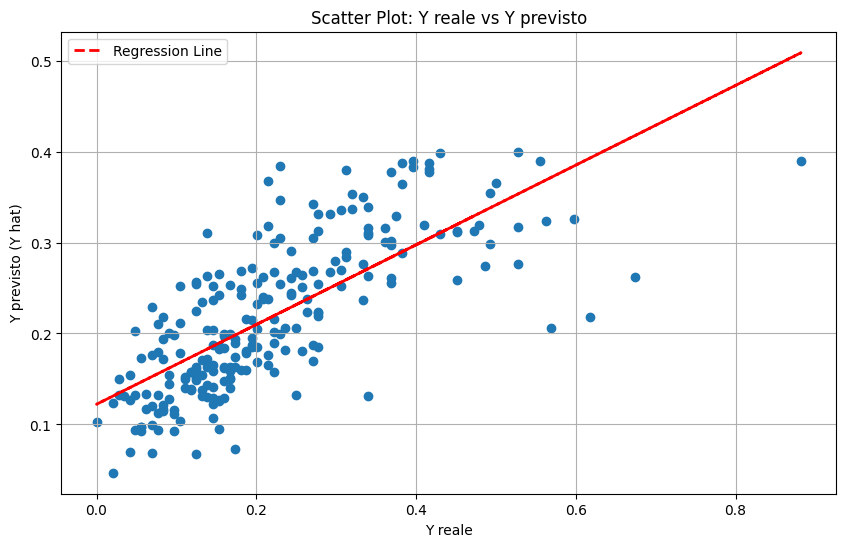

8/8 [==============================] - 0s 5ms/step

Model Completion: 20/144 (13.89%)
Saving data...
8/8 [==============================] - 0s 9ms/step
MAE (Iteration 11): 0.1
R-squared (R2) (Iteration 11): -0.03
RMSE (Iteration 11): 0.14


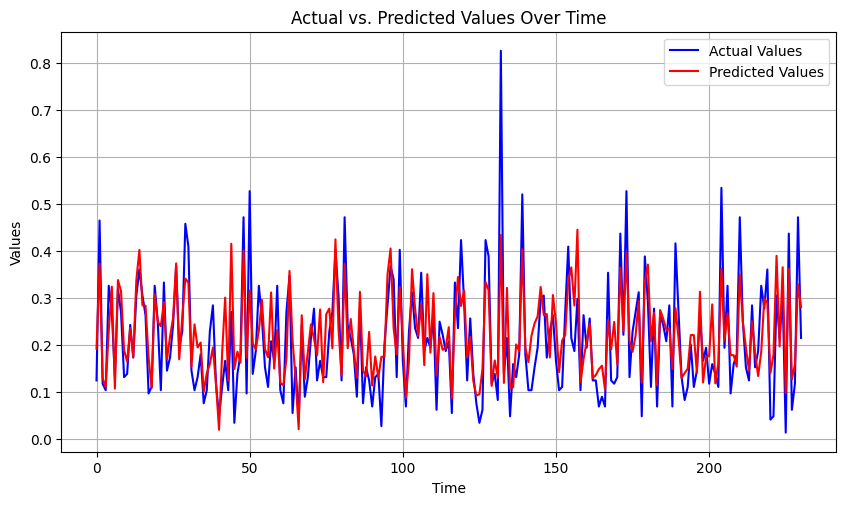

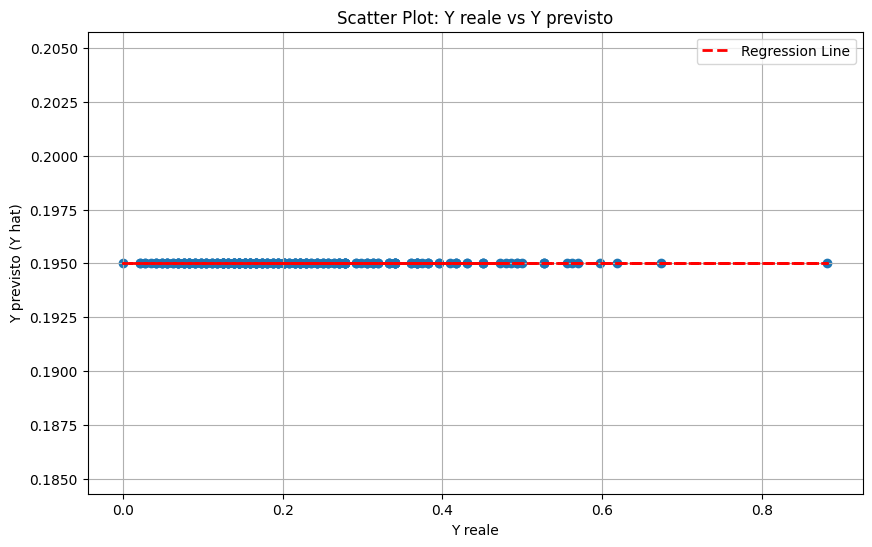

8/8 [==============================] - 0s 8ms/step

Model Completion: 21/144 (14.58%)
Saving data...
8/8 [==============================] - 0s 6ms/step
MAE (Iteration 12): 0.07
R-squared (R2) (Iteration 12): 0.47
RMSE (Iteration 12): 0.1


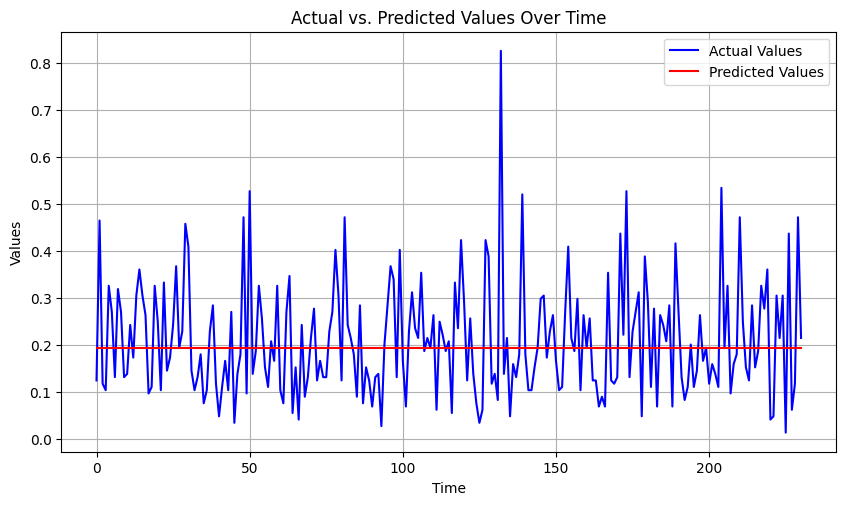

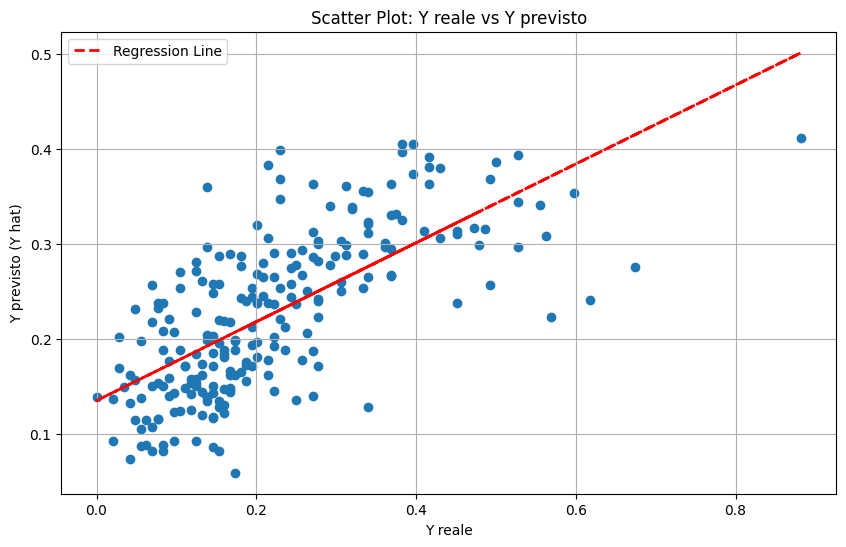

8/8 [==============================] - 0s 9ms/step

Model Completion: 22/144 (15.28%)
Saving data...
8/8 [==============================] - 0s 3ms/step
MAE (Iteration 13): 0.1
R-squared (R2) (Iteration 13): -0.03
RMSE (Iteration 13): 0.14


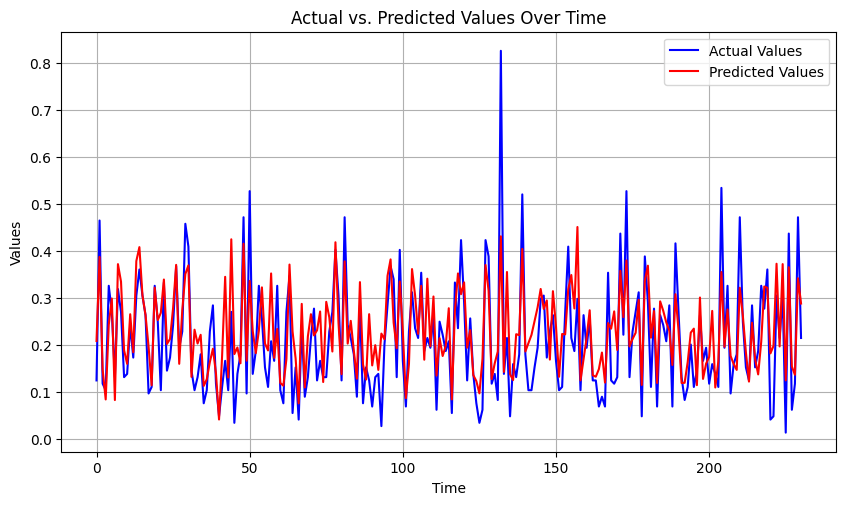

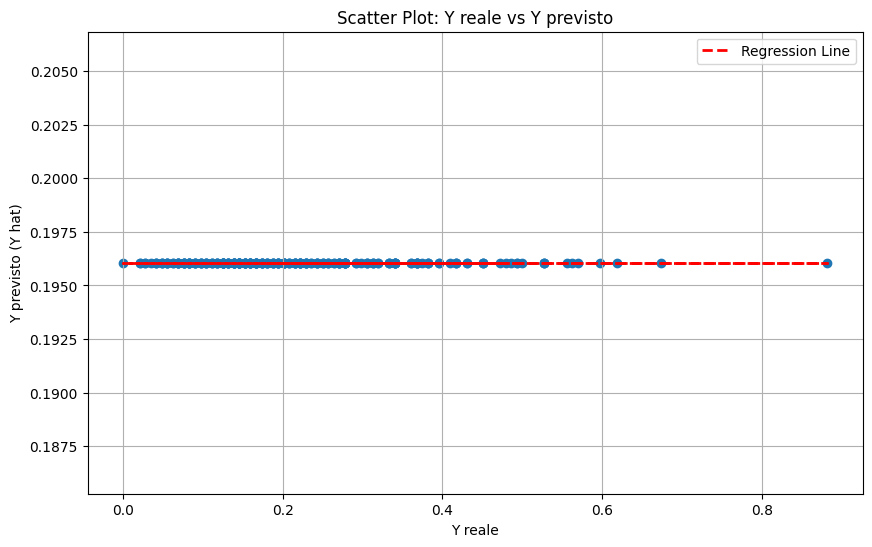

8/8 [==============================] - 0s 4ms/step

Model Completion: 23/144 (15.97%)
Saving data...
8/8 [==============================] - 0s 5ms/step
MAE (Iteration 14): 0.15
R-squared (R2) (Iteration 14): -0.69
RMSE (Iteration 14): 0.18


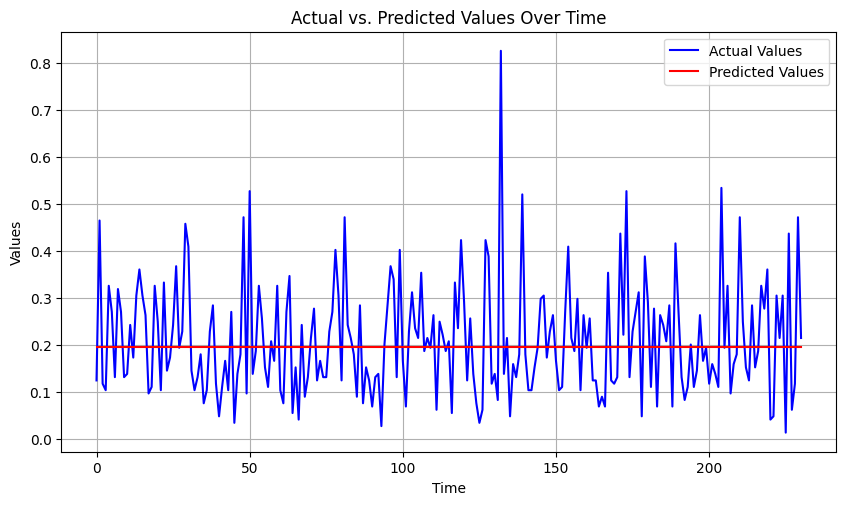

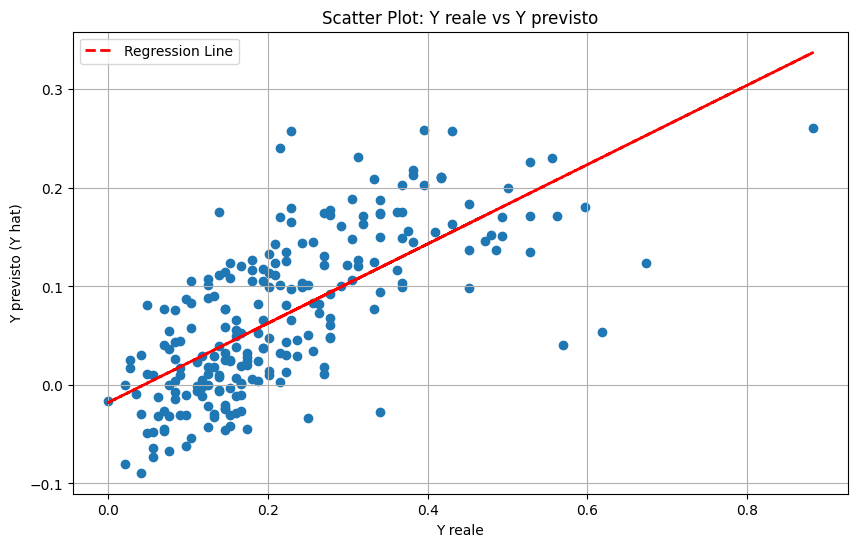

8/8 [==============================] - 0s 5ms/step

Model Completion: 24/144 (16.67%)
Saving data...
8/8 [==============================] - 0s 5ms/step
MAE (Iteration 15): 0.15
R-squared (R2) (Iteration 15): -0.99
RMSE (Iteration 15): 0.2


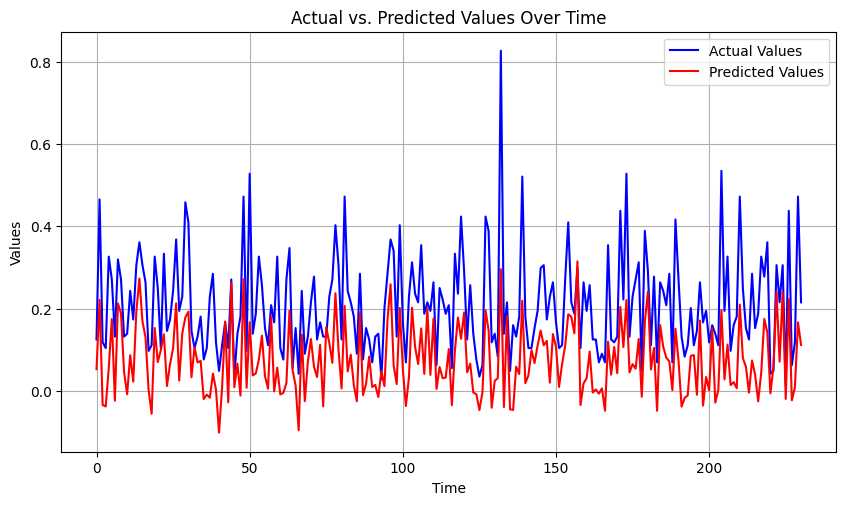

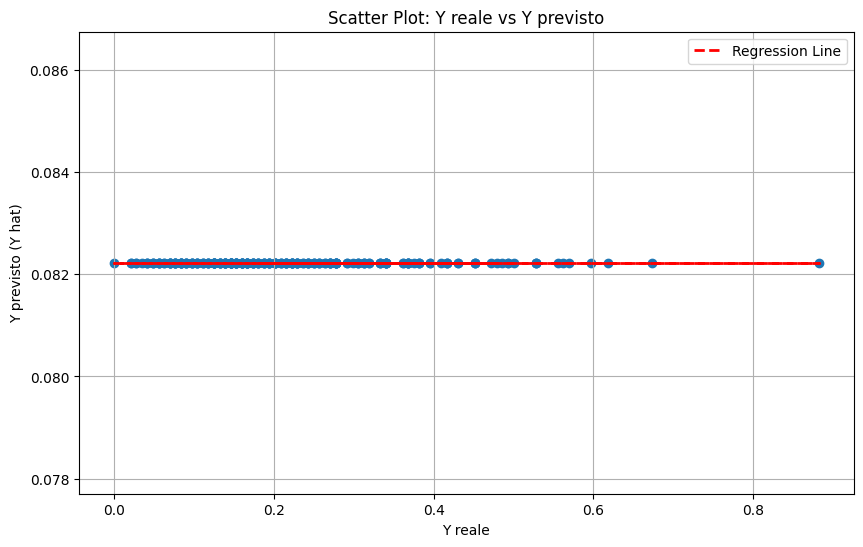

8/8 [==============================] - 0s 6ms/step

Model Completion: 25/144 (17.36%)
Saving data...
8/8 [==============================] - 0s 6ms/step
MAE (Iteration 16): 0.27
R-squared (R2) (Iteration 16): -3.02
RMSE (Iteration 16): 0.28


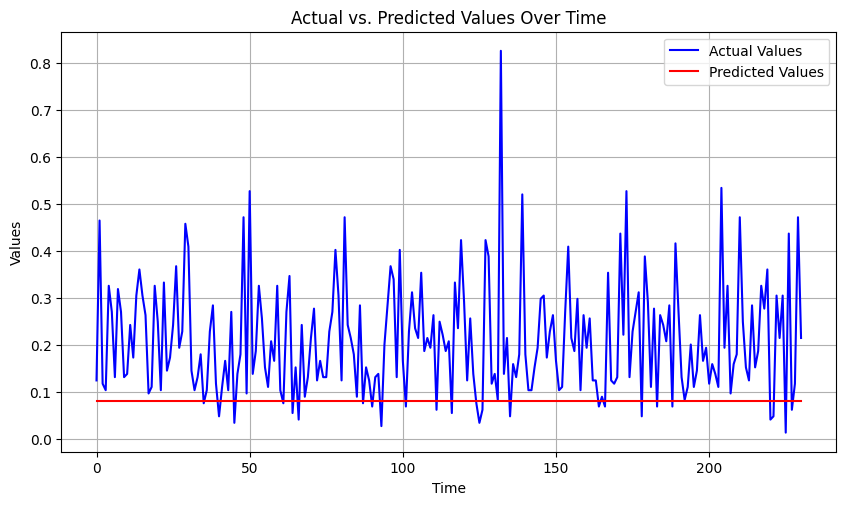

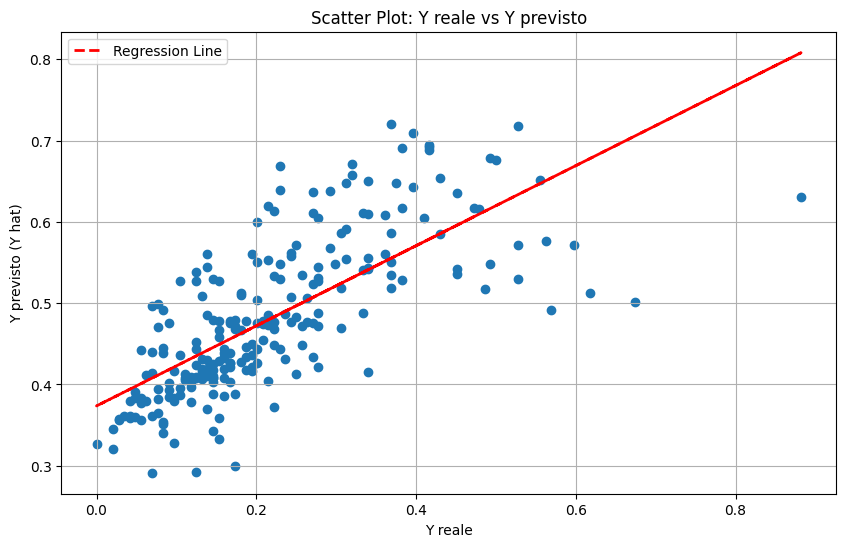

8/8 [==============================] - 0s 7ms/step

Model Completion: 26/144 (18.06%)
Saving data...
8/8 [==============================] - 0s 6ms/step
MAE (Iteration 17): 0.15
R-squared (R2) (Iteration 17): -0.74
RMSE (Iteration 17): 0.18


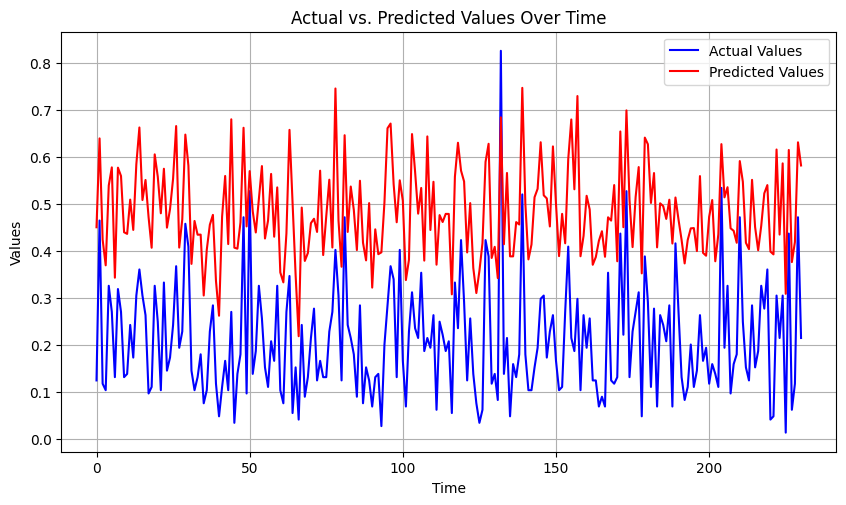

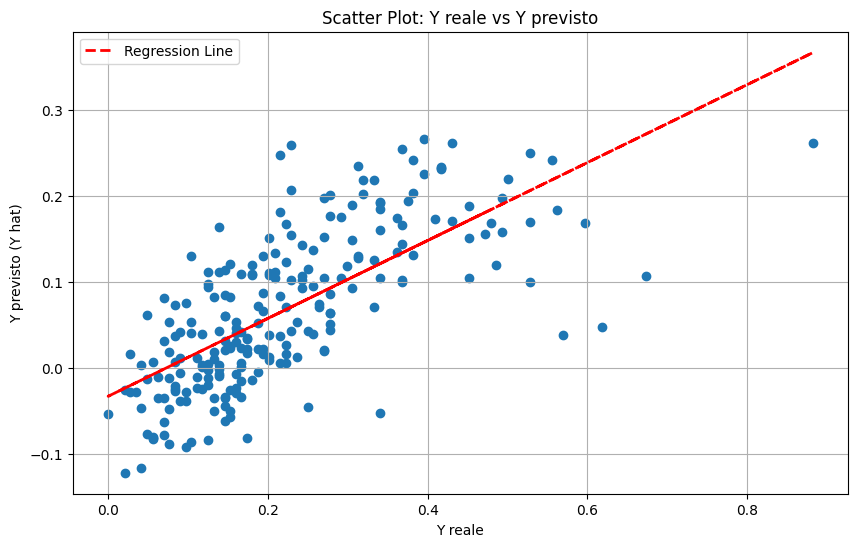

8/8 [==============================] - 0s 4ms/step

Model Completion: 27/144 (18.75%)
Saving data...
8/8 [==============================] - 0s 4ms/step
MAE (Iteration 18): 0.07
R-squared (R2) (Iteration 18): 0.47
RMSE (Iteration 18): 0.1


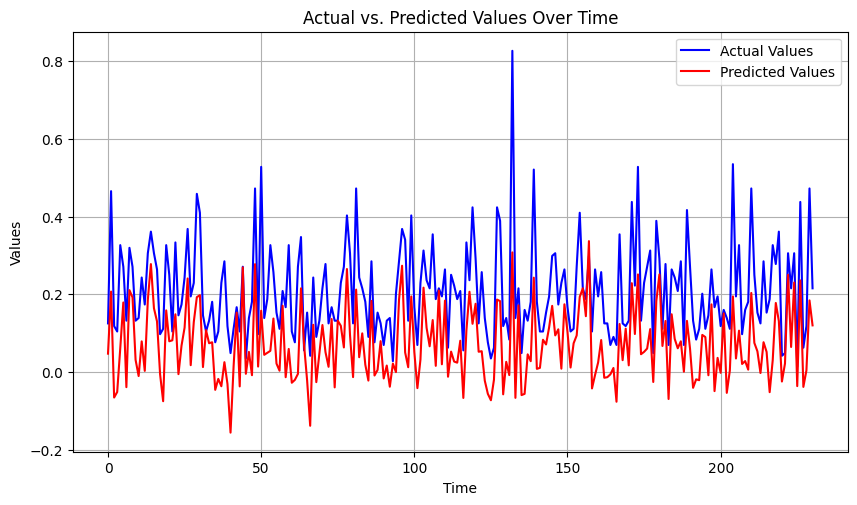

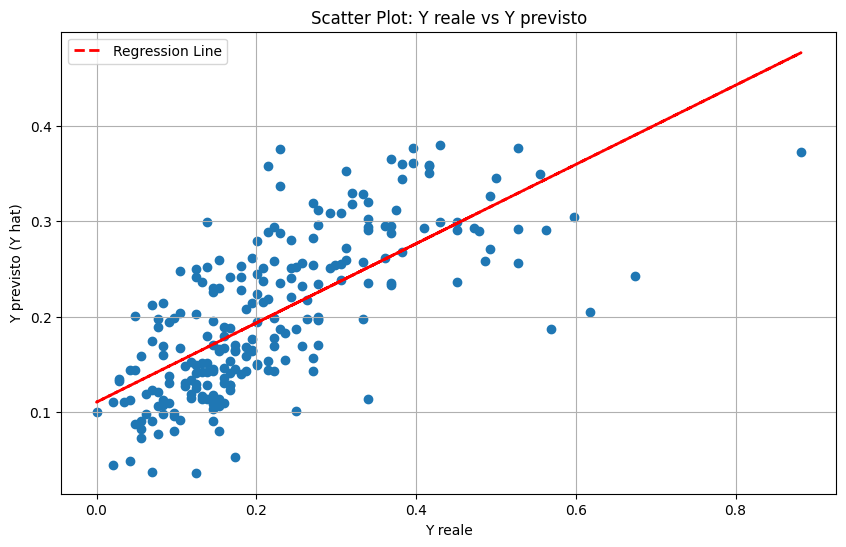

8/8 [==============================] - 0s 5ms/step

Model Completion: 28/144 (19.44%)
Saving data...
8/8 [==============================] - 0s 4ms/step
MAE (Iteration 19): 0.09
R-squared (R2) (Iteration 19): 0.32
RMSE (Iteration 19): 0.11


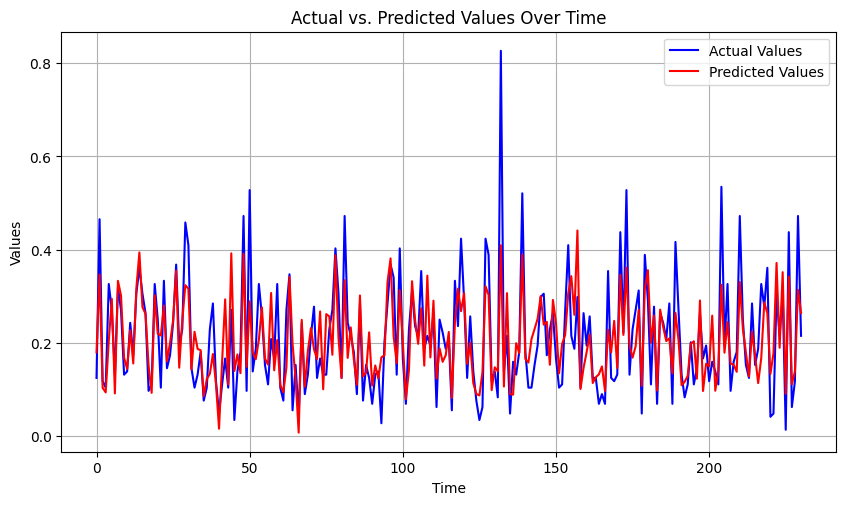

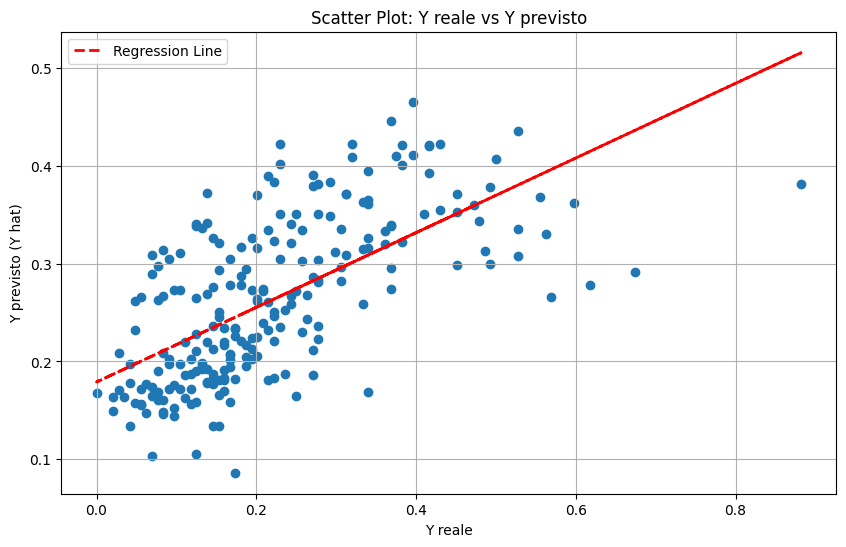

8/8 [==============================] - 0s 3ms/step

Model Completion: 29/144 (20.14%)
Saving data...
8/8 [==============================] - 0s 8ms/step
MAE (Iteration 20): 0.07
R-squared (R2) (Iteration 20): 0.48
RMSE (Iteration 20): 0.1


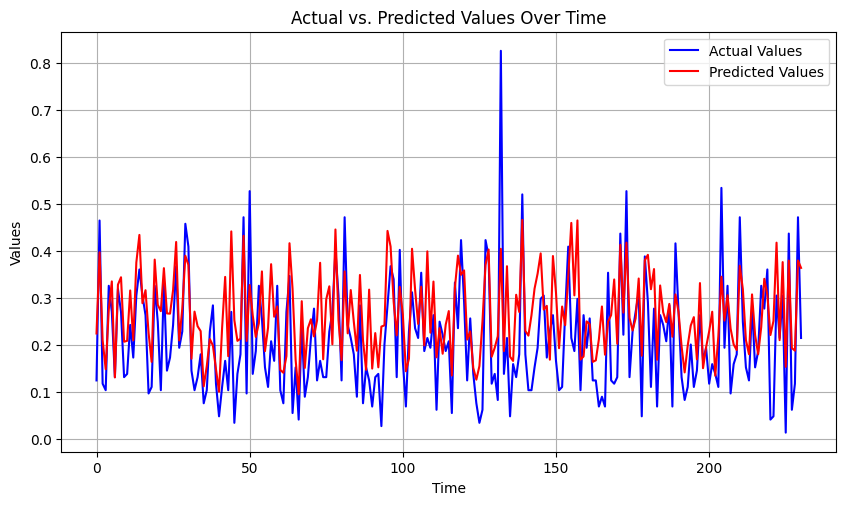

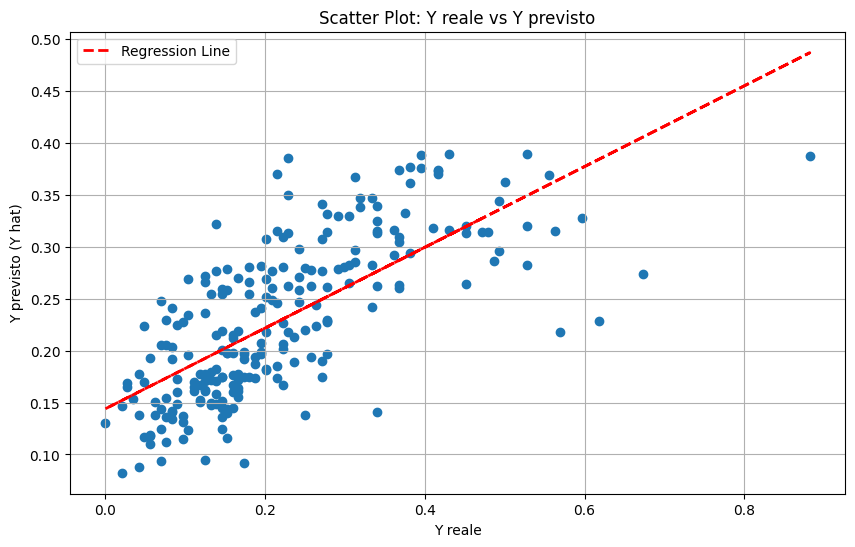

8/8 [==============================] - 0s 5ms/step

Model Completion: 30/144 (20.83%)
Saving data...
Number of Iterations: 30
8/8 [==============================] - 0s 7ms/step
MAE (Iteration 1): 0.32
R-squared (R2) (Iteration 1): -4.74
RMSE (Iteration 1): 0.33


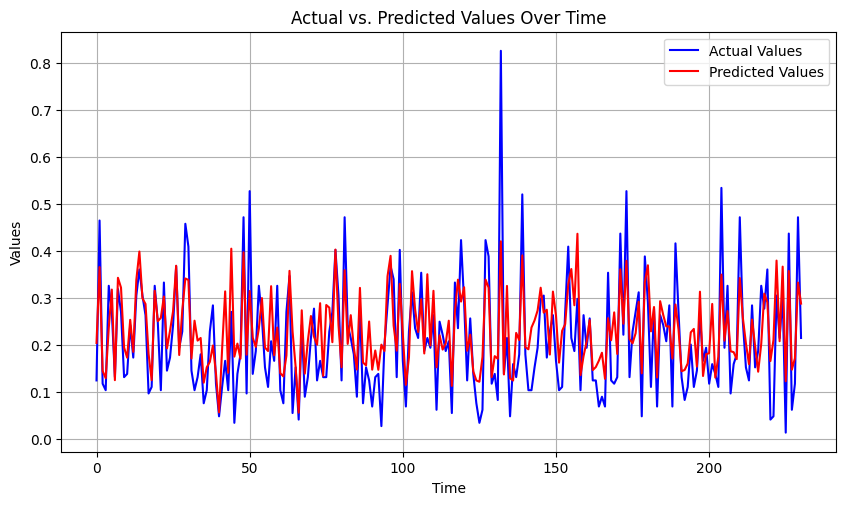

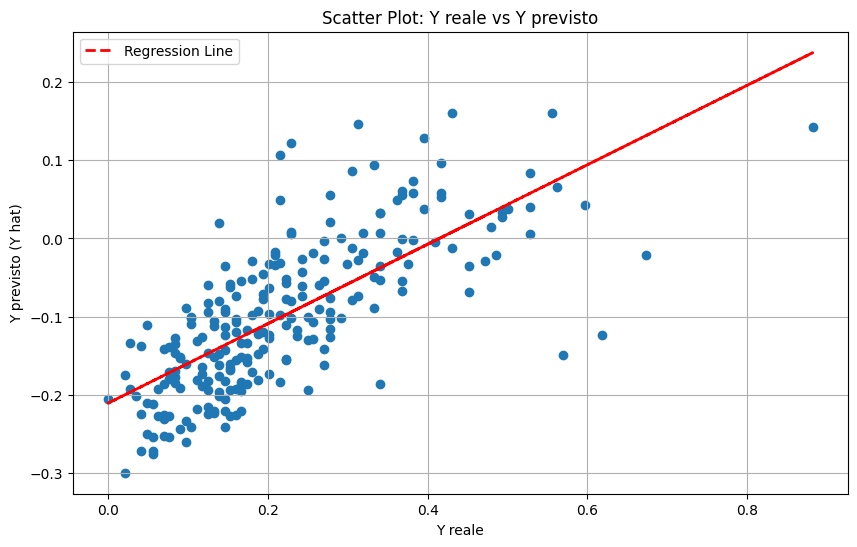

8/8 [==============================] - 0s 7ms/step

Model Completion: 31/144 (21.53%)
Saving data...
8/8 [==============================] - 0s 3ms/step
MAE (Iteration 2): 0.15
R-squared (R2) (Iteration 2): -0.45
RMSE (Iteration 2): 0.17


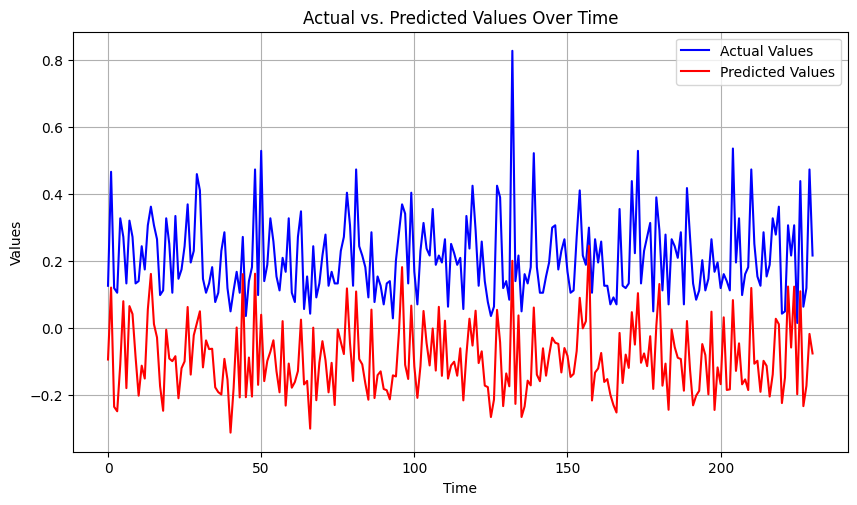

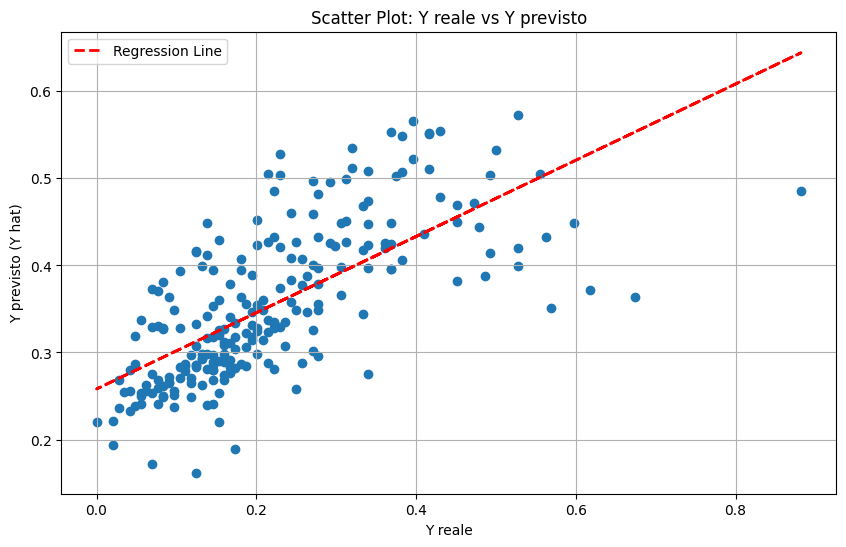

8/8 [==============================] - 0s 3ms/step

Model Completion: 32/144 (22.22%)
Saving data...
8/8 [==============================] - 0s 3ms/step
MAE (Iteration 3): 0.11
R-squared (R2) (Iteration 3): -0.13
RMSE (Iteration 3): 0.15


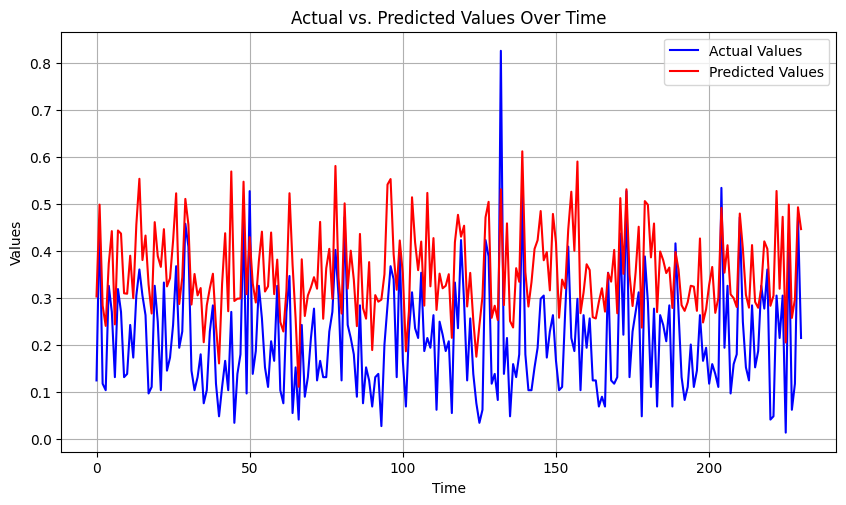

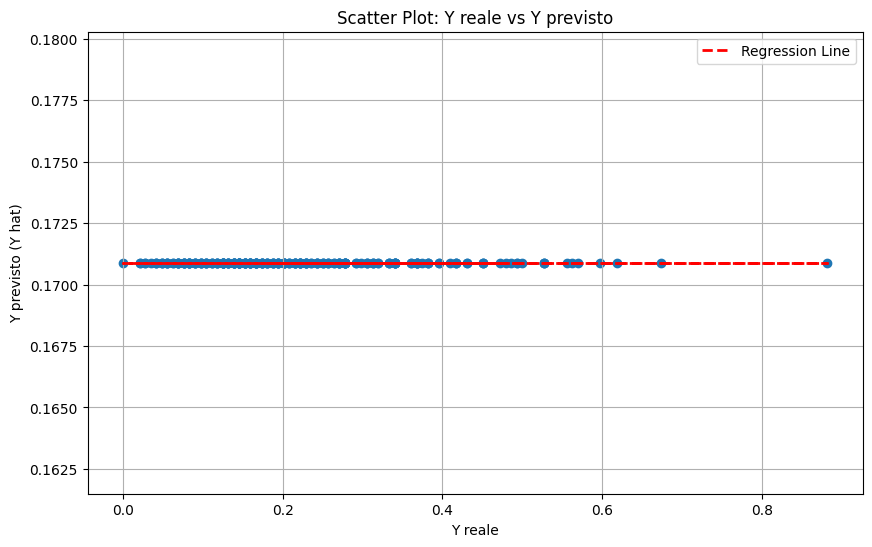

8/8 [==============================] - 0s 6ms/step

Model Completion: 33/144 (22.92%)
Saving data...
8/8 [==============================] - 0s 3ms/step
MAE (Iteration 4): 0.11
R-squared (R2) (Iteration 4): -0.01
RMSE (Iteration 4): 0.14


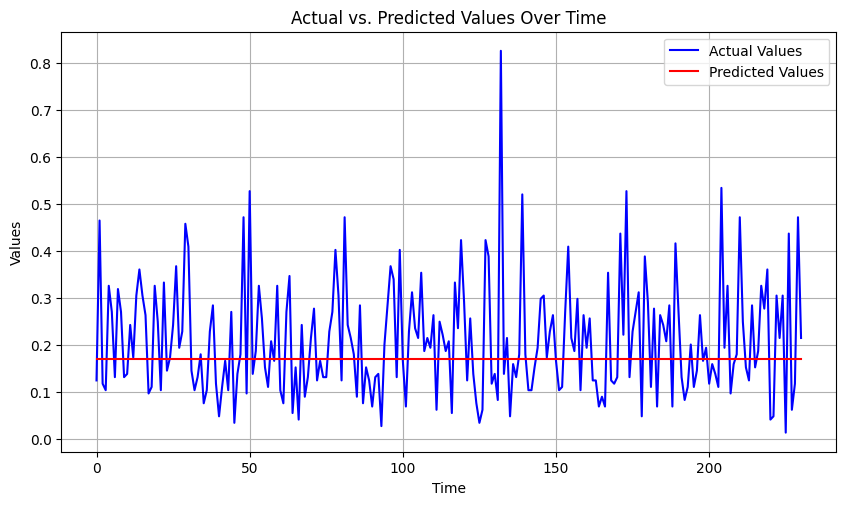

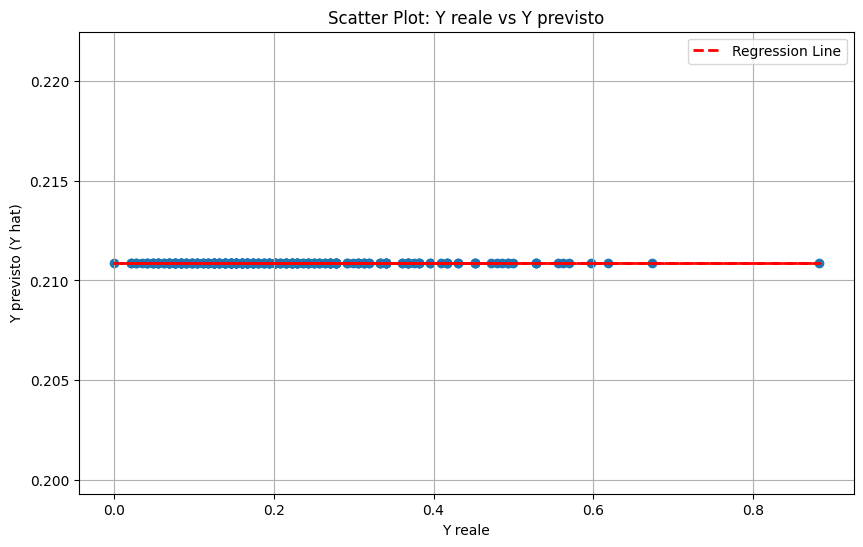

8/8 [==============================] - 0s 3ms/step

Model Completion: 34/144 (23.61%)
Saving data...
8/8 [==============================] - 0s 9ms/step
MAE (Iteration 5): 0.11
R-squared (R2) (Iteration 5): -0.32
RMSE (Iteration 5): 0.16


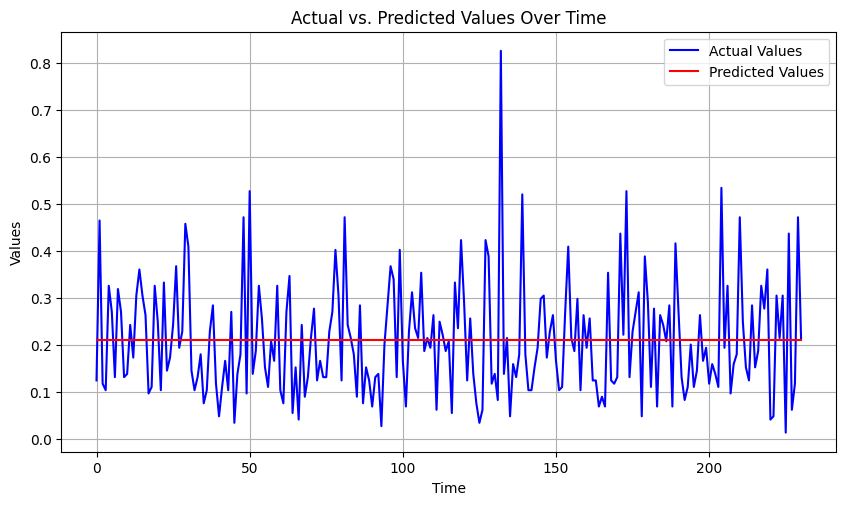

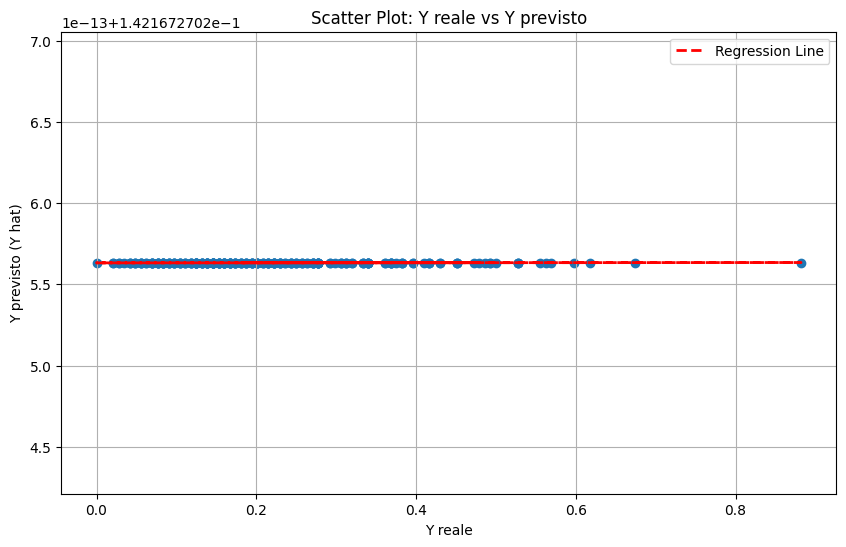

8/8 [==============================] - 0s 5ms/step

Model Completion: 35/144 (24.31%)
Saving data...
8/8 [==============================] - 0s 3ms/step
MAE (Iteration 6): 0.11
R-squared (R2) (Iteration 6): -0.01
RMSE (Iteration 6): 0.14


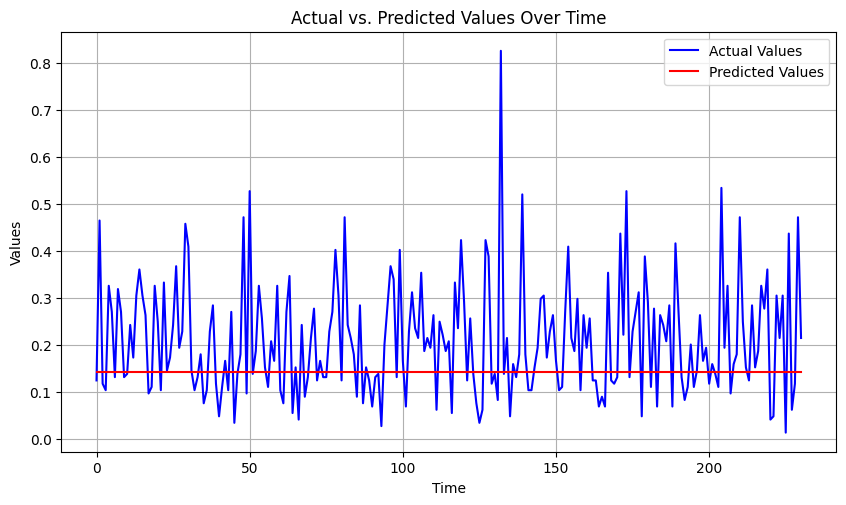

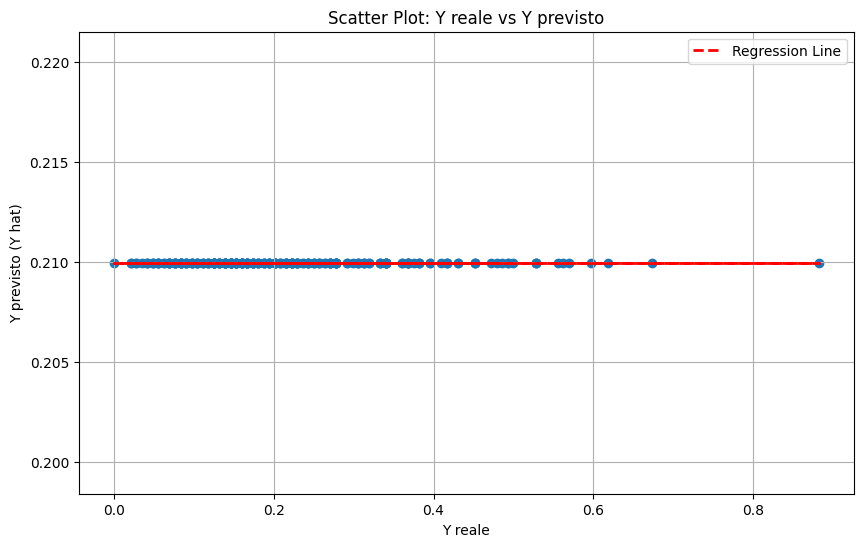

8/8 [==============================] - 0s 4ms/step

Model Completion: 36/144 (25.00%)
Saving data...
8/8 [==============================] - 0s 3ms/step
MAE (Iteration 7): 0.07
R-squared (R2) (Iteration 7): 0.5
RMSE (Iteration 7): 0.1


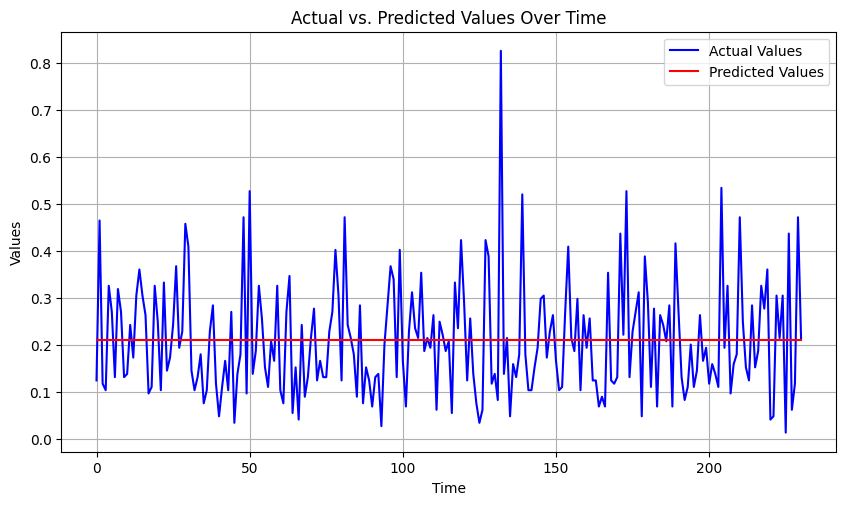

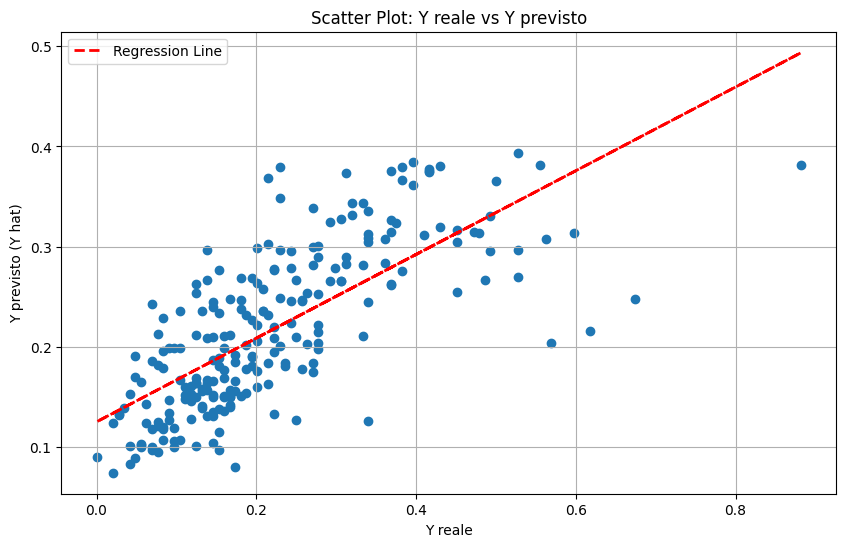

8/8 [==============================] - 0s 3ms/step

Model Completion: 37/144 (25.69%)
Saving data...
8/8 [==============================] - 0s 9ms/step
MAE (Iteration 8): 0.08
R-squared (R2) (Iteration 8): 0.46
RMSE (Iteration 8): 0.1


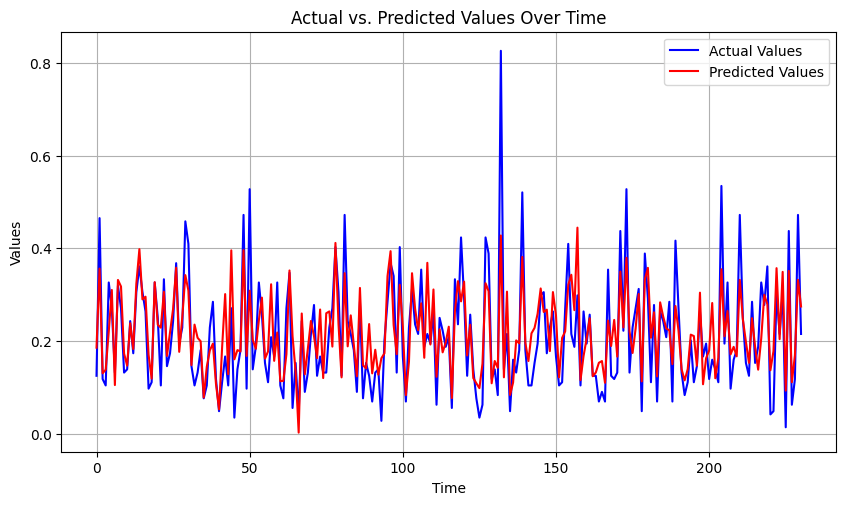

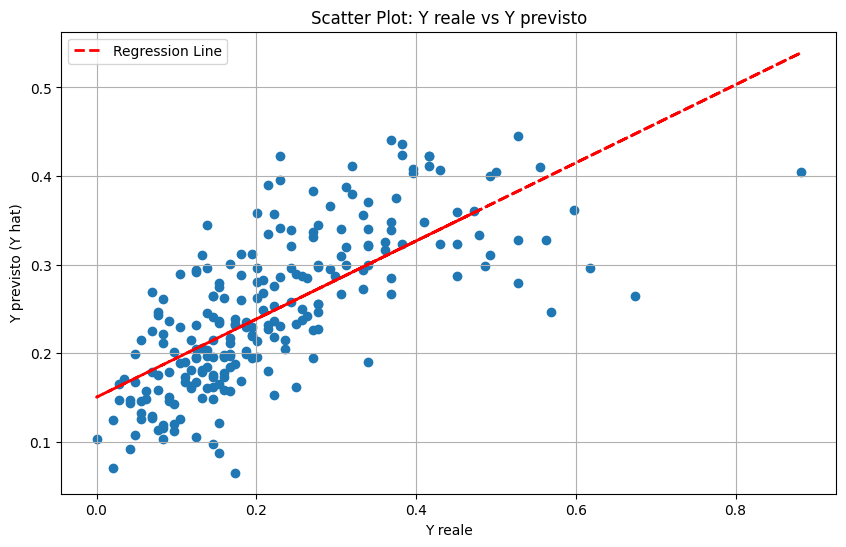

8/8 [==============================] - 0s 4ms/step

Model Completion: 38/144 (26.39%)
Saving data...
8/8 [==============================] - 0s 5ms/step
MAE (Iteration 9): 0.1
R-squared (R2) (Iteration 9): -0.07
RMSE (Iteration 9): 0.14


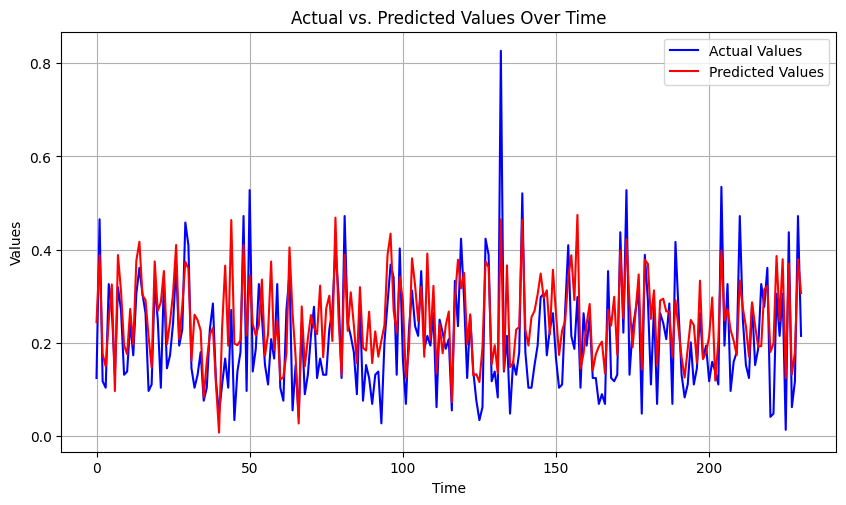

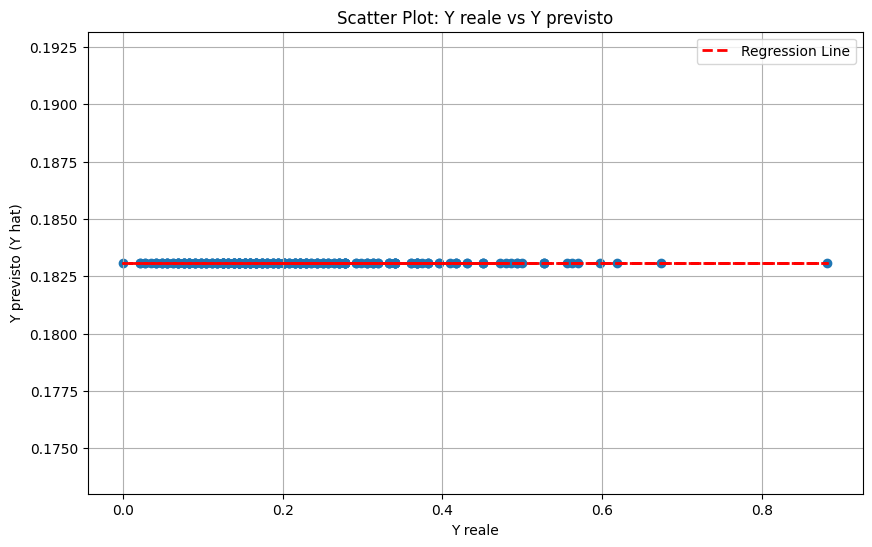

8/8 [==============================] - 0s 3ms/step

Model Completion: 39/144 (27.08%)
Saving data...
8/8 [==============================] - 0s 5ms/step
MAE (Iteration 10): 0.1
R-squared (R2) (Iteration 10): -0.1
RMSE (Iteration 10): 0.15


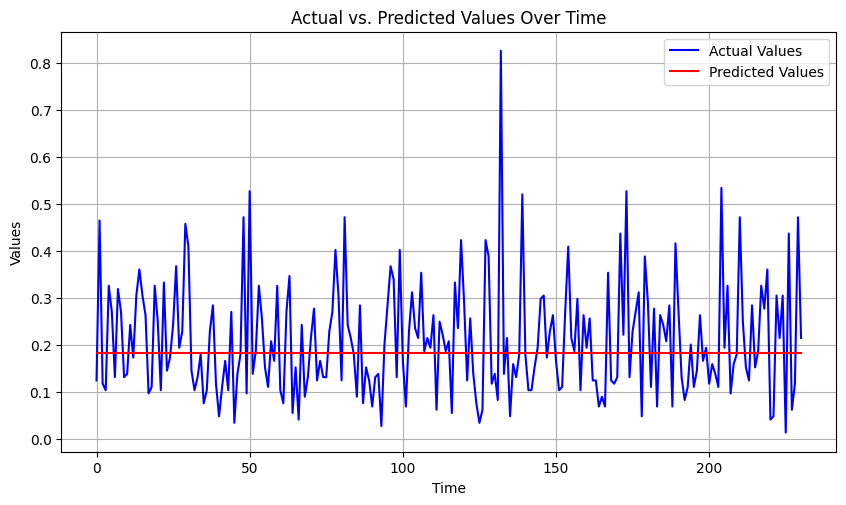

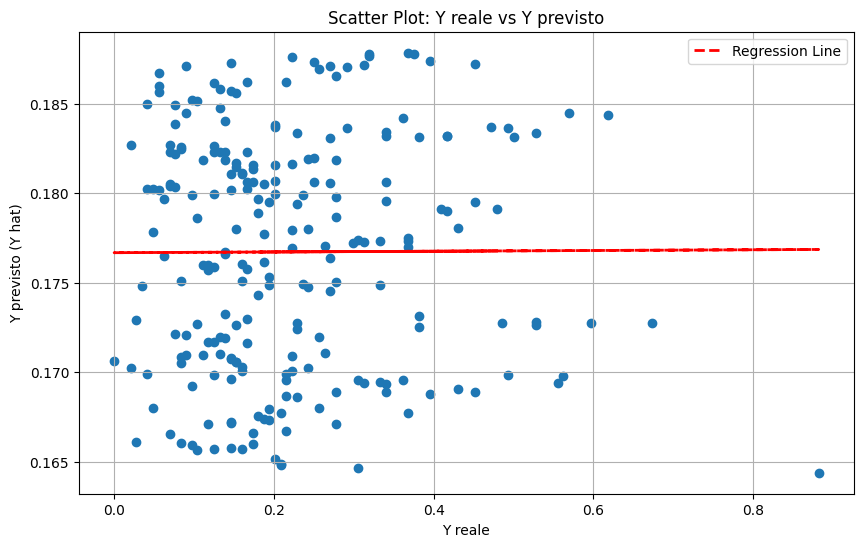

8/8 [==============================] - 0s 4ms/step

Model Completion: 40/144 (27.78%)
Saving data...
8/8 [==============================] - 0s 3ms/step
MAE (Iteration 11): 0.11
R-squared (R2) (Iteration 11): -0.0
RMSE (Iteration 11): 0.14


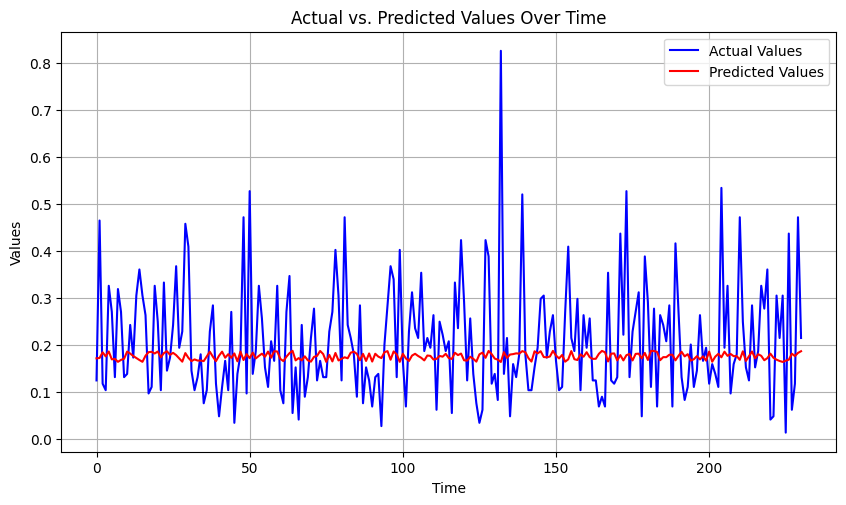

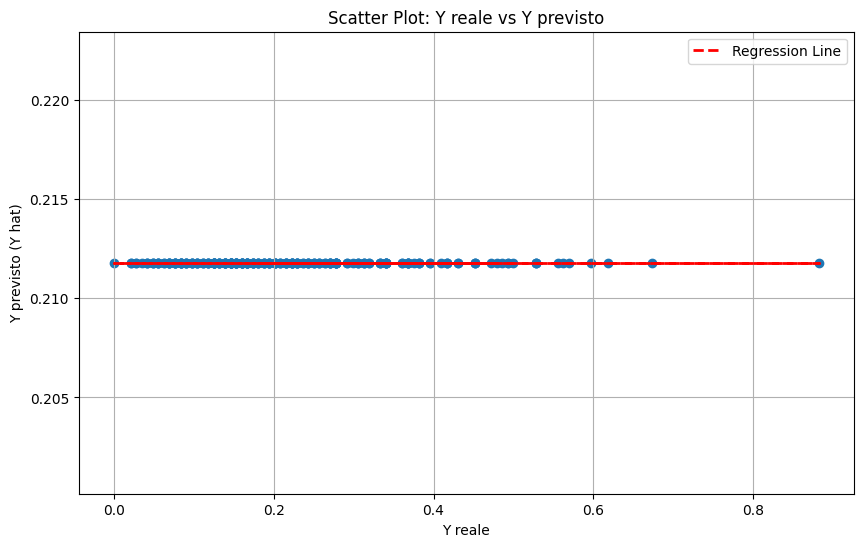

8/8 [==============================] - 0s 4ms/step

Model Completion: 41/144 (28.47%)
Saving data...
8/8 [==============================] - 0s 3ms/step
MAE (Iteration 12): 0.11
R-squared (R2) (Iteration 12): -0.01
RMSE (Iteration 12): 0.14


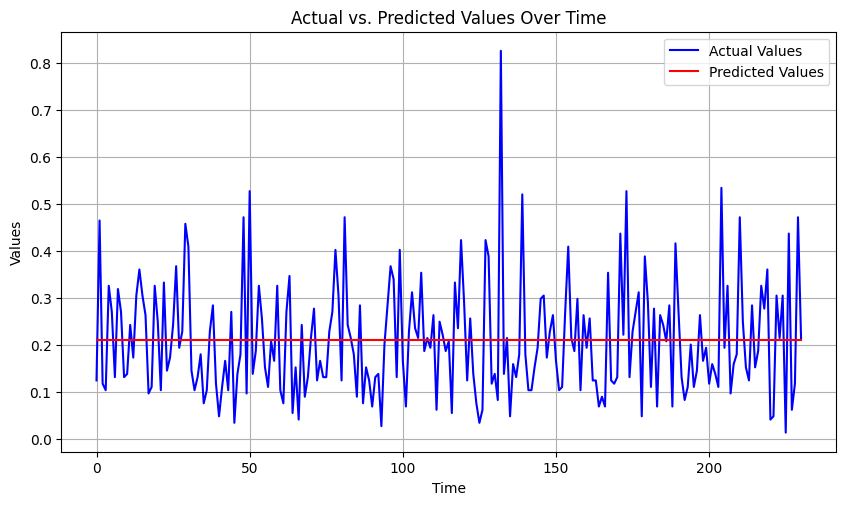

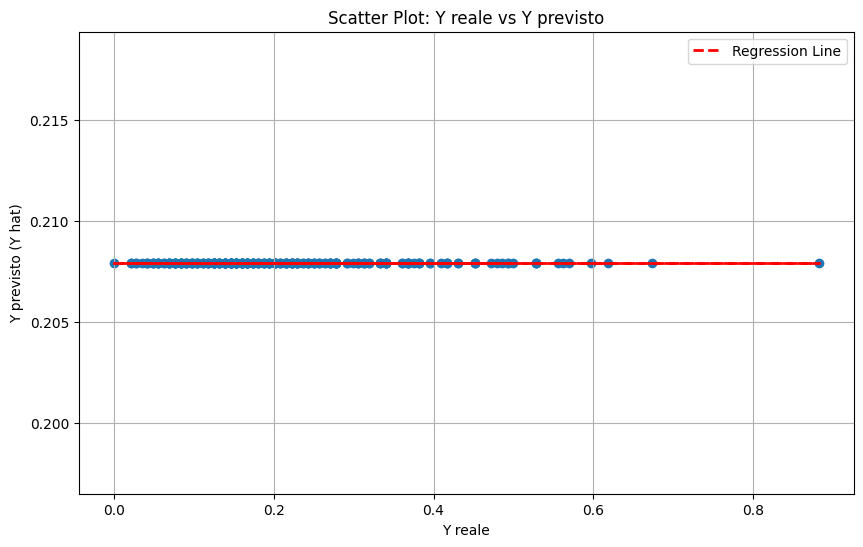

8/8 [==============================] - 0s 4ms/step

Model Completion: 42/144 (29.17%)
Saving data...
8/8 [==============================] - 0s 4ms/step
MAE (Iteration 13): 0.1
R-squared (R2) (Iteration 13): -0.03
RMSE (Iteration 13): 0.14


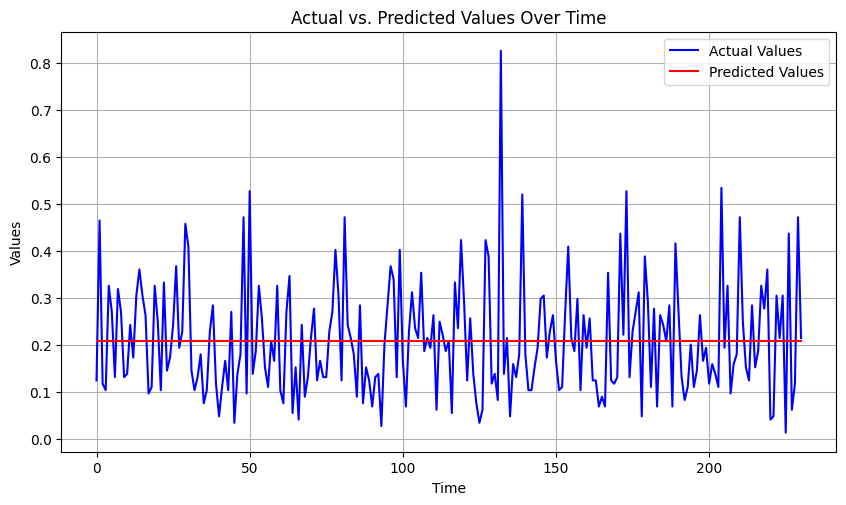

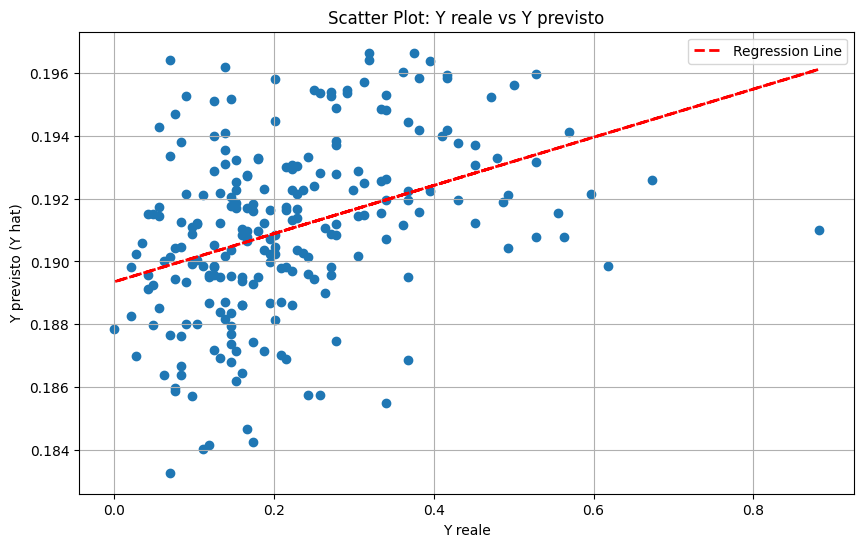

8/8 [==============================] - 0s 5ms/step

Model Completion: 43/144 (29.86%)
Saving data...
8/8 [==============================] - 0s 6ms/step
MAE (Iteration 14): 0.11
R-squared (R2) (Iteration 14): -0.16
RMSE (Iteration 14): 0.15


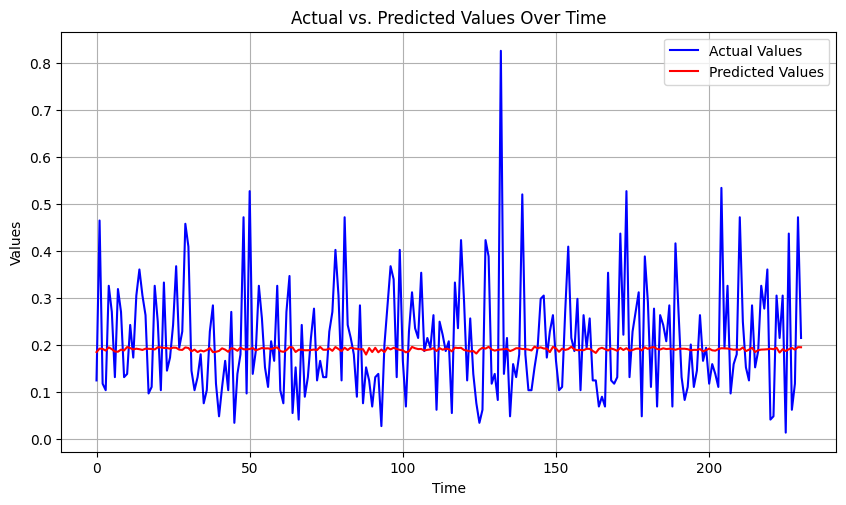

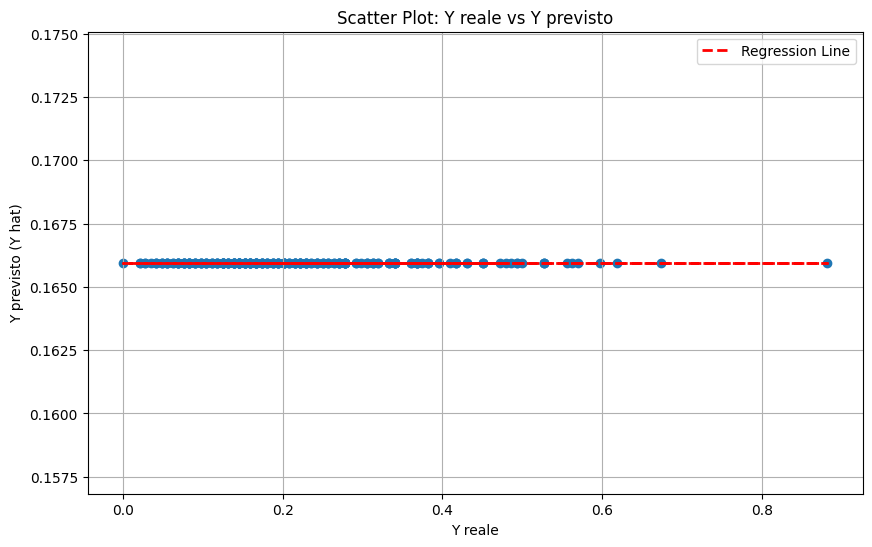

8/8 [==============================] - 0s 6ms/step

Model Completion: 44/144 (30.56%)
Saving data...
8/8 [==============================] - 0s 3ms/step
MAE (Iteration 15): 0.47
R-squared (R2) (Iteration 15): -10.85
RMSE (Iteration 15): 0.48


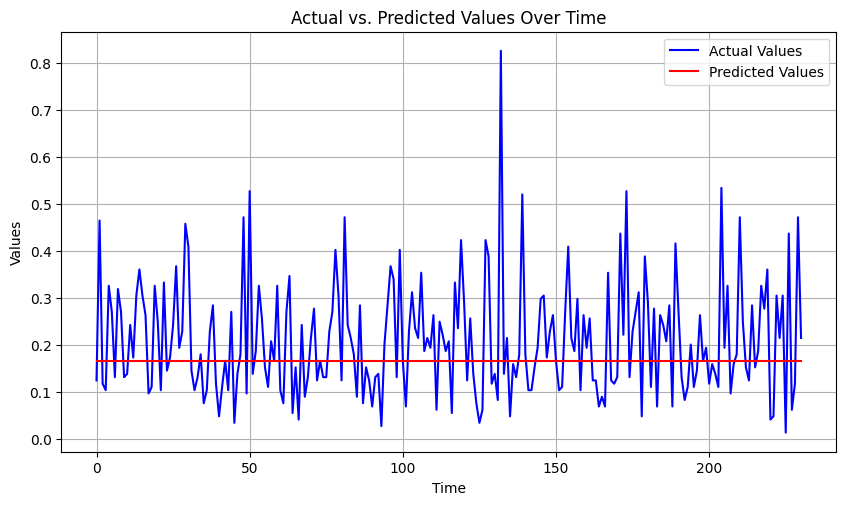

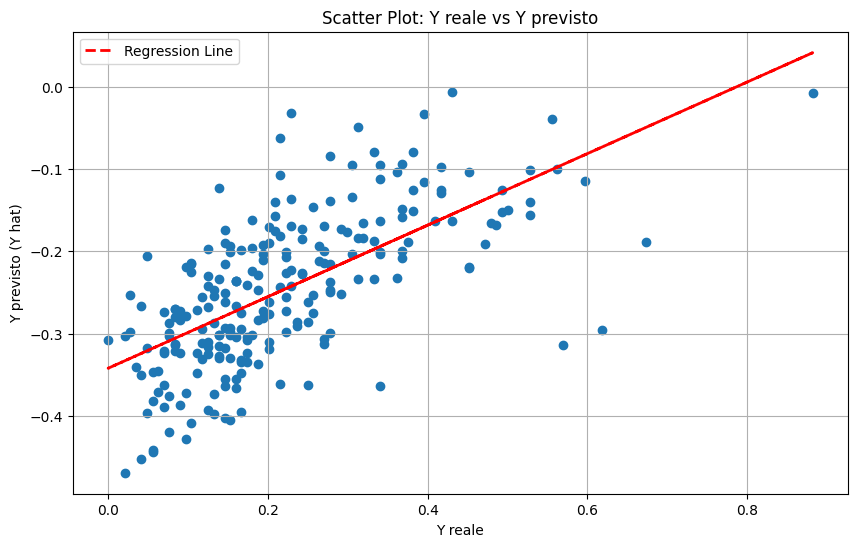

8/8 [==============================] - 0s 4ms/step

Model Completion: 45/144 (31.25%)
Saving data...
8/8 [==============================] - 0s 6ms/step
MAE (Iteration 16): 0.07
R-squared (R2) (Iteration 16): 0.46
RMSE (Iteration 16): 0.1


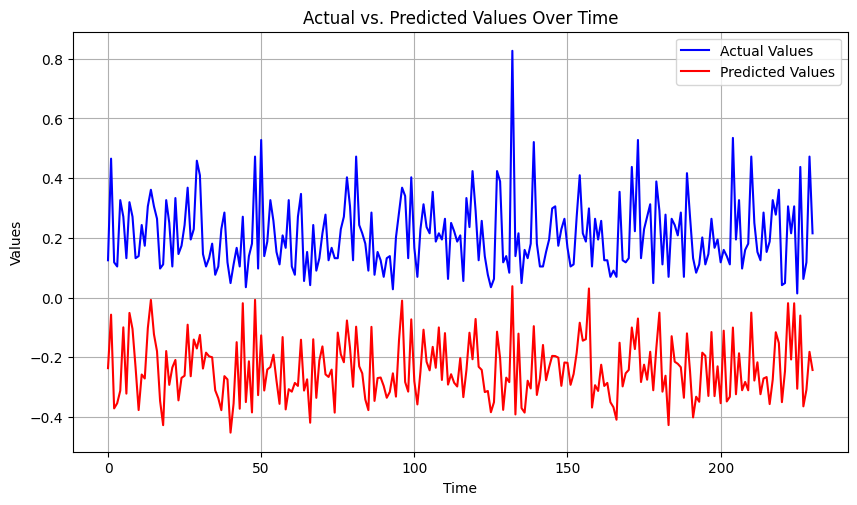

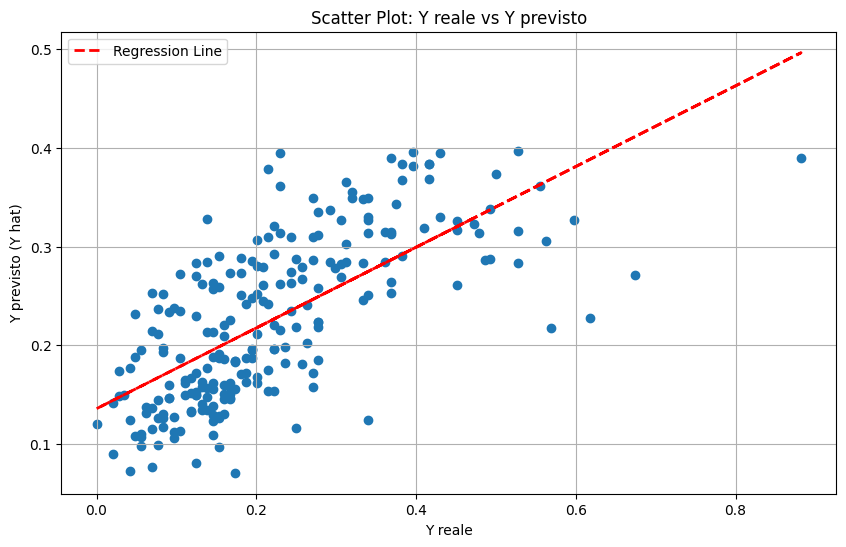

8/8 [==============================] - 0s 7ms/step

Model Completion: 46/144 (31.94%)
Saving data...
8/8 [==============================] - 0s 6ms/step
MAE (Iteration 17): 0.1
R-squared (R2) (Iteration 17): -0.08
RMSE (Iteration 17): 0.14


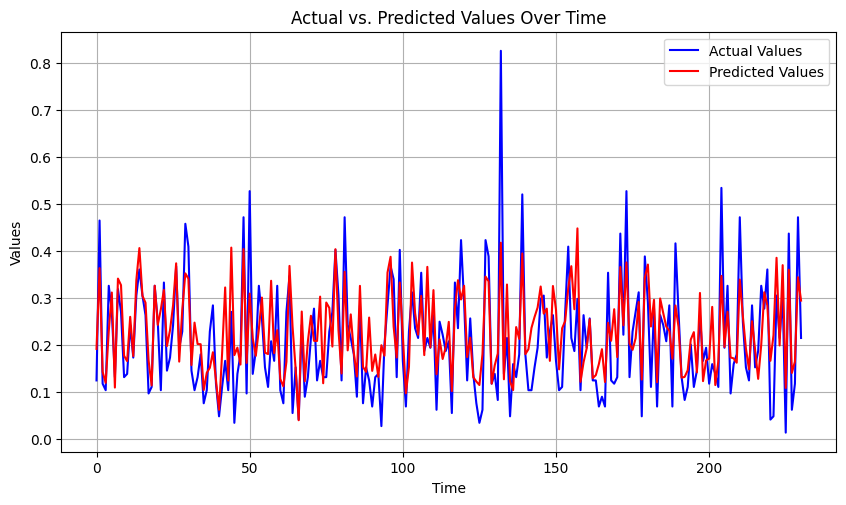

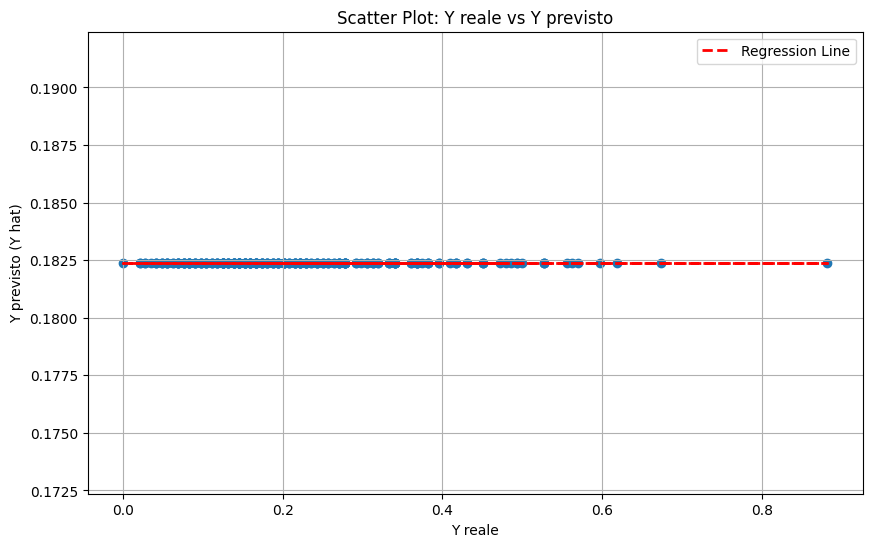

8/8 [==============================] - 0s 5ms/step

Model Completion: 47/144 (32.64%)
Saving data...
8/8 [==============================] - 0s 8ms/step
MAE (Iteration 18): 0.27
R-squared (R2) (Iteration 18): -3.25
RMSE (Iteration 18): 0.29


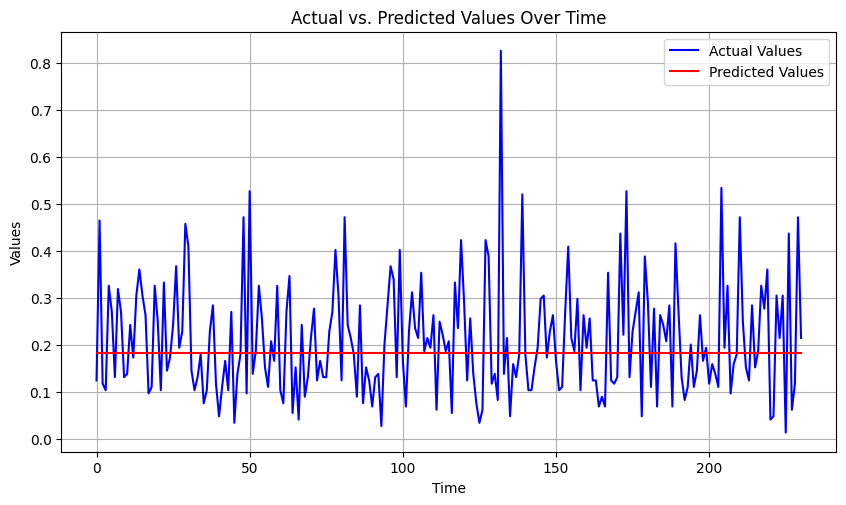

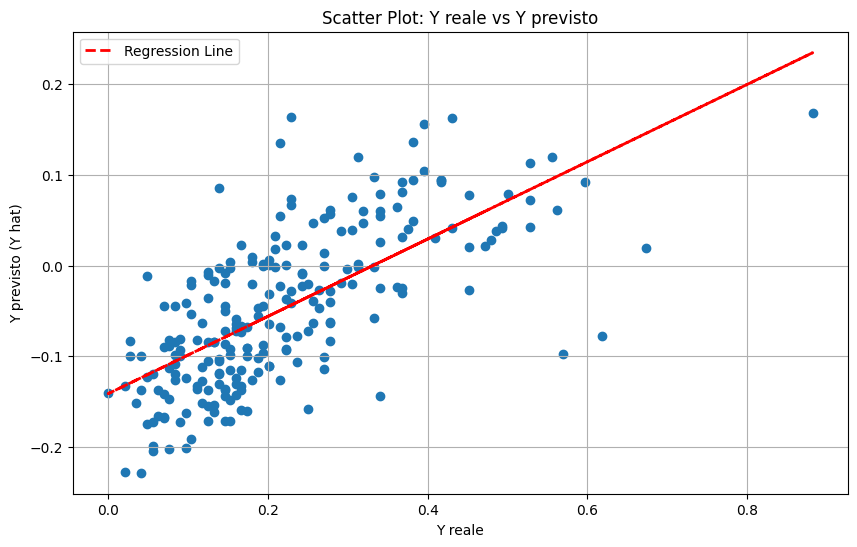

8/8 [==============================] - 0s 6ms/step

Model Completion: 48/144 (33.33%)
Saving data...
8/8 [==============================] - 0s 6ms/step
MAE (Iteration 19): 0.6
R-squared (R2) (Iteration 19): -18.94
RMSE (Iteration 19): 0.62


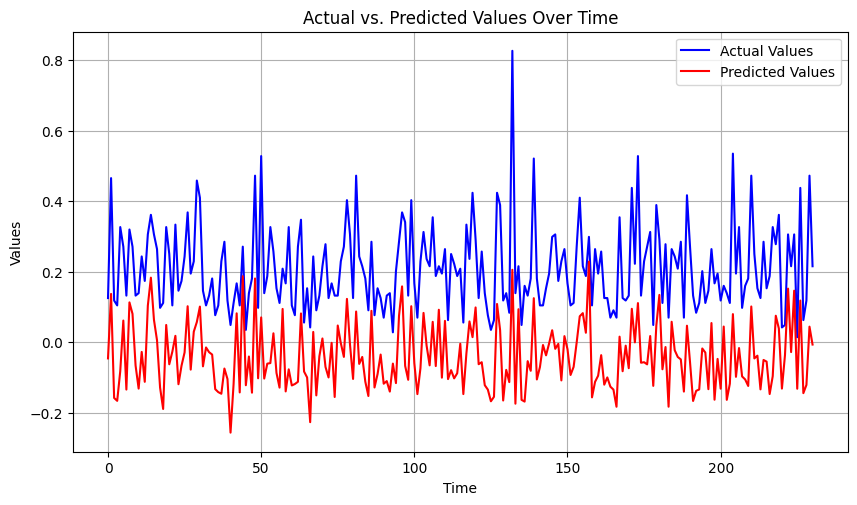

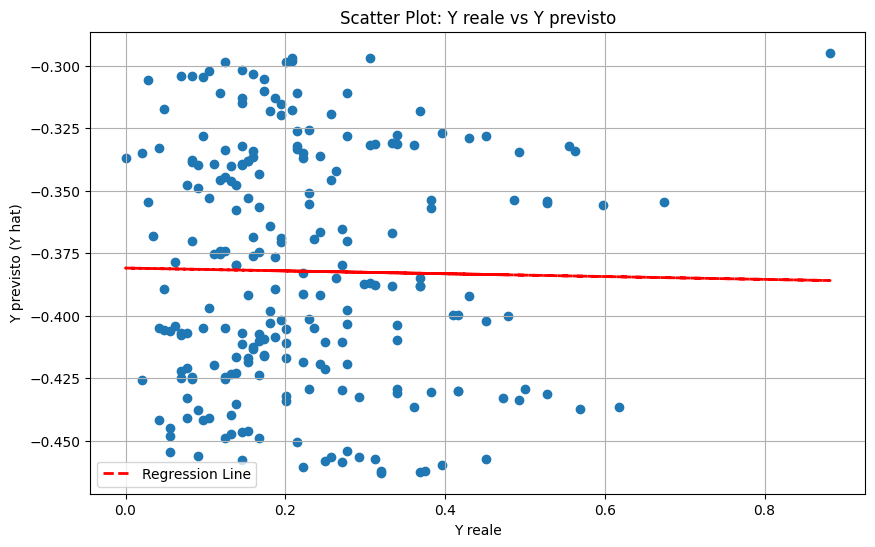

8/8 [==============================] - 0s 6ms/step

Model Completion: 49/144 (34.03%)
Saving data...
8/8 [==============================] - 0s 6ms/step
MAE (Iteration 20): 0.26
R-squared (R2) (Iteration 20): -3.1
RMSE (Iteration 20): 0.28


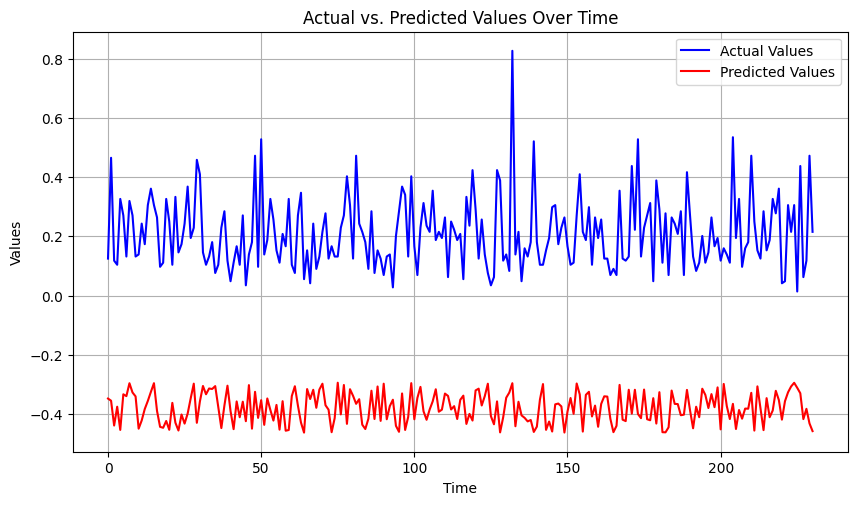

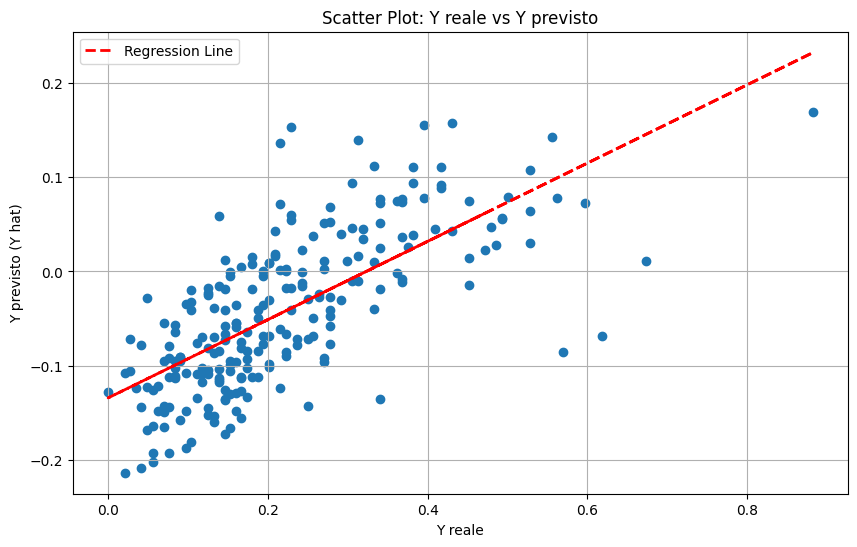

8/8 [==============================] - 0s 5ms/step

Model Completion: 50/144 (34.72%)
Saving data...
8/8 [==============================] - 0s 7ms/step
MAE (Iteration 21): 0.11
R-squared (R2) (Iteration 21): -0.21
RMSE (Iteration 21): 0.15


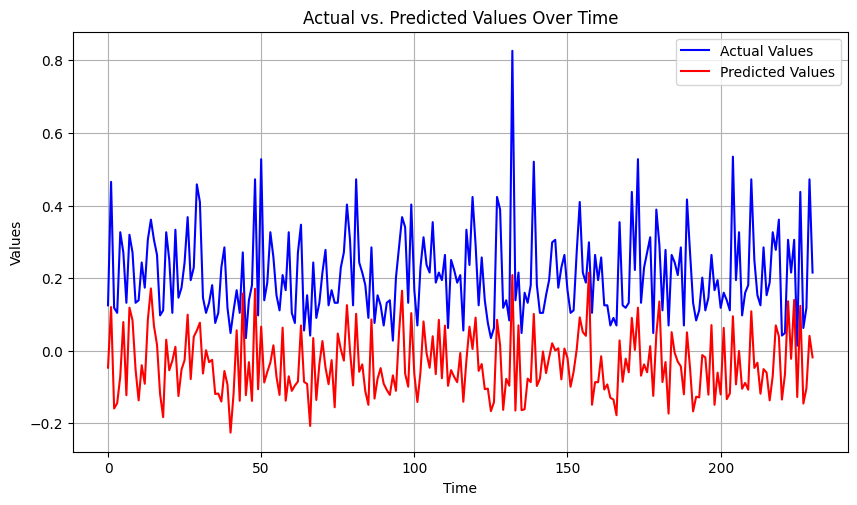

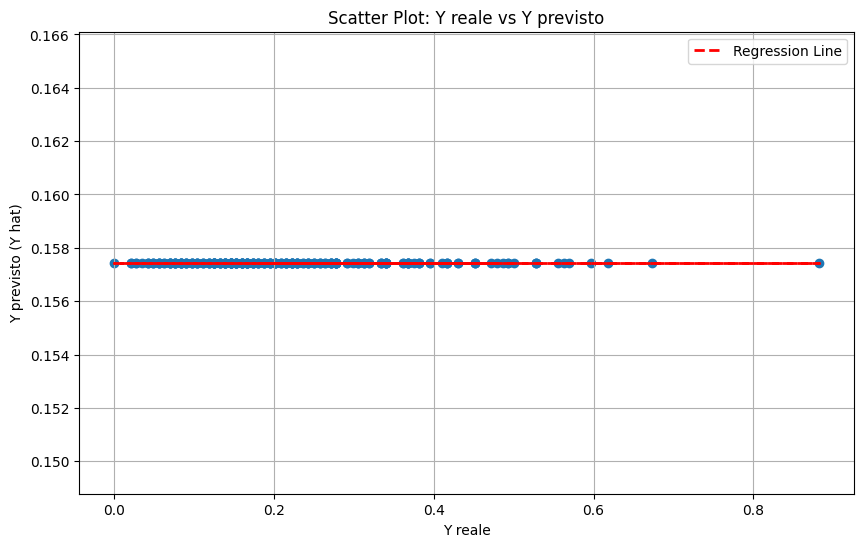

8/8 [==============================] - 0s 6ms/step

Model Completion: 51/144 (35.42%)
Saving data...
8/8 [==============================] - 0s 4ms/step
MAE (Iteration 22): 0.11
R-squared (R2) (Iteration 22): -0.29
RMSE (Iteration 22): 0.16


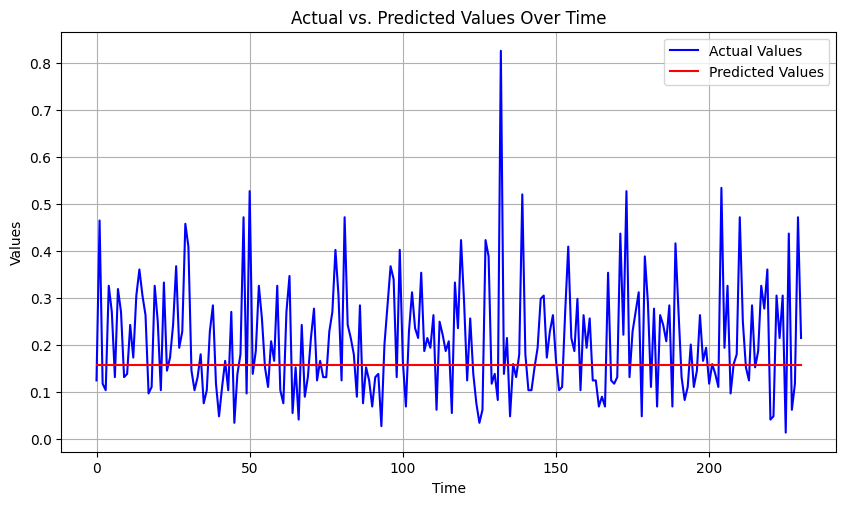

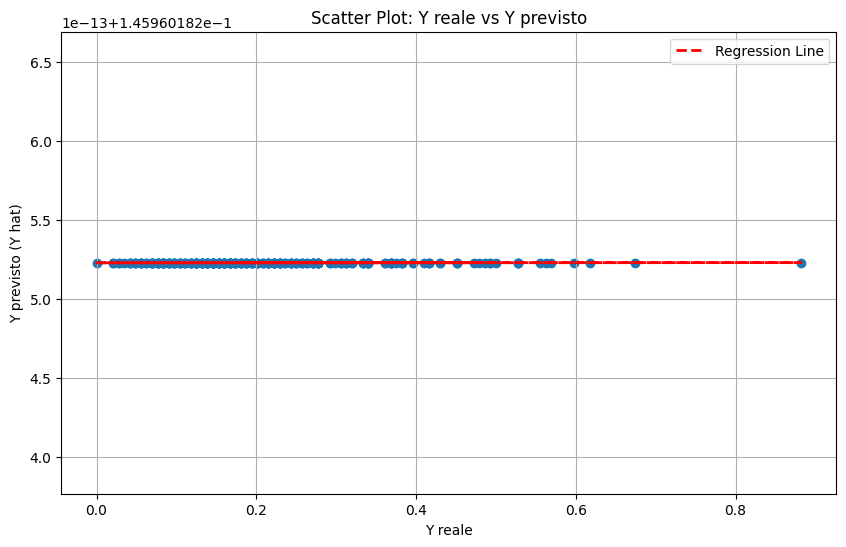

8/8 [==============================] - 0s 5ms/step

Model Completion: 52/144 (36.11%)
Saving data...
8/8 [==============================] - 0s 4ms/step
MAE (Iteration 23): 0.11
R-squared (R2) (Iteration 23): -0.01
RMSE (Iteration 23): 0.14


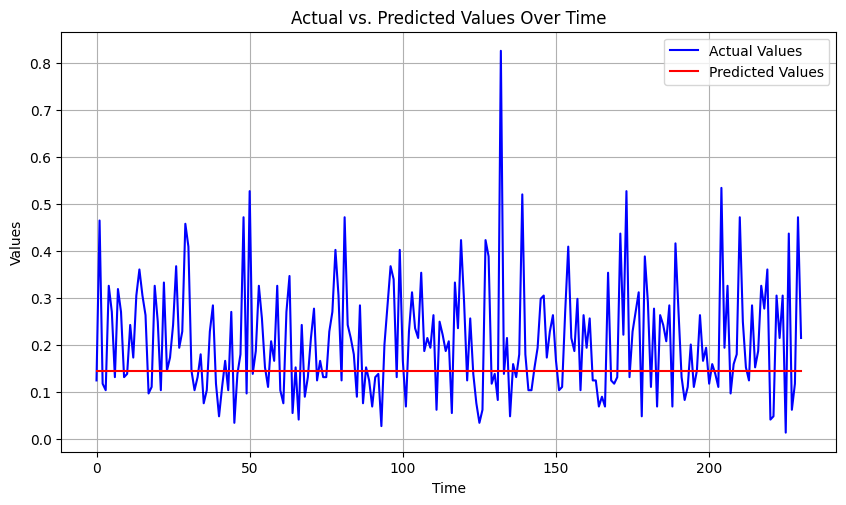

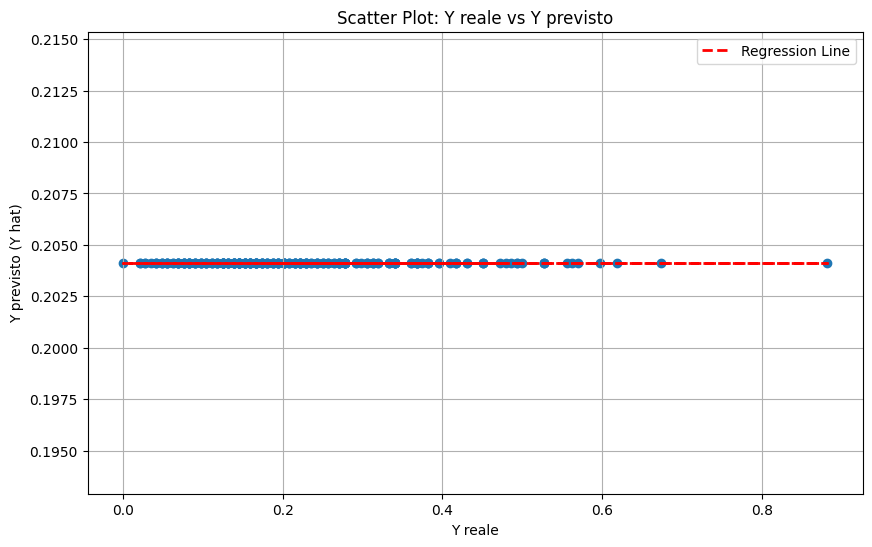

8/8 [==============================] - 0s 8ms/step

Model Completion: 53/144 (36.81%)
Saving data...
8/8 [==============================] - 0s 9ms/step
MAE (Iteration 24): 0.11
R-squared (R2) (Iteration 24): -0.01
RMSE (Iteration 24): 0.14


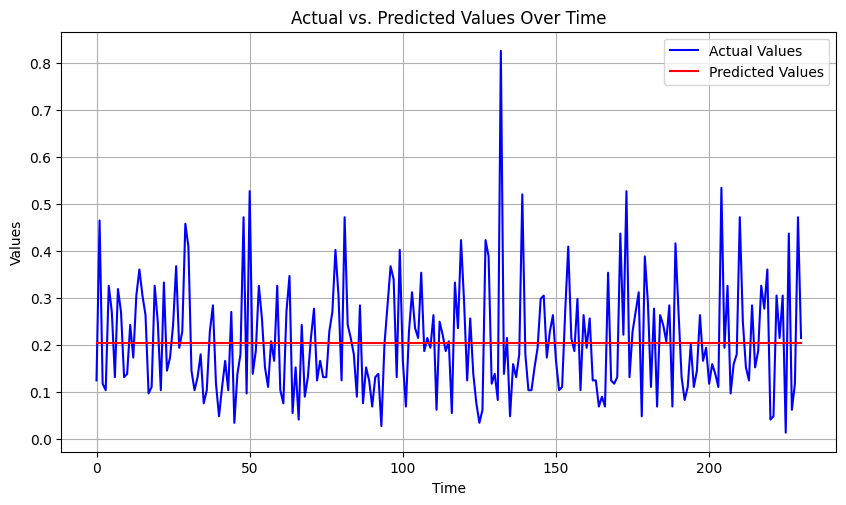

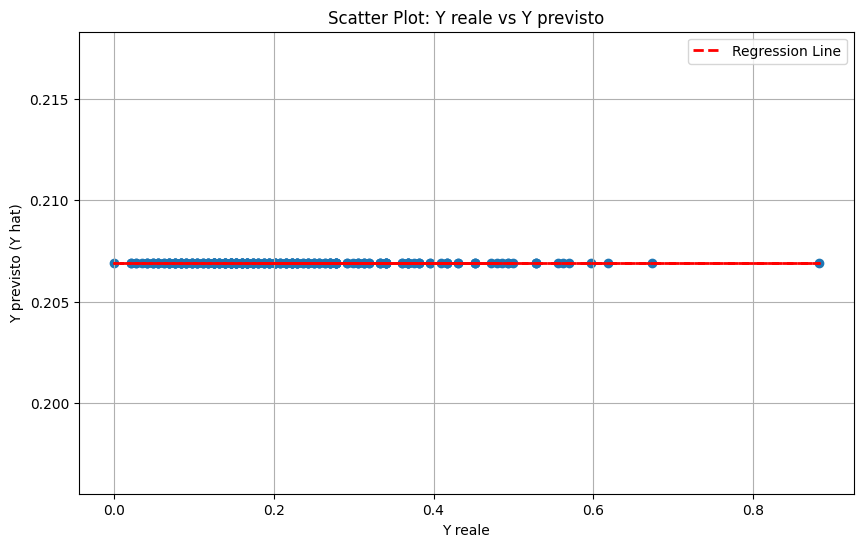

8/8 [==============================] - 0s 8ms/step

Model Completion: 54/144 (37.50%)
Saving data...
8/8 [==============================] - 0s 6ms/step
MAE (Iteration 25): 0.1
R-squared (R2) (Iteration 25): -0.07
RMSE (Iteration 25): 0.14


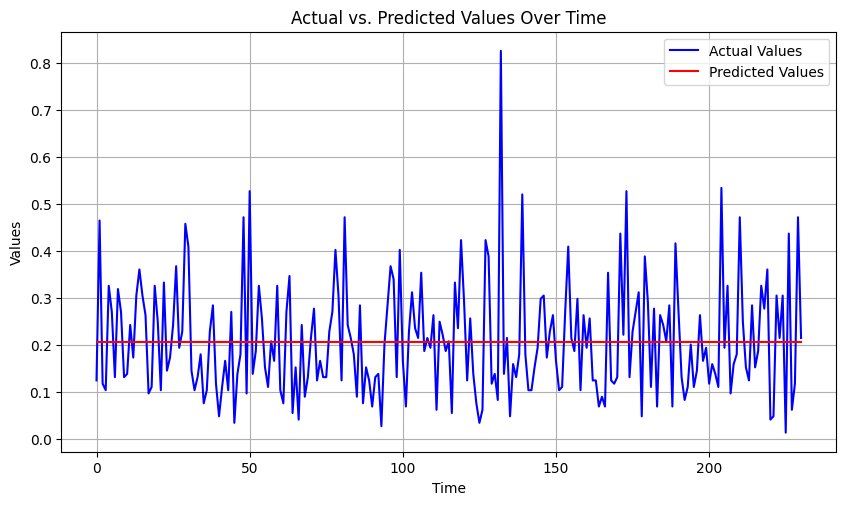

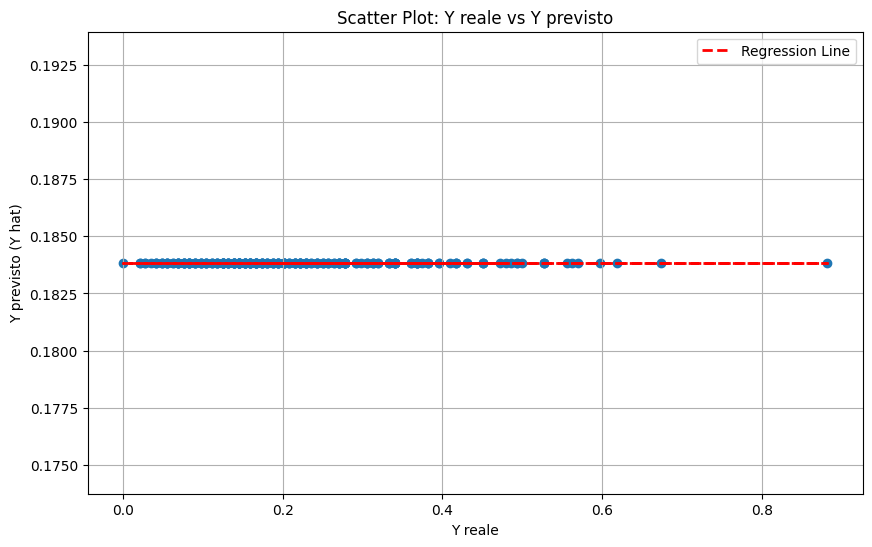

8/8 [==============================] - 0s 5ms/step

Model Completion: 55/144 (38.19%)
Saving data...
8/8 [==============================] - 0s 4ms/step
MAE (Iteration 26): 0.36
R-squared (R2) (Iteration 26): -6.11
RMSE (Iteration 26): 0.37


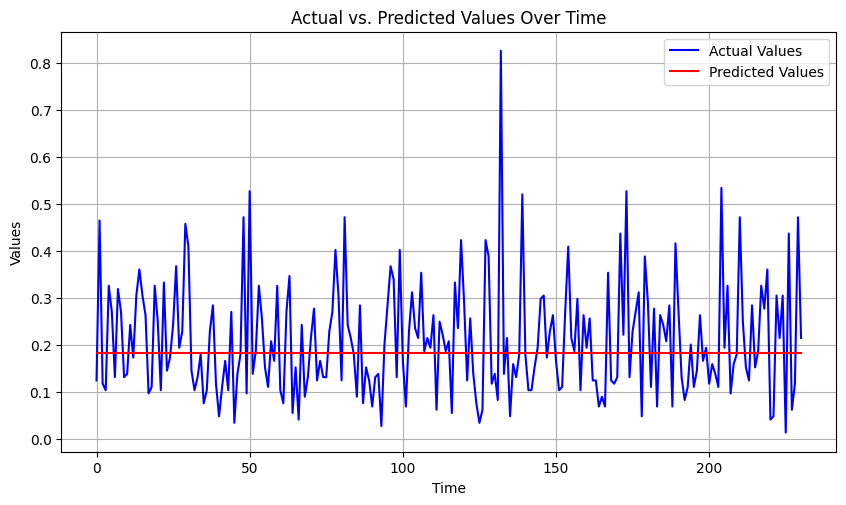

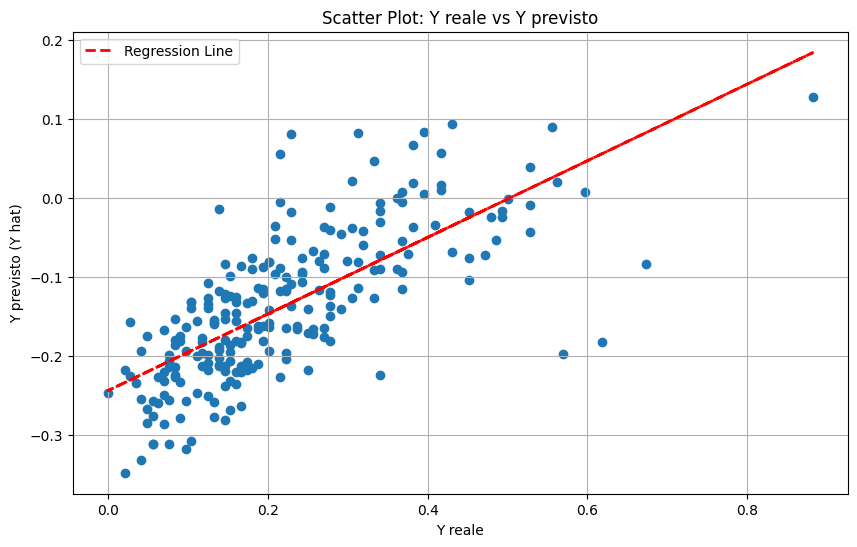

8/8 [==============================] - 0s 3ms/step

Model Completion: 56/144 (38.89%)
Saving data...
8/8 [==============================] - 0s 4ms/step
MAE (Iteration 27): 0.11
R-squared (R2) (Iteration 27): -0.01
RMSE (Iteration 27): 0.14


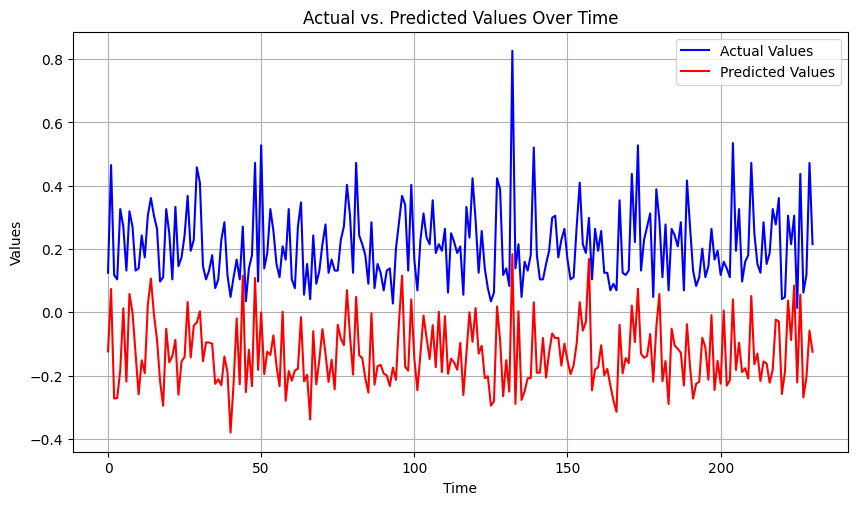

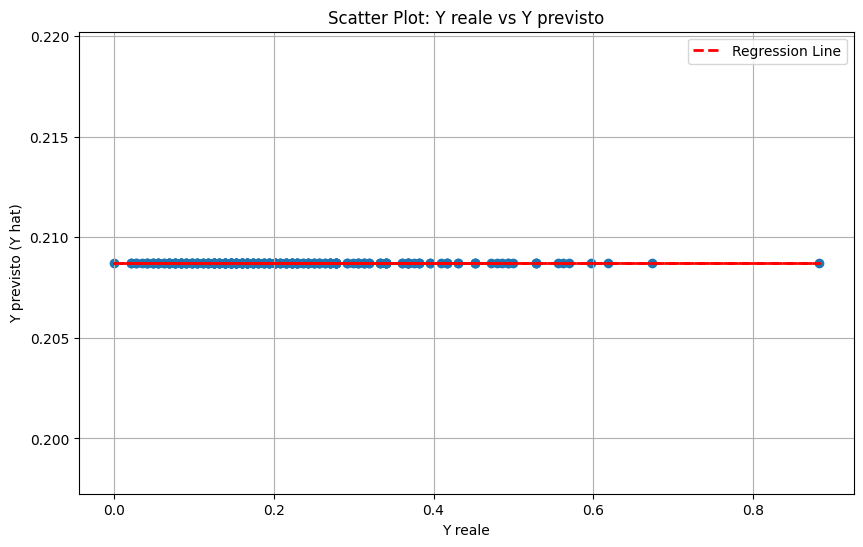

8/8 [==============================] - 0s 4ms/step

Model Completion: 57/144 (39.58%)
Saving data...
8/8 [==============================] - 0s 5ms/step
MAE (Iteration 28): 0.45
R-squared (R2) (Iteration 28): -9.81
RMSE (Iteration 28): 0.46


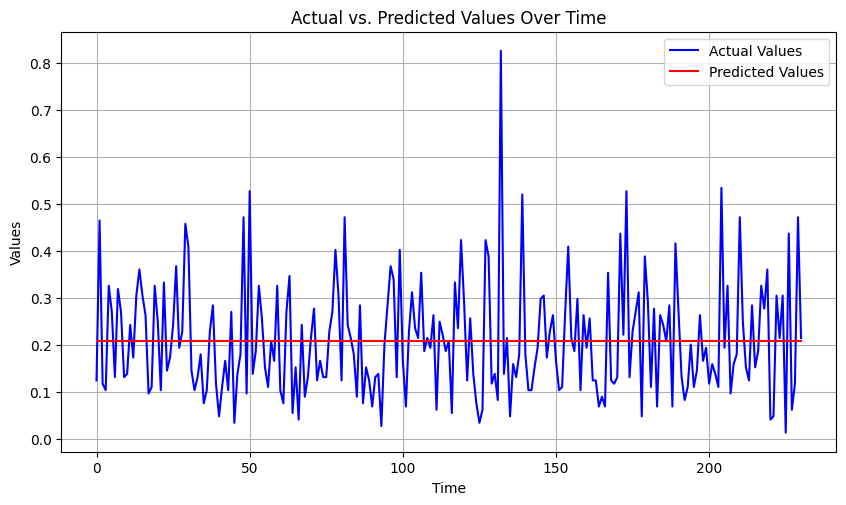

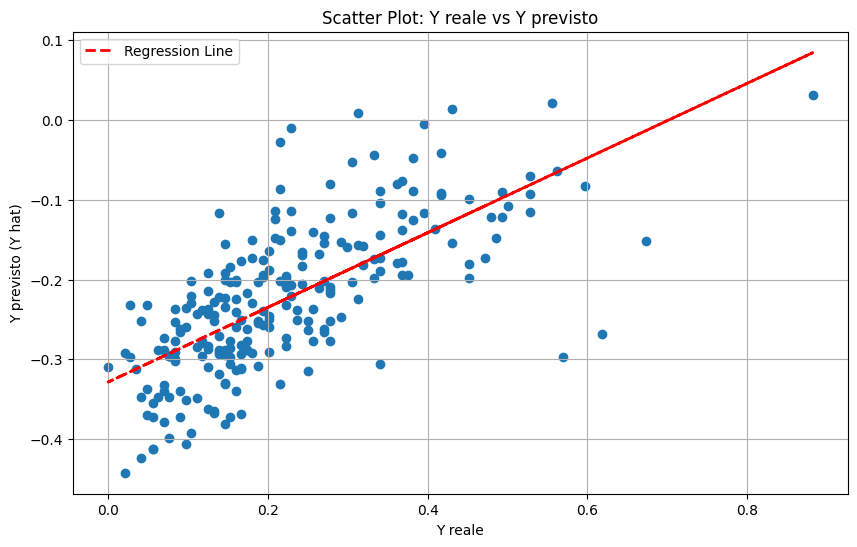

8/8 [==============================] - 0s 5ms/step

Model Completion: 58/144 (40.28%)
Saving data...
8/8 [==============================] - 0s 5ms/step
MAE (Iteration 29): 0.1
R-squared (R2) (Iteration 29): 0.14
RMSE (Iteration 29): 0.13


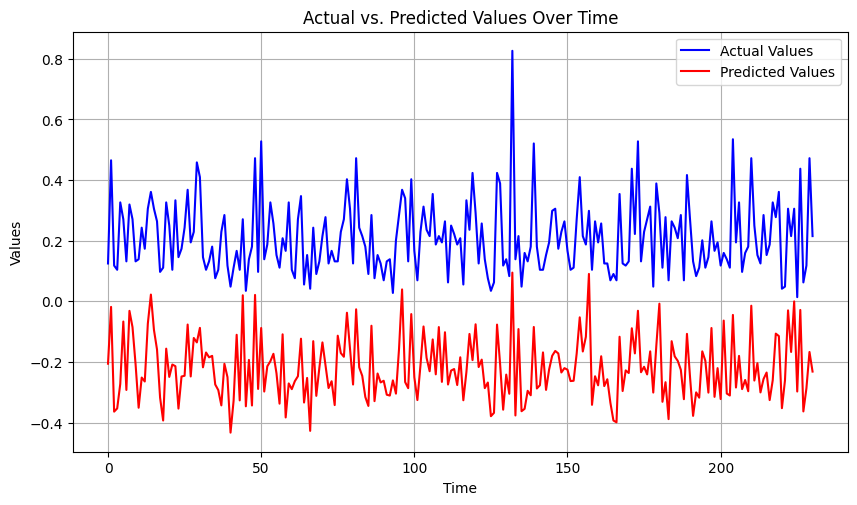

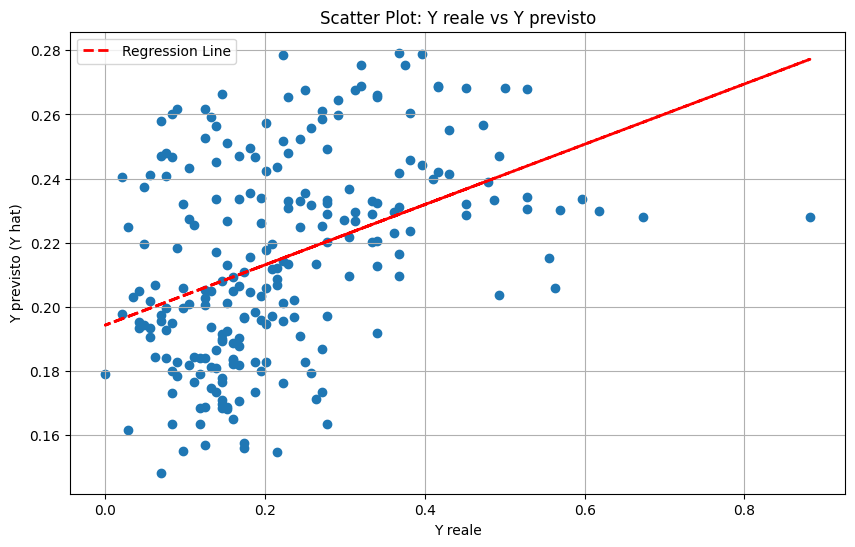

8/8 [==============================] - 0s 4ms/step

Model Completion: 59/144 (40.97%)
Saving data...
8/8 [==============================] - 0s 5ms/step
MAE (Iteration 30): 0.08
R-squared (R2) (Iteration 30): 0.37
RMSE (Iteration 30): 0.11


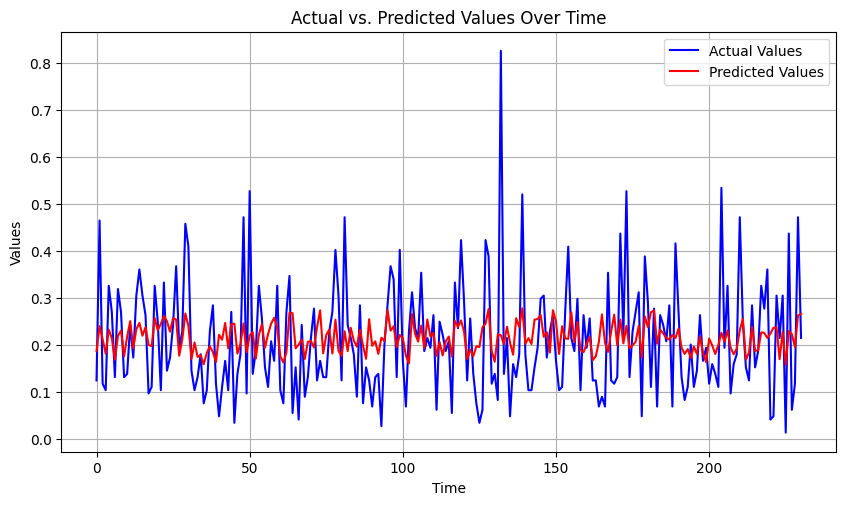

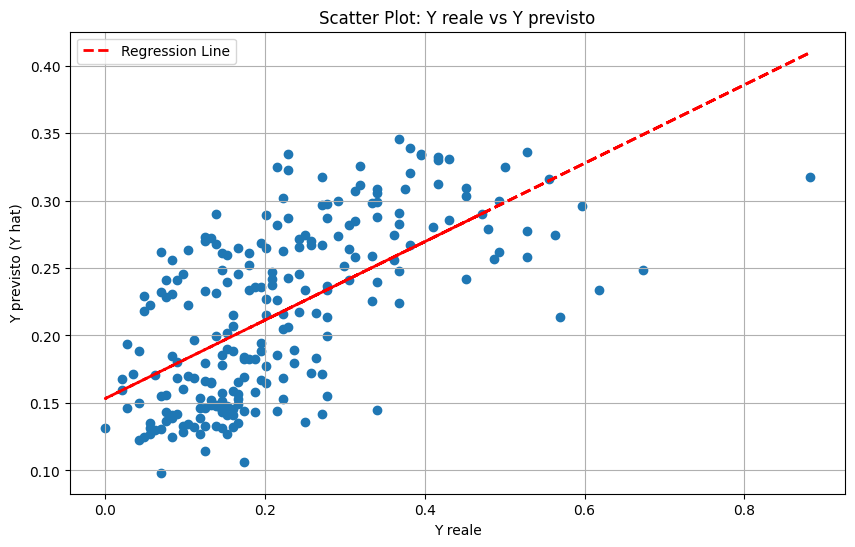

8/8 [==============================] - 0s 6ms/step

Model Completion: 60/144 (41.67%)
Saving data...
Number of Iterations: 40
8/8 [==============================] - 0s 3ms/step
MAE (Iteration 1): 0.08
R-squared (R2) (Iteration 1): 0.33
RMSE (Iteration 1): 0.11


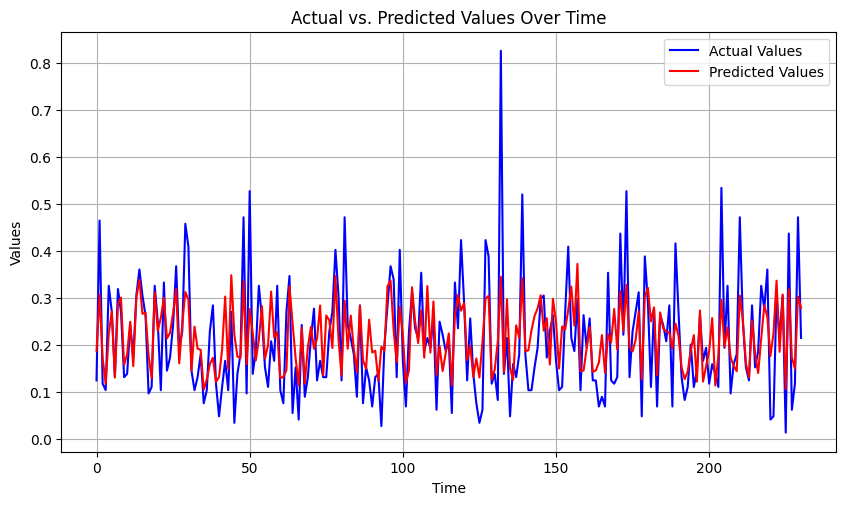

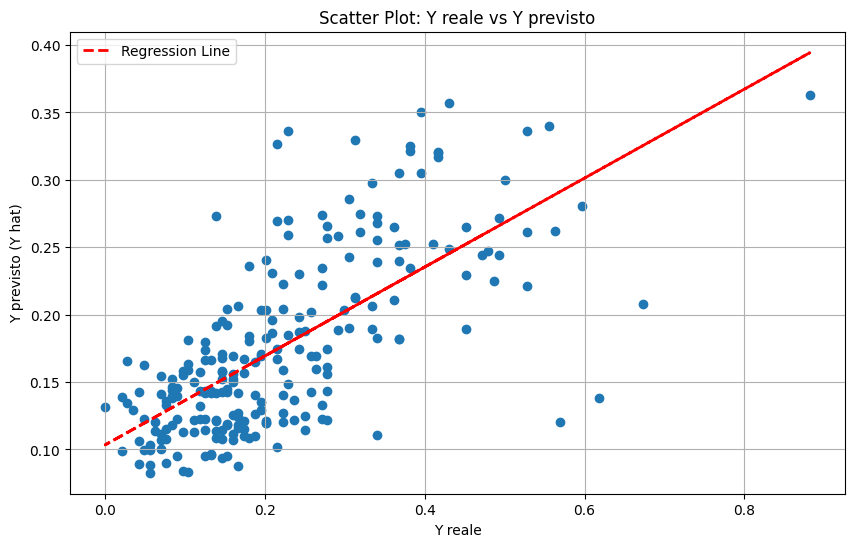

8/8 [==============================] - 0s 4ms/step

Model Completion: 61/144 (42.36%)
Saving data...
8/8 [==============================] - 0s 6ms/step
MAE (Iteration 2): 0.19
R-squared (R2) (Iteration 2): -1.32
RMSE (Iteration 2): 0.21


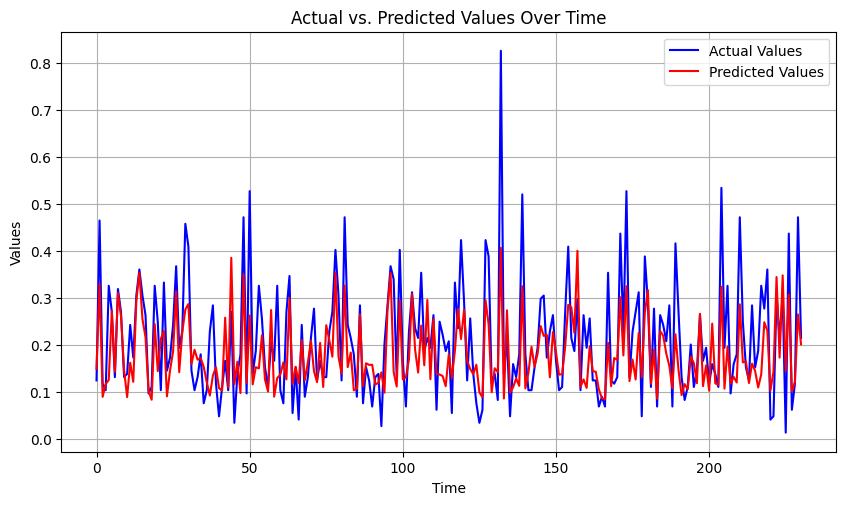

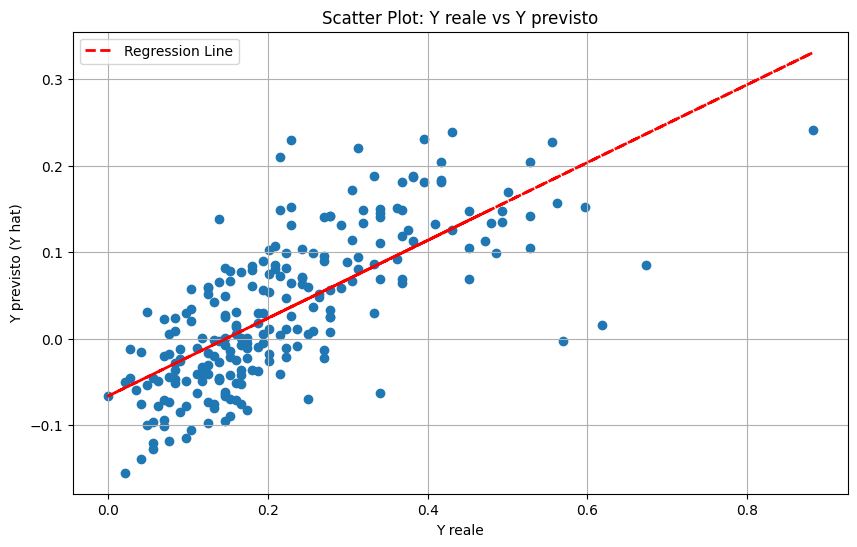

8/8 [==============================] - 0s 8ms/step

Model Completion: 62/144 (43.06%)
Saving data...
8/8 [==============================] - 0s 6ms/step
MAE (Iteration 3): 0.06
R-squared (R2) (Iteration 3): 0.55
RMSE (Iteration 3): 0.09


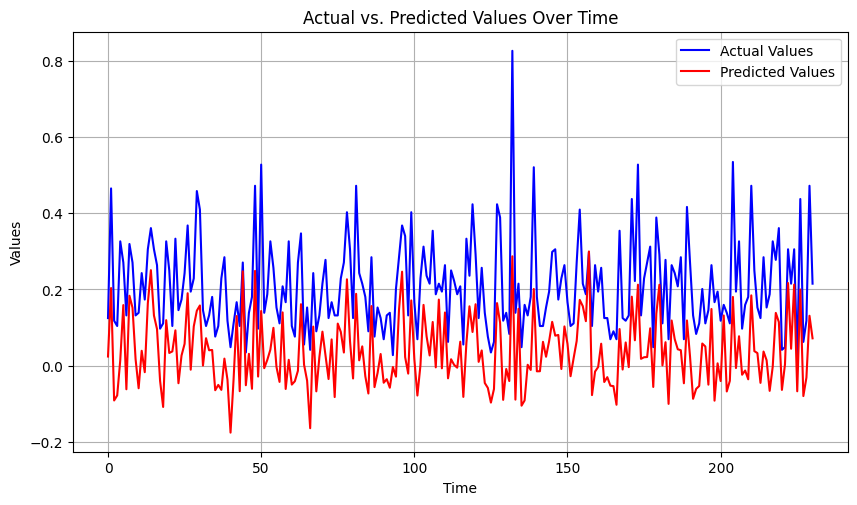

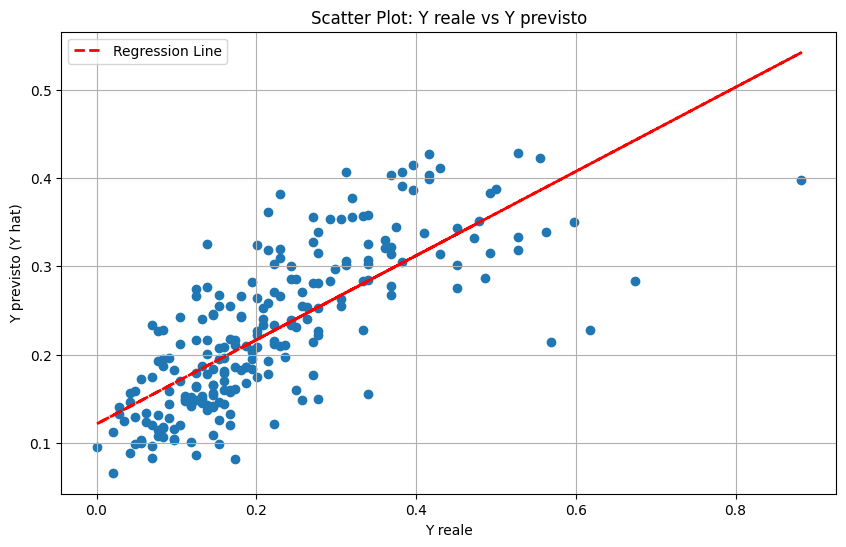

8/8 [==============================] - 0s 5ms/step

Model Completion: 63/144 (43.75%)
Saving data...
8/8 [==============================] - 0s 4ms/step
MAE (Iteration 4): 0.4
R-squared (R2) (Iteration 4): -7.97
RMSE (Iteration 4): 0.42


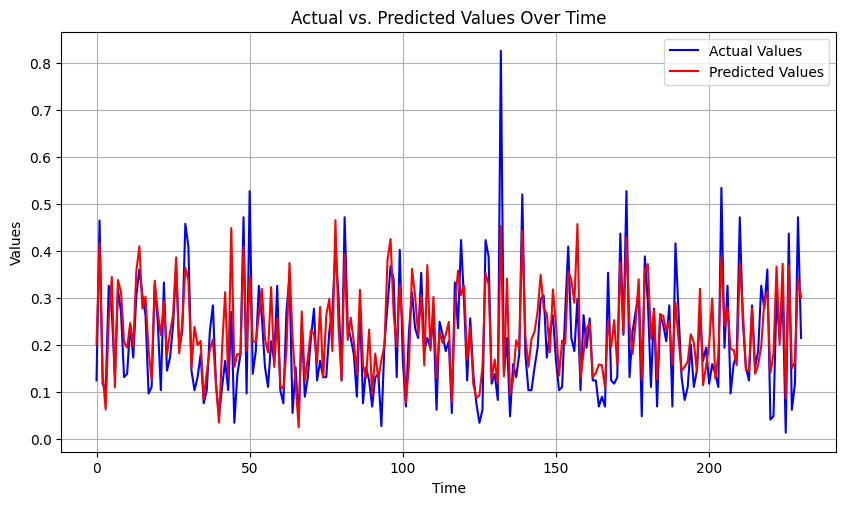

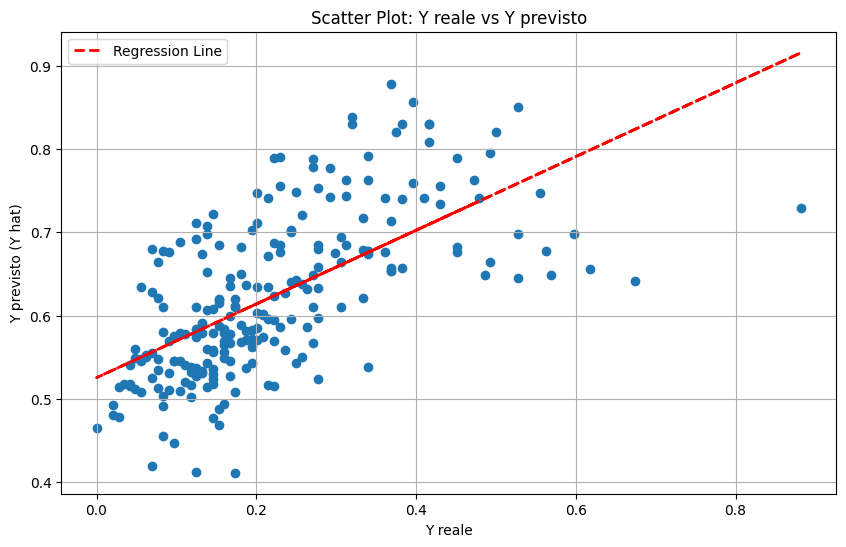

8/8 [==============================] - 0s 7ms/step

Model Completion: 64/144 (44.44%)
Saving data...
8/8 [==============================] - 0s 4ms/step
MAE (Iteration 5): 0.1
R-squared (R2) (Iteration 5): -0.08
RMSE (Iteration 5): 0.14


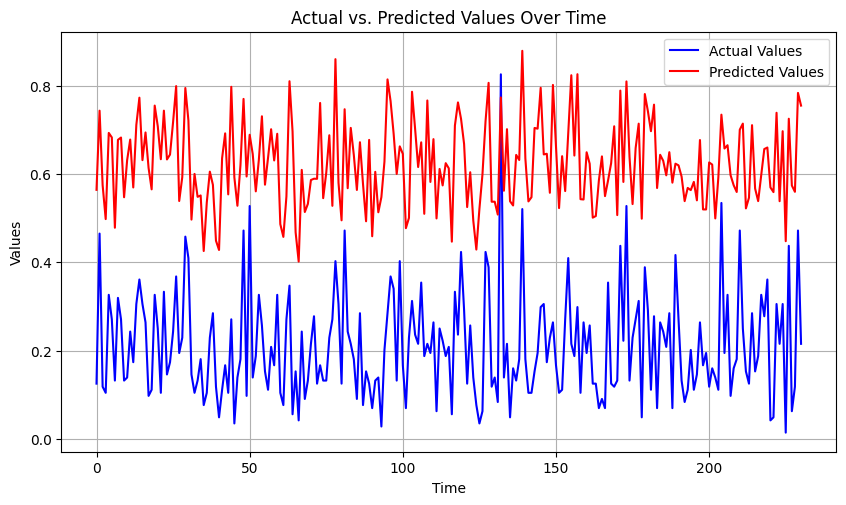

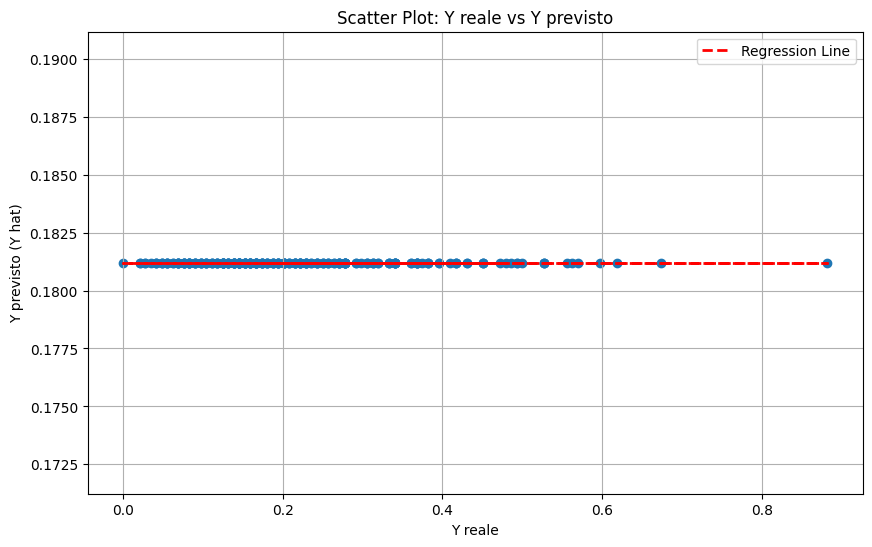

8/8 [==============================] - 0s 4ms/step

Model Completion: 65/144 (45.14%)
Saving data...
8/8 [==============================] - 0s 5ms/step
MAE (Iteration 6): 0.11
R-squared (R2) (Iteration 6): -0.0
RMSE (Iteration 6): 0.14


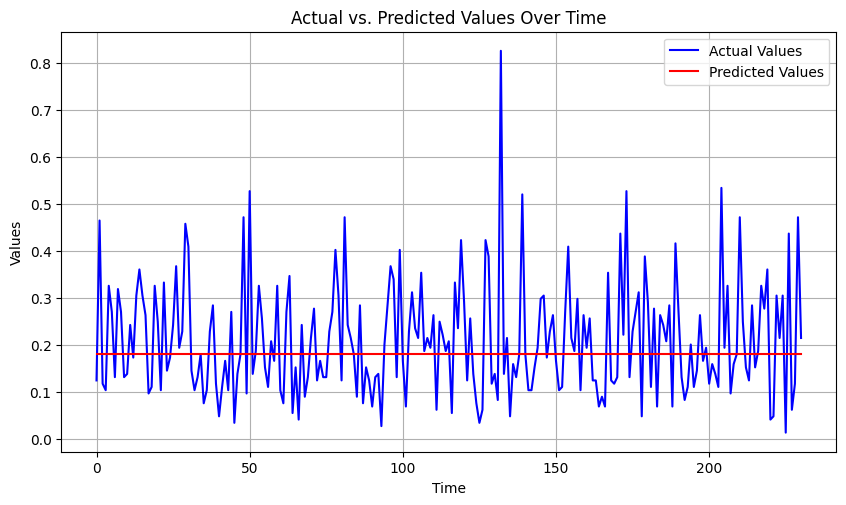

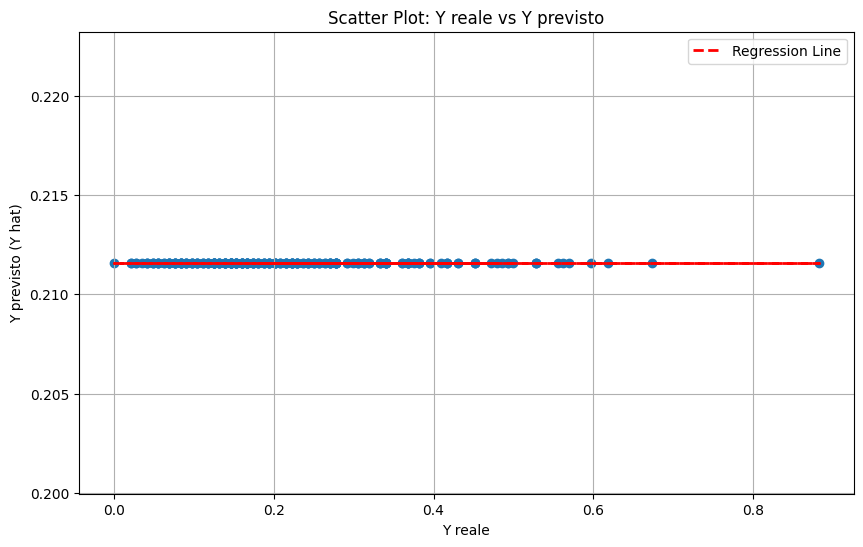

8/8 [==============================] - 0s 6ms/step

Model Completion: 66/144 (45.83%)
Saving data...
8/8 [==============================] - 0s 4ms/step
MAE (Iteration 7): 0.1
R-squared (R2) (Iteration 7): -0.07
RMSE (Iteration 7): 0.14


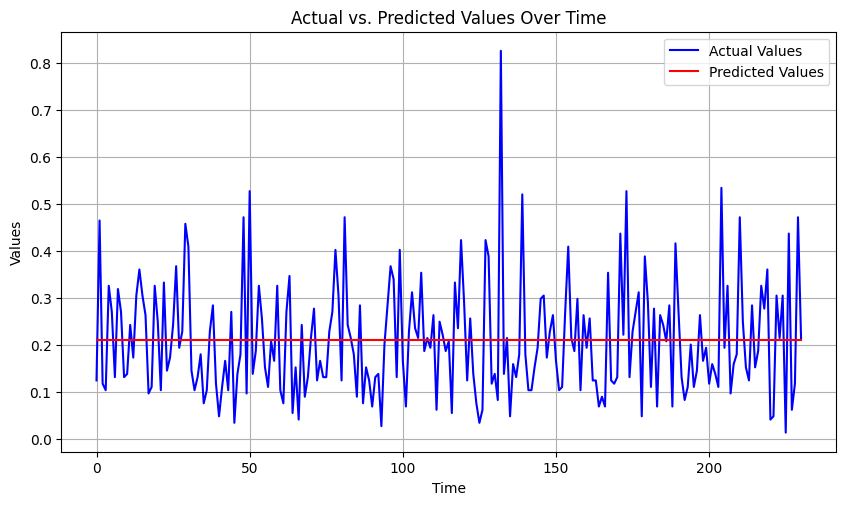

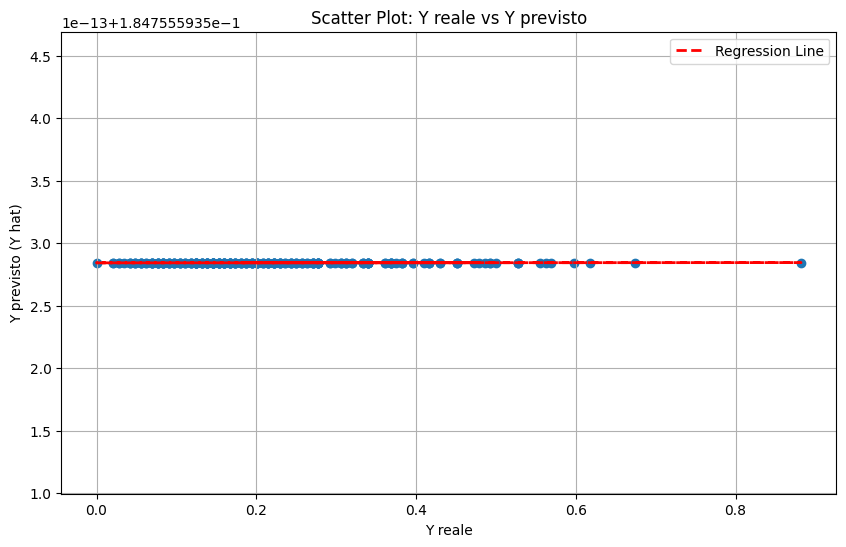

8/8 [==============================] - 0s 4ms/step

Model Completion: 67/144 (46.53%)
Saving data...
8/8 [==============================] - 0s 5ms/step
MAE (Iteration 8): 0.22
R-squared (R2) (Iteration 8): -2.08
RMSE (Iteration 8): 0.24


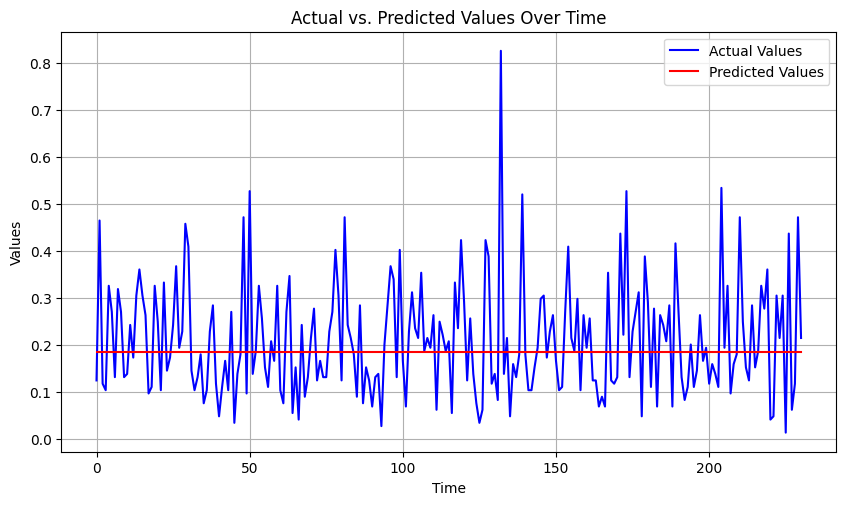

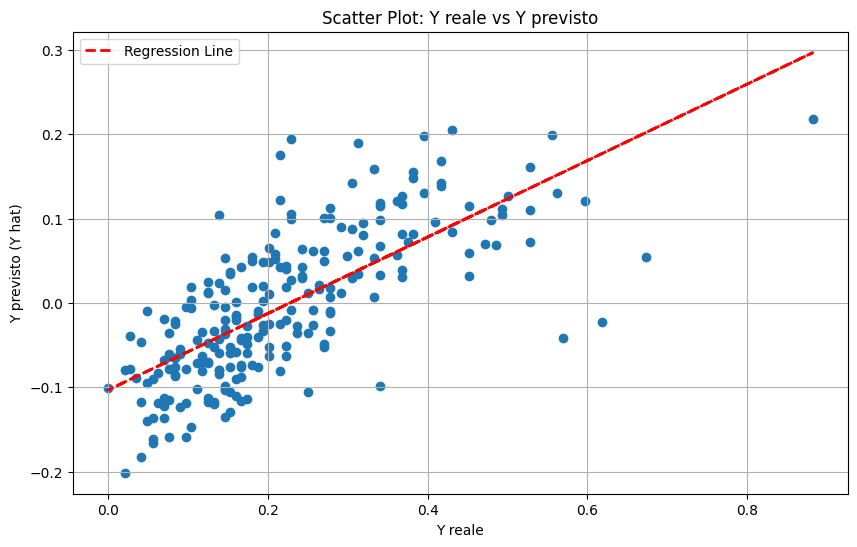

8/8 [==============================] - 0s 5ms/step

Model Completion: 68/144 (47.22%)
Saving data...
8/8 [==============================] - 0s 6ms/step
MAE (Iteration 9): 0.41
R-squared (R2) (Iteration 9): -8.05
RMSE (Iteration 9): 0.42


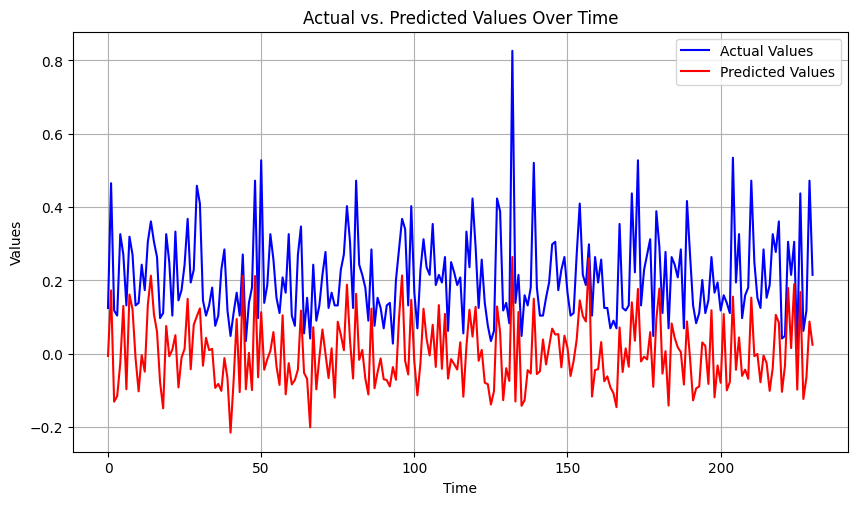

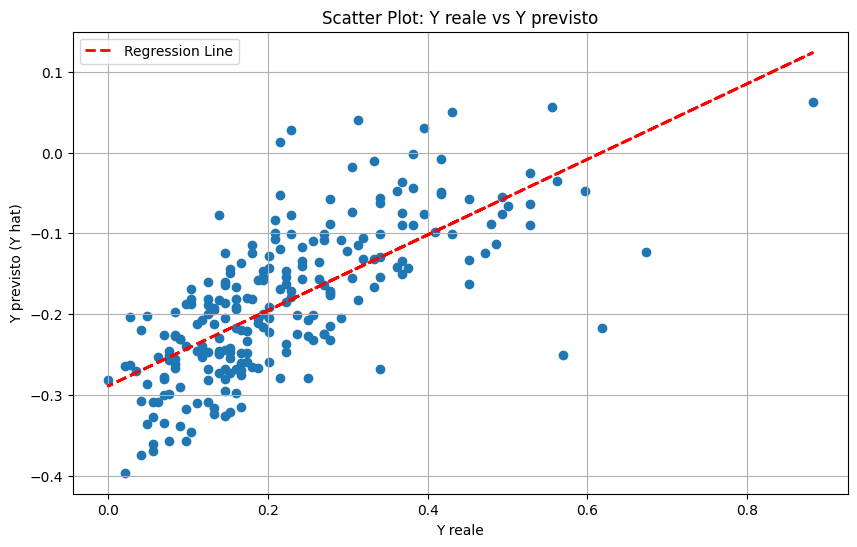

8/8 [==============================] - 0s 5ms/step

Model Completion: 69/144 (47.92%)
Saving data...
8/8 [==============================] - 0s 5ms/step
MAE (Iteration 10): 0.19
R-squared (R2) (Iteration 10): -1.38
RMSE (Iteration 10): 0.21


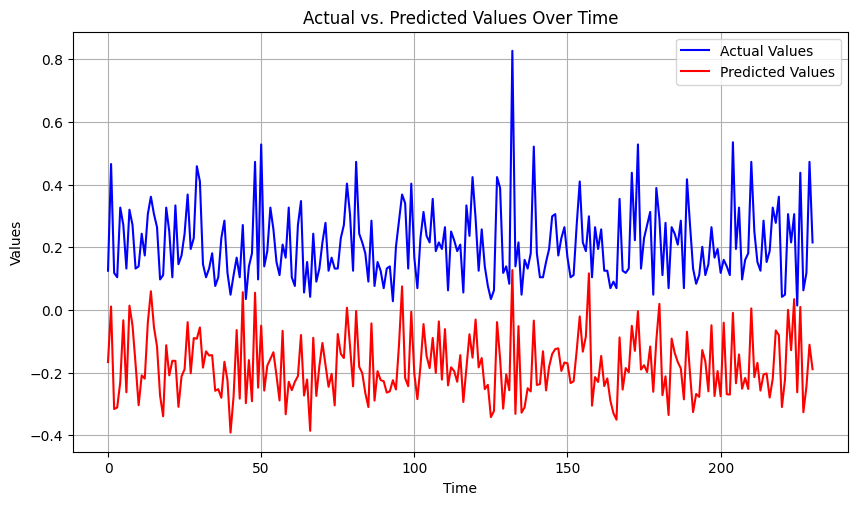

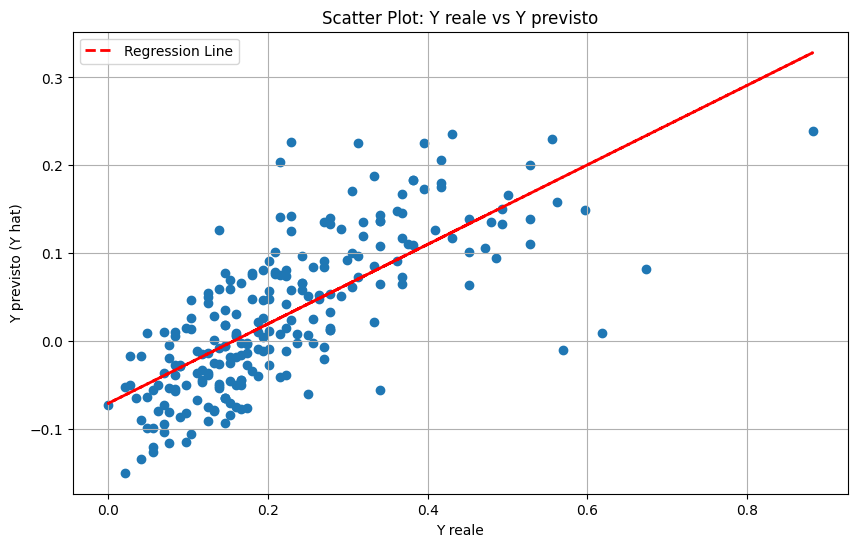

8/8 [==============================] - 0s 7ms/step

Model Completion: 70/144 (48.61%)
Saving data...
8/8 [==============================] - 0s 4ms/step
MAE (Iteration 11): 0.2
R-squared (R2) (Iteration 11): -1.39
RMSE (Iteration 11): 0.21


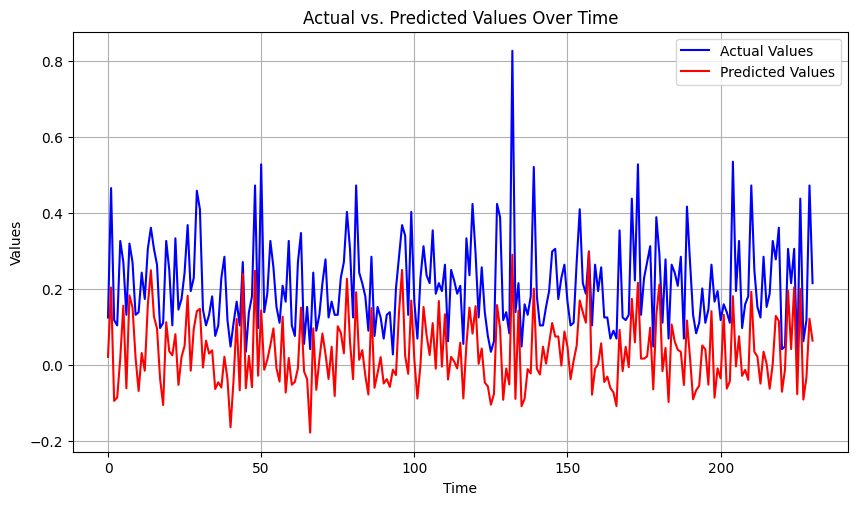

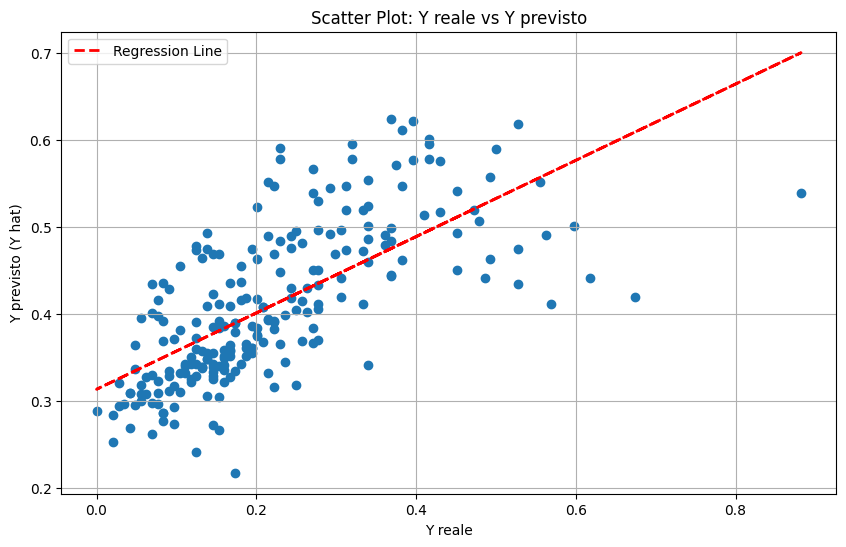

8/8 [==============================] - 0s 4ms/step

Model Completion: 71/144 (49.31%)
Saving data...
8/8 [==============================] - 0s 6ms/step
MAE (Iteration 12): 0.11
R-squared (R2) (Iteration 12): -0.32
RMSE (Iteration 12): 0.16


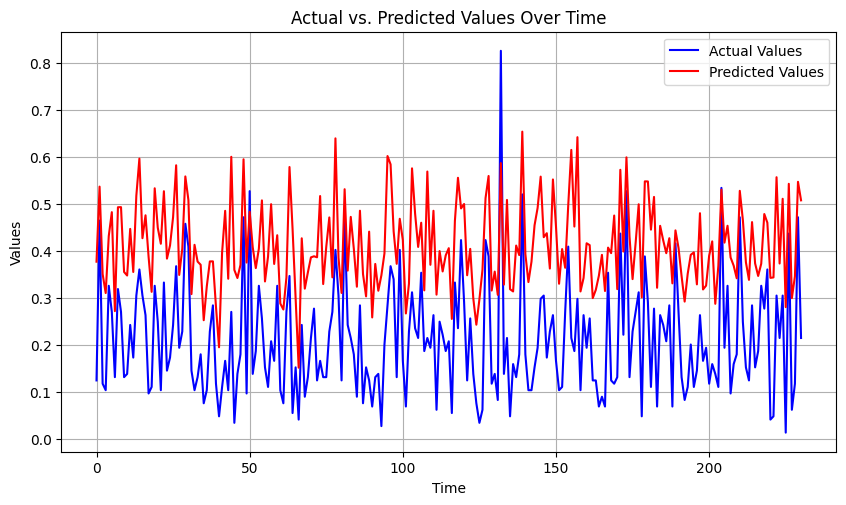

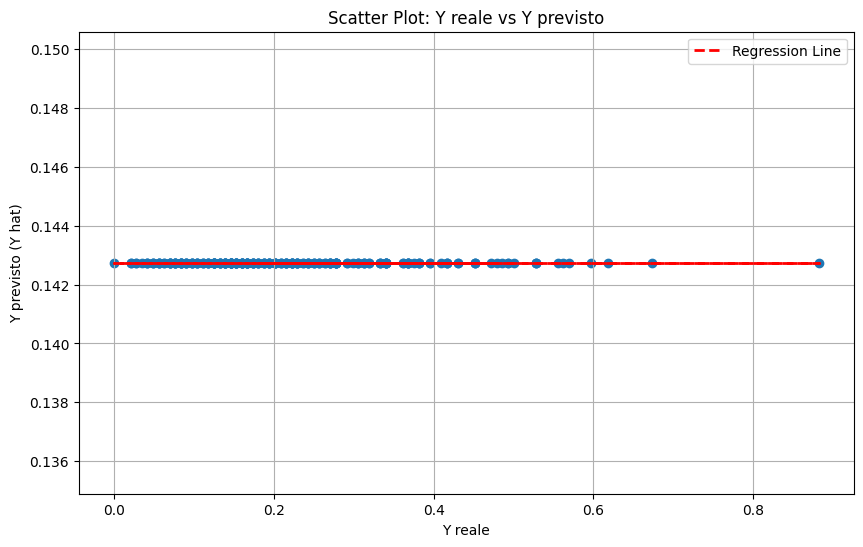

8/8 [==============================] - 0s 5ms/step

Model Completion: 72/144 (50.00%)
Saving data...
8/8 [==============================] - 0s 3ms/step
MAE (Iteration 13): 0.37
R-squared (R2) (Iteration 13): -6.64
RMSE (Iteration 13): 0.38


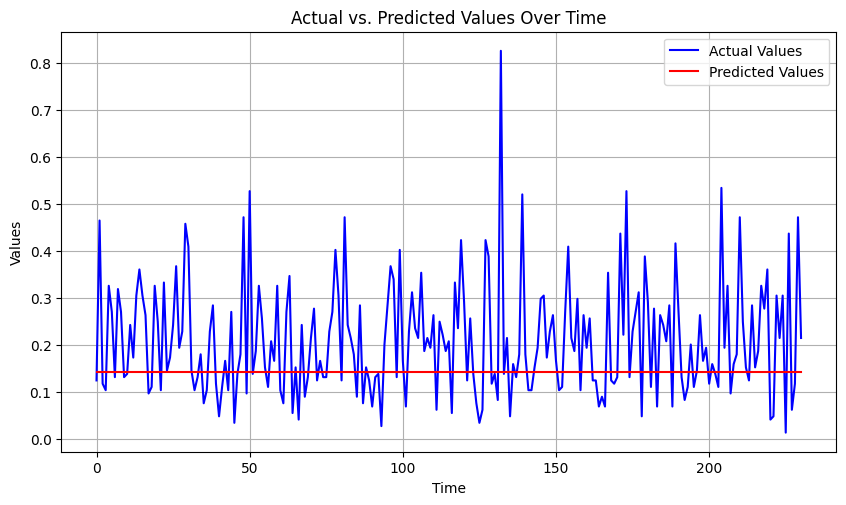

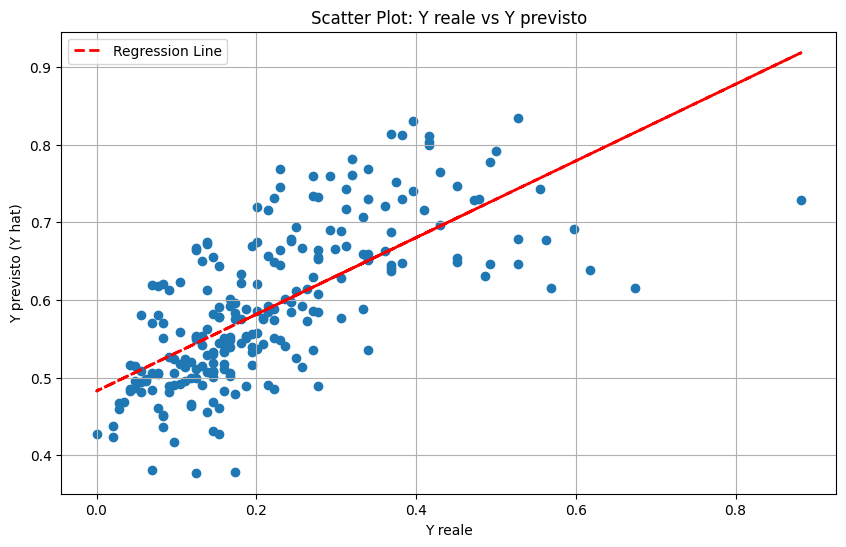

8/8 [==============================] - 0s 5ms/step

Model Completion: 73/144 (50.69%)
Saving data...
8/8 [==============================] - 0s 5ms/step
MAE (Iteration 14): 0.13
R-squared (R2) (Iteration 14): -0.13
RMSE (Iteration 14): 0.15


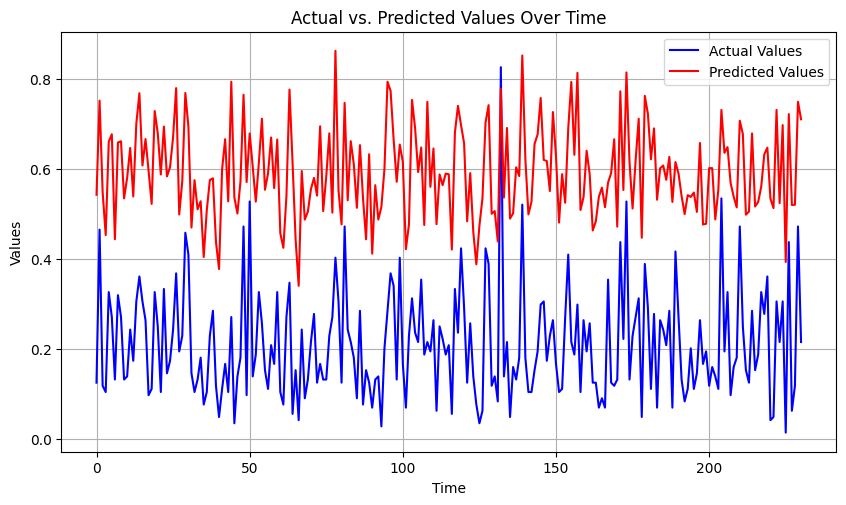

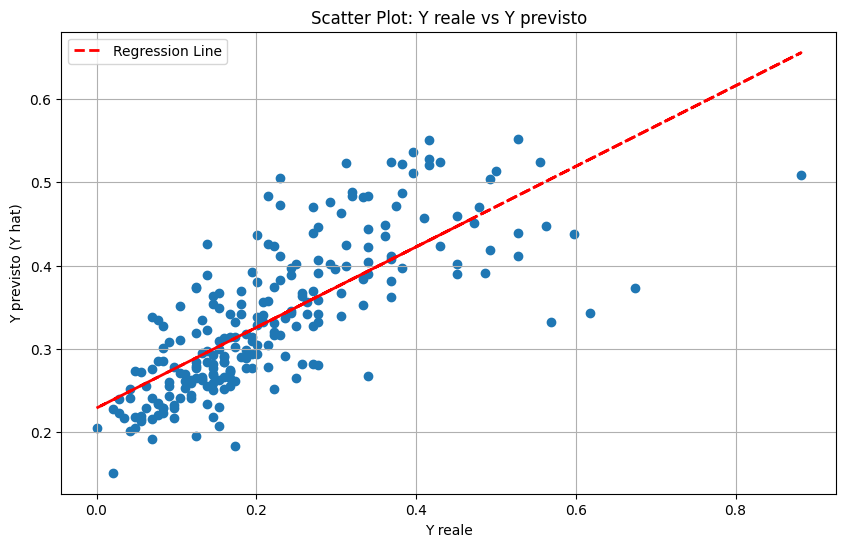

8/8 [==============================] - 0s 5ms/step

Model Completion: 74/144 (51.39%)
Saving data...
8/8 [==============================] - 0s 5ms/step
MAE (Iteration 15): 0.08
R-squared (R2) (Iteration 15): 0.43
RMSE (Iteration 15): 0.1


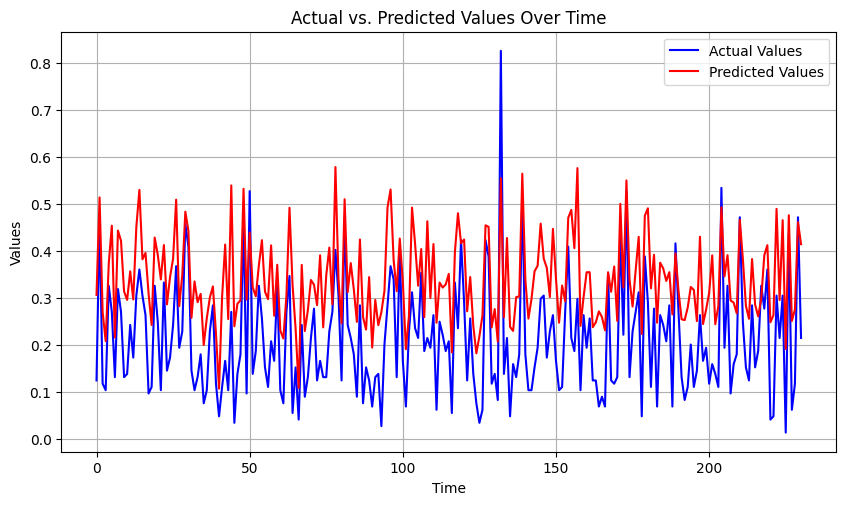

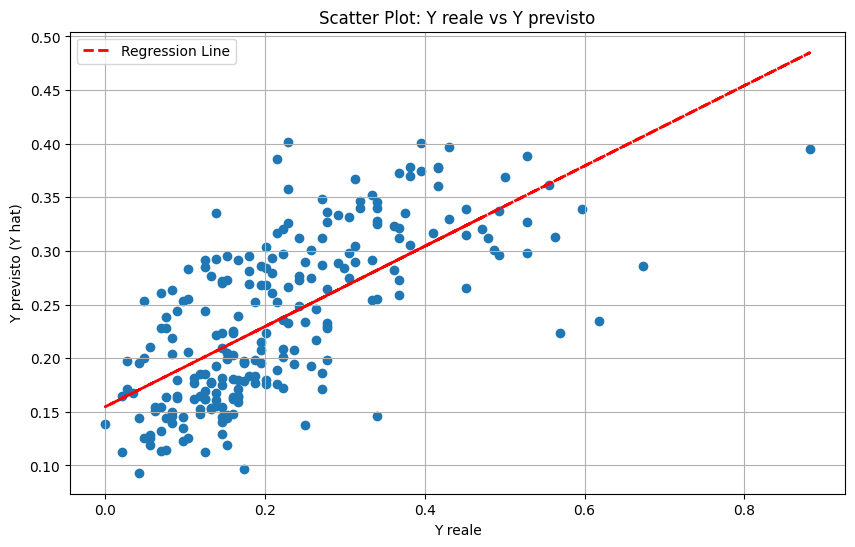

8/8 [==============================] - 0s 4ms/step

Model Completion: 75/144 (52.08%)
Saving data...
8/8 [==============================] - 0s 3ms/step
MAE (Iteration 16): 0.44
R-squared (R2) (Iteration 16): -9.37
RMSE (Iteration 16): 0.45


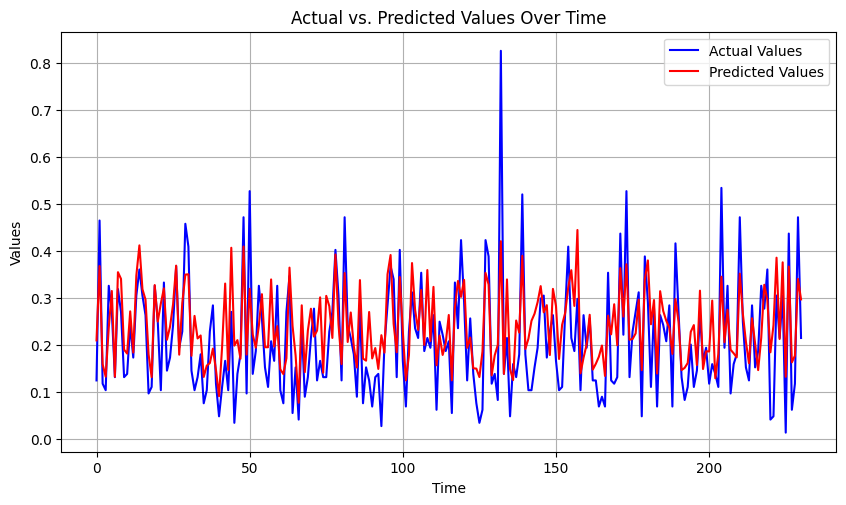

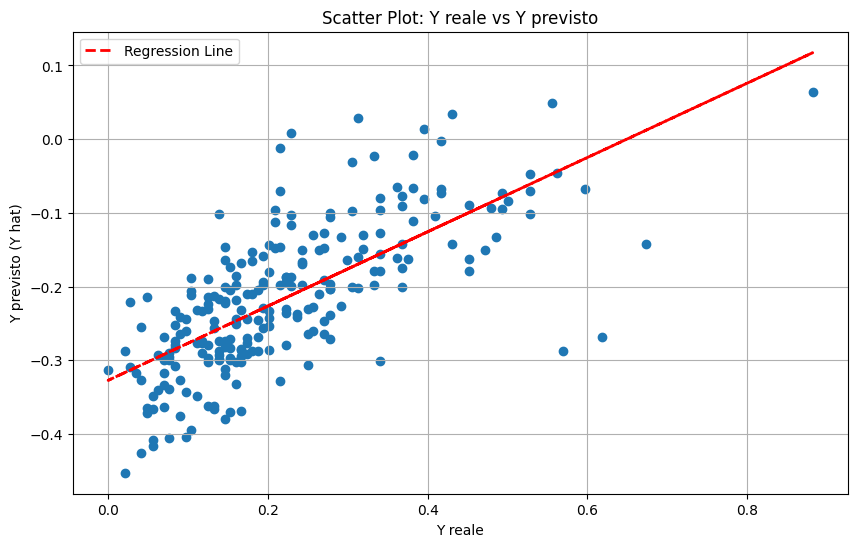

8/8 [==============================] - 0s 5ms/step

Model Completion: 76/144 (52.78%)
Saving data...
8/8 [==============================] - 0s 8ms/step
MAE (Iteration 17): 0.1
R-squared (R2) (Iteration 17): -0.07
RMSE (Iteration 17): 0.14


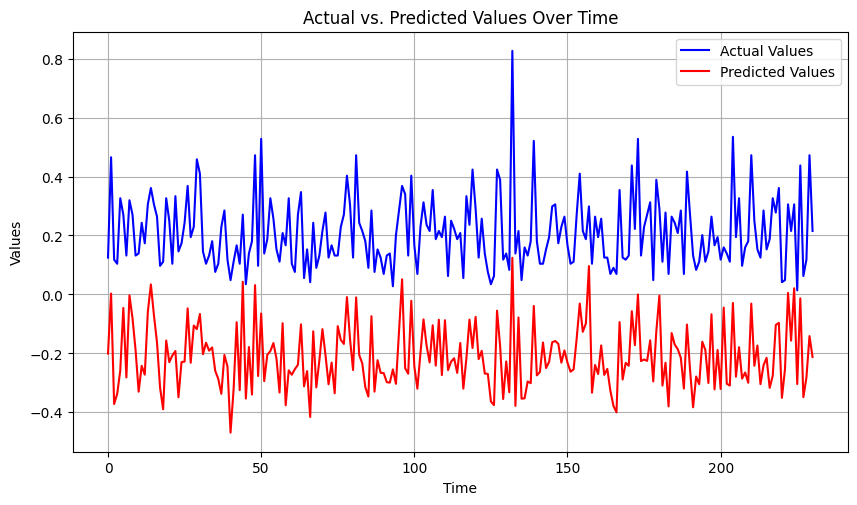

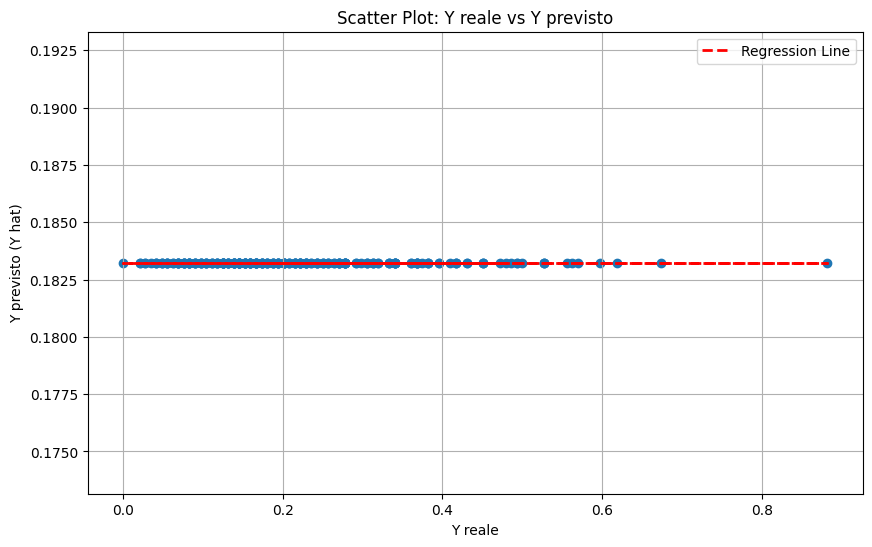

8/8 [==============================] - 0s 6ms/step

Model Completion: 77/144 (53.47%)
Saving data...
8/8 [==============================] - 0s 5ms/step
MAE (Iteration 18): 0.1
R-squared (R2) (Iteration 18): -0.02
RMSE (Iteration 18): 0.14


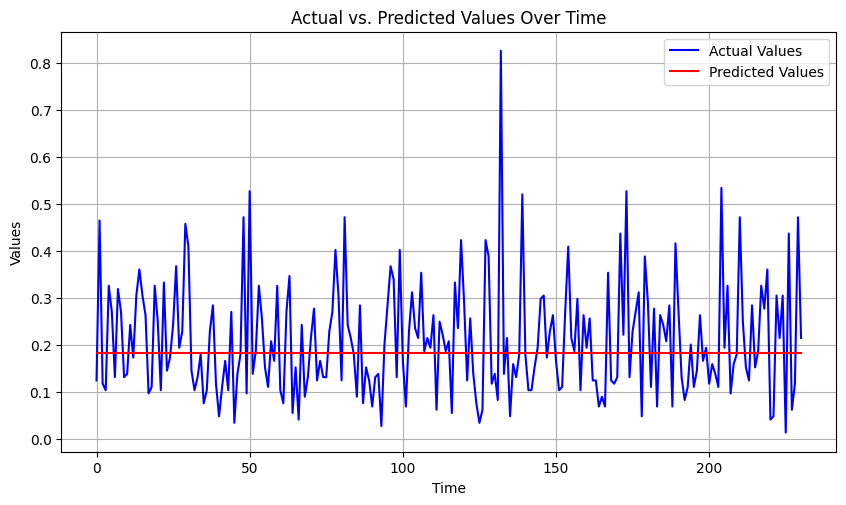

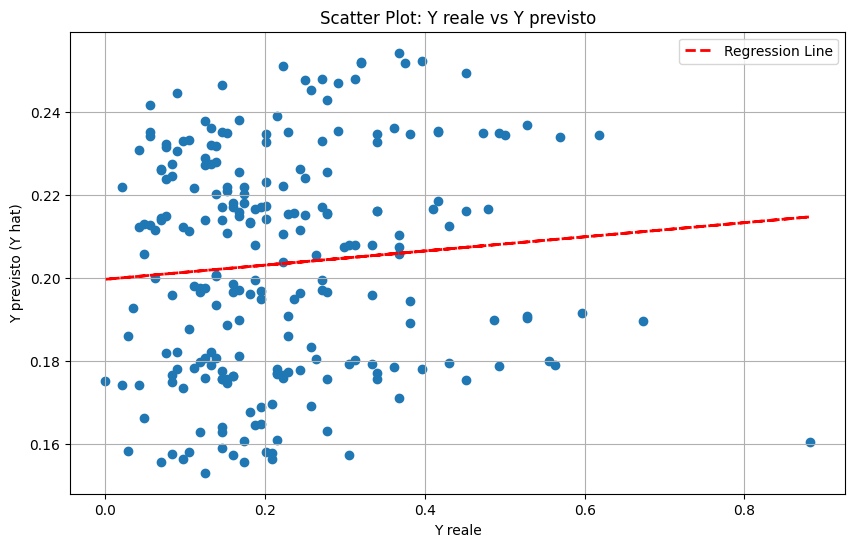

8/8 [==============================] - 0s 9ms/step

Model Completion: 78/144 (54.17%)
Saving data...
8/8 [==============================] - 0s 5ms/step
MAE (Iteration 19): 0.14
R-squared (R2) (Iteration 19): -0.24
RMSE (Iteration 19): 0.15


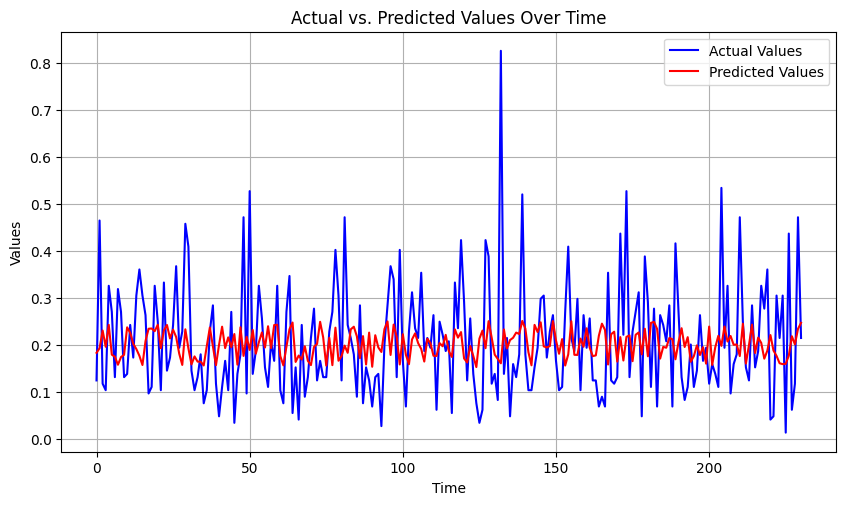

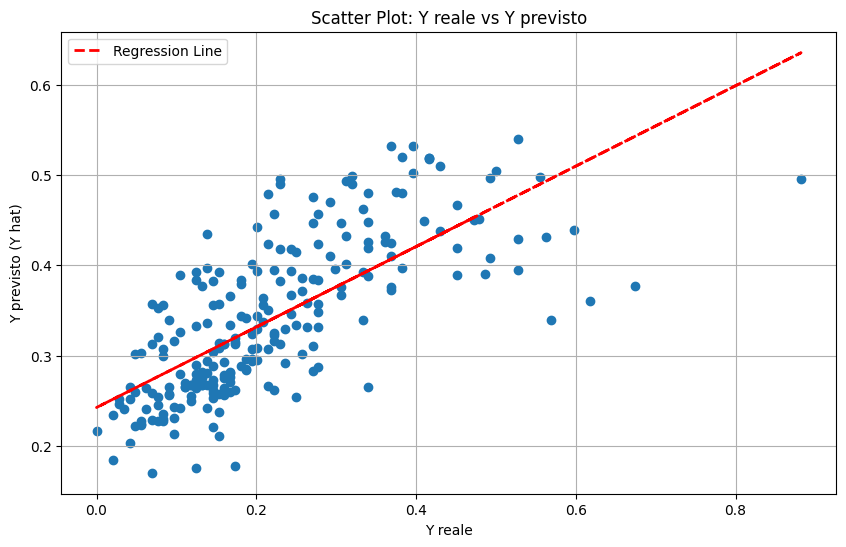

8/8 [==============================] - 0s 6ms/step

Model Completion: 79/144 (54.86%)
Saving data...
8/8 [==============================] - 0s 3ms/step
MAE (Iteration 20): 0.1
R-squared (R2) (Iteration 20): -0.08
RMSE (Iteration 20): 0.14


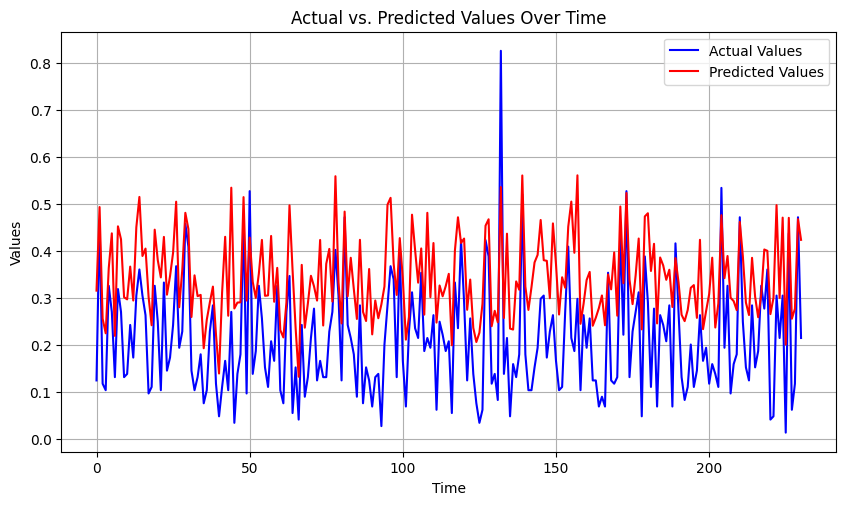

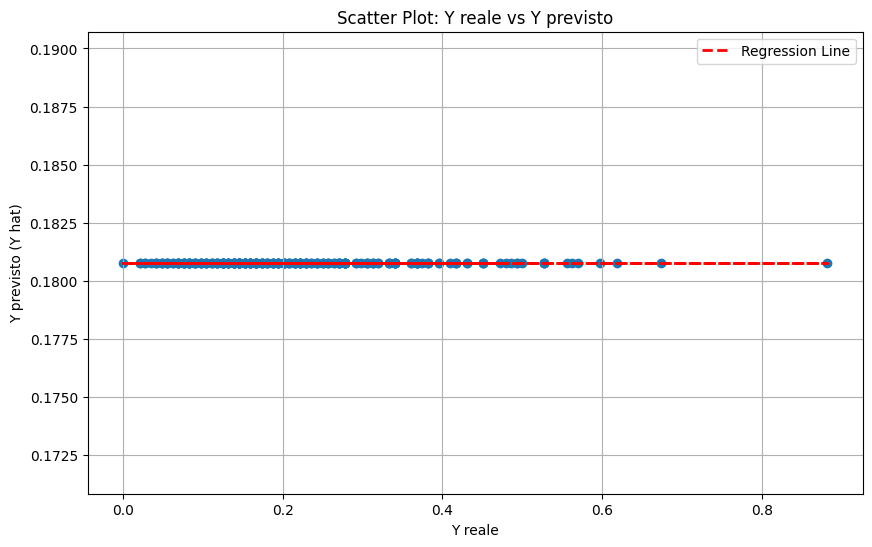

8/8 [==============================] - 0s 4ms/step

Model Completion: 80/144 (55.56%)
Saving data...
8/8 [==============================] - 0s 9ms/step
MAE (Iteration 21): 0.23
R-squared (R2) (Iteration 21): -2.07
RMSE (Iteration 21): 0.24


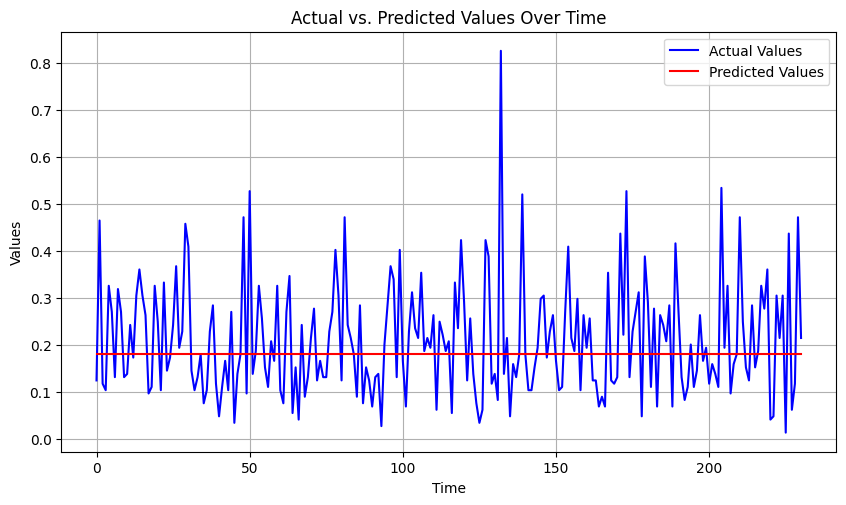

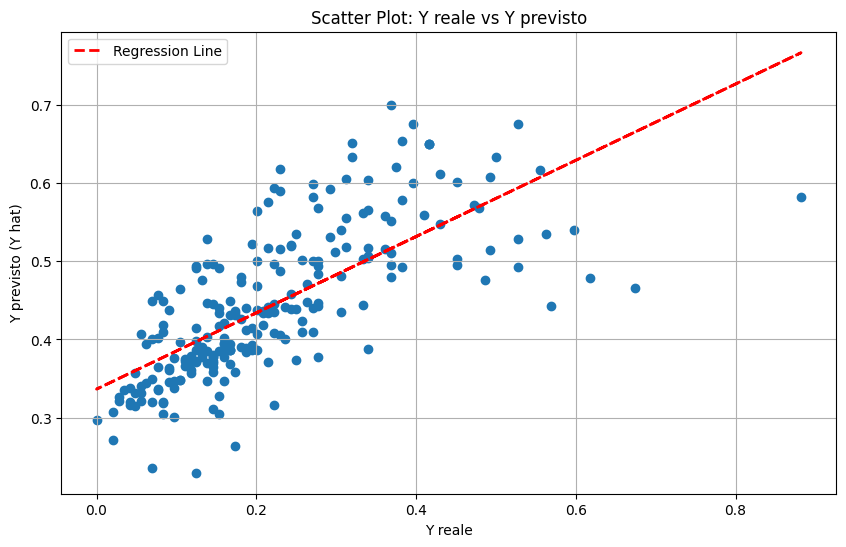

8/8 [==============================] - 0s 6ms/step

Model Completion: 81/144 (56.25%)
Saving data...
8/8 [==============================] - 0s 10ms/step
MAE (Iteration 22): 0.12
R-squared (R2) (Iteration 22): -0.03
RMSE (Iteration 22): 0.14


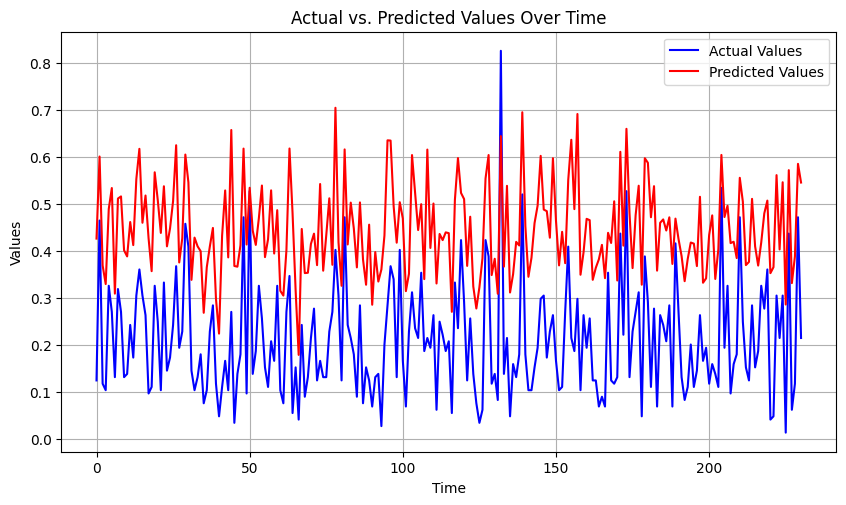

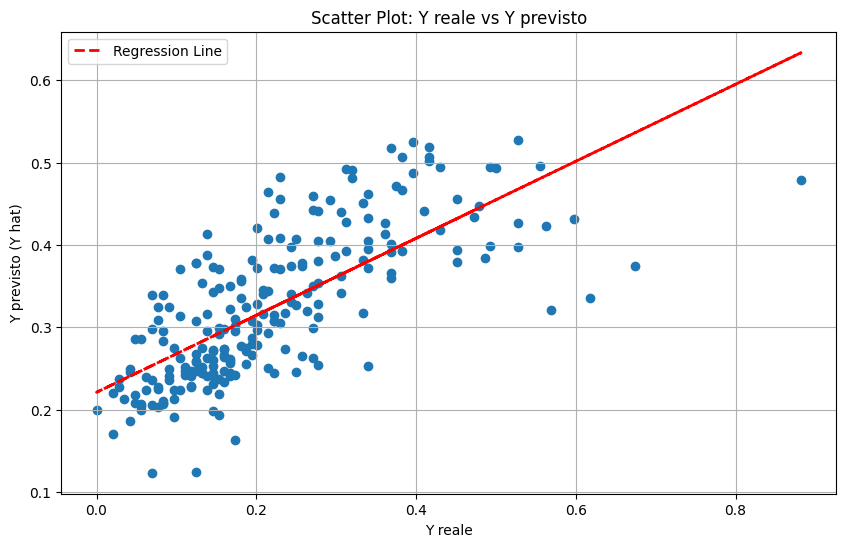

8/8 [==============================] - 0s 6ms/step

Model Completion: 82/144 (56.94%)
Saving data...
8/8 [==============================] - 0s 4ms/step
MAE (Iteration 23): 0.11
R-squared (R2) (Iteration 23): -0.01
RMSE (Iteration 23): 0.14


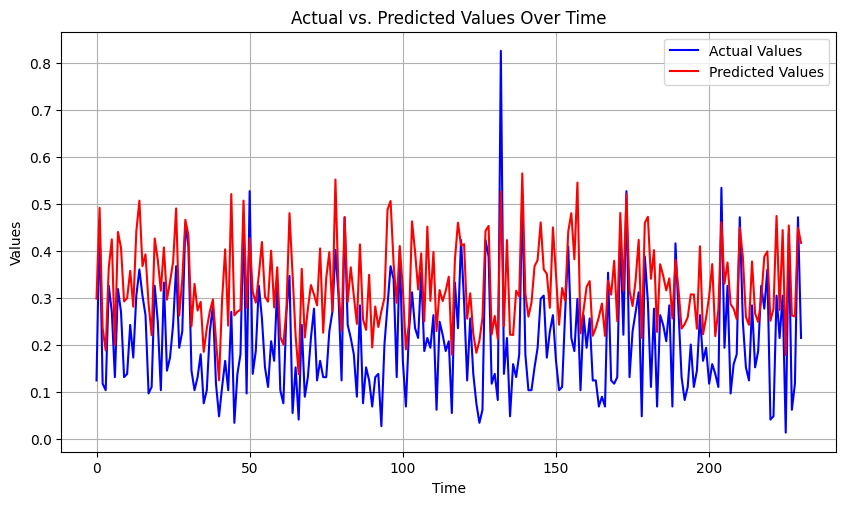

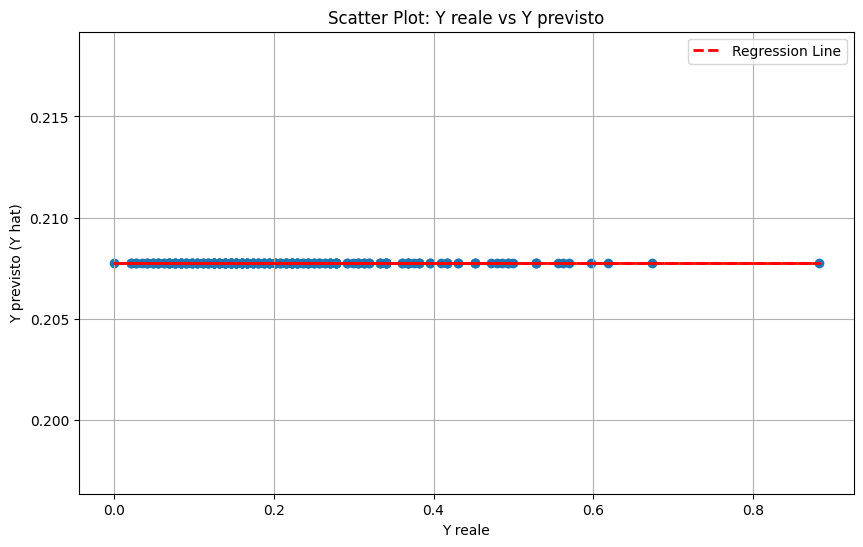

8/8 [==============================] - 0s 5ms/step

Model Completion: 83/144 (57.64%)
Saving data...
8/8 [==============================] - 0s 9ms/step
MAE (Iteration 24): 0.14
R-squared (R2) (Iteration 24): -0.59
RMSE (Iteration 24): 0.18


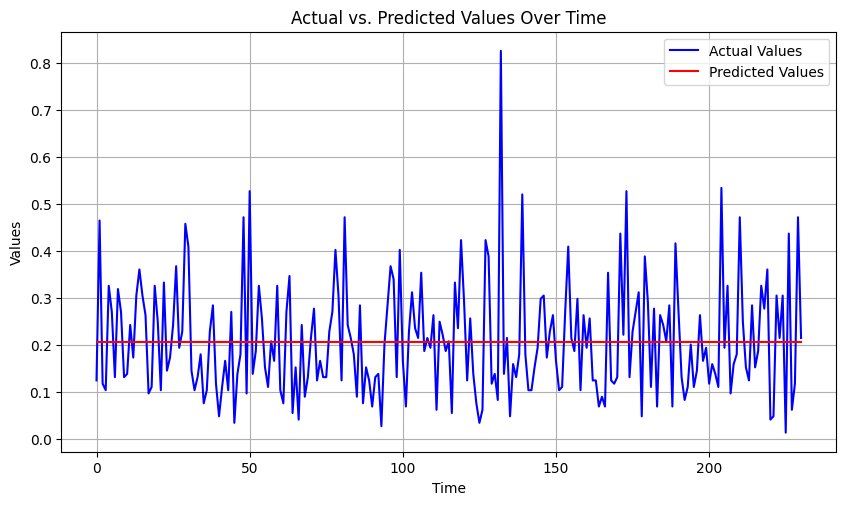

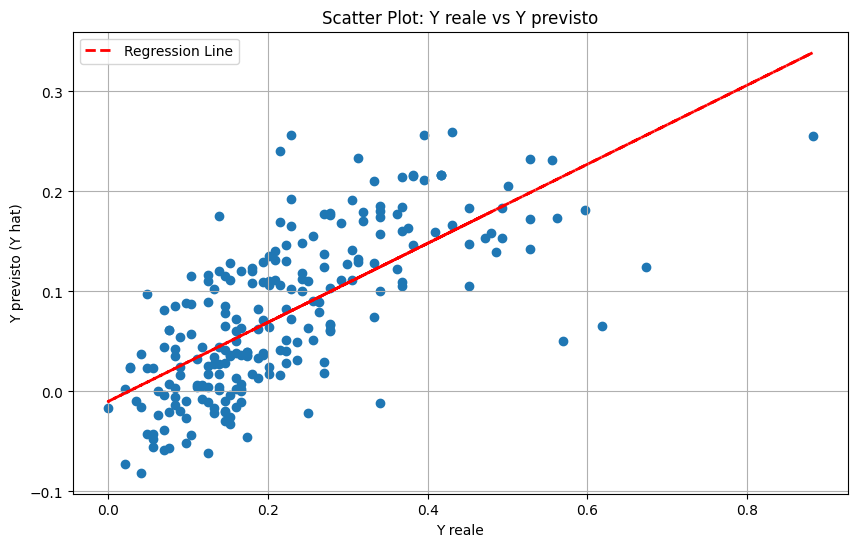

8/8 [==============================] - 0s 8ms/step

Model Completion: 84/144 (58.33%)
Saving data...
8/8 [==============================] - 0s 7ms/step
MAE (Iteration 25): 0.27
R-squared (R2) (Iteration 25): -3.22
RMSE (Iteration 25): 0.29


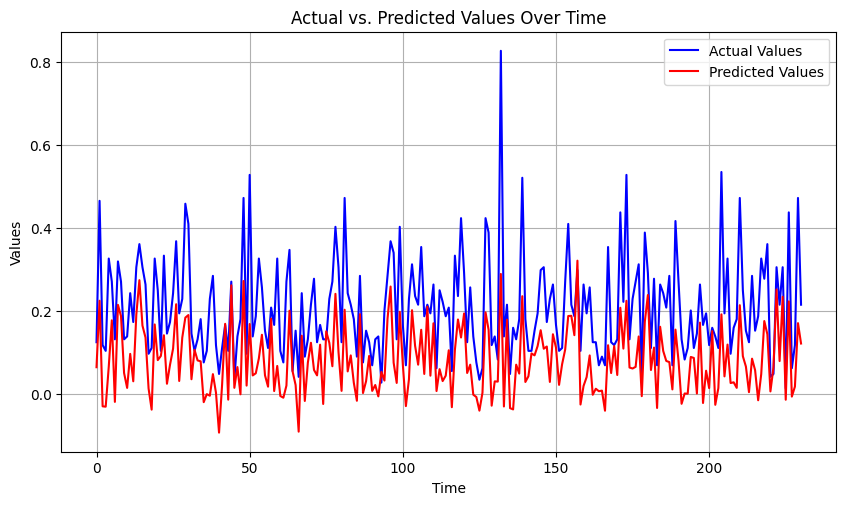

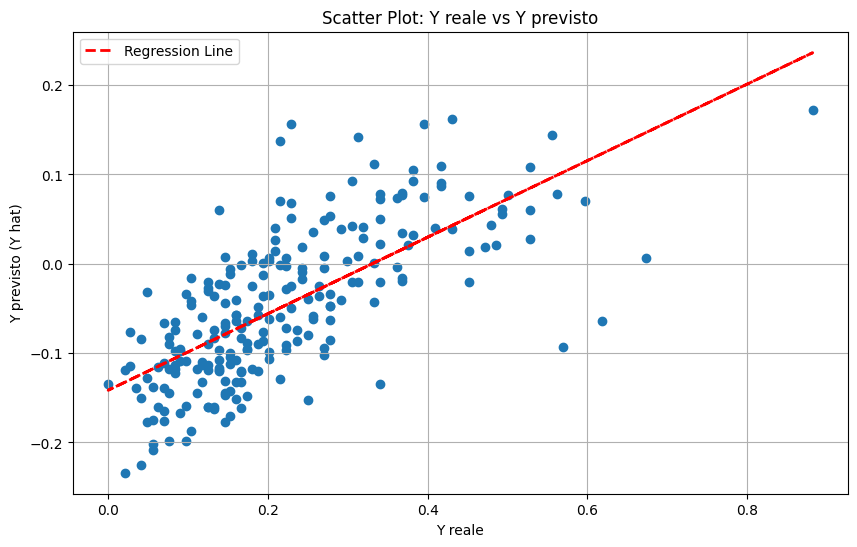

8/8 [==============================] - 0s 10ms/step

Model Completion: 85/144 (59.03%)
Saving data...
8/8 [==============================] - 0s 3ms/step
MAE (Iteration 26): 0.1
R-squared (R2) (Iteration 26): -0.06
RMSE (Iteration 26): 0.14


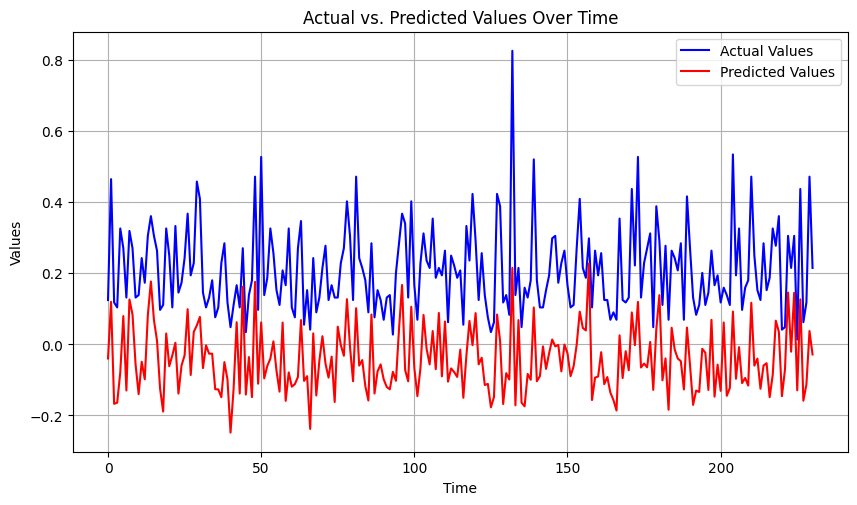

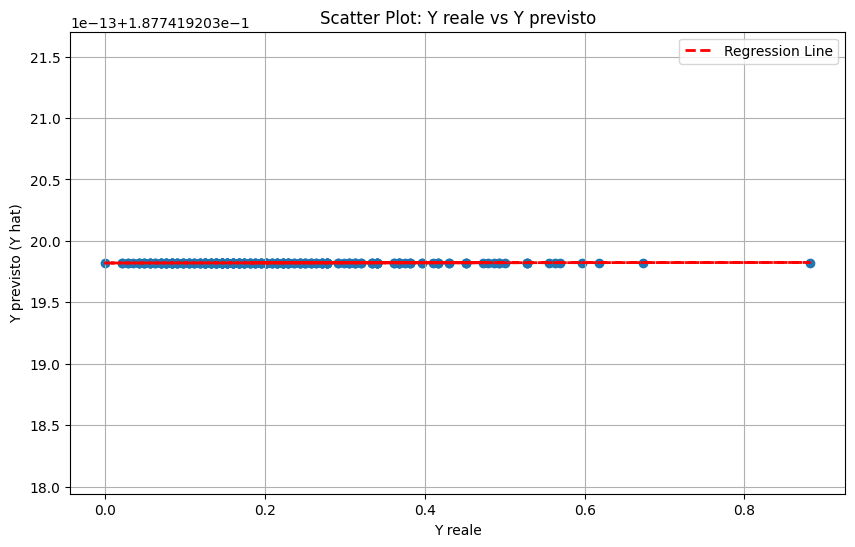

8/8 [==============================] - 0s 4ms/step

Model Completion: 86/144 (59.72%)
Saving data...
8/8 [==============================] - 0s 5ms/step
MAE (Iteration 27): 0.28
R-squared (R2) (Iteration 27): -3.5
RMSE (Iteration 27): 0.29


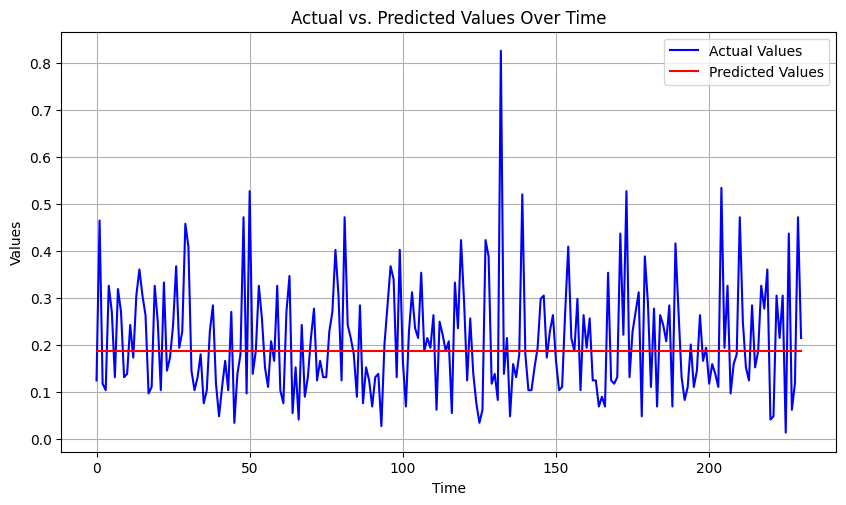

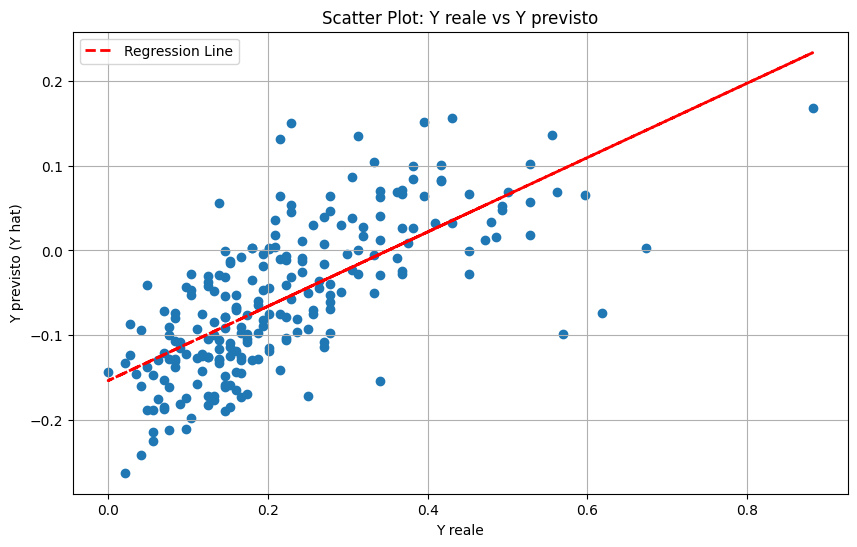

8/8 [==============================] - 0s 9ms/step

Model Completion: 87/144 (60.42%)
Saving data...
8/8 [==============================] - 0s 5ms/step
MAE (Iteration 28): 0.21
R-squared (R2) (Iteration 28): -1.75
RMSE (Iteration 28): 0.23


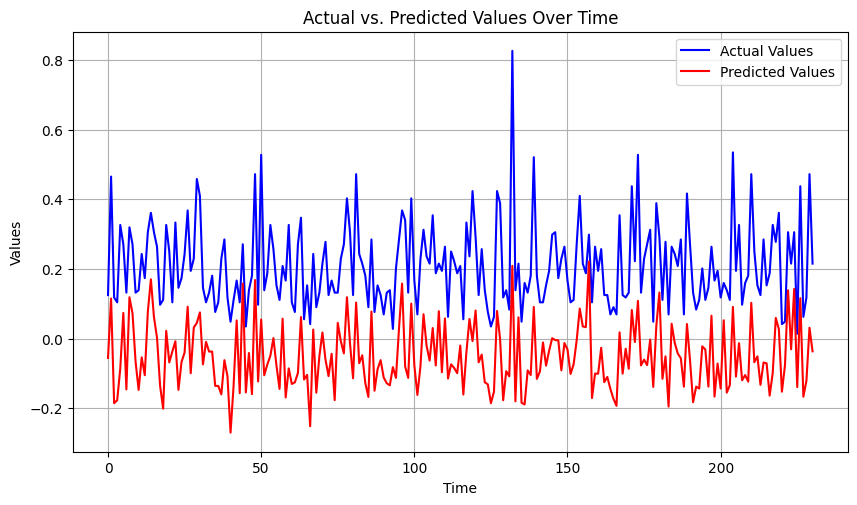

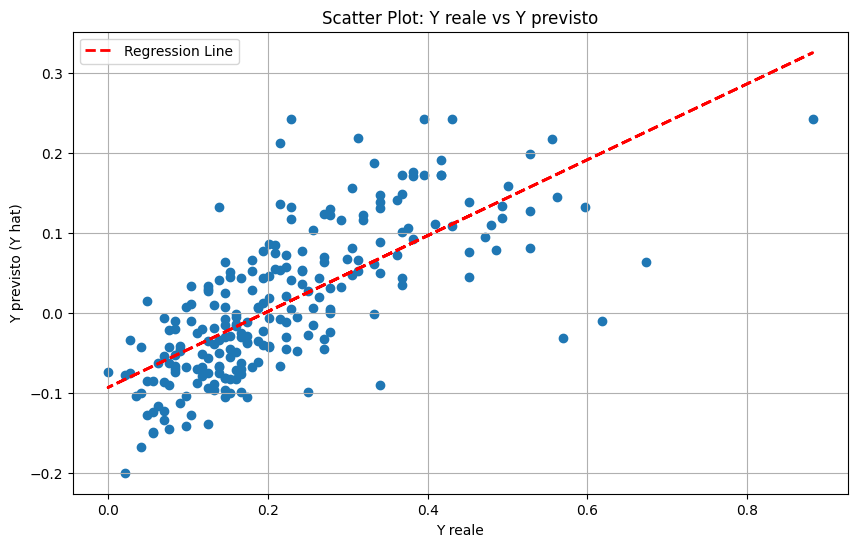

8/8 [==============================] - 0s 3ms/step

Model Completion: 88/144 (61.11%)
Saving data...
8/8 [==============================] - 0s 3ms/step
MAE (Iteration 29): 0.11
R-squared (R2) (Iteration 29): -0.26
RMSE (Iteration 29): 0.16


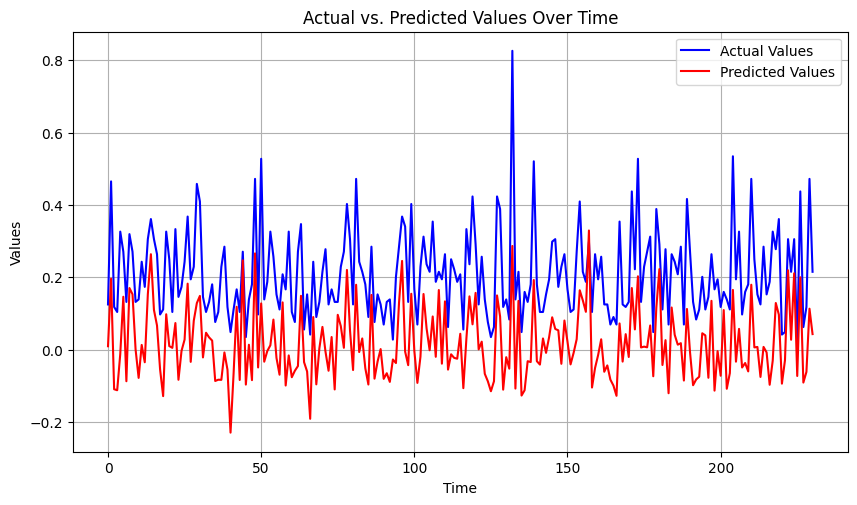

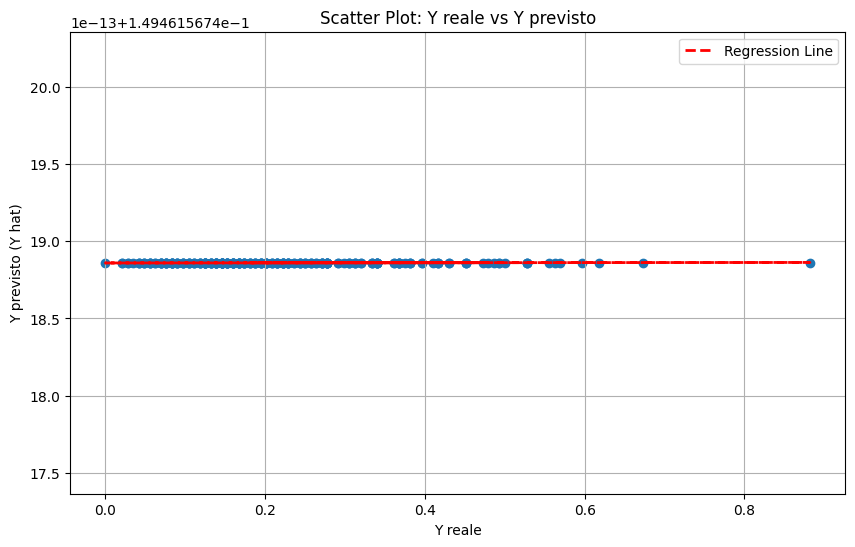

8/8 [==============================] - 0s 5ms/step

Model Completion: 89/144 (61.81%)
Saving data...
8/8 [==============================] - 0s 4ms/step
MAE (Iteration 30): 0.11
R-squared (R2) (Iteration 30): -0.3
RMSE (Iteration 30): 0.16


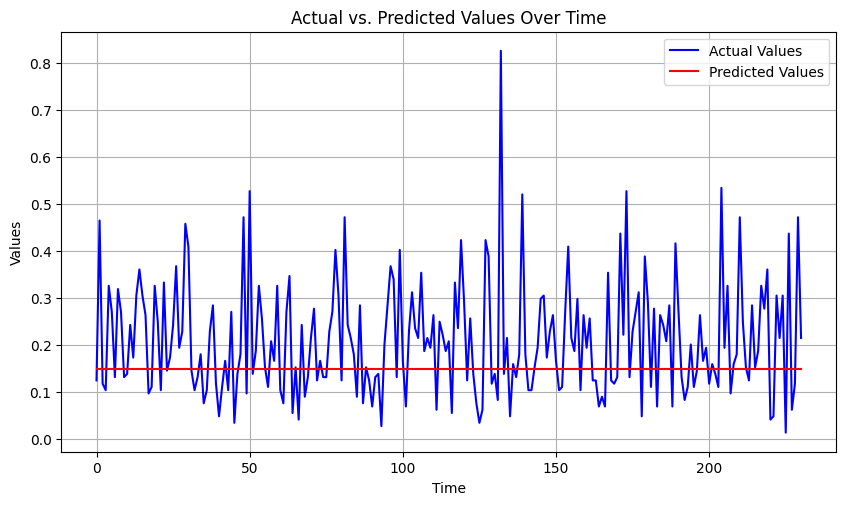

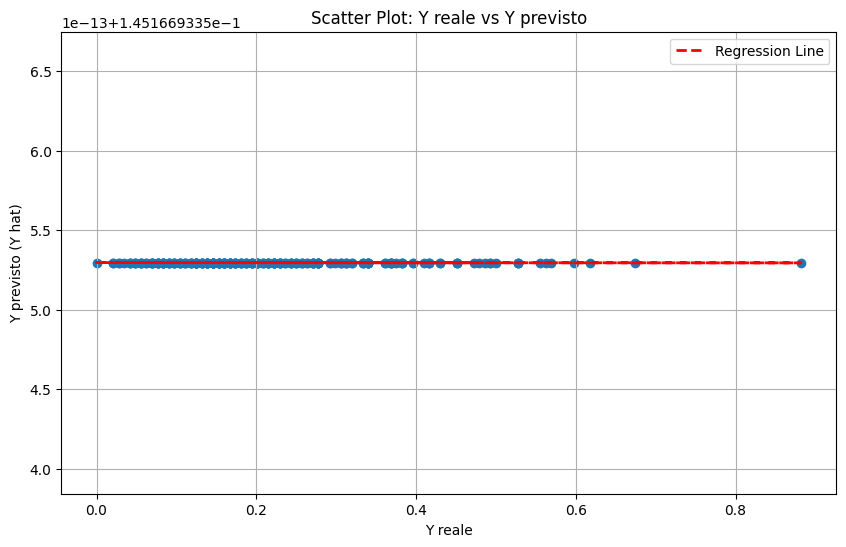

8/8 [==============================] - 0s 3ms/step

Model Completion: 90/144 (62.50%)
Saving data...
8/8 [==============================] - 0s 4ms/step
MAE (Iteration 31): 0.13
R-squared (R2) (Iteration 31): -0.41
RMSE (Iteration 31): 0.16


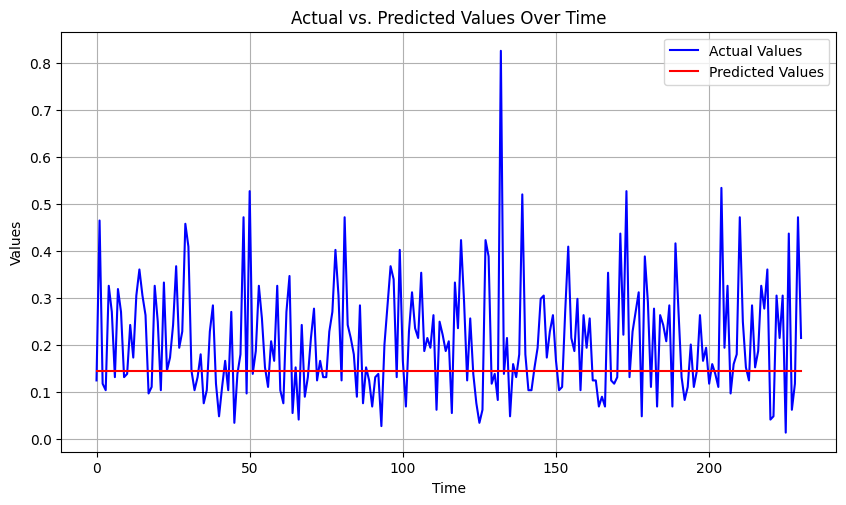

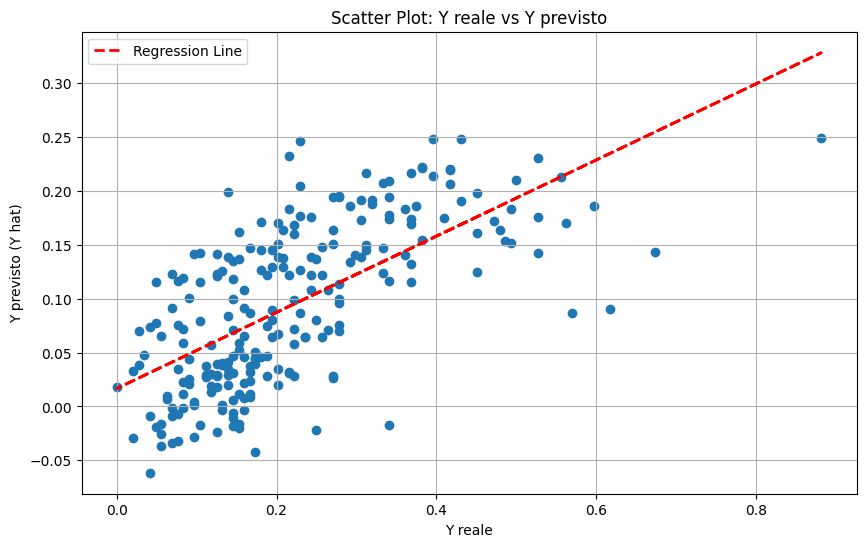

8/8 [==============================] - 0s 4ms/step

Model Completion: 91/144 (63.19%)
Saving data...
8/8 [==============================] - 0s 3ms/step
MAE (Iteration 32): 0.11
R-squared (R2) (Iteration 32): -0.16
RMSE (Iteration 32): 0.15


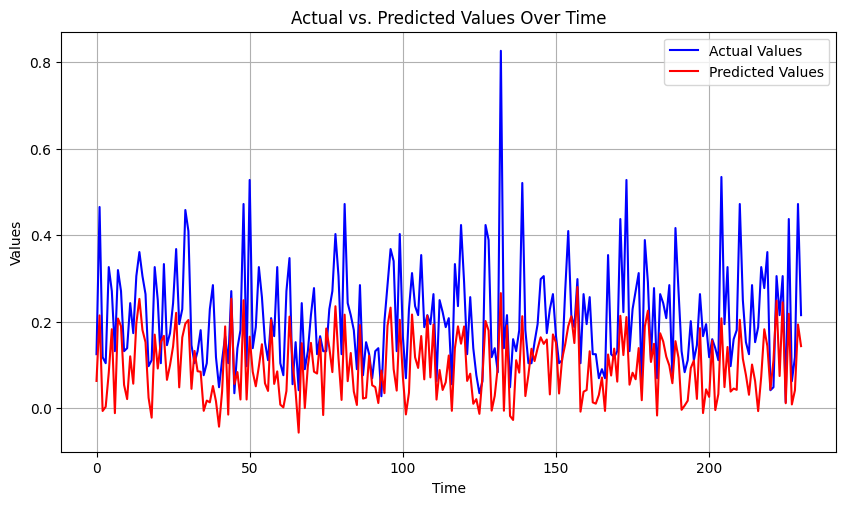

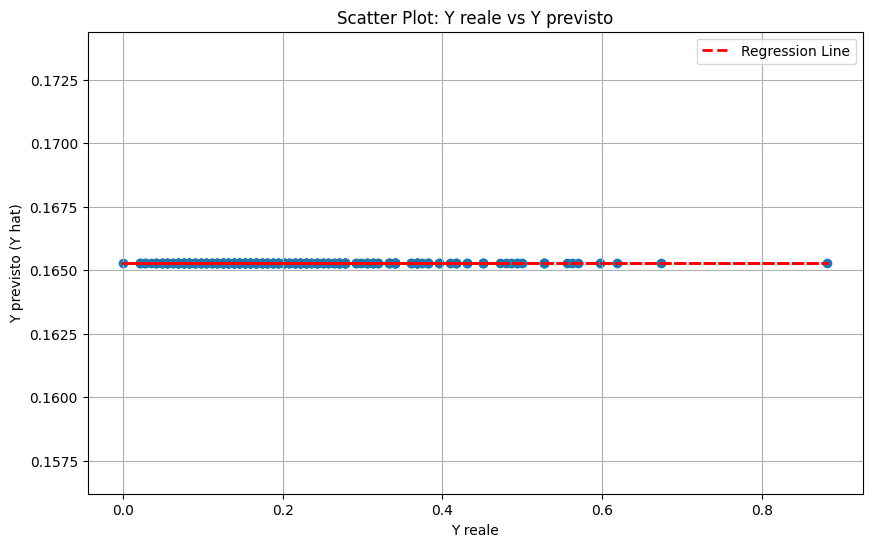

8/8 [==============================] - 0s 4ms/step

Model Completion: 92/144 (63.89%)
Saving data...
8/8 [==============================] - 0s 5ms/step
MAE (Iteration 33): 0.24
R-squared (R2) (Iteration 33): -2.35
RMSE (Iteration 33): 0.25


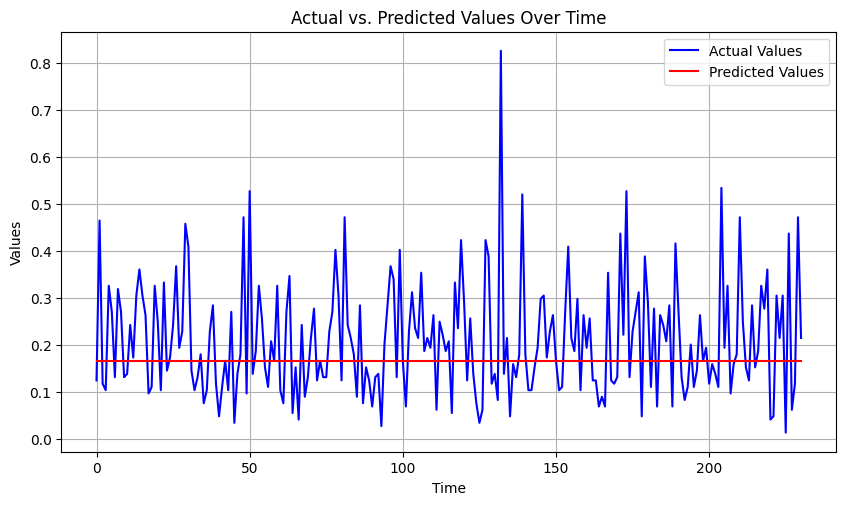

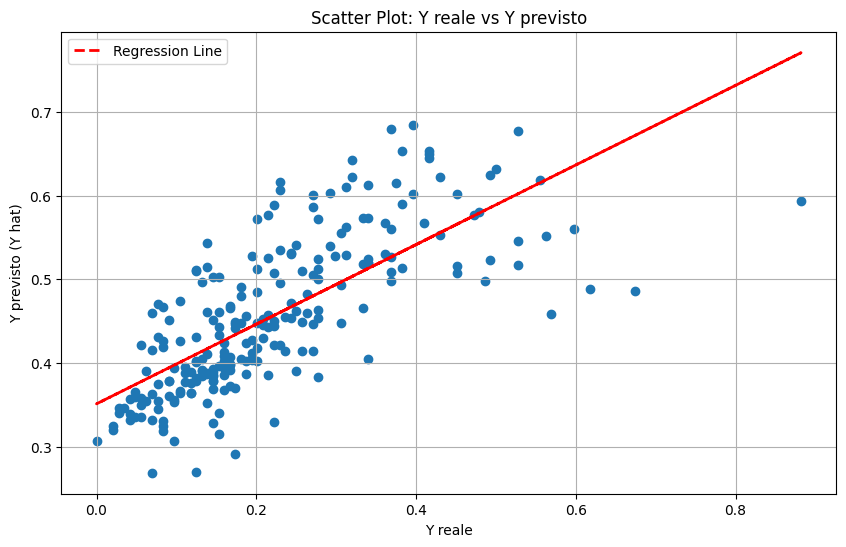

8/8 [==============================] - 0s 4ms/step

Model Completion: 93/144 (64.58%)
Saving data...
8/8 [==============================] - 0s 4ms/step
MAE (Iteration 34): 0.1
R-squared (R2) (Iteration 34): 0.12
RMSE (Iteration 34): 0.13


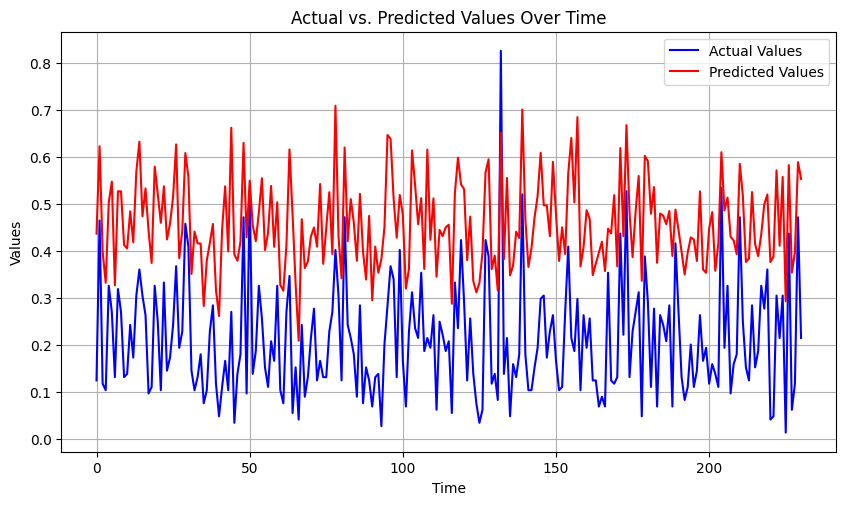

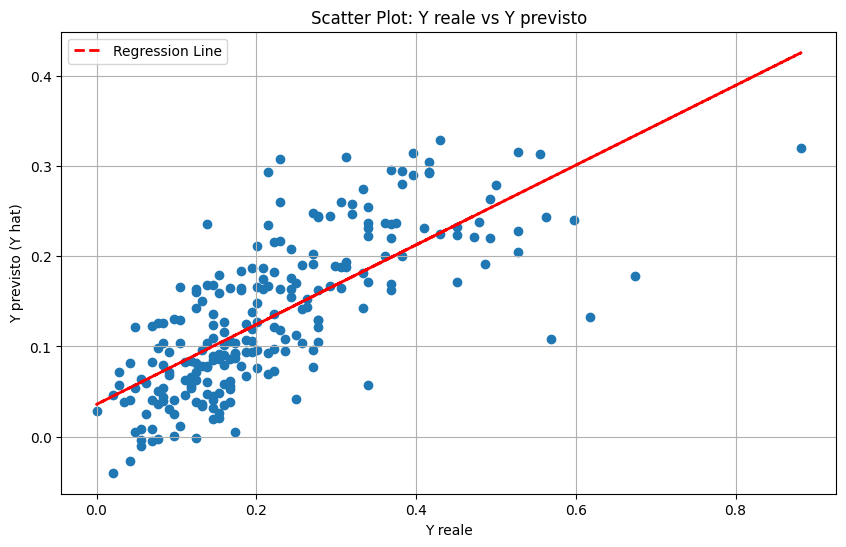

8/8 [==============================] - 0s 5ms/step

Model Completion: 94/144 (65.28%)
Saving data...
8/8 [==============================] - 0s 3ms/step
MAE (Iteration 35): 0.1
R-squared (R2) (Iteration 35): -0.09
RMSE (Iteration 35): 0.15


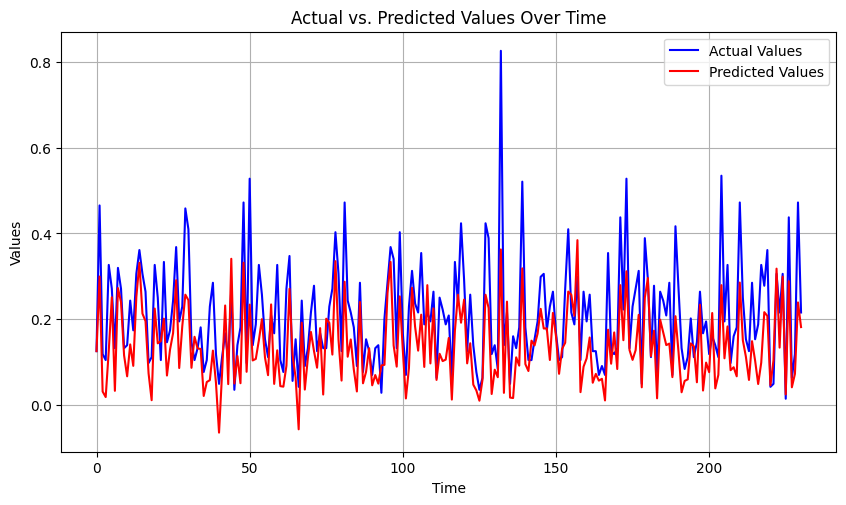

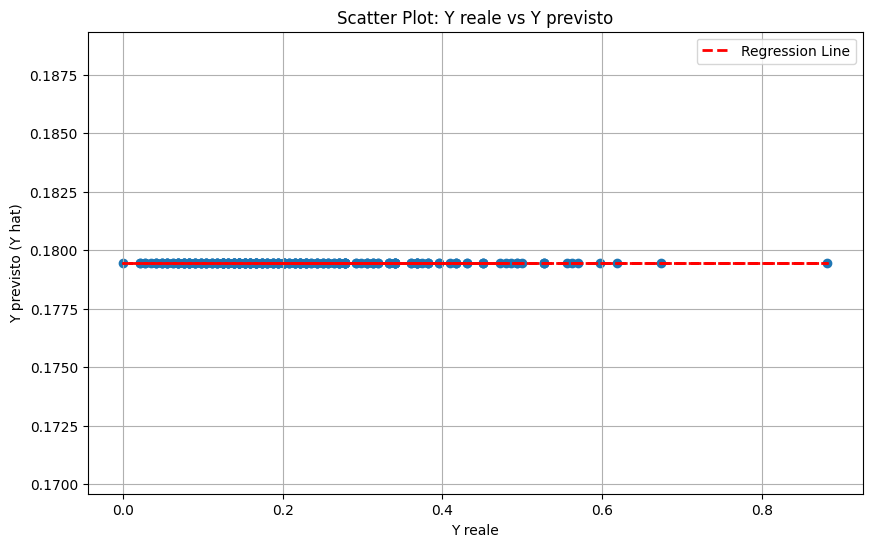

8/8 [==============================] - 0s 5ms/step

Model Completion: 95/144 (65.97%)
Saving data...
8/8 [==============================] - 0s 4ms/step
MAE (Iteration 36): 0.18
R-squared (R2) (Iteration 36): -1.08
RMSE (Iteration 36): 0.2


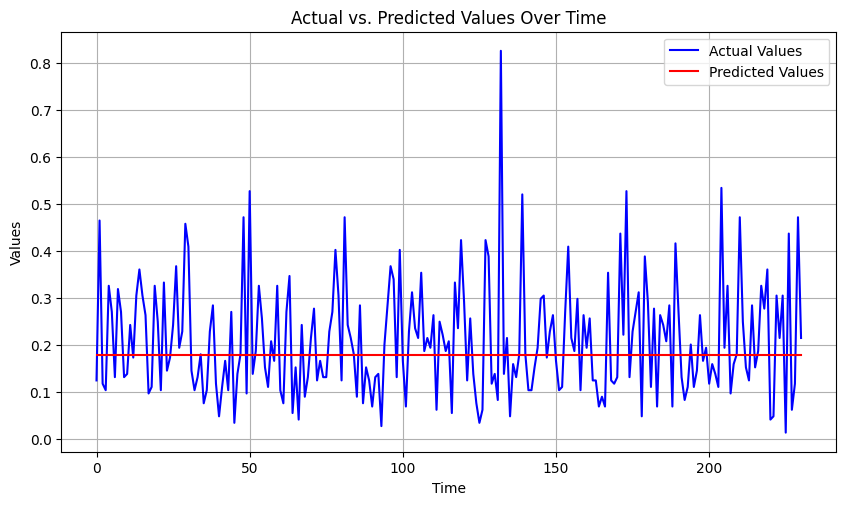

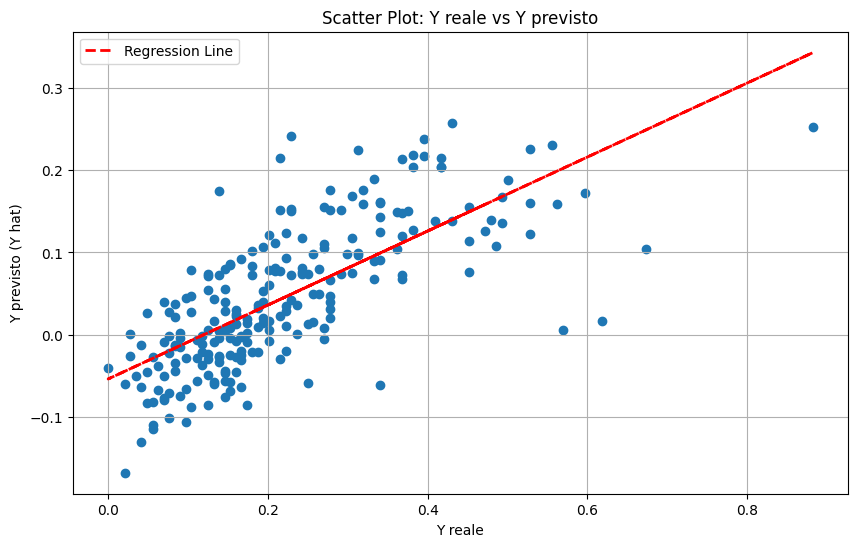

8/8 [==============================] - 0s 5ms/step

Model Completion: 96/144 (66.67%)
Saving data...
8/8 [==============================] - 0s 5ms/step
MAE (Iteration 37): 0.39
R-squared (R2) (Iteration 37): -7.47
RMSE (Iteration 37): 0.4


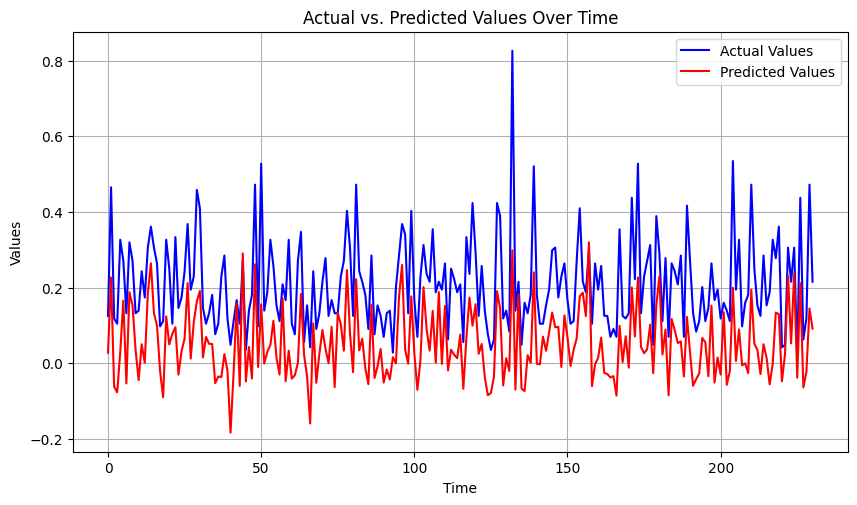

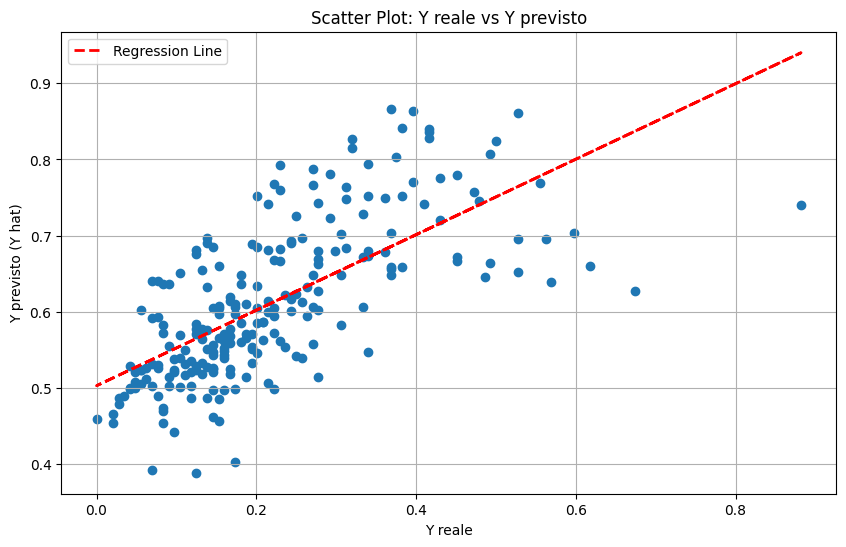

8/8 [==============================] - 0s 4ms/step

Model Completion: 97/144 (67.36%)
Saving data...
8/8 [==============================] - 0s 4ms/step
MAE (Iteration 38): 0.1
R-squared (R2) (Iteration 38): -0.09
RMSE (Iteration 38): 0.15


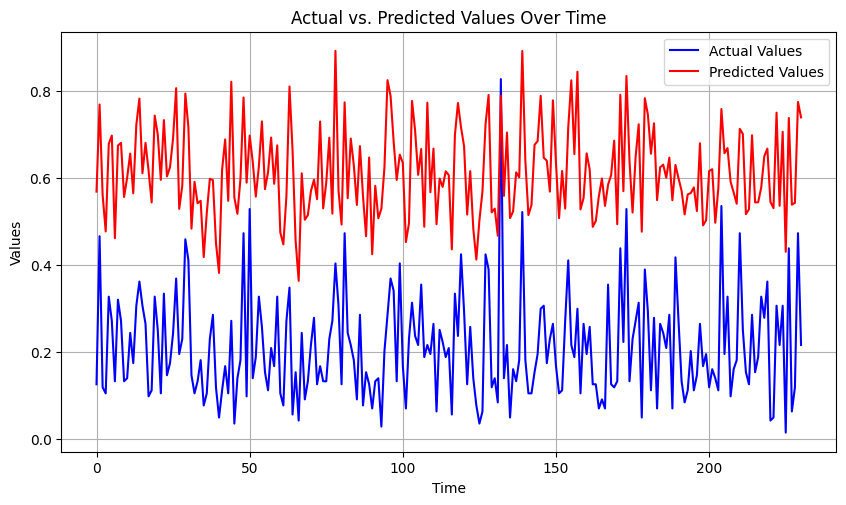

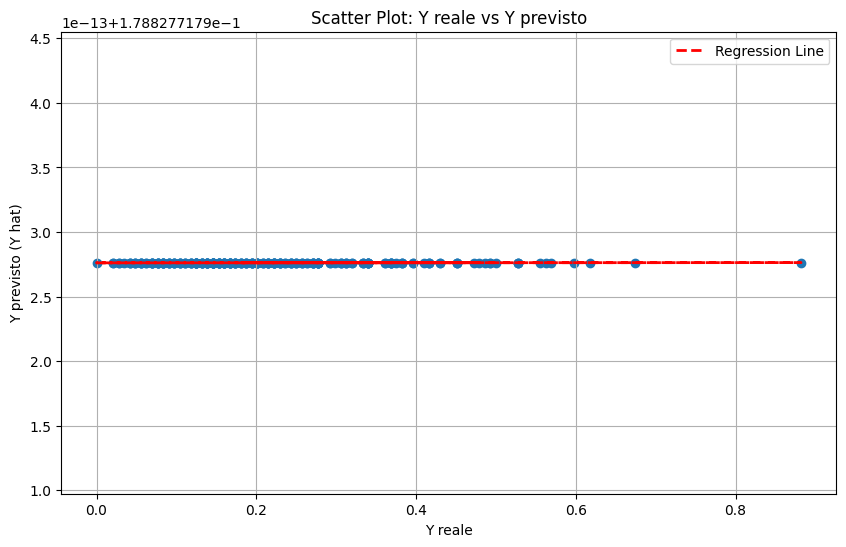

8/8 [==============================] - 0s 4ms/step

Model Completion: 98/144 (68.06%)
Saving data...
8/8 [==============================] - 0s 5ms/step
MAE (Iteration 39): 0.29
R-squared (R2) (Iteration 39): -3.91
RMSE (Iteration 39): 0.31


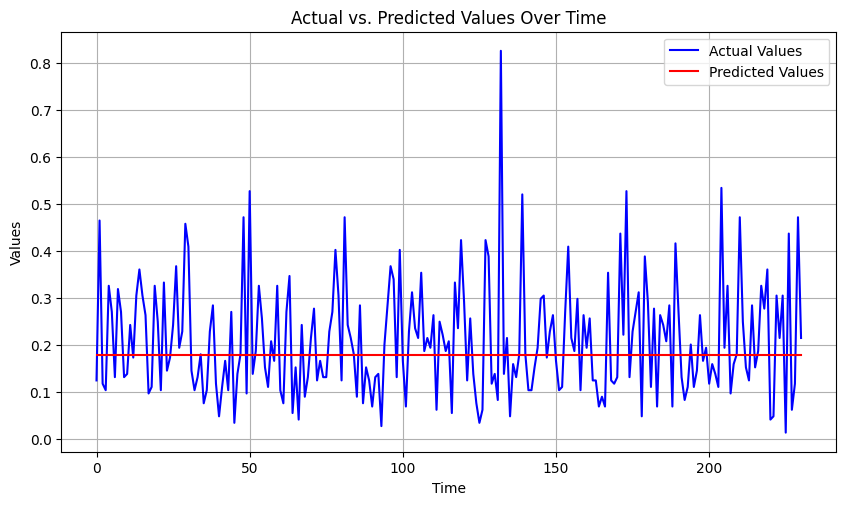

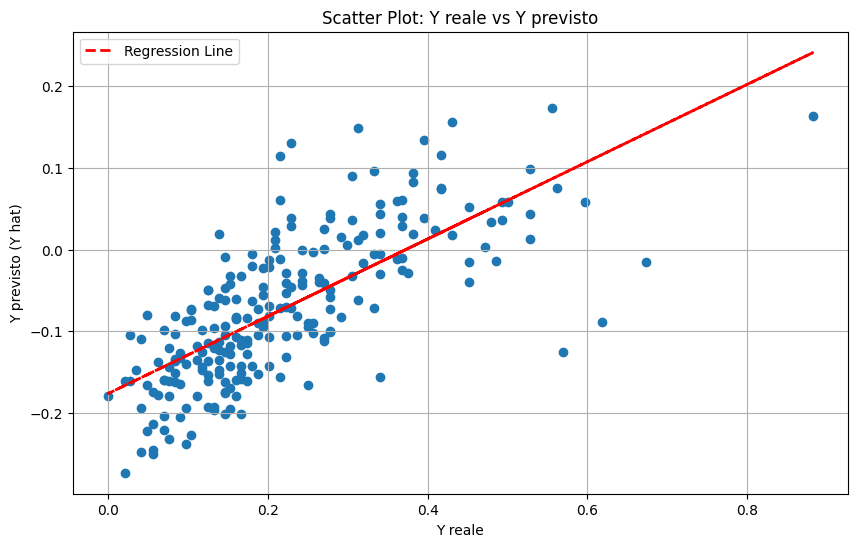

8/8 [==============================] - 0s 6ms/step

Model Completion: 99/144 (68.75%)
Saving data...
8/8 [==============================] - 0s 7ms/step
MAE (Iteration 40): 0.1
R-squared (R2) (Iteration 40): -0.1
RMSE (Iteration 40): 0.15


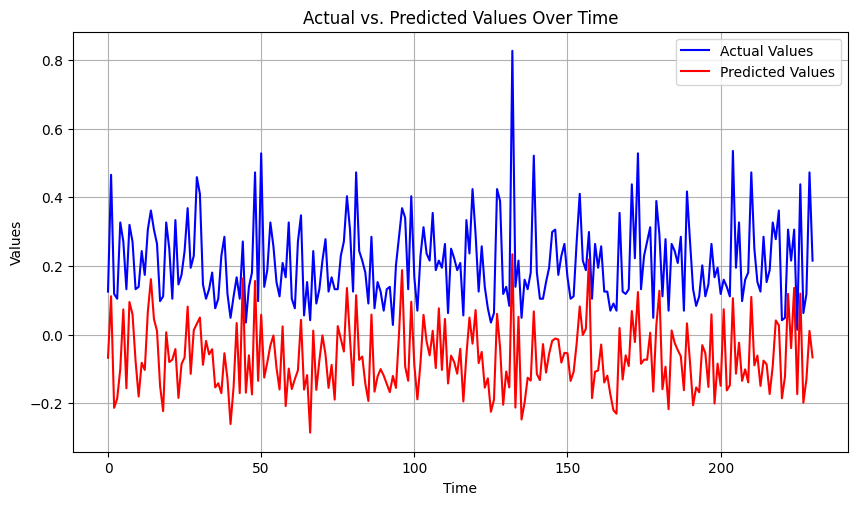

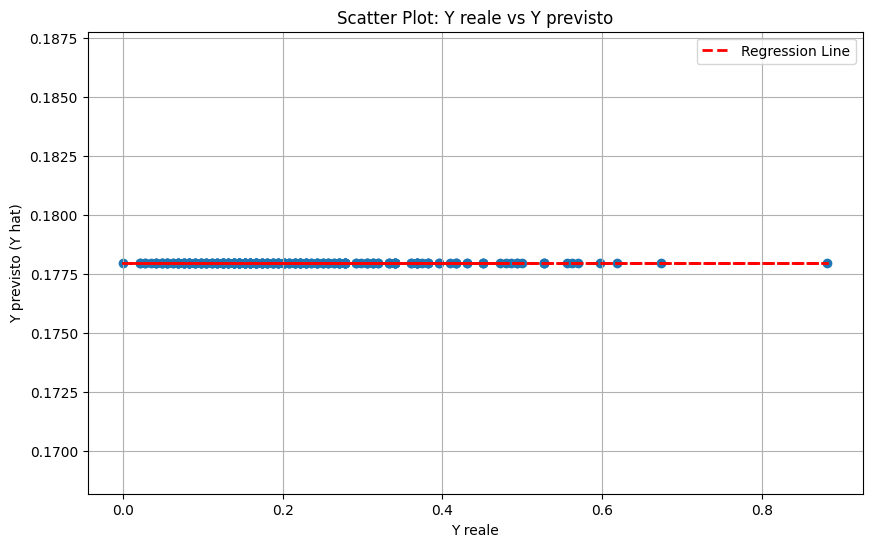

8/8 [==============================] - 0s 4ms/step

Model Completion: 100/144 (69.44%)
Saving data...

Best Model Metrics (Number of Epochs: 200 ):
Best MAE: inf
Best R-squared (R2): -inf
Best RMSE: inf
Number of Epochs: 300
Number of Iterations: 10
8/8 [==============================] - 0s 3ms/step
MAE (Iteration 1): 0.1
R-squared (R2) (Iteration 1): 0.02
RMSE (Iteration 1): 0.14


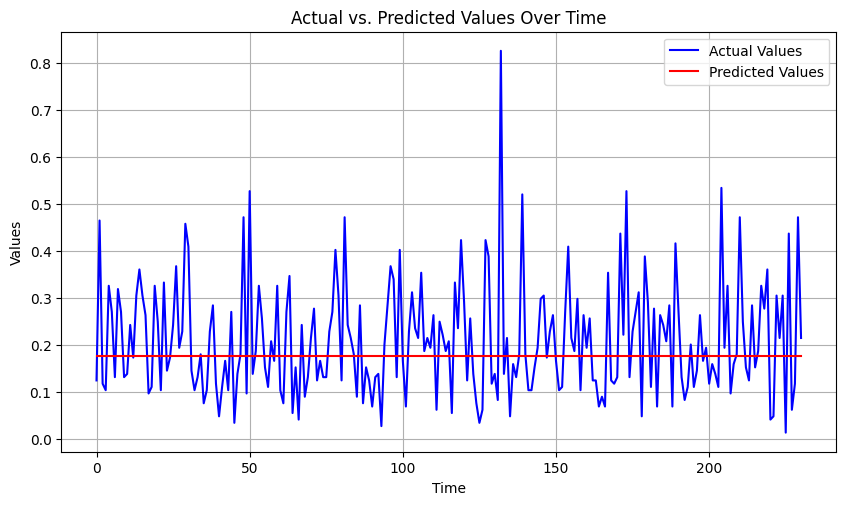

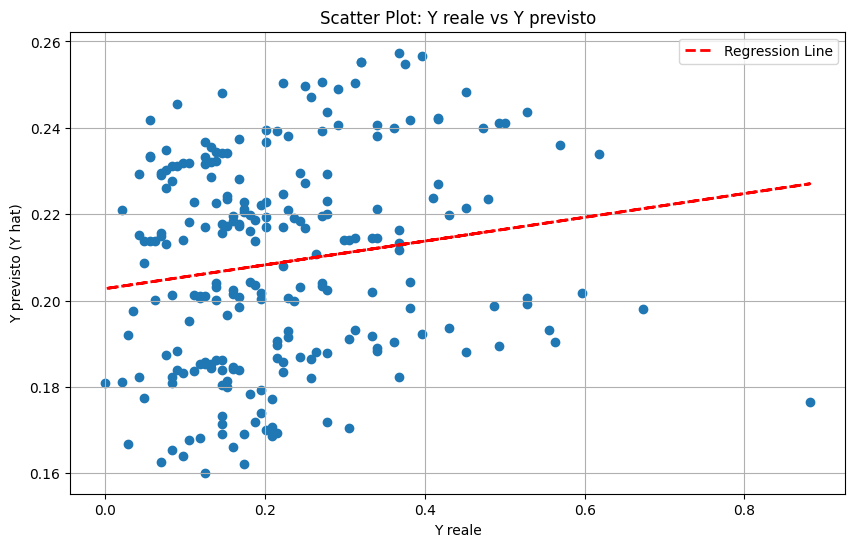

8/8 [==============================] - 0s 5ms/step

Model Completion: 101/144 (70.14%)
Saving data...
8/8 [==============================] - 0s 5ms/step
MAE (Iteration 2): 0.22
R-squared (R2) (Iteration 2): -1.67
RMSE (Iteration 2): 0.23


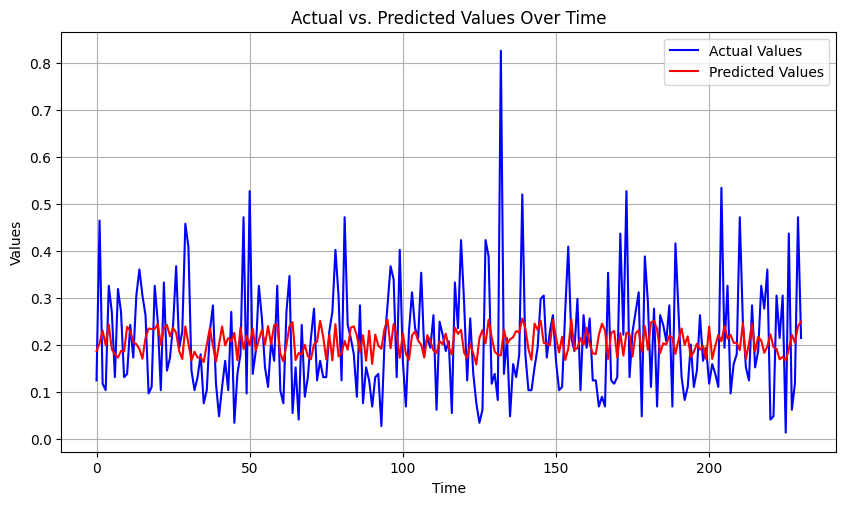

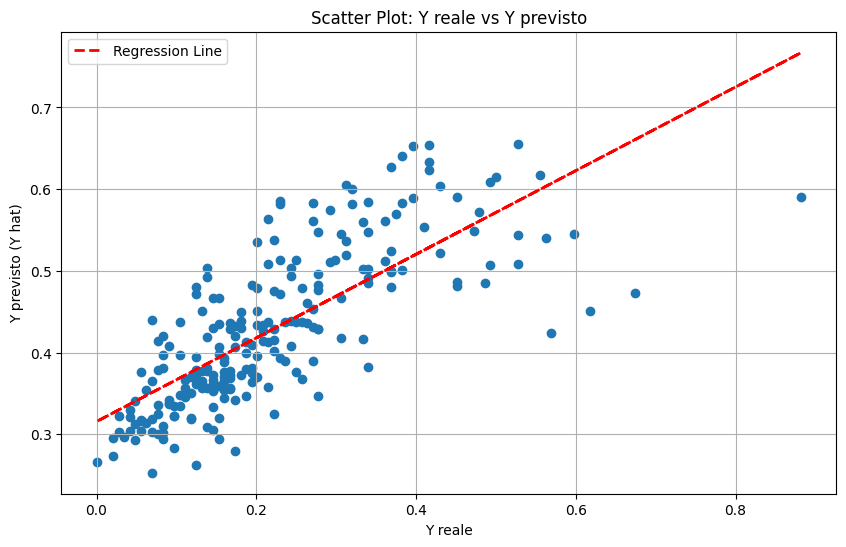

8/8 [==============================] - 0s 6ms/step

Model Completion: 102/144 (70.83%)
Saving data...
8/8 [==============================] - 0s 5ms/step
MAE (Iteration 3): 0.12
R-squared (R2) (Iteration 3): -0.09
RMSE (Iteration 3): 0.14


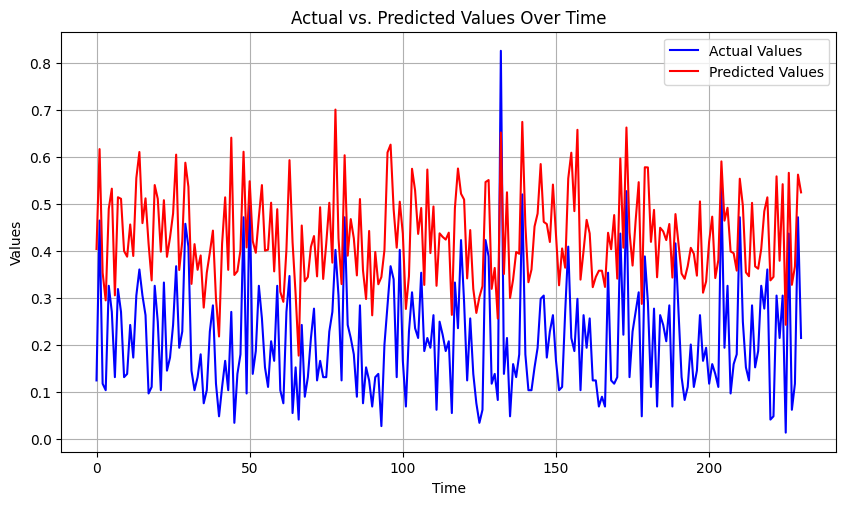

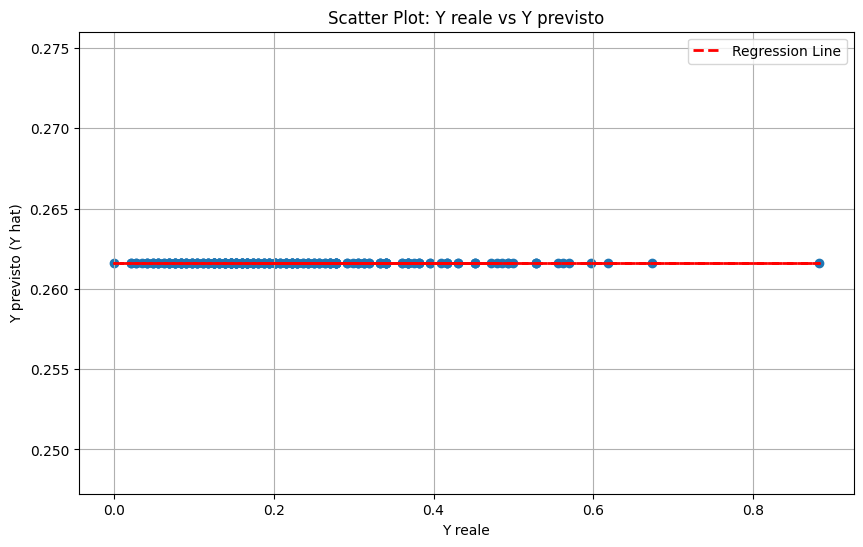

8/8 [==============================] - 0s 6ms/step

Model Completion: 103/144 (71.53%)
Saving data...
8/8 [==============================] - 0s 5ms/step
MAE (Iteration 4): 0.06
R-squared (R2) (Iteration 4): 0.57
RMSE (Iteration 4): 0.09


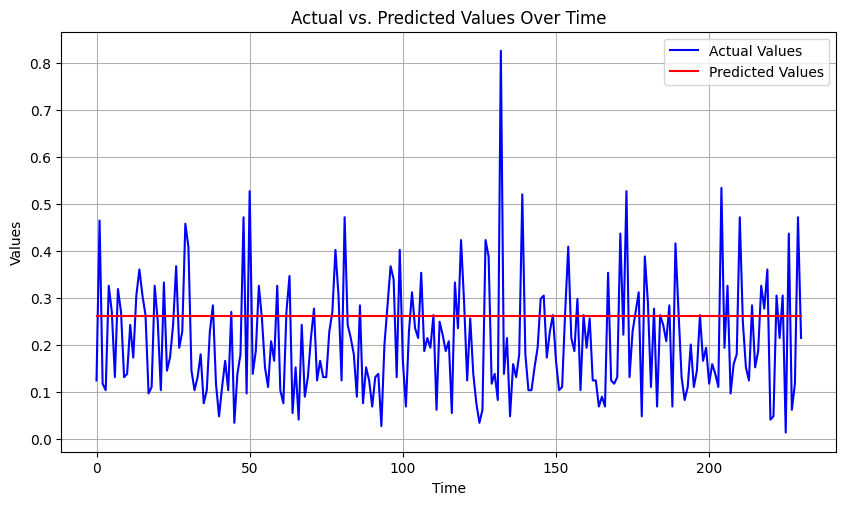

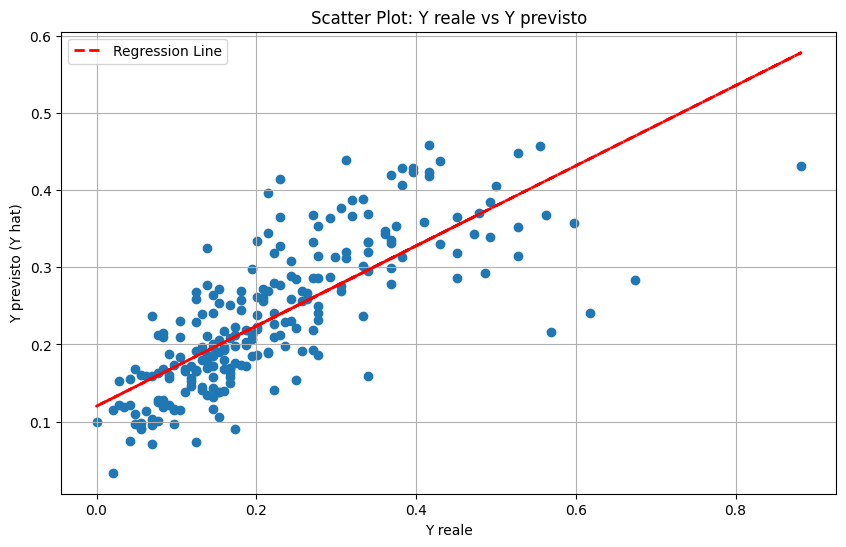

8/8 [==============================] - 0s 7ms/step

Model Completion: 104/144 (72.22%)
Saving data...
8/8 [==============================] - 0s 10ms/step
MAE (Iteration 5): 0.09
R-squared (R2) (Iteration 5): 0.32
RMSE (Iteration 5): 0.11


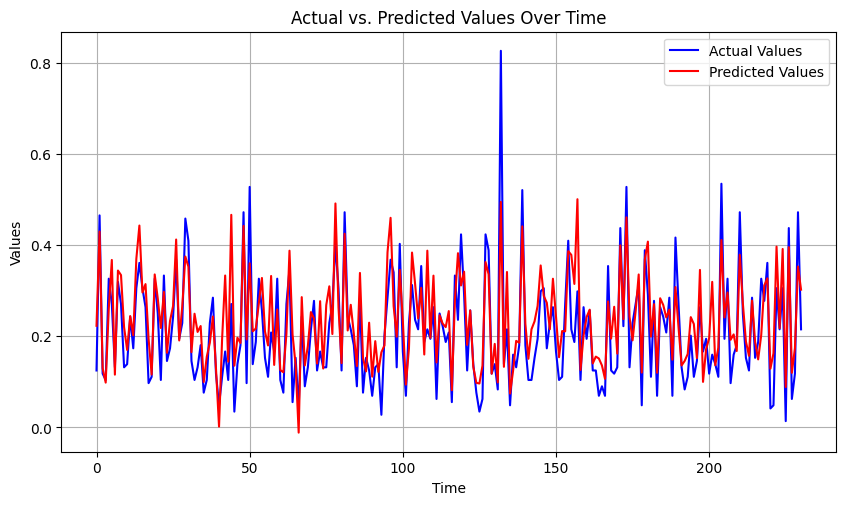

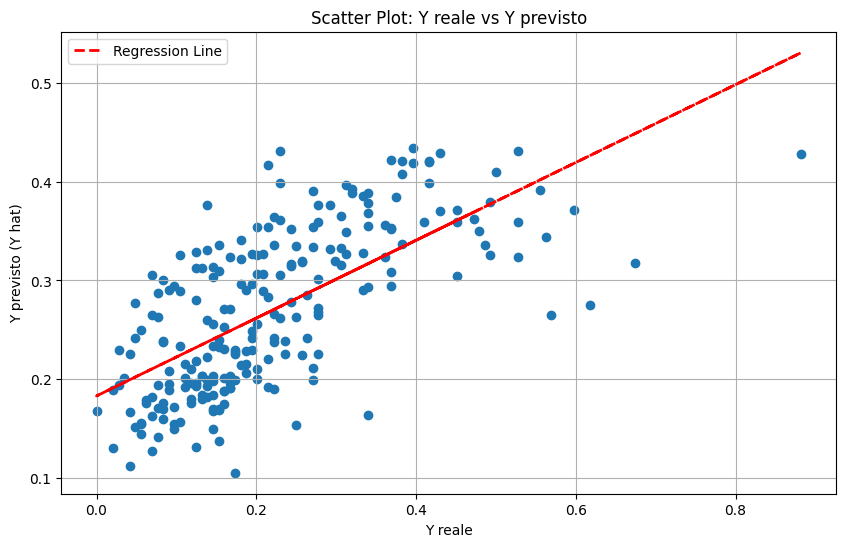

8/8 [==============================] - 0s 6ms/step

Model Completion: 105/144 (72.92%)
Saving data...
8/8 [==============================] - 0s 6ms/step
MAE (Iteration 6): 0.06
R-squared (R2) (Iteration 6): 0.58
RMSE (Iteration 6): 0.09


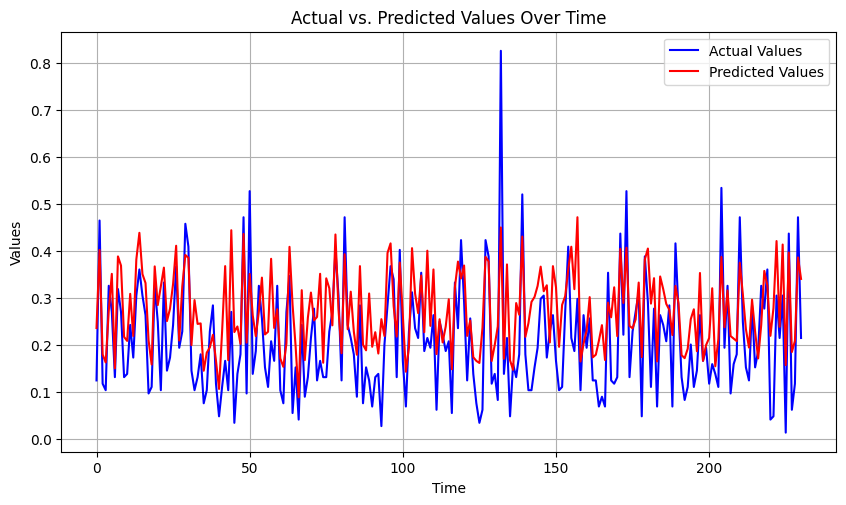

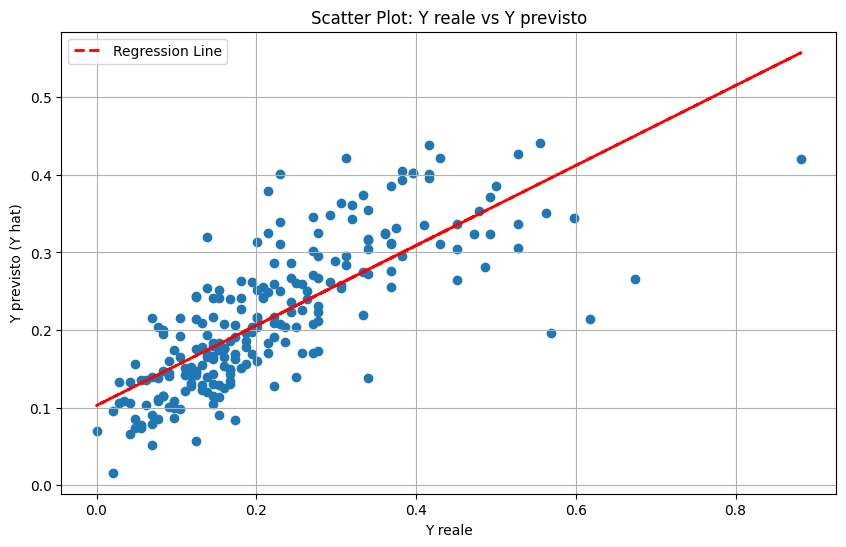

8/8 [==============================] - 0s 5ms/step

Model Completion: 106/144 (73.61%)
Saving data...
8/8 [==============================] - 0s 6ms/step
MAE (Iteration 7): 0.07
R-squared (R2) (Iteration 7): 0.45
RMSE (Iteration 7): 0.1


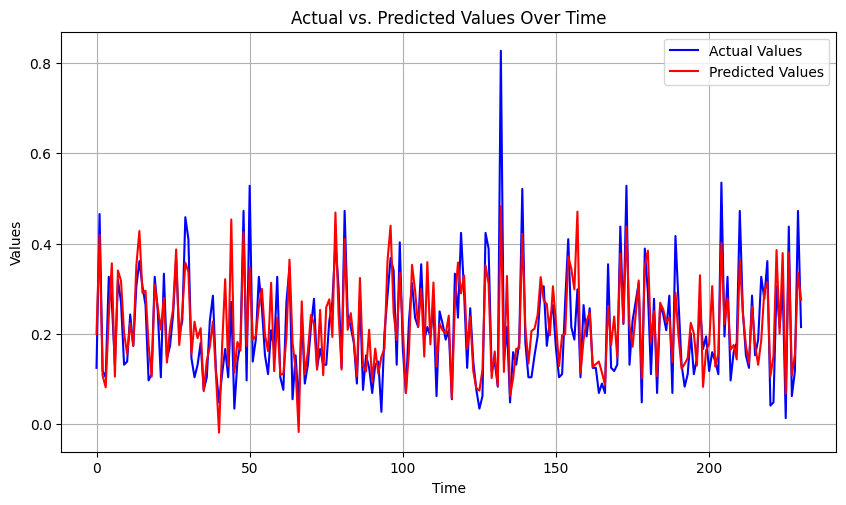

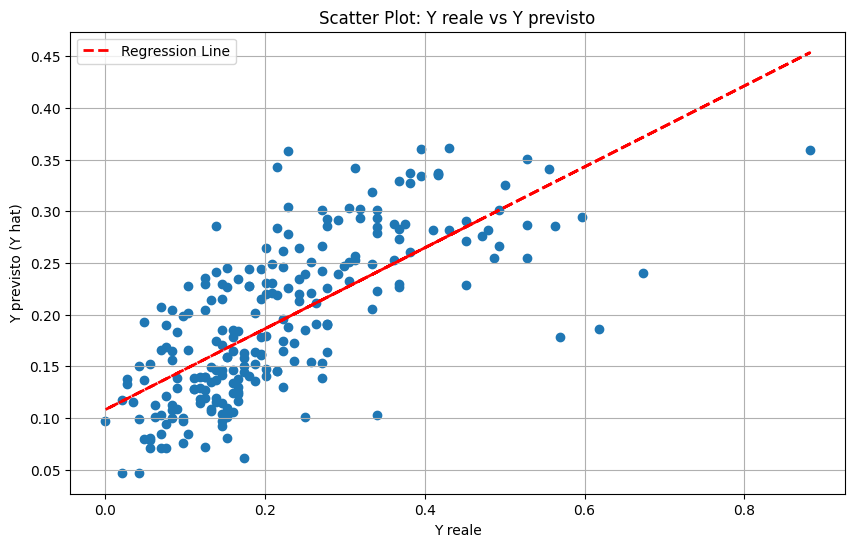

8/8 [==============================] - 0s 5ms/step

Model Completion: 107/144 (74.31%)
Saving data...
8/8 [==============================] - 0s 3ms/step
MAE (Iteration 8): 0.1
R-squared (R2) (Iteration 8): 0.31
RMSE (Iteration 8): 0.12


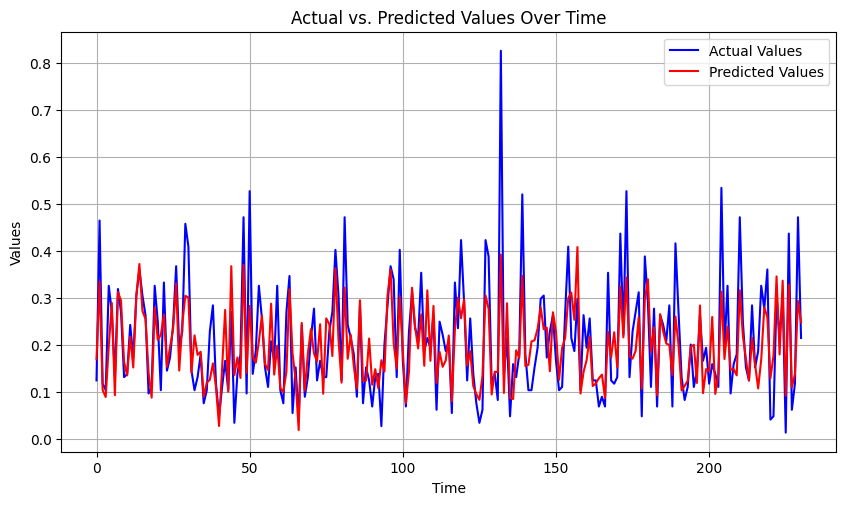

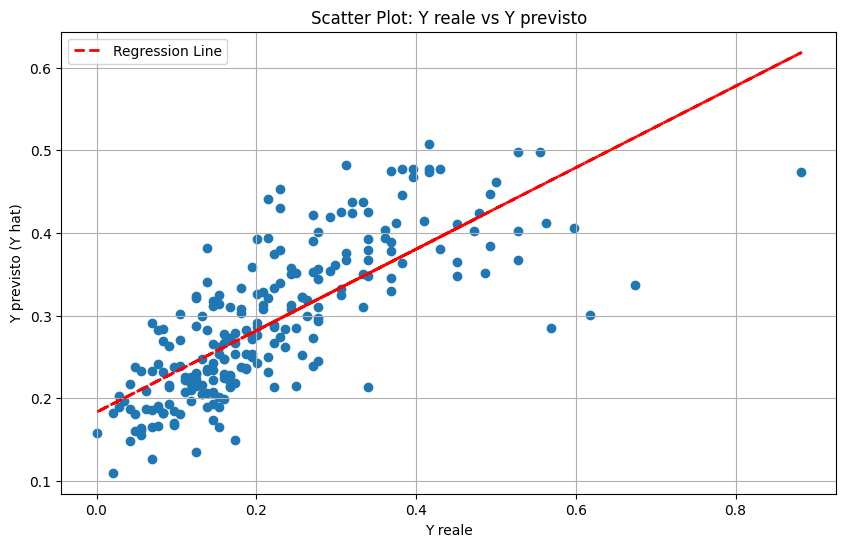

8/8 [==============================] - 0s 3ms/step

Model Completion: 108/144 (75.00%)
Saving data...
8/8 [==============================] - 0s 5ms/step
MAE (Iteration 9): 0.11
R-squared (R2) (Iteration 9): -0.01
RMSE (Iteration 9): 0.14


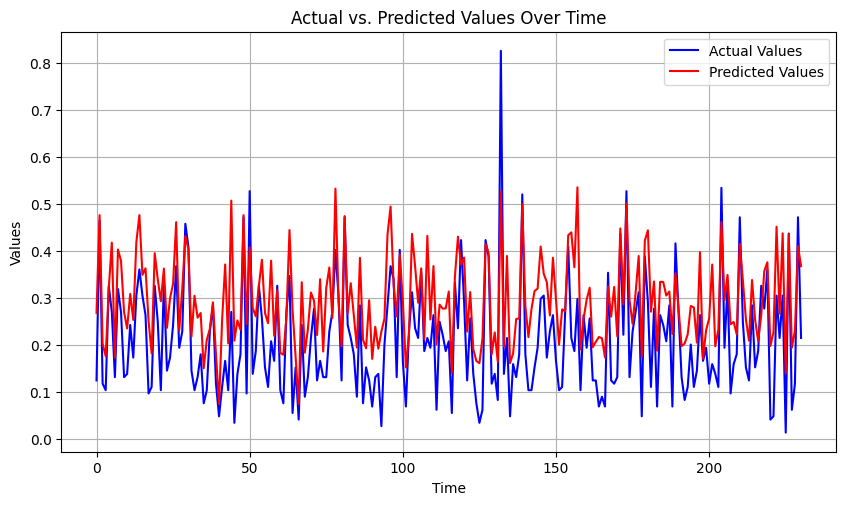

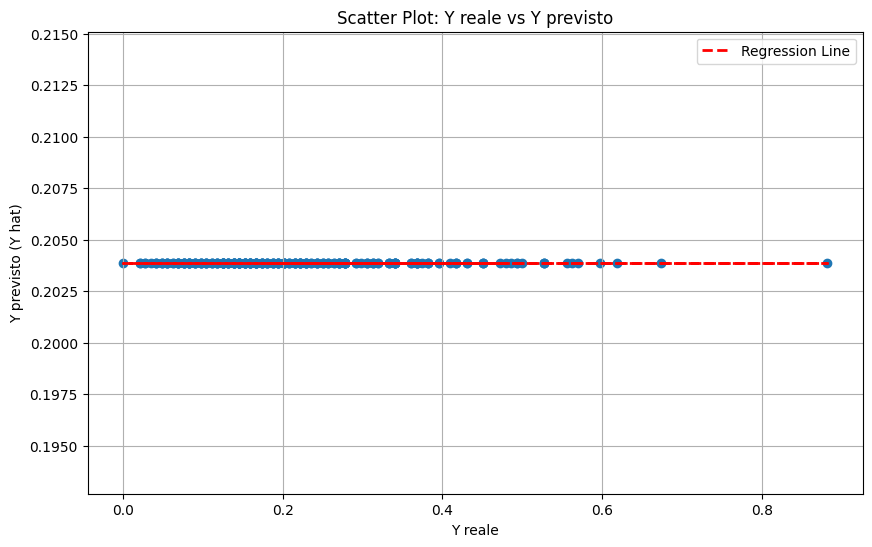

8/8 [==============================] - 0s 7ms/step

Model Completion: 109/144 (75.69%)
Saving data...
8/8 [==============================] - 0s 4ms/step
MAE (Iteration 10): 0.11
R-squared (R2) (Iteration 10): -0.01
RMSE (Iteration 10): 0.14


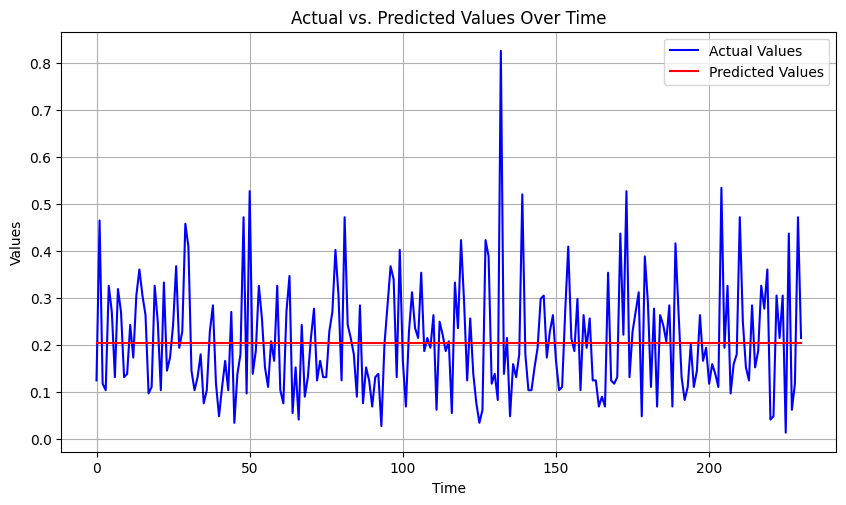

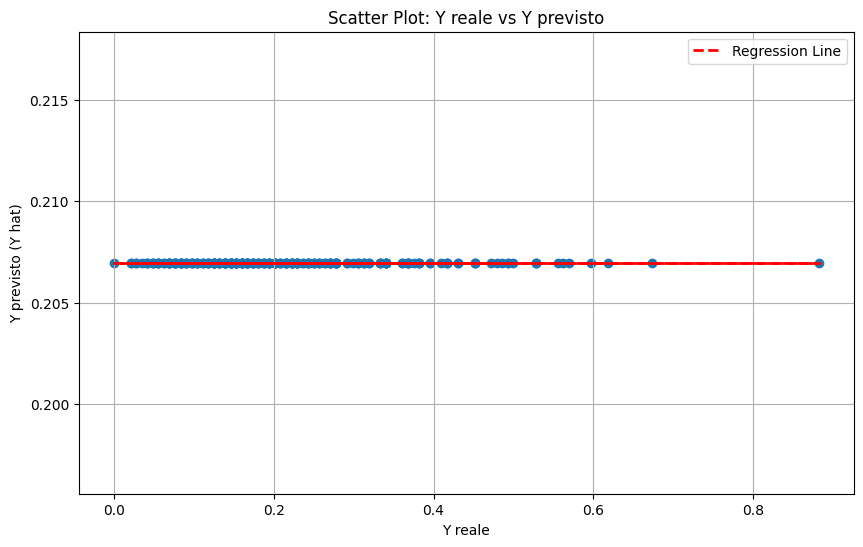

8/8 [==============================] - 0s 5ms/step

Model Completion: 110/144 (76.39%)
Saving data...
Number of Iterations: 20
8/8 [==============================] - 0s 3ms/step
MAE (Iteration 1): 0.12
R-squared (R2) (Iteration 1): 0.09
RMSE (Iteration 1): 0.13


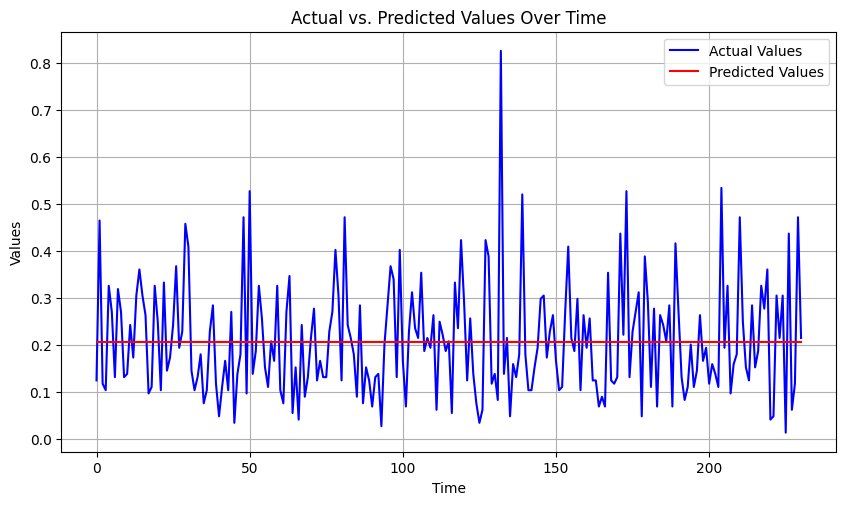

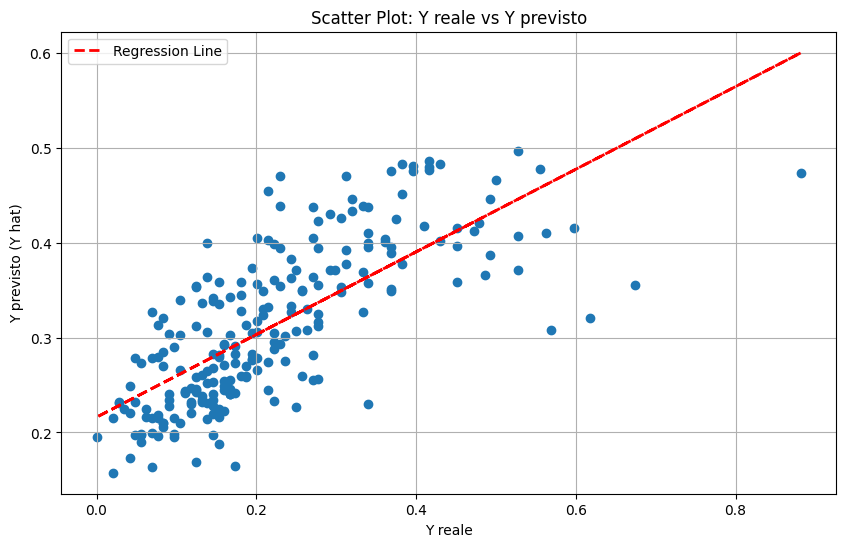

8/8 [==============================] - 0s 6ms/step

Model Completion: 111/144 (77.08%)
Saving data...
8/8 [==============================] - 0s 6ms/step
MAE (Iteration 2): 0.1
R-squared (R2) (Iteration 2): -0.02
RMSE (Iteration 2): 0.14


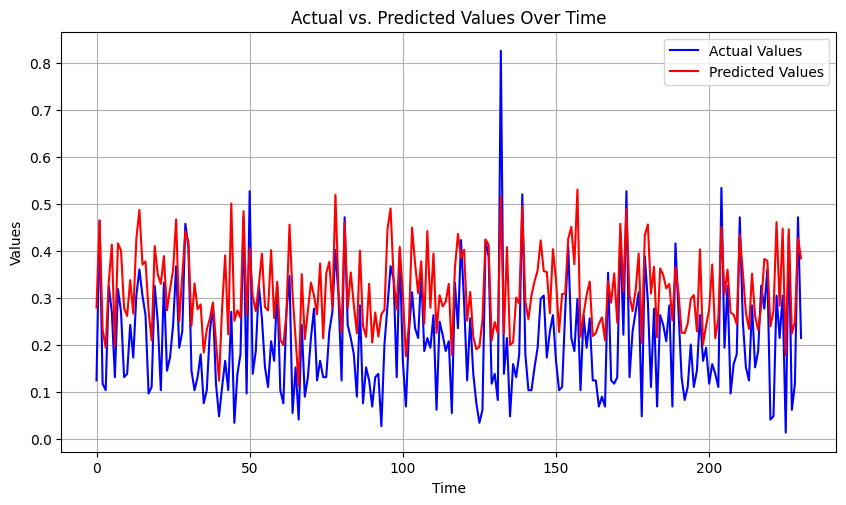

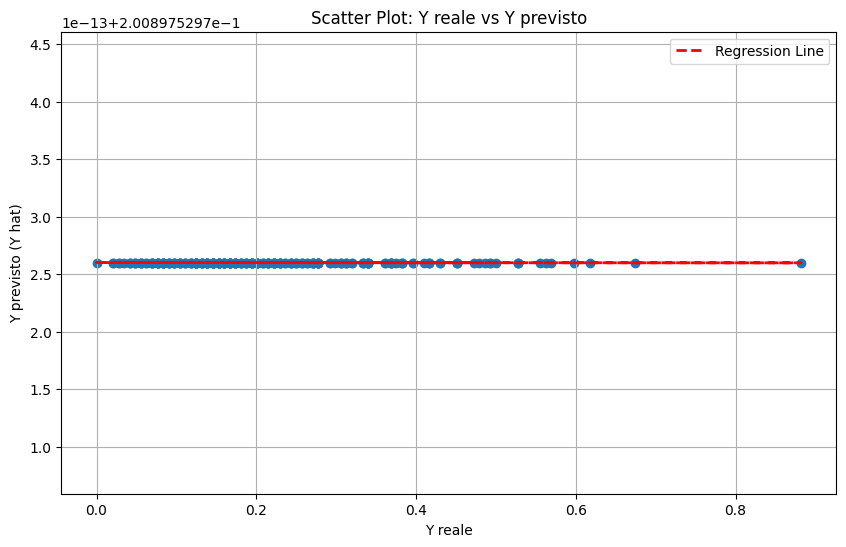

8/8 [==============================] - 0s 5ms/step

Model Completion: 112/144 (77.78%)
Saving data...
8/8 [==============================] - 0s 9ms/step
MAE (Iteration 3): 0.11
R-squared (R2) (Iteration 3): -0.0
RMSE (Iteration 3): 0.14


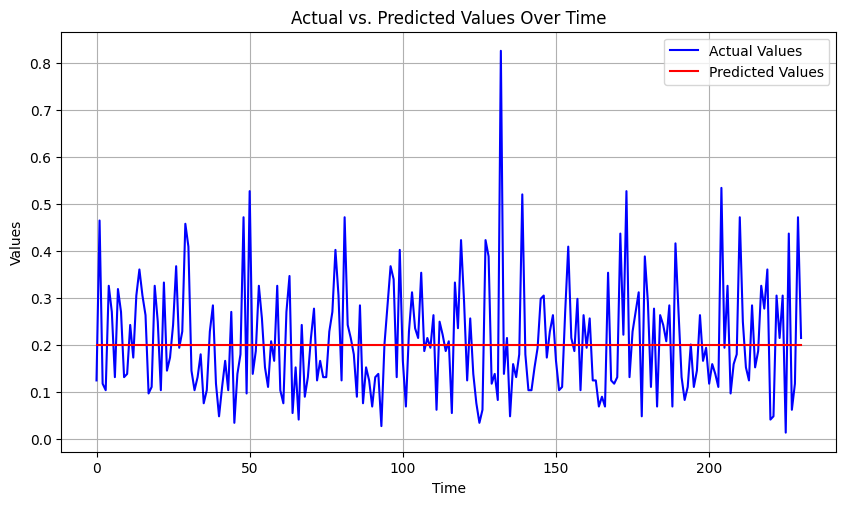

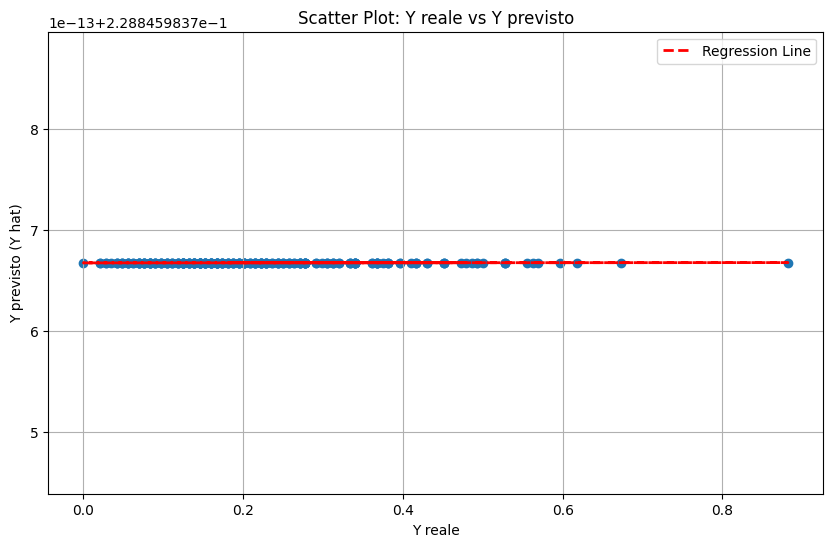

8/8 [==============================] - 0s 5ms/step

Model Completion: 113/144 (78.47%)
Saving data...
8/8 [==============================] - 0s 5ms/step
MAE (Iteration 4): 0.1
R-squared (R2) (Iteration 4): -0.02
RMSE (Iteration 4): 0.14


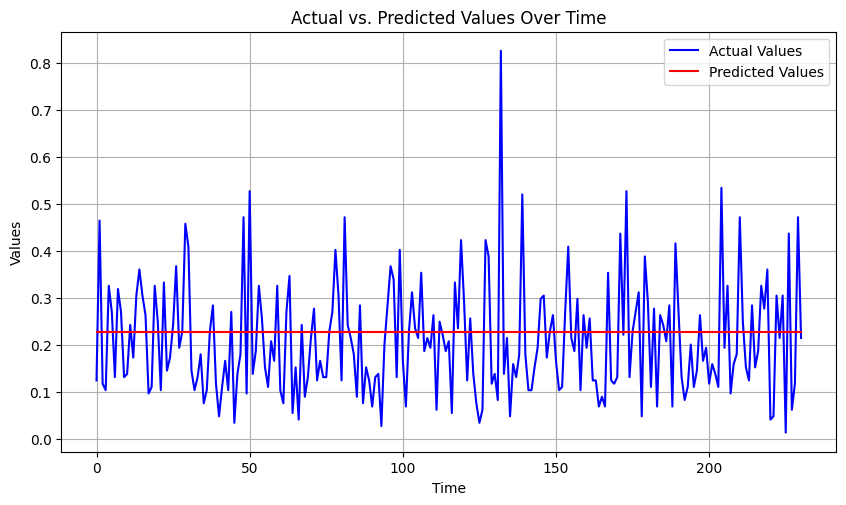

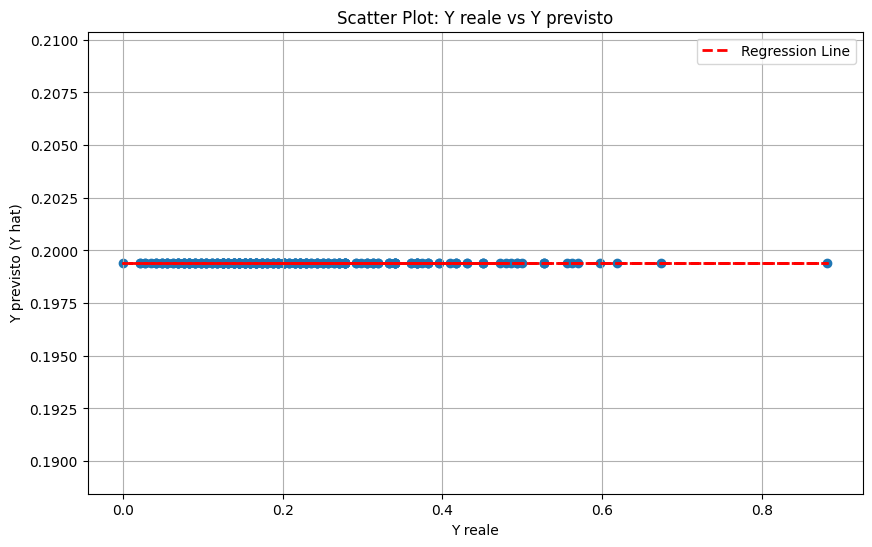

8/8 [==============================] - 0s 6ms/step

Model Completion: 114/144 (79.17%)
Saving data...
8/8 [==============================] - 0s 4ms/step
MAE (Iteration 5): 0.1
R-squared (R2) (Iteration 5): -0.02
RMSE (Iteration 5): 0.14


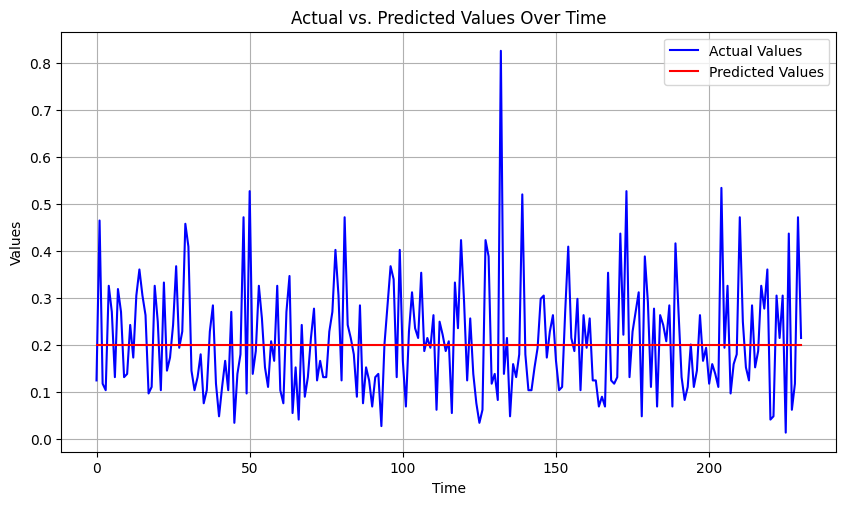

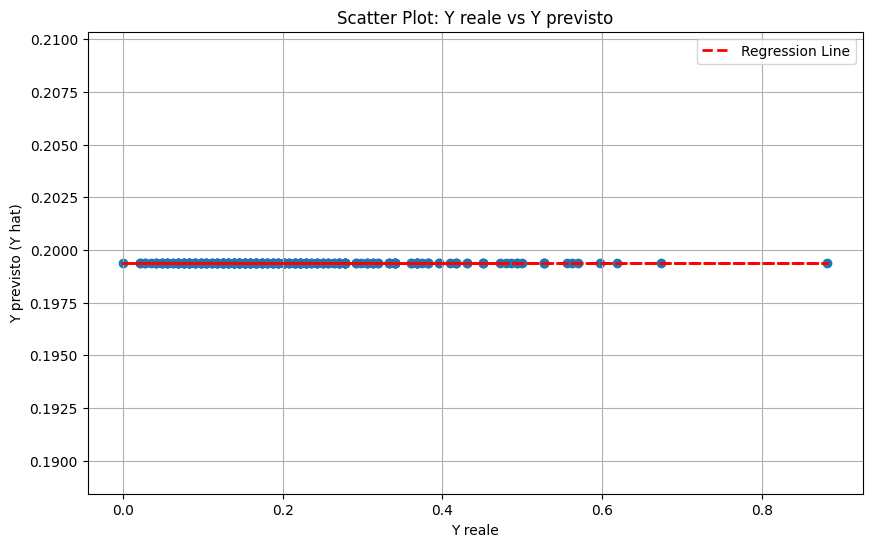

8/8 [==============================] - 0s 4ms/step

Model Completion: 115/144 (79.86%)
Saving data...
8/8 [==============================] - 0s 9ms/step
MAE (Iteration 6): 0.11
R-squared (R2) (Iteration 6): -0.01
RMSE (Iteration 6): 0.14


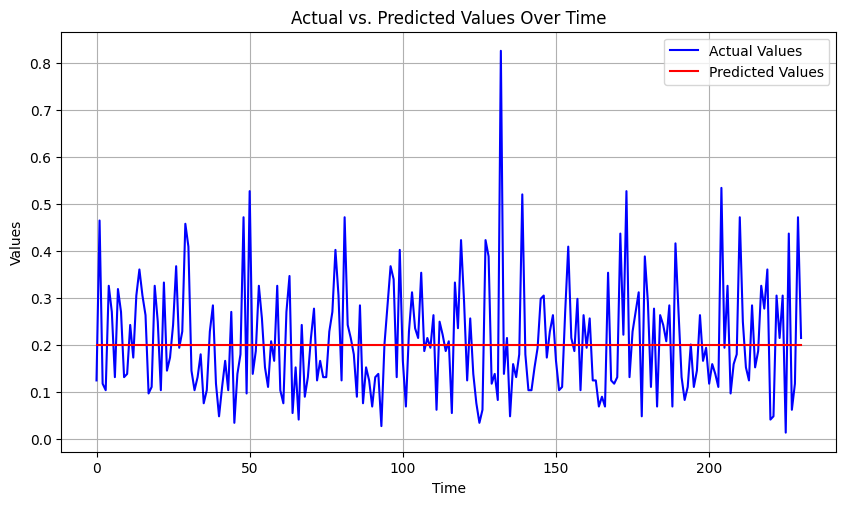

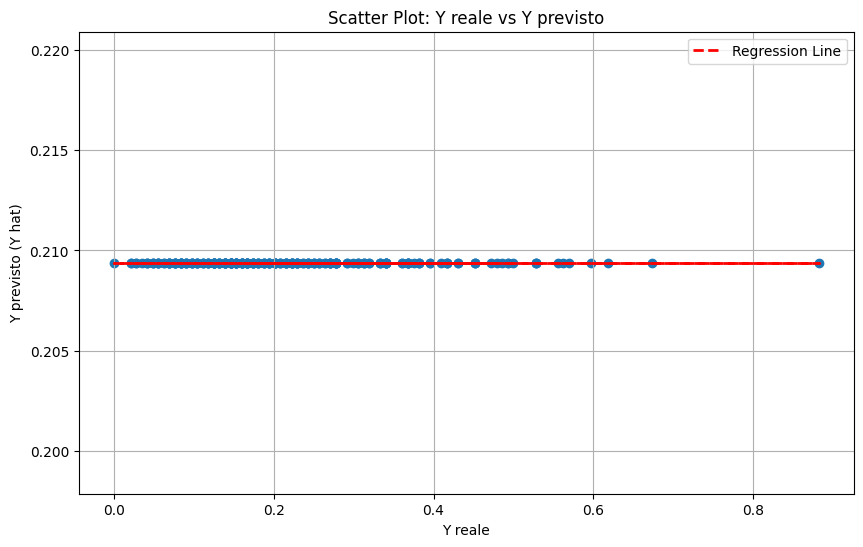

8/8 [==============================] - 0s 7ms/step

Model Completion: 116/144 (80.56%)
Saving data...
8/8 [==============================] - 0s 6ms/step
MAE (Iteration 7): 0.1
R-squared (R2) (Iteration 7): -0.02
RMSE (Iteration 7): 0.14


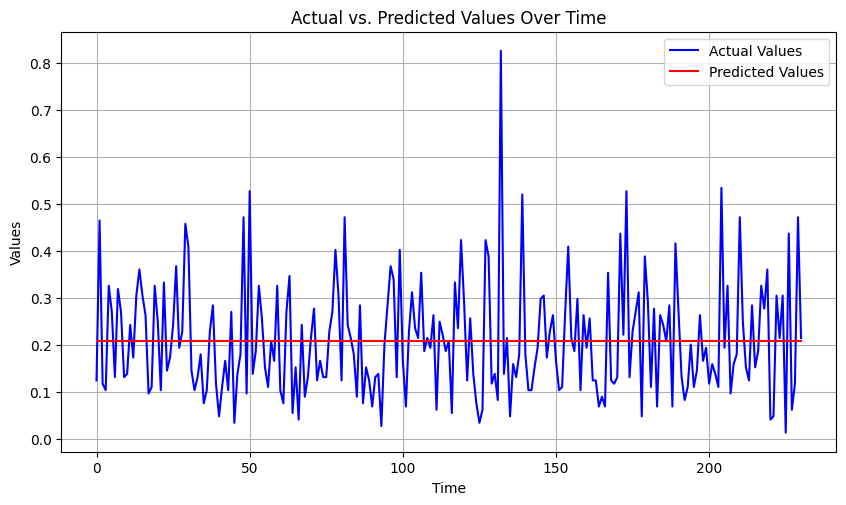

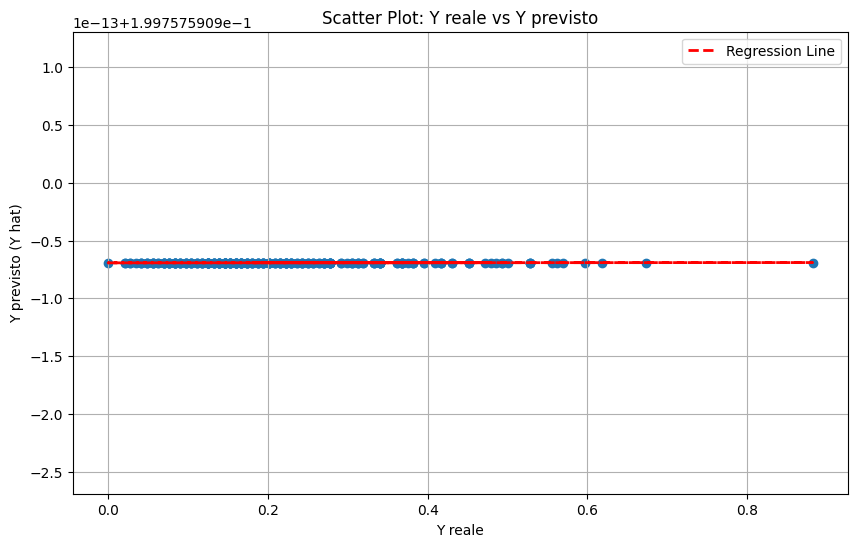

8/8 [==============================] - 0s 5ms/step

Model Completion: 117/144 (81.25%)
Saving data...
8/8 [==============================] - 0s 3ms/step
MAE (Iteration 8): 0.07
R-squared (R2) (Iteration 8): 0.48
RMSE (Iteration 8): 0.1


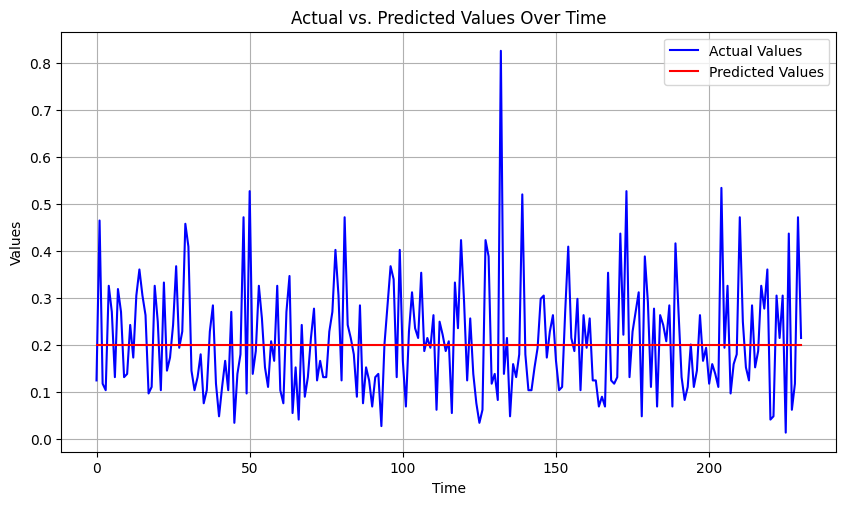

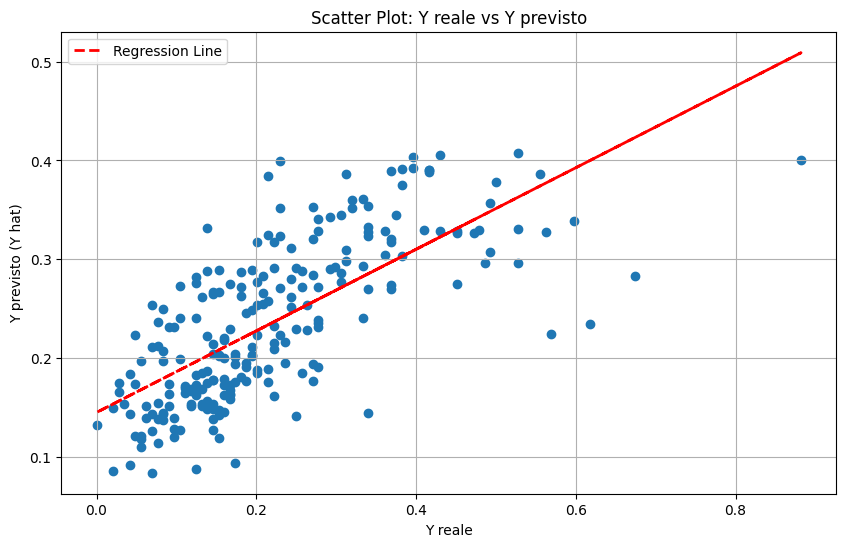

8/8 [==============================] - 0s 5ms/step

Model Completion: 118/144 (81.94%)
Saving data...
8/8 [==============================] - 0s 4ms/step
MAE (Iteration 9): 0.2
R-squared (R2) (Iteration 9): -1.3
RMSE (Iteration 9): 0.21


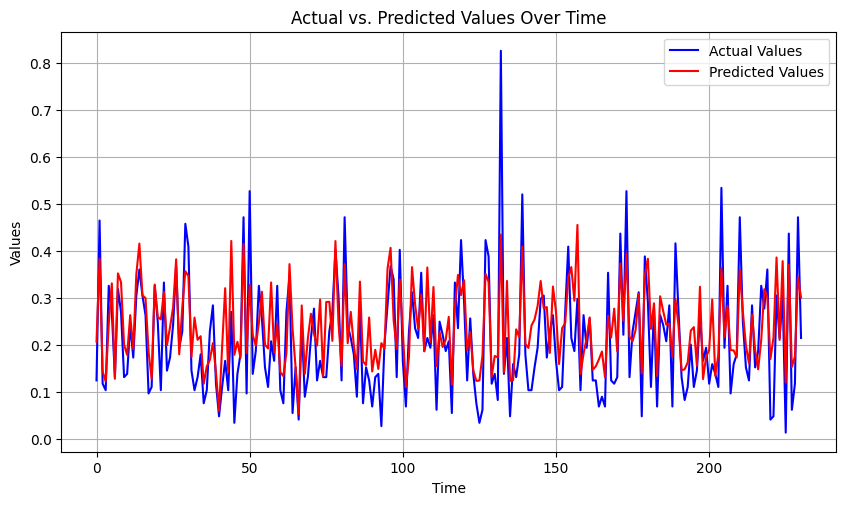

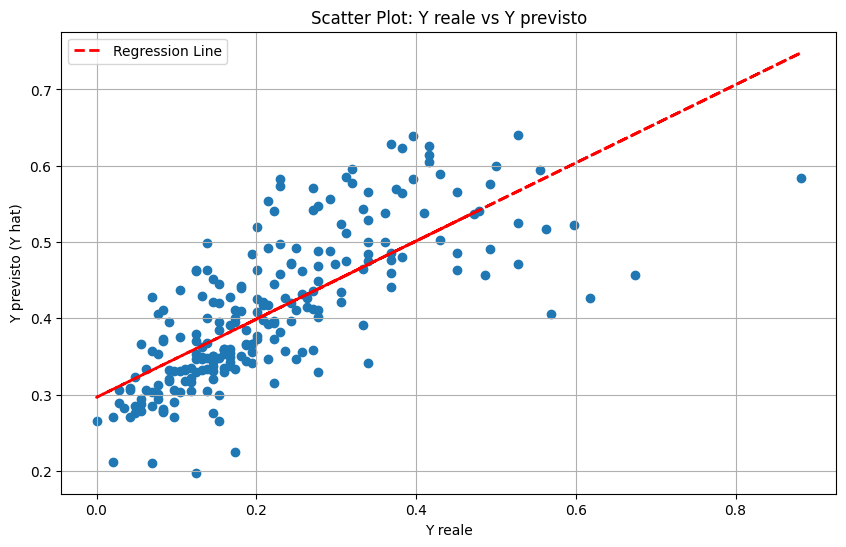

8/8 [==============================] - 0s 4ms/step

Model Completion: 119/144 (82.64%)
Saving data...
8/8 [==============================] - 0s 7ms/step
MAE (Iteration 10): 0.1
R-squared (R2) (Iteration 10): -0.02
RMSE (Iteration 10): 0.14


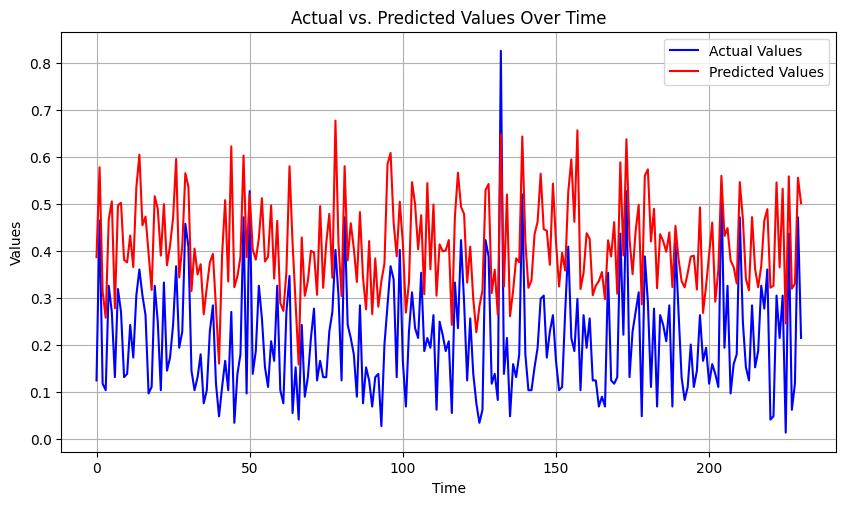

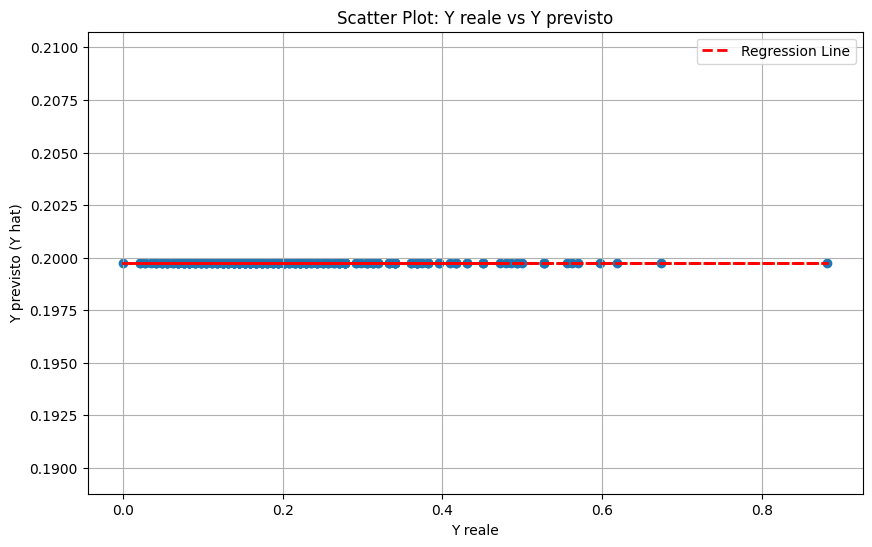

8/8 [==============================] - 0s 7ms/step

Model Completion: 120/144 (83.33%)
Saving data...
8/8 [==============================] - 0s 6ms/step
MAE (Iteration 11): 0.11
R-squared (R2) (Iteration 11): -0.02
RMSE (Iteration 11): 0.14


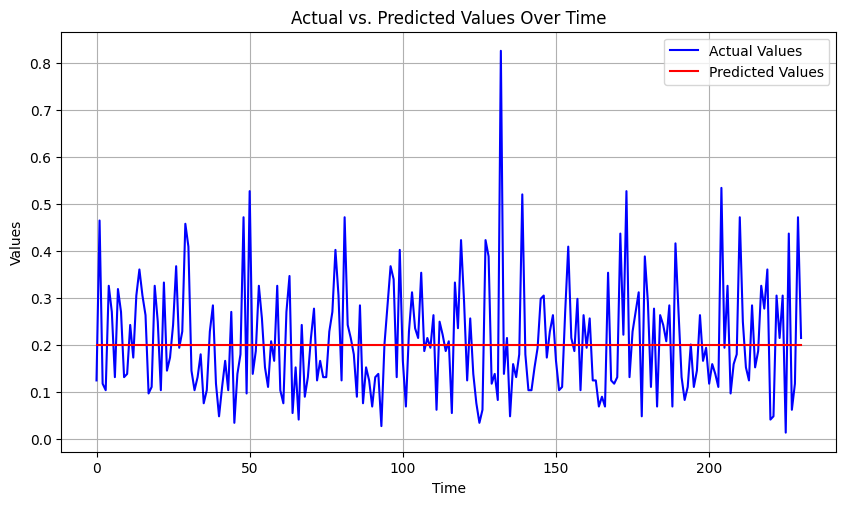

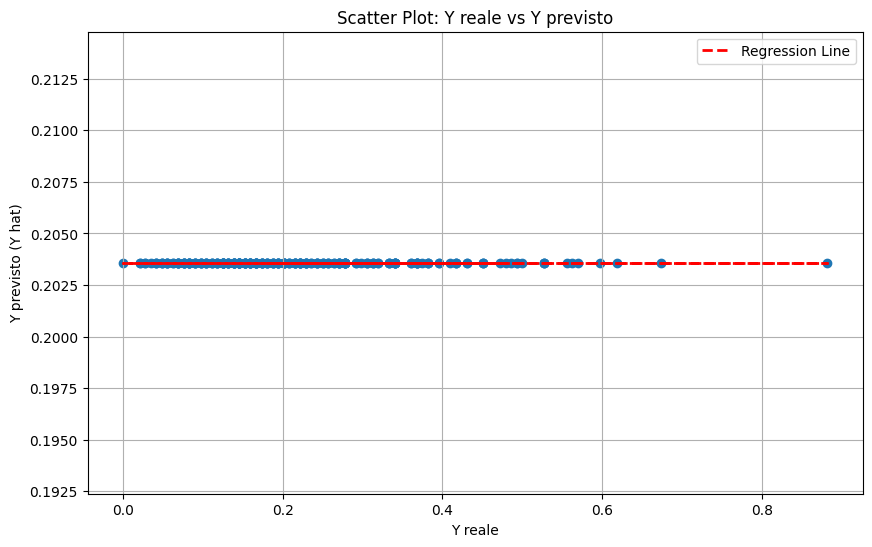

8/8 [==============================] - 0s 9ms/step

Model Completion: 121/144 (84.03%)
Saving data...
8/8 [==============================] - 0s 8ms/step
MAE (Iteration 12): 0.26
R-squared (R2) (Iteration 12): -2.94
RMSE (Iteration 12): 0.28


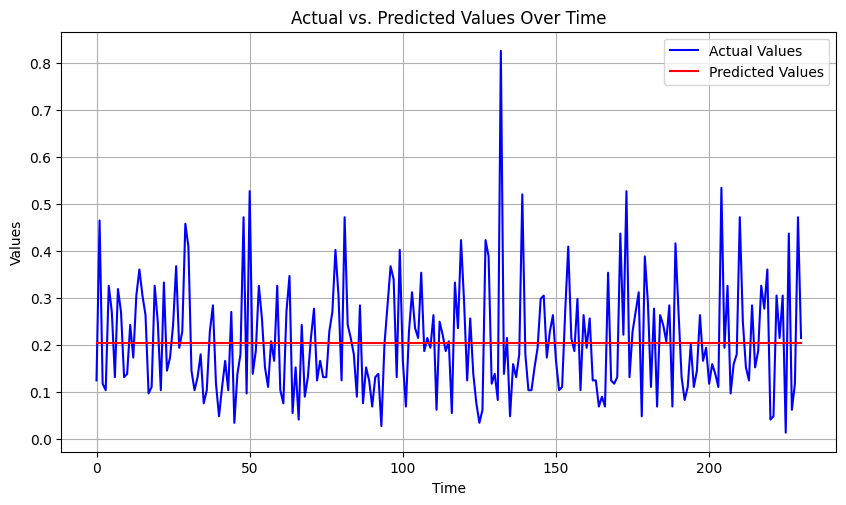

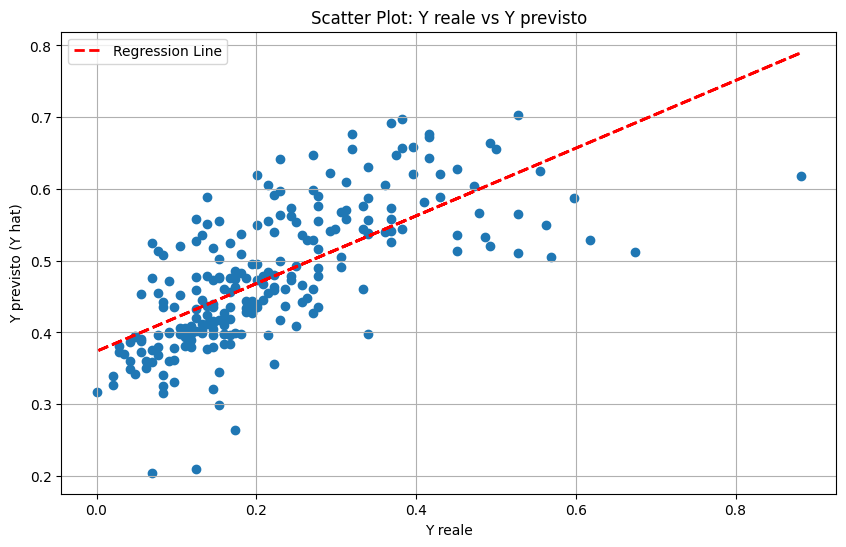

8/8 [==============================] - 0s 4ms/step

Model Completion: 122/144 (84.72%)
Saving data...
8/8 [==============================] - 0s 5ms/step
MAE (Iteration 13): 0.1
R-squared (R2) (Iteration 13): -0.02
RMSE (Iteration 13): 0.14


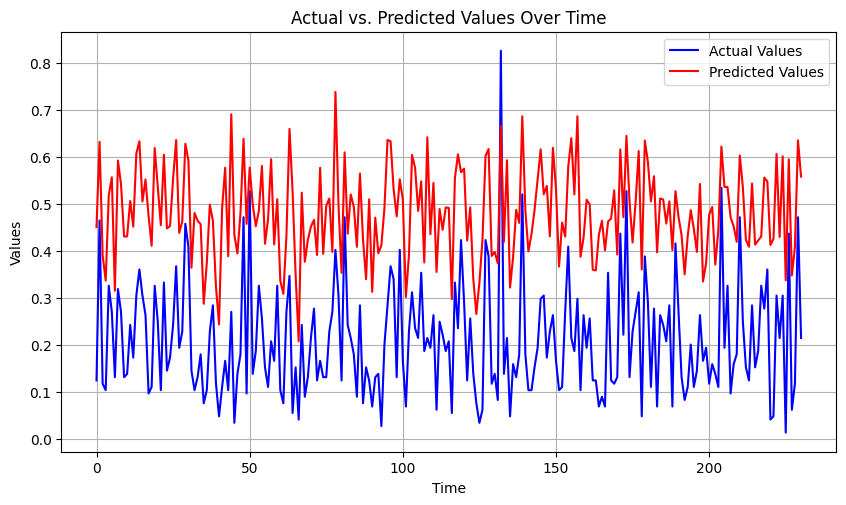

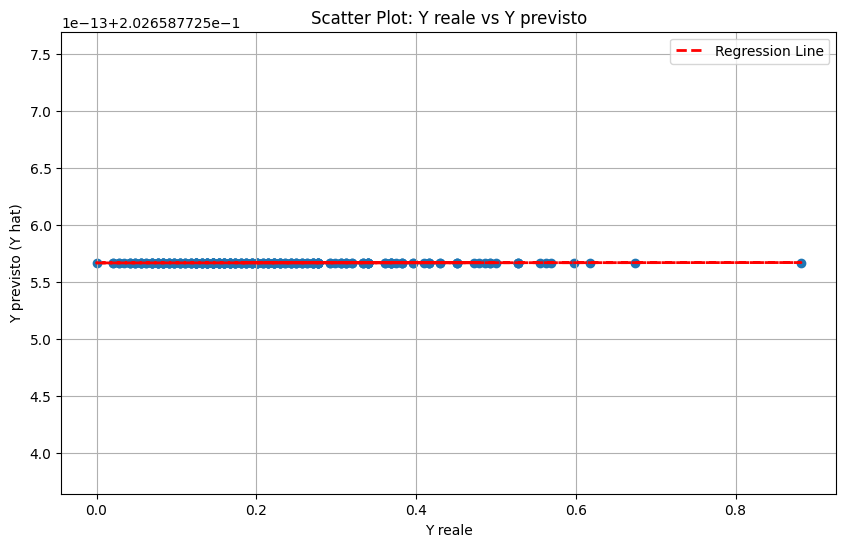

8/8 [==============================] - 0s 7ms/step

Model Completion: 123/144 (85.42%)
Saving data...
8/8 [==============================] - 0s 4ms/step
MAE (Iteration 14): 0.11
R-squared (R2) (Iteration 14): -0.02
RMSE (Iteration 14): 0.14


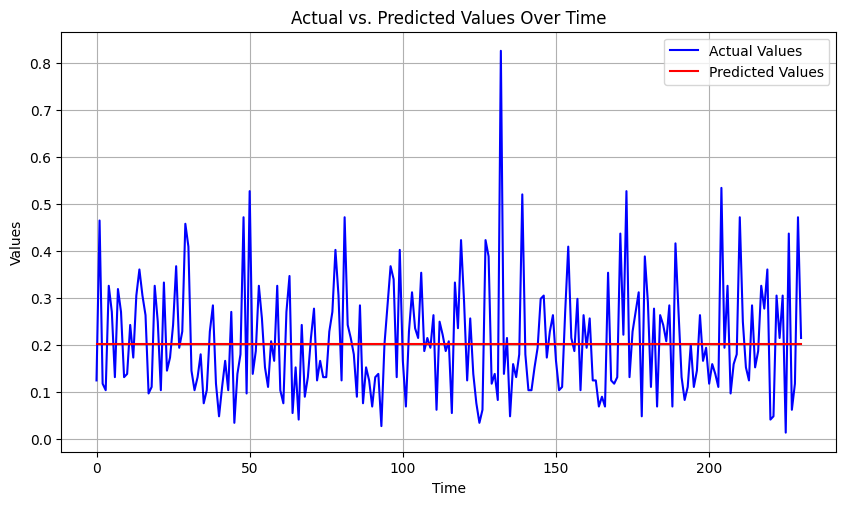

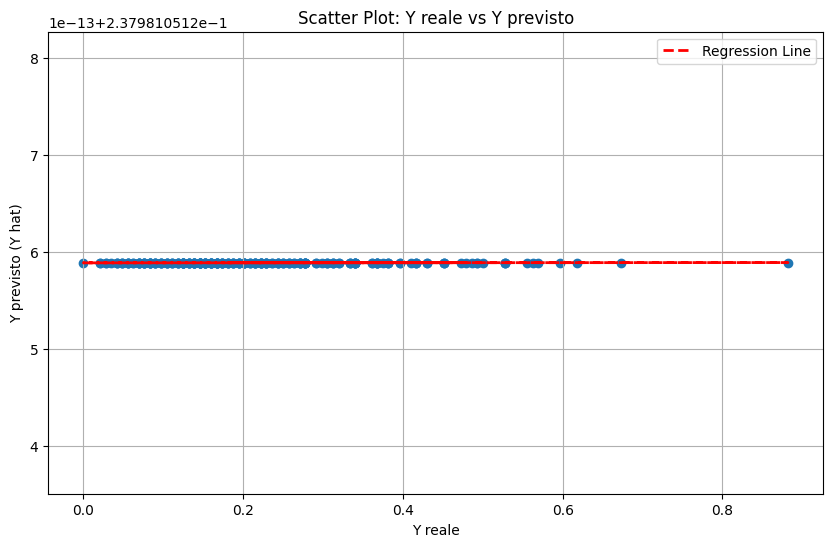

8/8 [==============================] - 0s 4ms/step

Model Completion: 124/144 (86.11%)
Saving data...
8/8 [==============================] - 0s 4ms/step
MAE (Iteration 15): 0.08
R-squared (R2) (Iteration 15): 0.42
RMSE (Iteration 15): 0.11


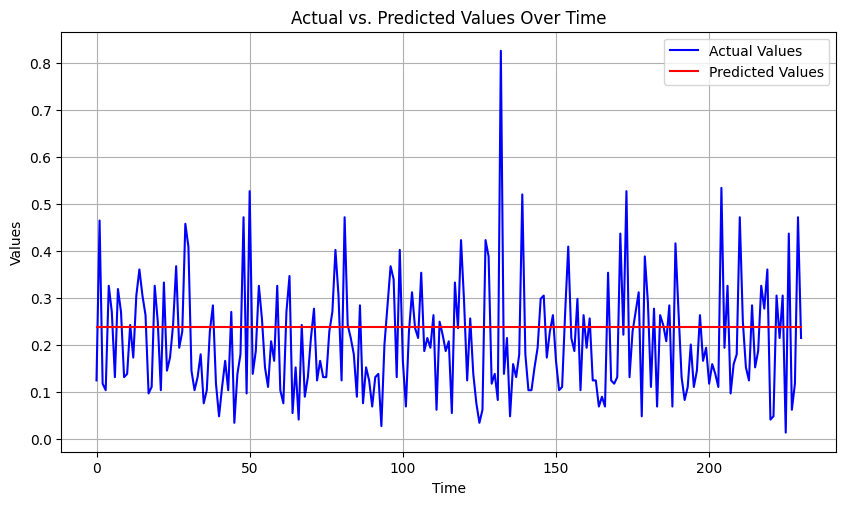

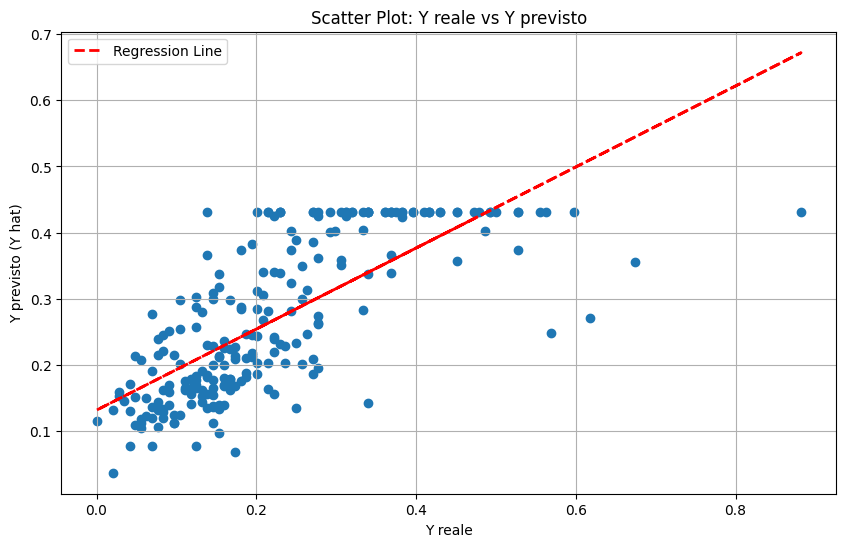

8/8 [==============================] - 0s 3ms/step

Model Completion: 125/144 (86.81%)
Saving data...
8/8 [==============================] - 0s 3ms/step
MAE (Iteration 16): 0.11
R-squared (R2) (Iteration 16): -0.01
RMSE (Iteration 16): 0.14


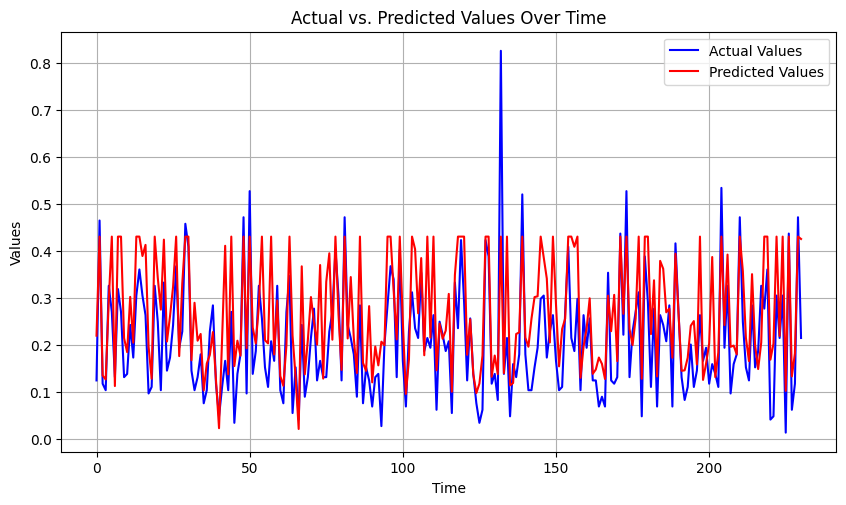

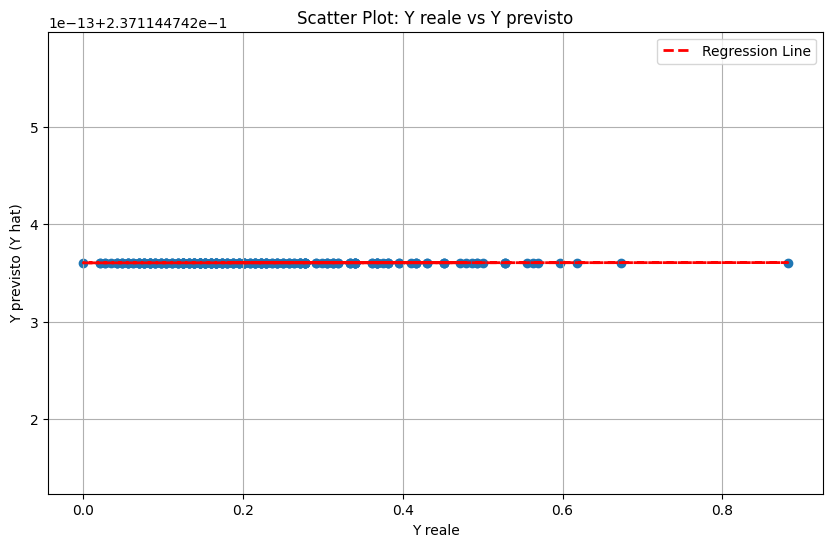

8/8 [==============================] - 0s 5ms/step

Model Completion: 126/144 (87.50%)
Saving data...
8/8 [==============================] - 0s 6ms/step
MAE (Iteration 17): 0.1
R-squared (R2) (Iteration 17): -0.02
RMSE (Iteration 17): 0.14


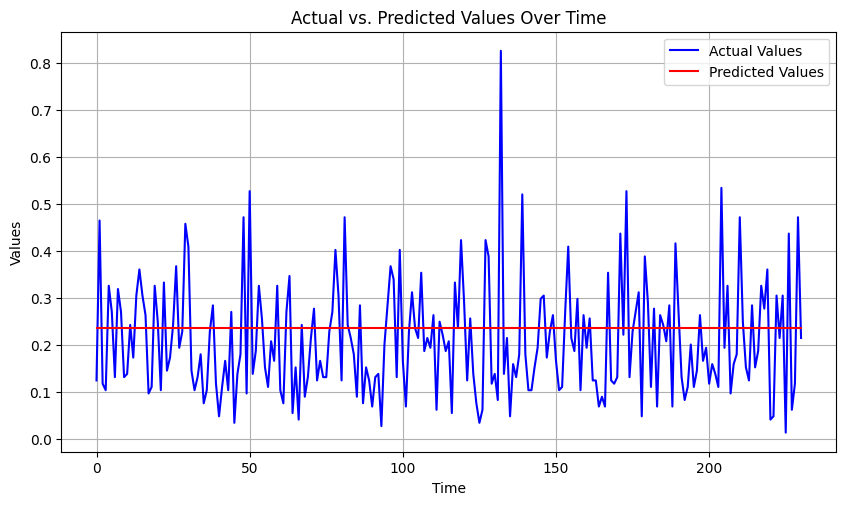

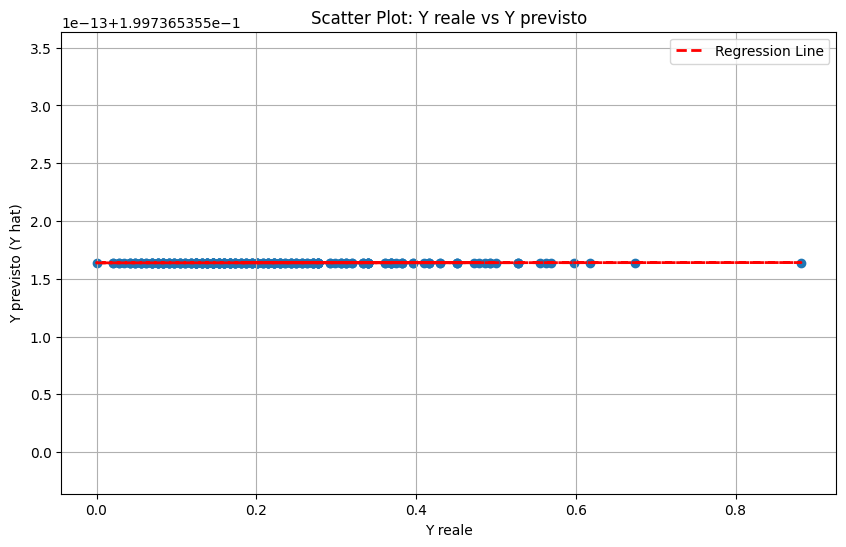

8/8 [==============================] - 0s 6ms/step

Model Completion: 127/144 (88.19%)
Saving data...
8/8 [==============================] - 0s 4ms/step
MAE (Iteration 18): 0.1
R-squared (R2) (Iteration 18): -0.02
RMSE (Iteration 18): 0.14


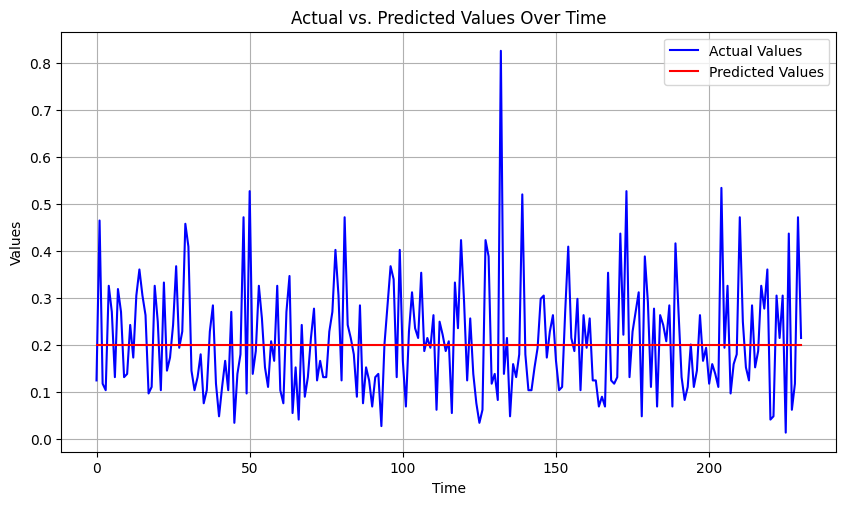

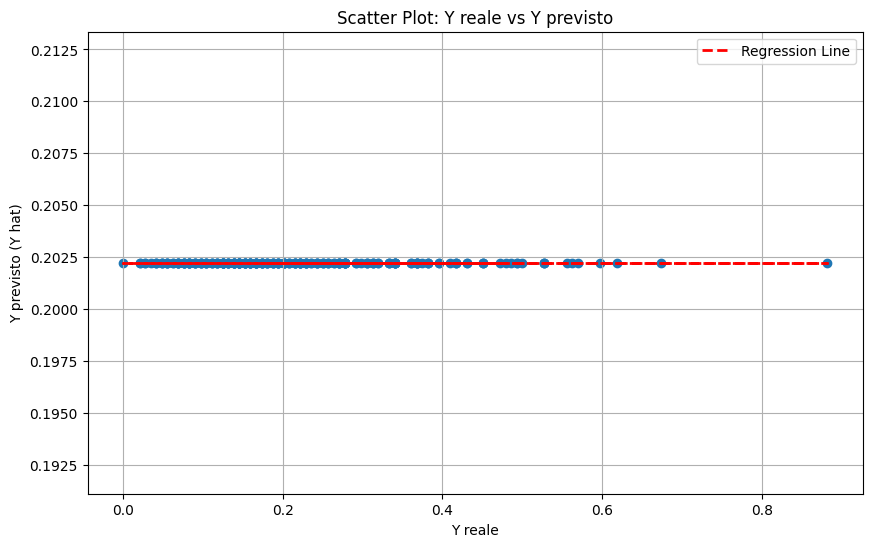

8/8 [==============================] - 0s 5ms/step

Model Completion: 128/144 (88.89%)
Saving data...
8/8 [==============================] - 0s 3ms/step
MAE (Iteration 19): 0.11
R-squared (R2) (Iteration 19): -0.01
RMSE (Iteration 19): 0.14


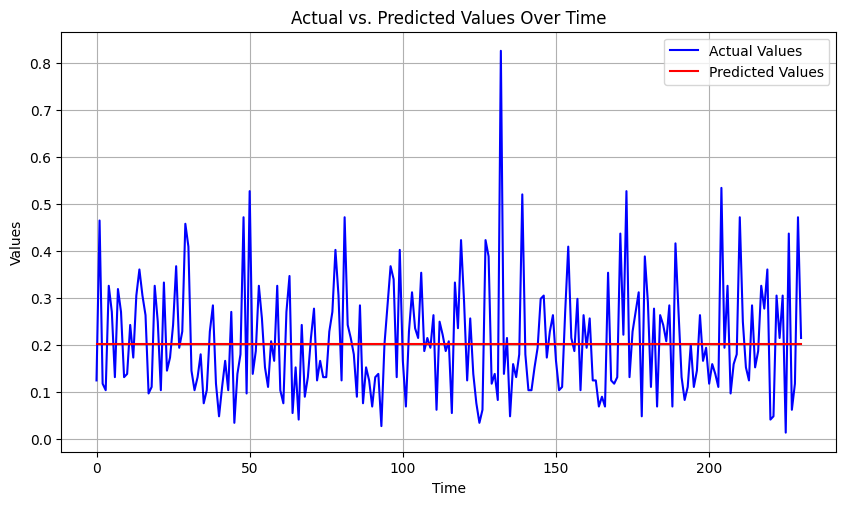

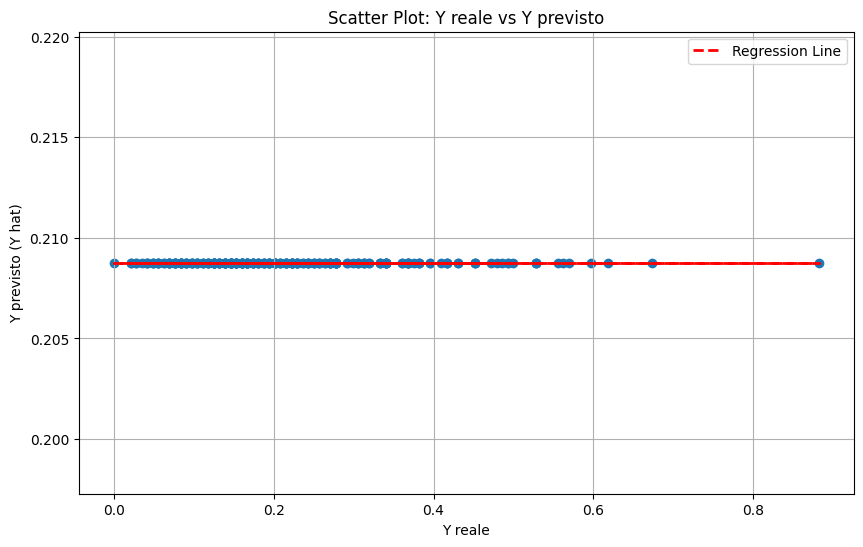

8/8 [==============================] - 0s 4ms/step

Model Completion: 129/144 (89.58%)
Saving data...
8/8 [==============================] - 0s 10ms/step
MAE (Iteration 20): 0.39
R-squared (R2) (Iteration 20): -7.35
RMSE (Iteration 20): 0.4


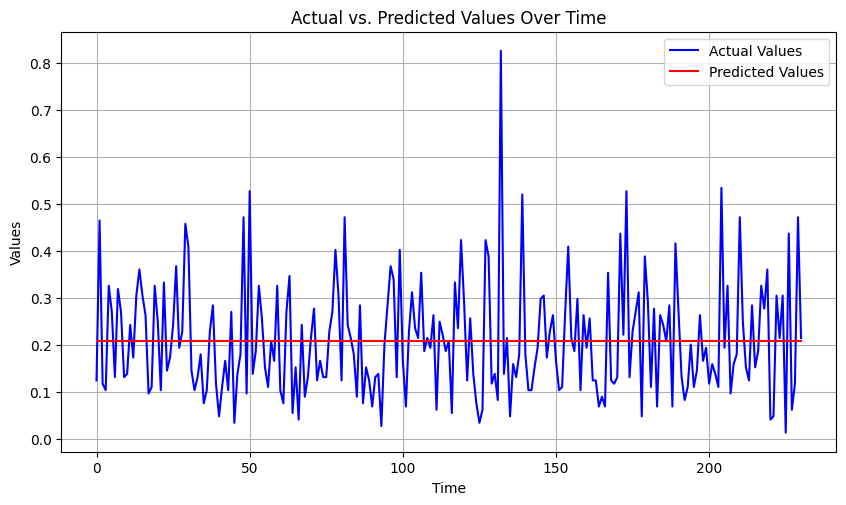

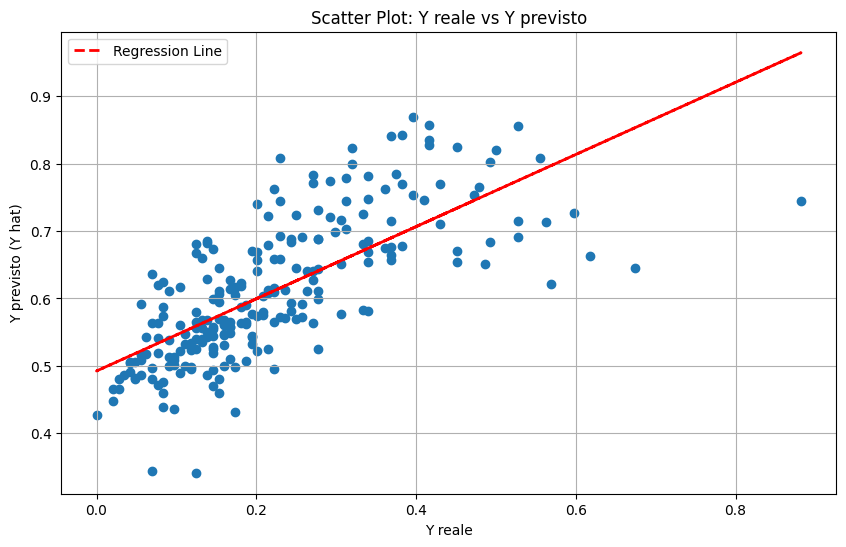

8/8 [==============================] - 0s 8ms/step

Model Completion: 130/144 (90.28%)
Saving data...
Number of Iterations: 30
8/8 [==============================] - 0s 5ms/step
MAE (Iteration 1): 0.1
R-squared (R2) (Iteration 1): -0.02
RMSE (Iteration 1): 0.14


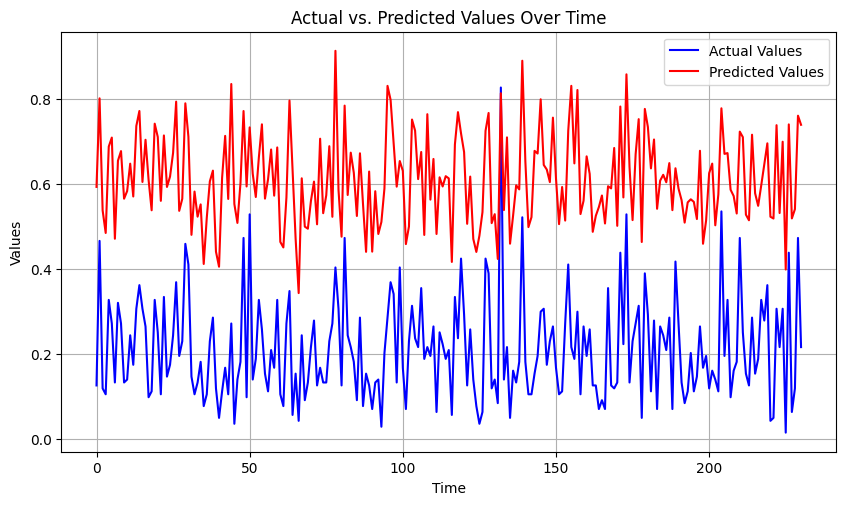

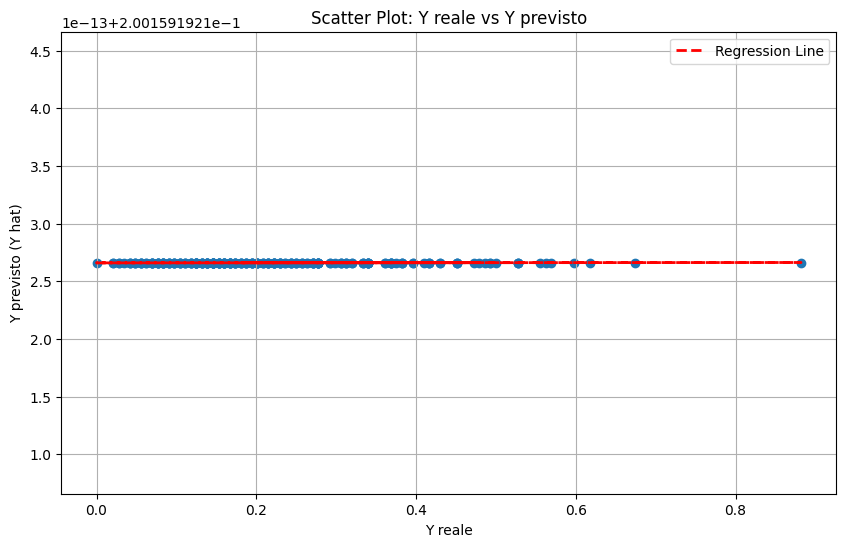

8/8 [==============================] - 0s 6ms/step

Model Completion: 131/144 (90.97%)
Saving data...
8/8 [==============================] - 0s 3ms/step
MAE (Iteration 2): 0.07
R-squared (R2) (Iteration 2): 0.52
RMSE (Iteration 2): 0.1


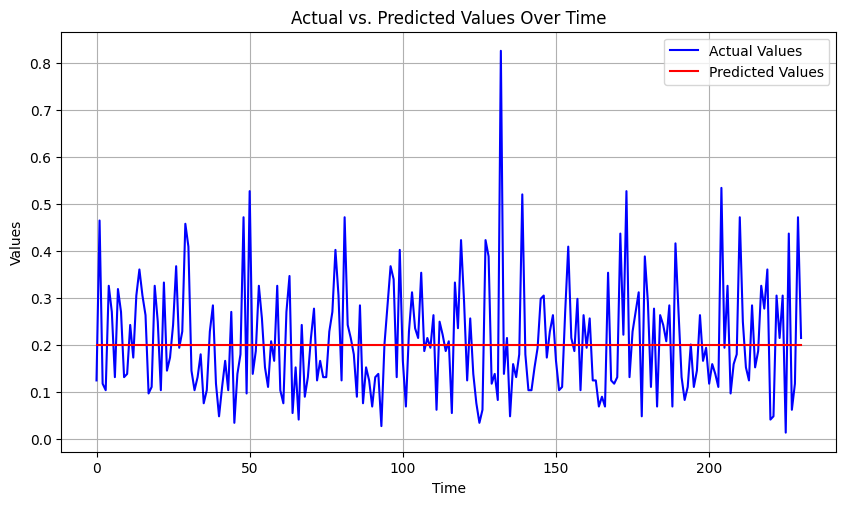

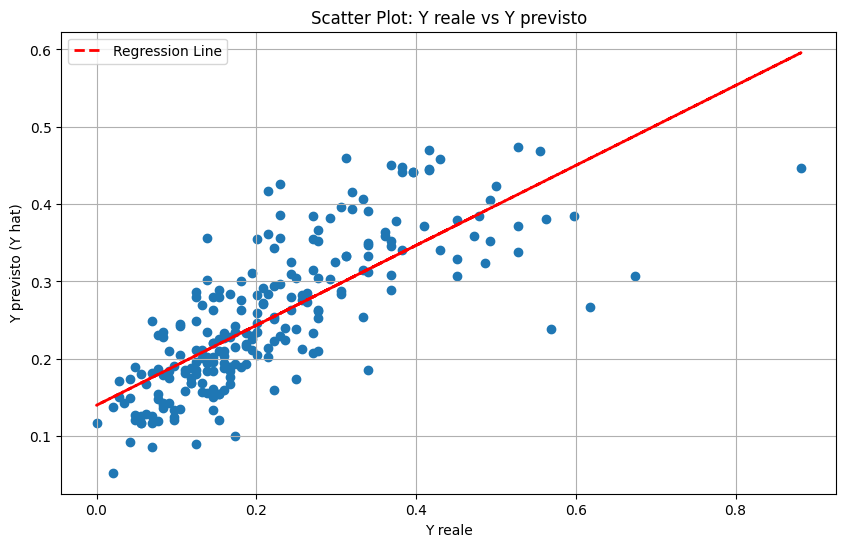

8/8 [==============================] - 0s 6ms/step

Model Completion: 132/144 (91.67%)
Saving data...
8/8 [==============================] - 0s 4ms/step
MAE (Iteration 3): 0.1
R-squared (R2) (Iteration 3): -0.02
RMSE (Iteration 3): 0.14


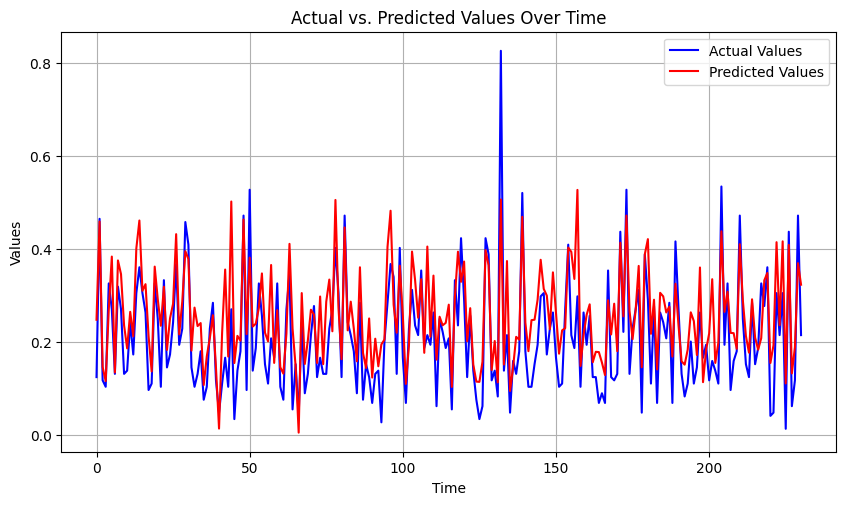

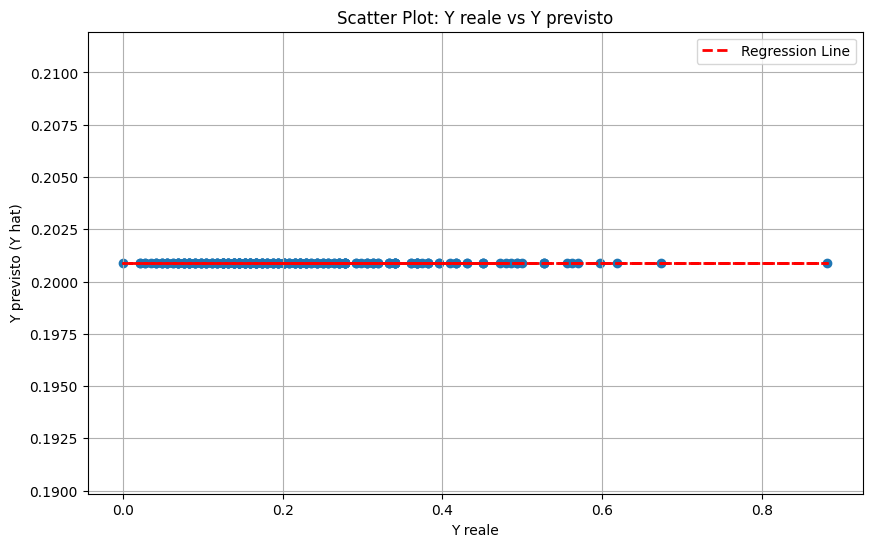

8/8 [==============================] - 0s 3ms/step

Model Completion: 133/144 (92.36%)
Saving data...
8/8 [==============================] - 0s 4ms/step
MAE (Iteration 4): 0.11
R-squared (R2) (Iteration 4): -0.0
RMSE (Iteration 4): 0.14


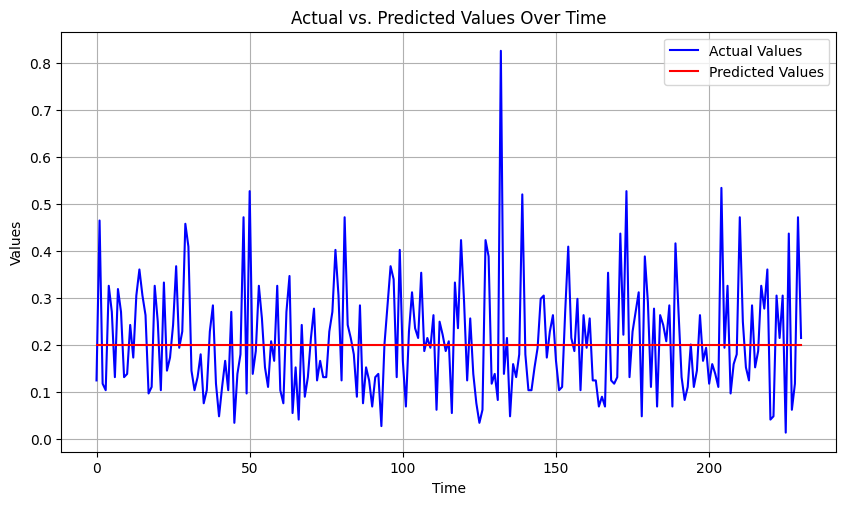

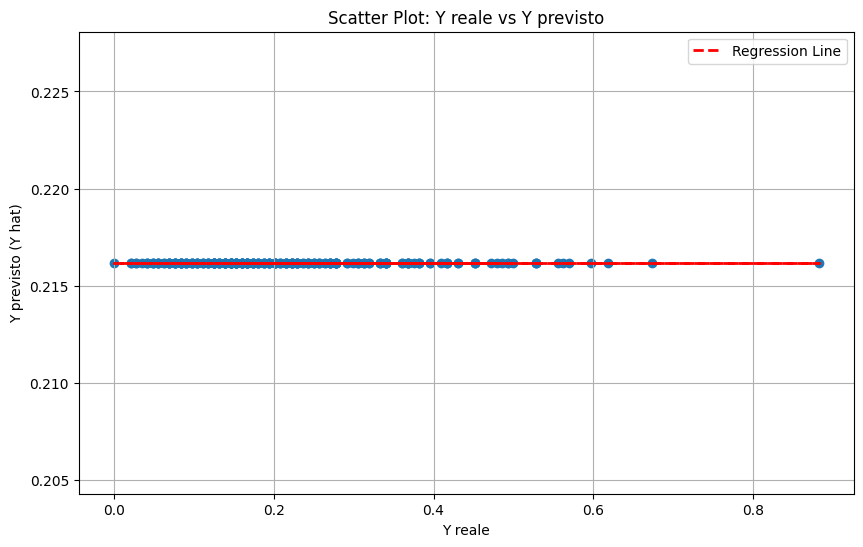

8/8 [==============================] - 0s 4ms/step

Model Completion: 134/144 (93.06%)
Saving data...
8/8 [==============================] - 0s 5ms/step
MAE (Iteration 5): 0.06
R-squared (R2) (Iteration 5): 0.58
RMSE (Iteration 5): 0.09


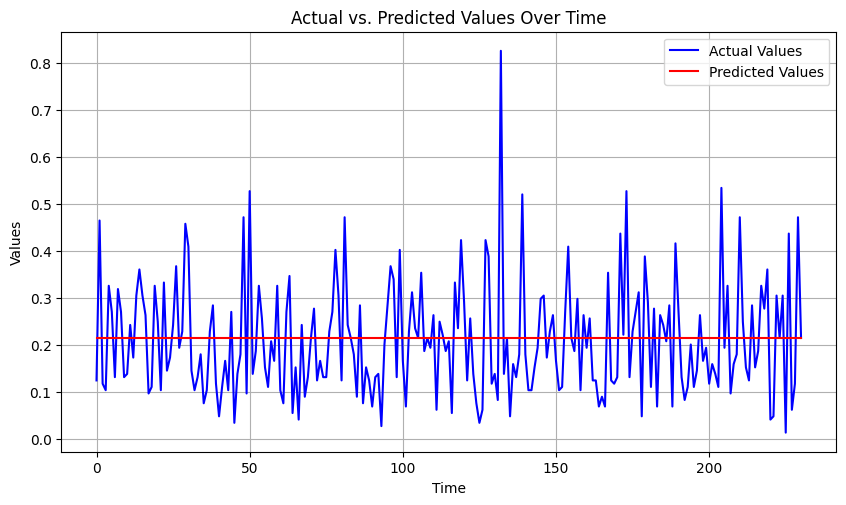

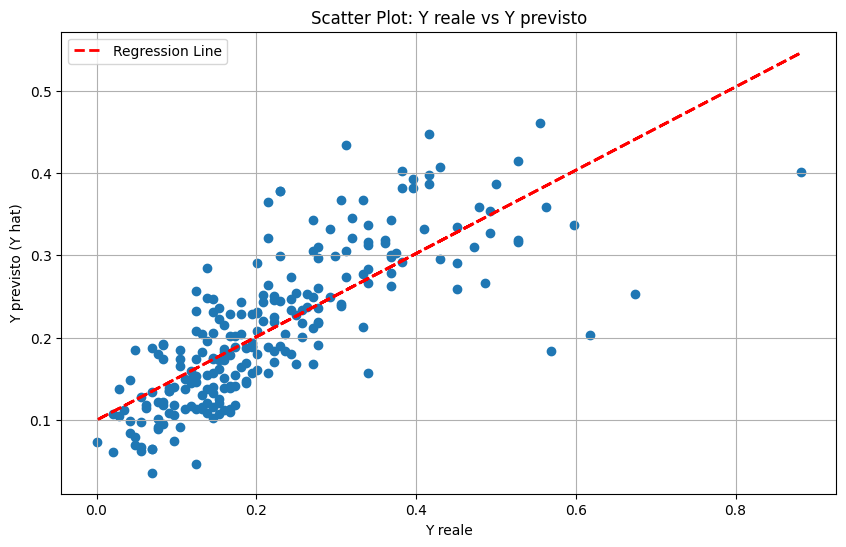

8/8 [==============================] - 0s 4ms/step

Model Completion: 135/144 (93.75%)
Saving data...
8/8 [==============================] - 0s 4ms/step
MAE (Iteration 6): 0.08
R-squared (R2) (Iteration 6): 0.3
RMSE (Iteration 6): 0.12


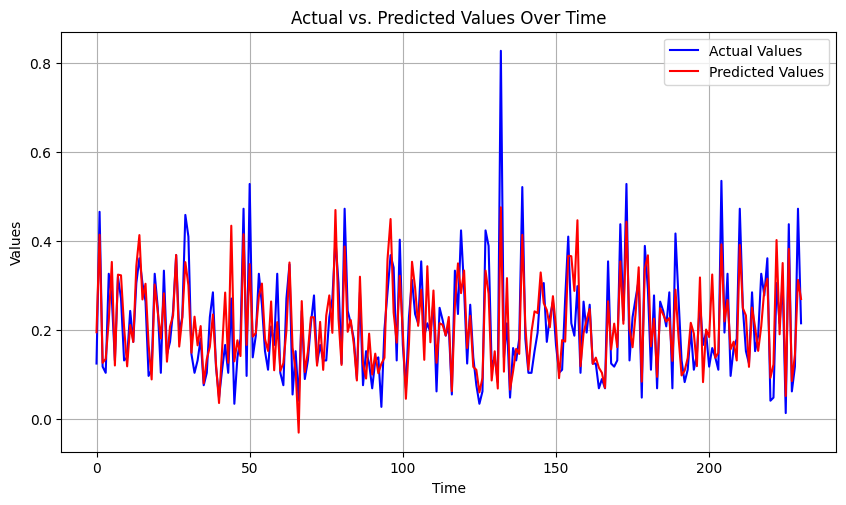

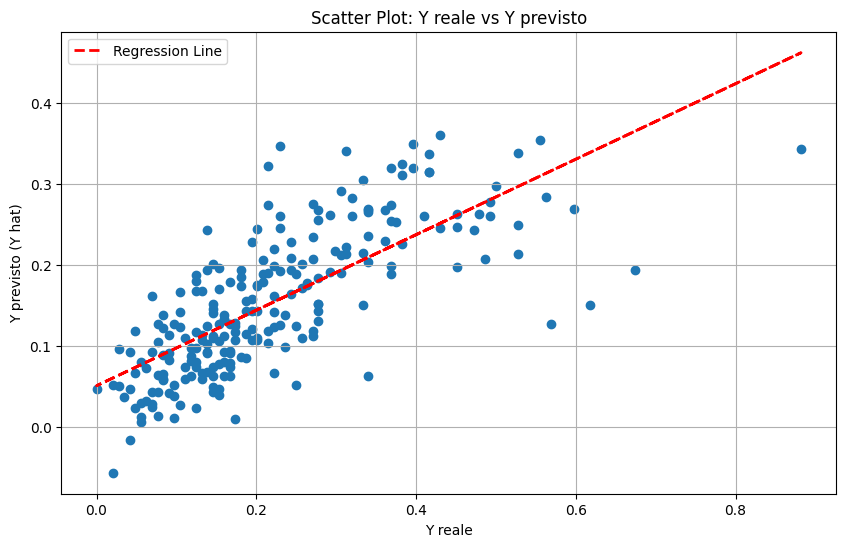

8/8 [==============================] - 0s 4ms/step

Model Completion: 136/144 (94.44%)
Saving data...
8/8 [==============================] - 0s 4ms/step
MAE (Iteration 7): 0.11
R-squared (R2) (Iteration 7): -0.0
RMSE (Iteration 7): 0.14


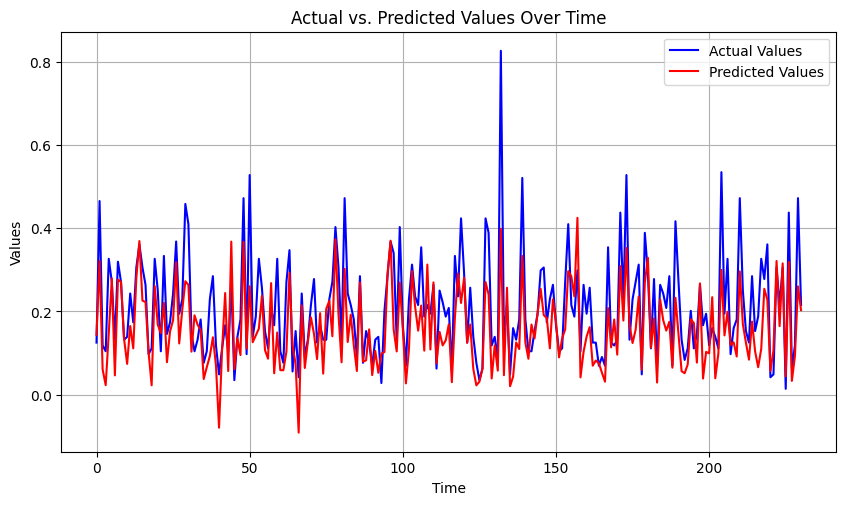

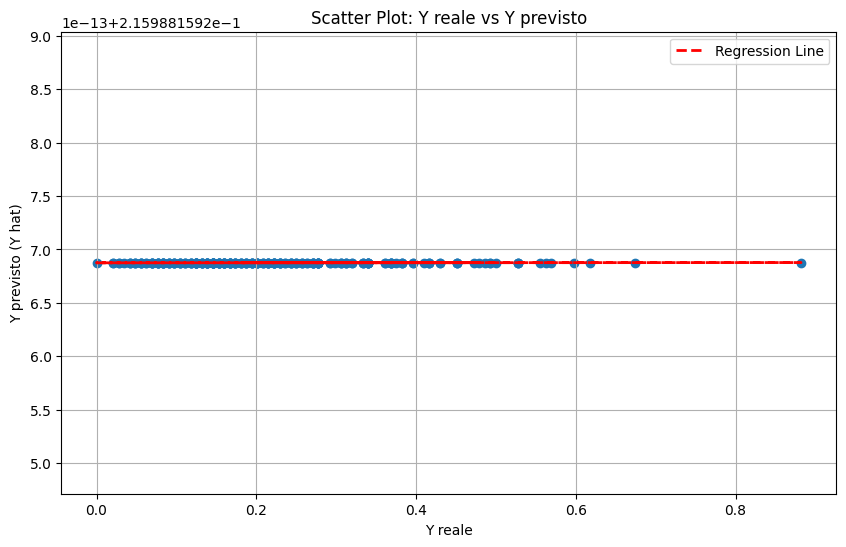

8/8 [==============================] - 0s 6ms/step

Model Completion: 137/144 (95.14%)
Saving data...
8/8 [==============================] - 0s 8ms/step
MAE (Iteration 8): 0.18
R-squared (R2) (Iteration 8): -0.9
RMSE (Iteration 8): 0.19


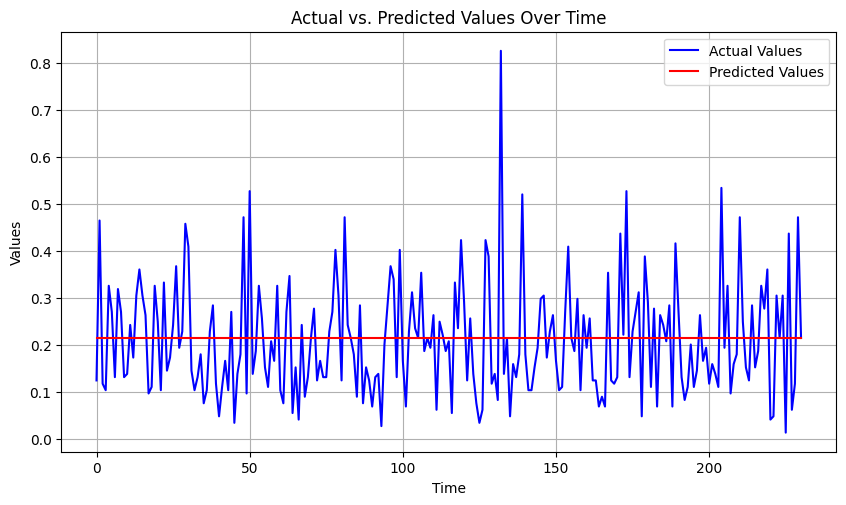

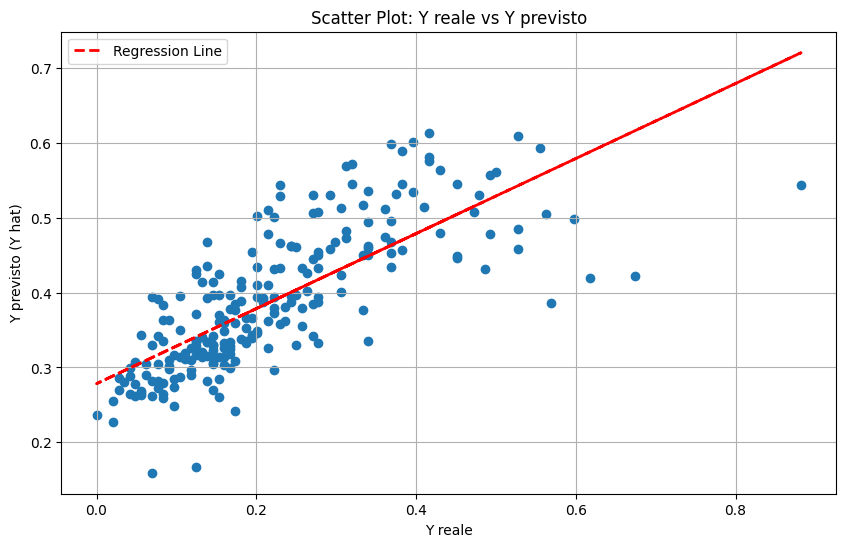

8/8 [==============================] - 0s 12ms/step

Model Completion: 138/144 (95.83%)
Saving data...
8/8 [==============================] - 0s 8ms/step
MAE (Iteration 9): 0.1
R-squared (R2) (Iteration 9): -0.02
RMSE (Iteration 9): 0.14


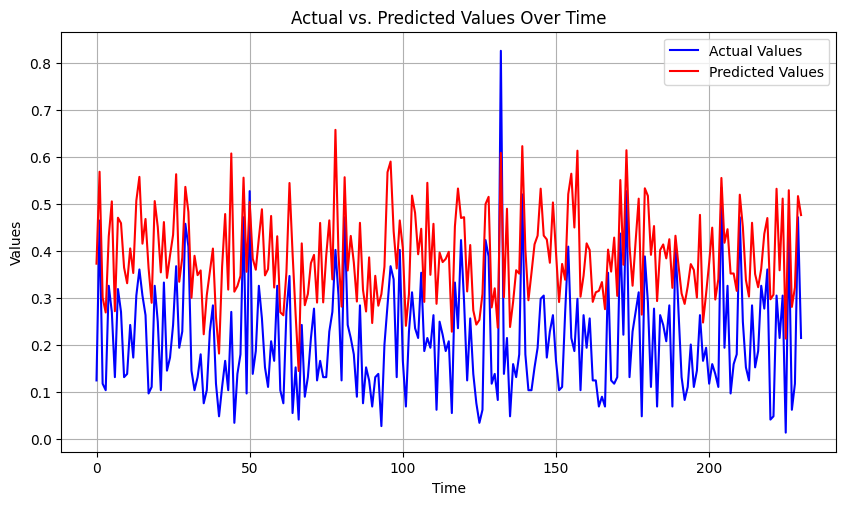

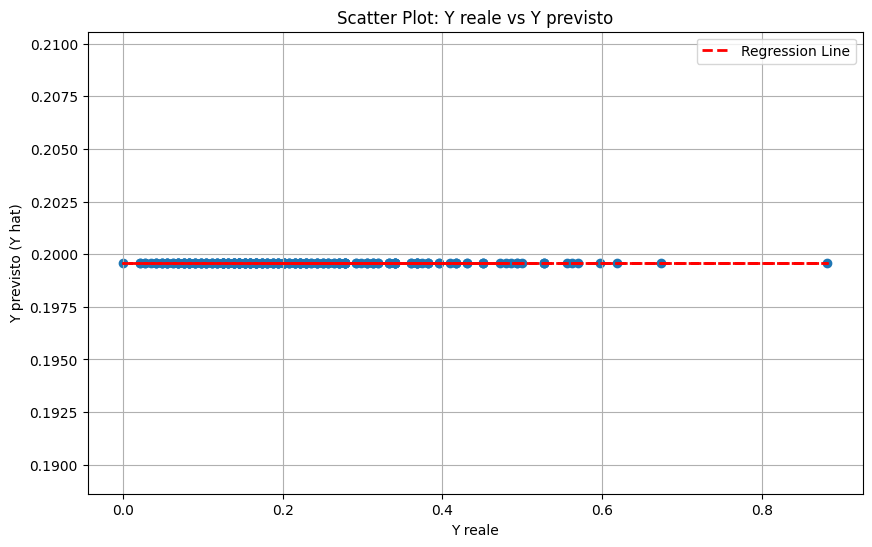

8/8 [==============================] - 0s 11ms/step

Model Completion: 139/144 (96.53%)
Saving data...
8/8 [==============================] - 0s 4ms/step
MAE (Iteration 10): 0.08
R-squared (R2) (Iteration 10): 0.44
RMSE (Iteration 10): 0.1


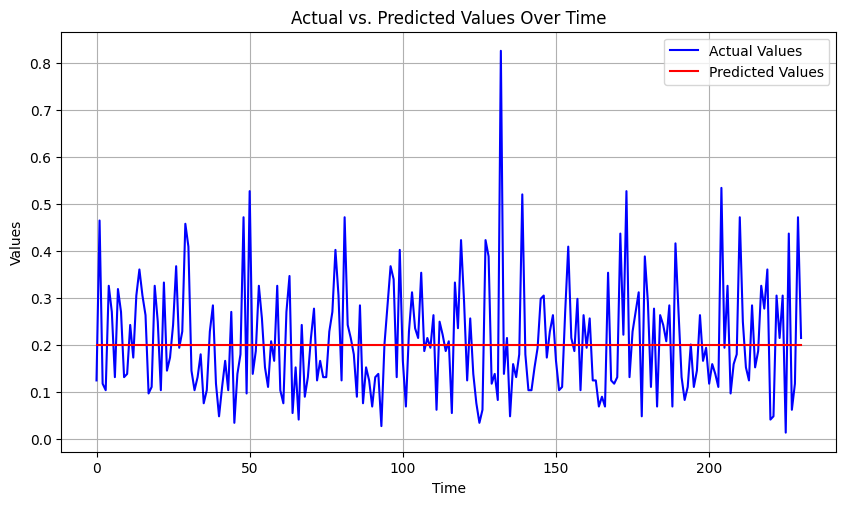

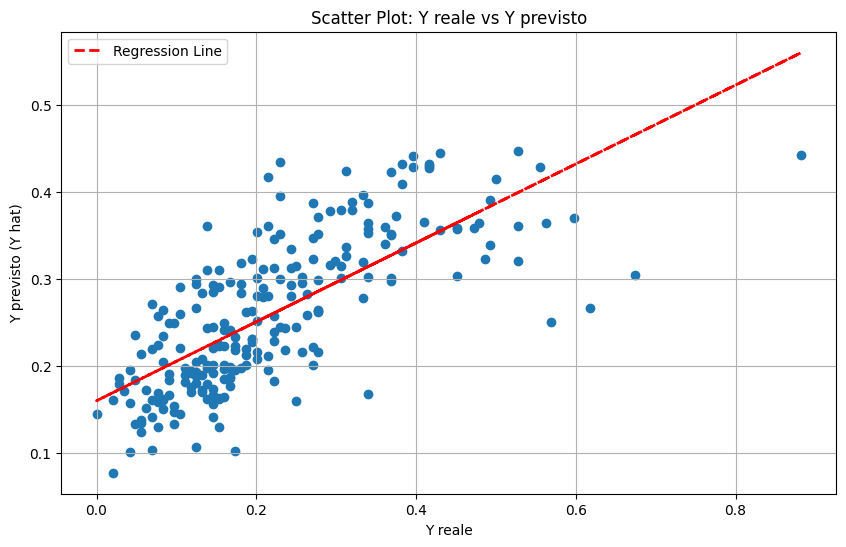

8/8 [==============================] - 0s 5ms/step

Model Completion: 140/144 (97.22%)
Saving data...
8/8 [==============================] - 0s 5ms/step
MAE (Iteration 11): 0.11
R-squared (R2) (Iteration 11): -0.01
RMSE (Iteration 11): 0.14


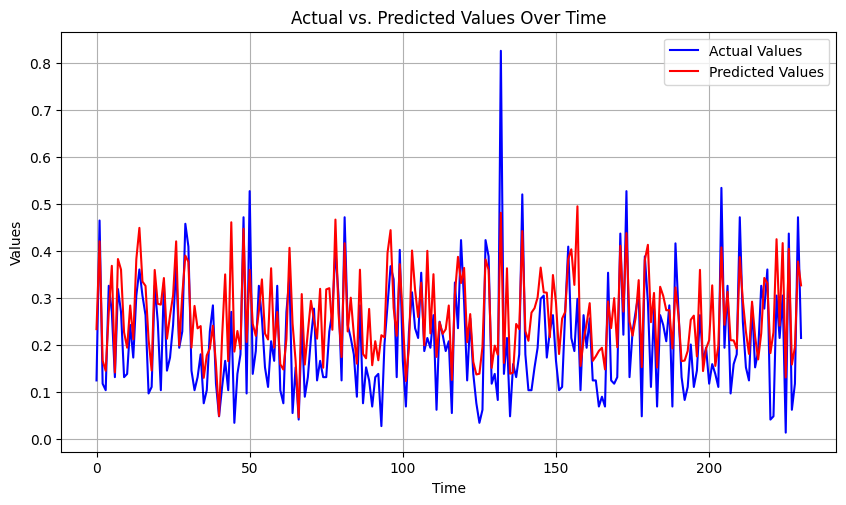

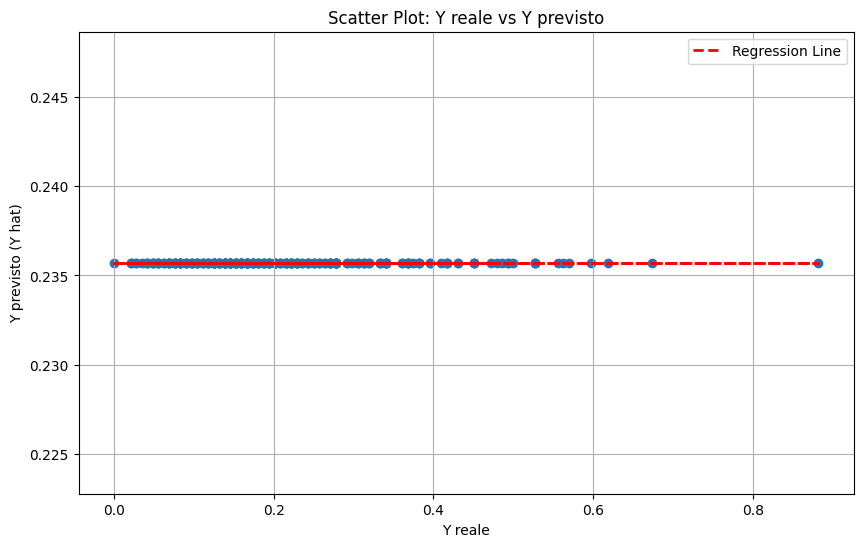

8/8 [==============================] - 0s 6ms/step

Model Completion: 141/144 (97.92%)
Saving data...
8/8 [==============================] - 0s 9ms/step
MAE (Iteration 12): 0.06
R-squared (R2) (Iteration 12): 0.56
RMSE (Iteration 12): 0.09


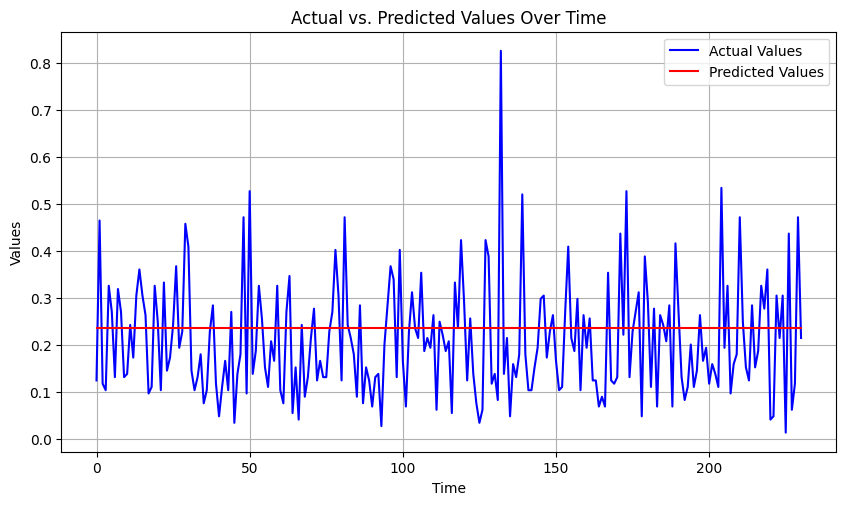

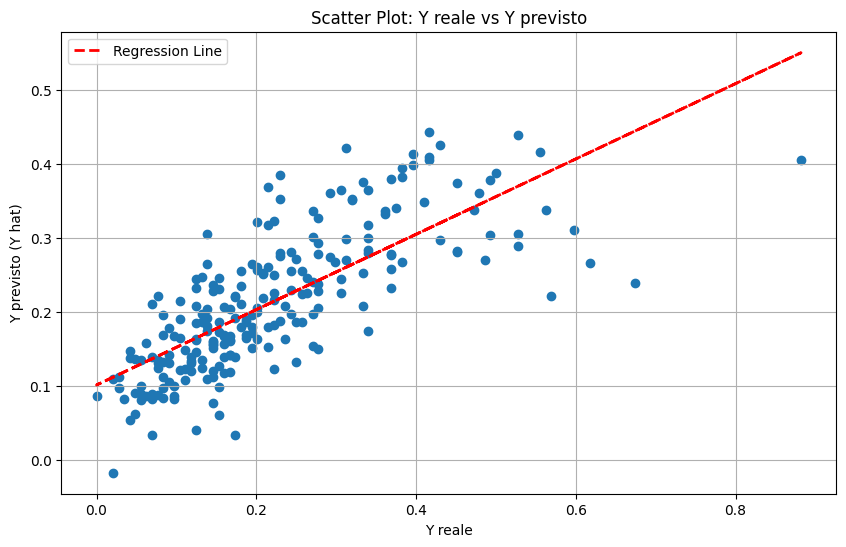

8/8 [==============================] - 0s 6ms/step

Model Completion: 142/144 (98.61%)
Saving data...
8/8 [==============================] - 0s 3ms/step
MAE (Iteration 13): 0.09
R-squared (R2) (Iteration 13): 0.21
RMSE (Iteration 13): 0.12


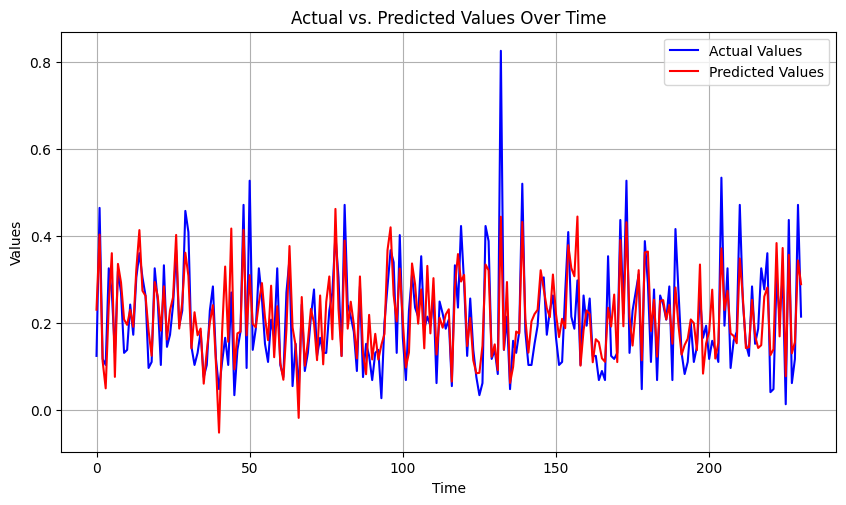

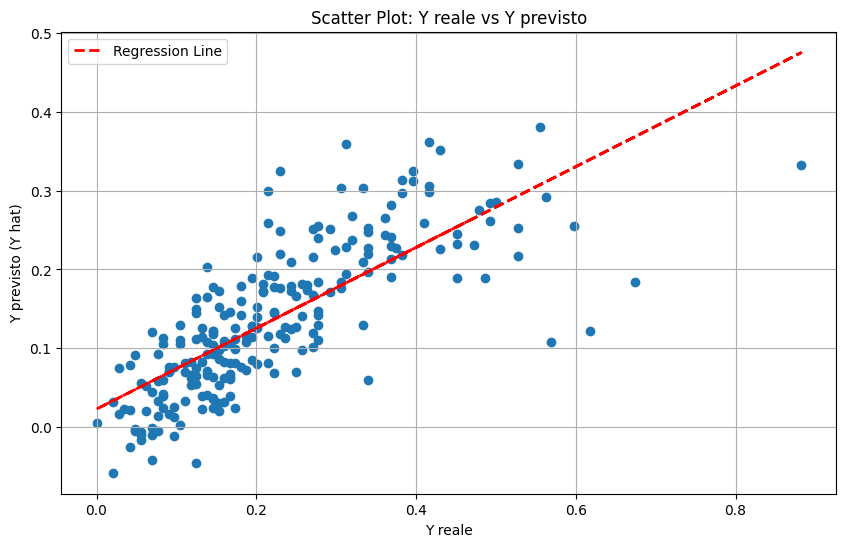

8/8 [==============================] - 0s 5ms/step

Model Completion: 143/144 (99.31%)
Saving data...
8/8 [==============================] - 0s 8ms/step
MAE (Iteration 14): 0.08
R-squared (R2) (Iteration 14): 0.46
RMSE (Iteration 14): 0.1


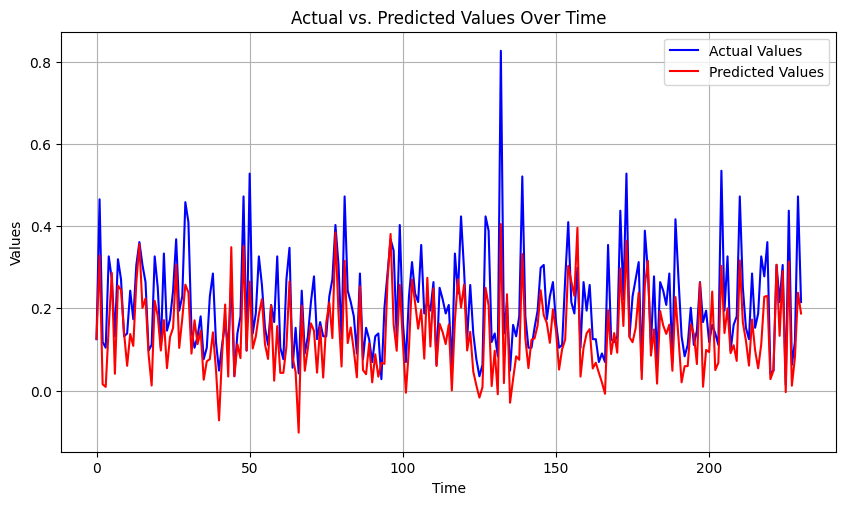

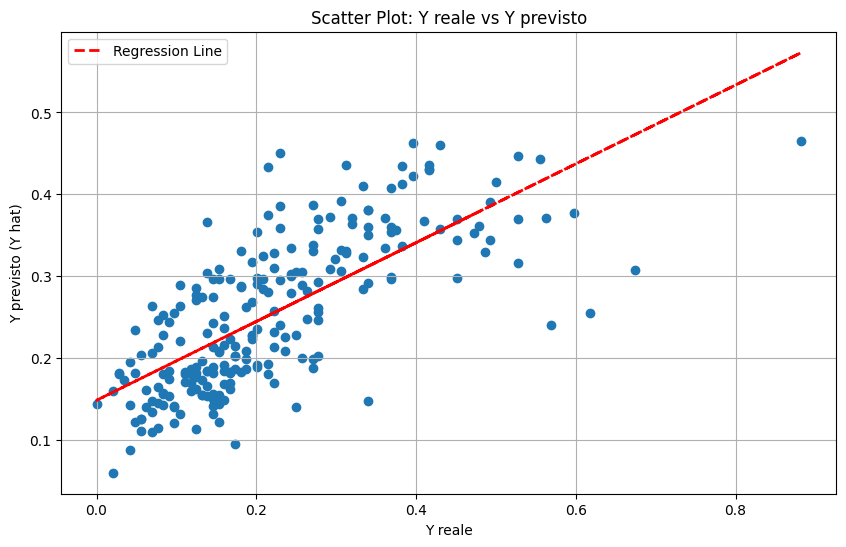

8/8 [==============================] - 0s 9ms/step

Model Completion: 144/144 (100.00%)
Saving data...
8/8 [==============================] - 0s 4ms/step
MAE (Iteration 15): 0.1
R-squared (R2) (Iteration 15): -0.02
RMSE (Iteration 15): 0.14


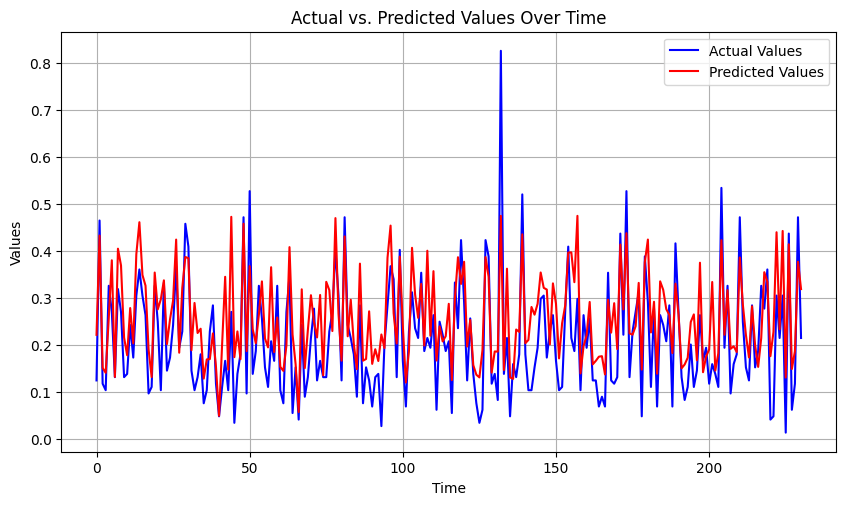

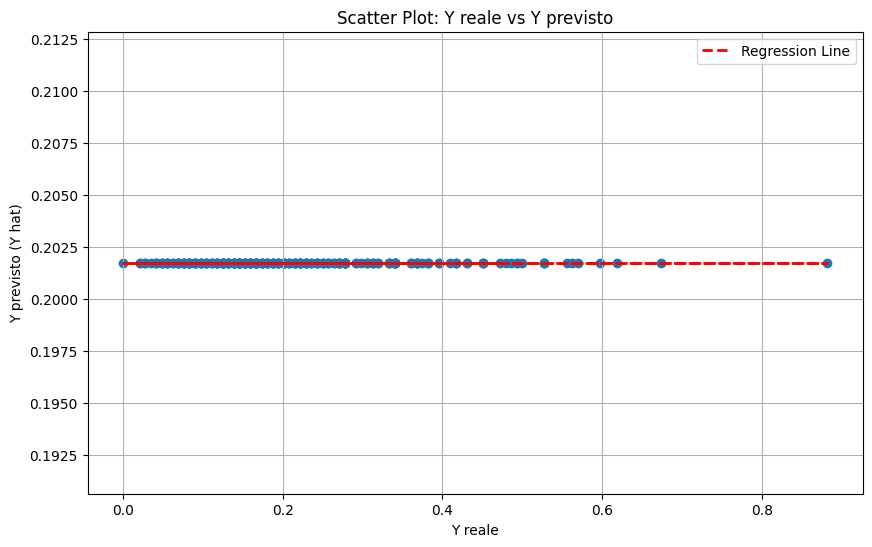

8/8 [==============================] - 0s 4ms/step

Model Completion: 145/144 (100.69%)
Saving data...
8/8 [==============================] - 0s 5ms/step
MAE (Iteration 16): 0.1
R-squared (R2) (Iteration 16): -0.02
RMSE (Iteration 16): 0.14


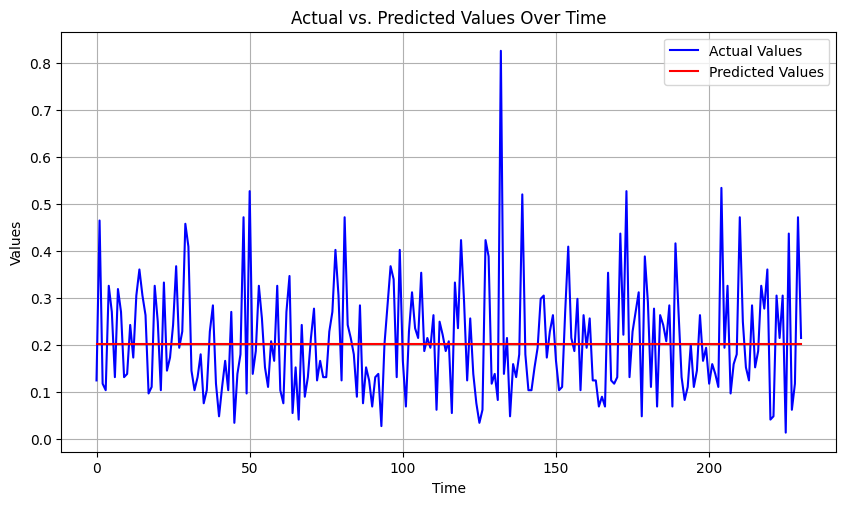

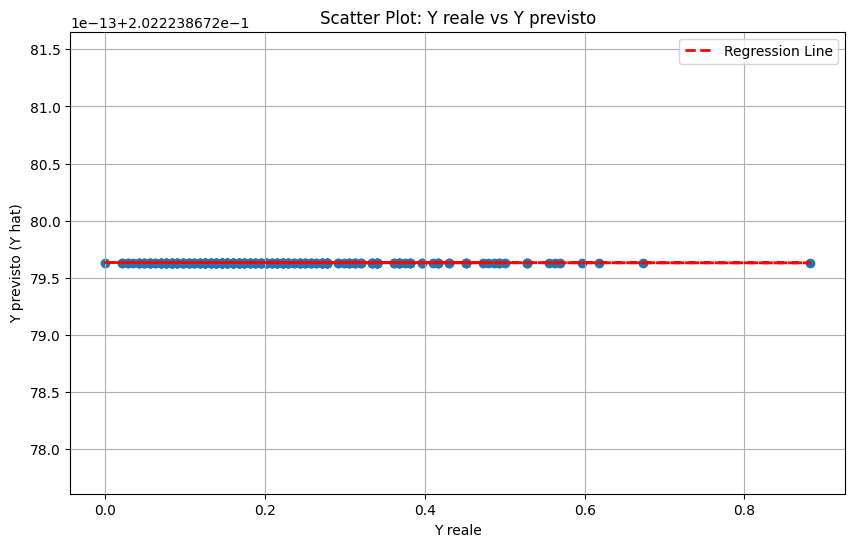

8/8 [==============================] - 0s 6ms/step

Model Completion: 146/144 (101.39%)
Saving data...
8/8 [==============================] - 0s 5ms/step
MAE (Iteration 17): 0.11
R-squared (R2) (Iteration 17): -0.01
RMSE (Iteration 17): 0.14


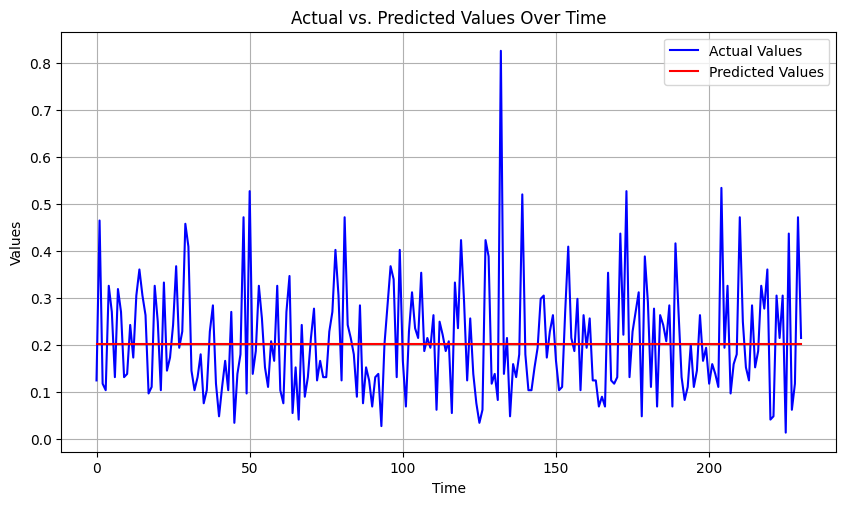

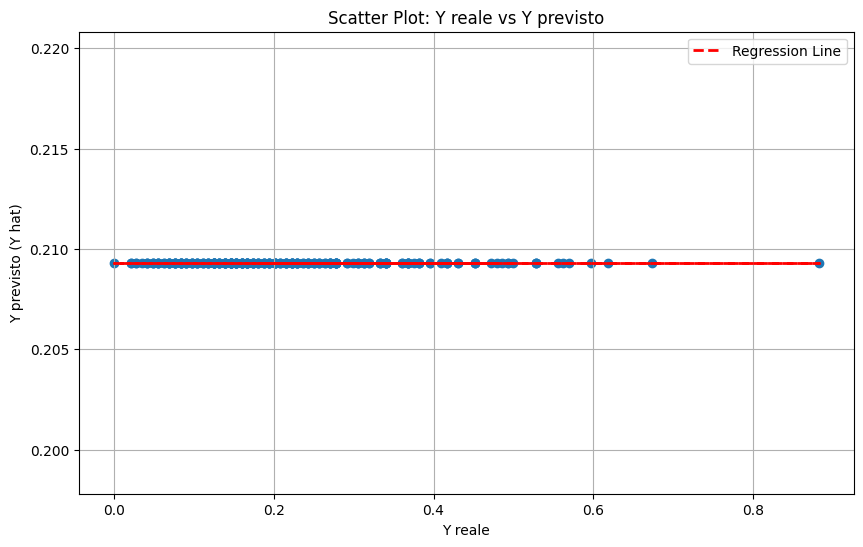

8/8 [==============================] - 0s 6ms/step

Model Completion: 147/144 (102.08%)
Saving data...
8/8 [==============================] - 0s 4ms/step
MAE (Iteration 18): 0.07
R-squared (R2) (Iteration 18): 0.56
RMSE (Iteration 18): 0.09


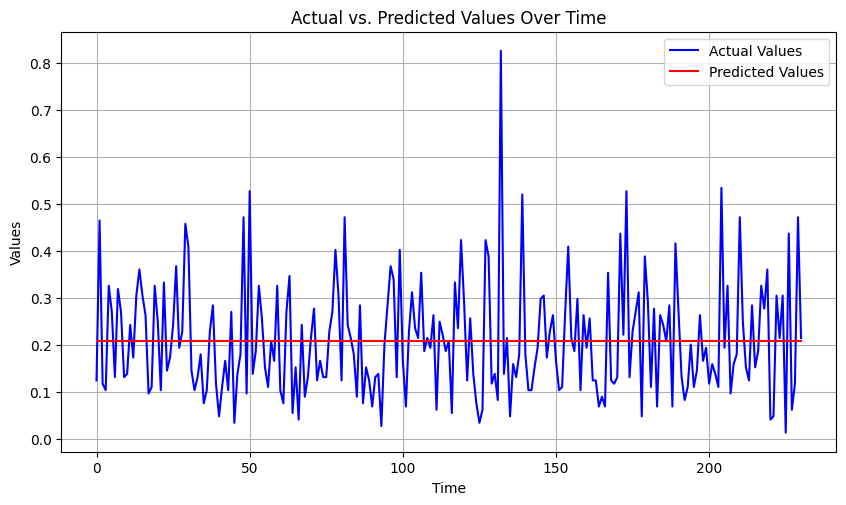

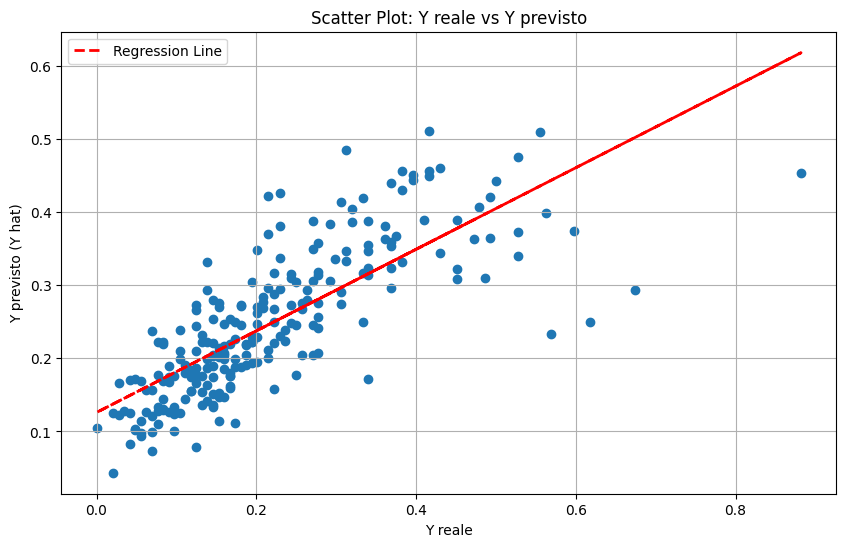

8/8 [==============================] - 0s 4ms/step

Model Completion: 148/144 (102.78%)
Saving data...
8/8 [==============================] - 0s 10ms/step
MAE (Iteration 19): 0.1
R-squared (R2) (Iteration 19): 0.25
RMSE (Iteration 19): 0.12


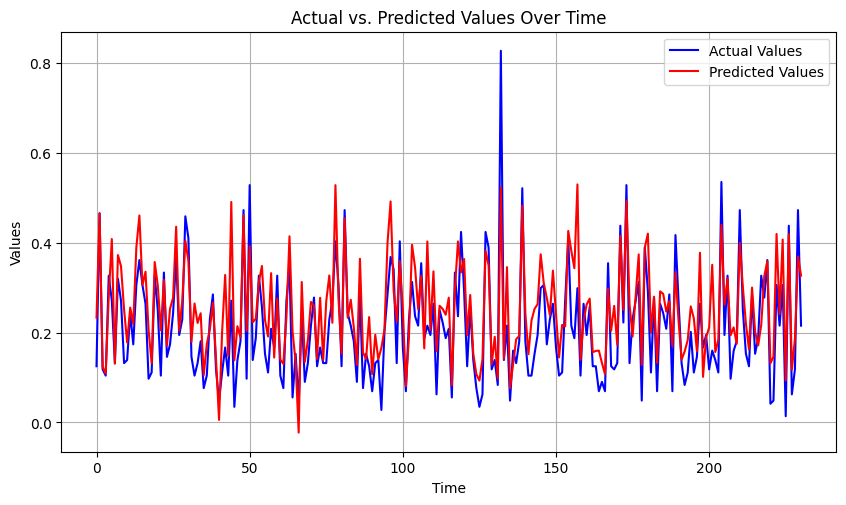

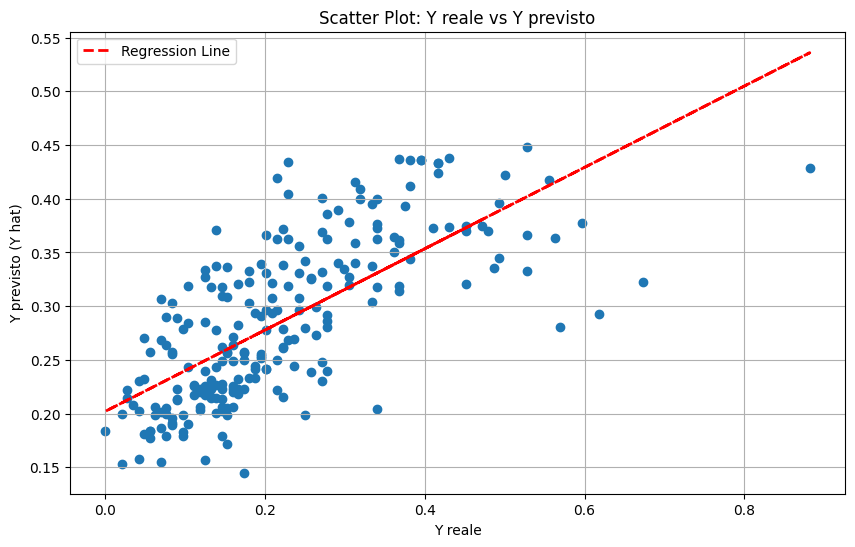

8/8 [==============================] - 0s 5ms/step

Model Completion: 149/144 (103.47%)
Saving data...
8/8 [==============================] - 0s 3ms/step
MAE (Iteration 20): 0.11
R-squared (R2) (Iteration 20): -0.01
RMSE (Iteration 20): 0.14


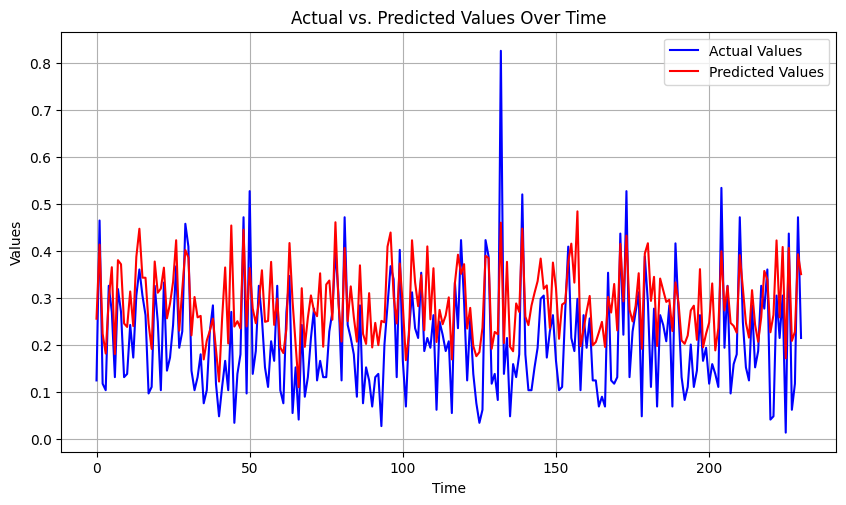

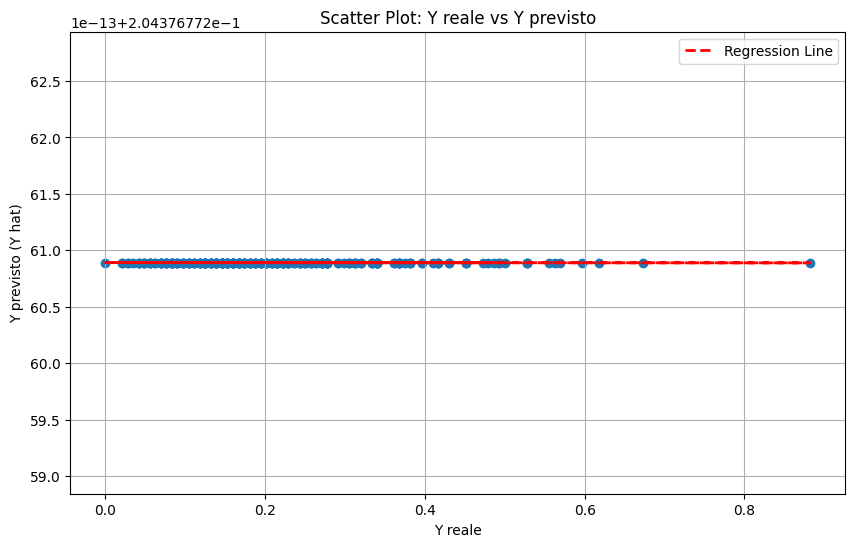

8/8 [==============================] - 0s 6ms/step

Model Completion: 150/144 (104.17%)
Saving data...
8/8 [==============================] - 0s 6ms/step
MAE (Iteration 21): 0.1
R-squared (R2) (Iteration 21): -0.02
RMSE (Iteration 21): 0.14


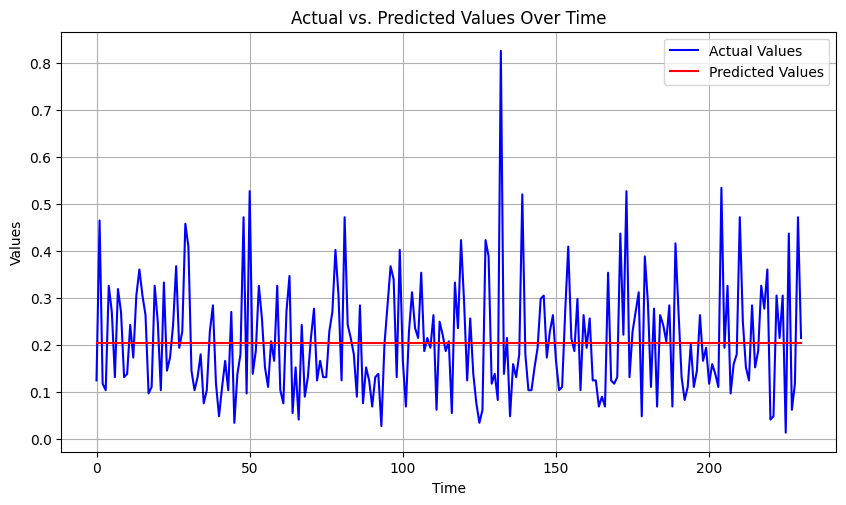

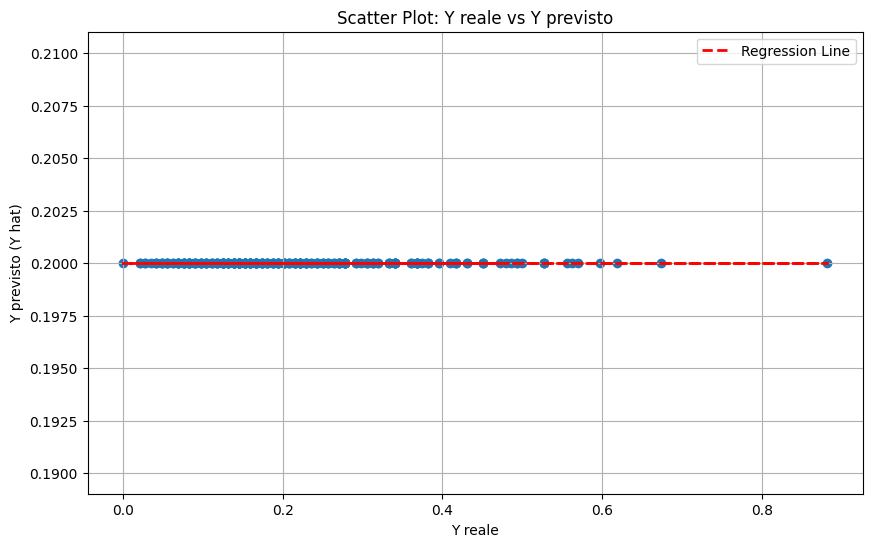

8/8 [==============================] - 0s 6ms/step

Model Completion: 151/144 (104.86%)
Saving data...
8/8 [==============================] - 0s 4ms/step
MAE (Iteration 22): 0.11
R-squared (R2) (Iteration 22): -0.0
RMSE (Iteration 22): 0.14


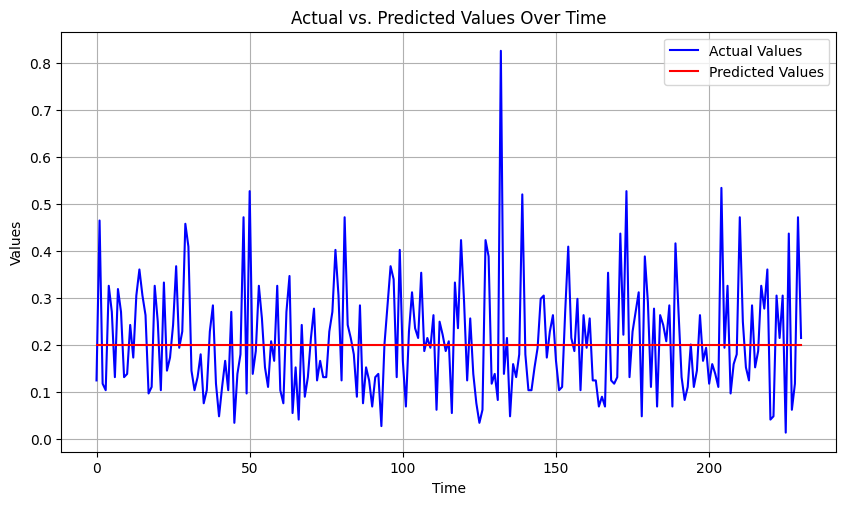

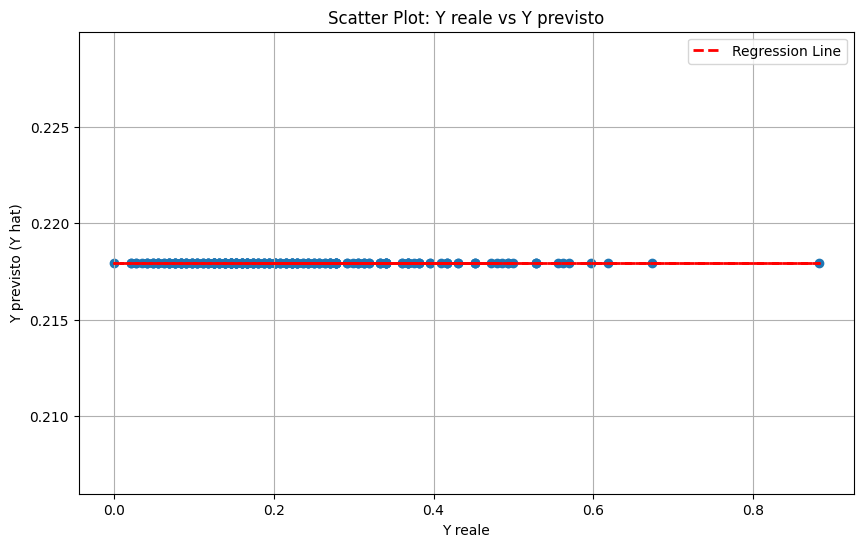

8/8 [==============================] - 0s 4ms/step

Model Completion: 152/144 (105.56%)
Saving data...
8/8 [==============================] - 0s 6ms/step
MAE (Iteration 23): 0.11
R-squared (R2) (Iteration 23): -0.01
RMSE (Iteration 23): 0.14


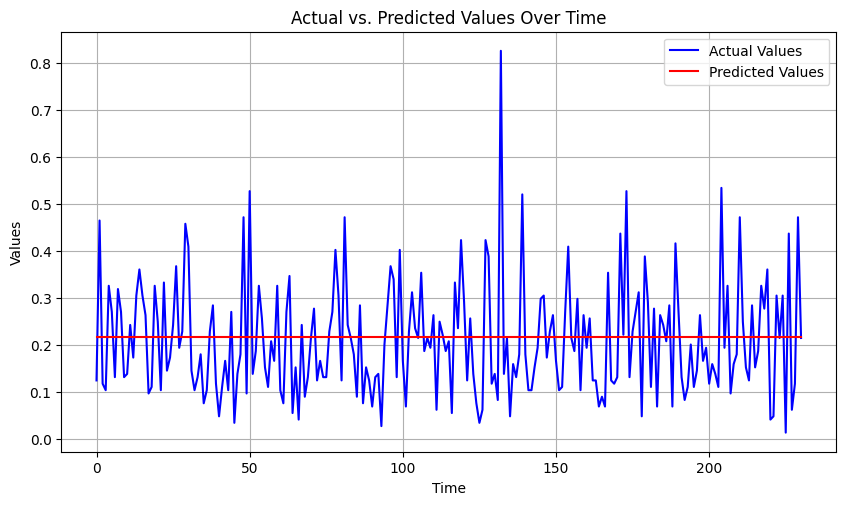

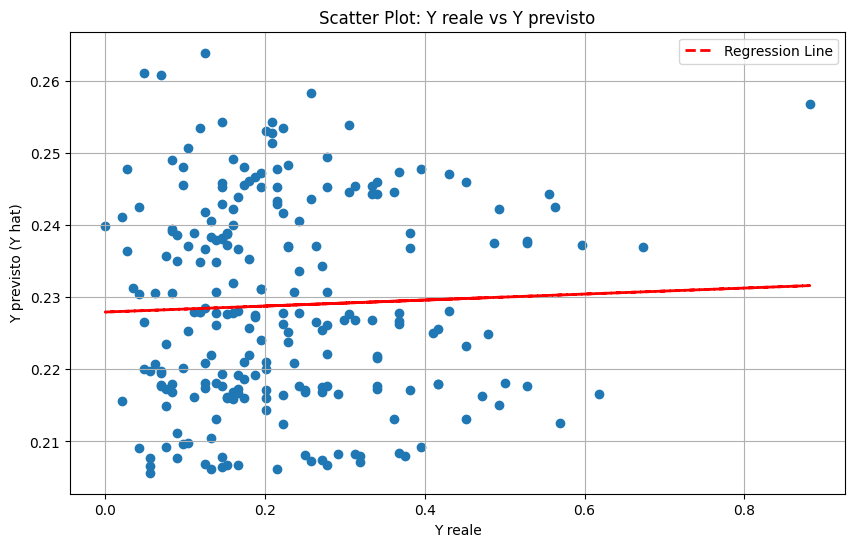

8/8 [==============================] - 0s 5ms/step

Model Completion: 153/144 (106.25%)
Saving data...
8/8 [==============================] - 0s 6ms/step
MAE (Iteration 24): 0.12
R-squared (R2) (Iteration 24): -0.1
RMSE (Iteration 24): 0.15


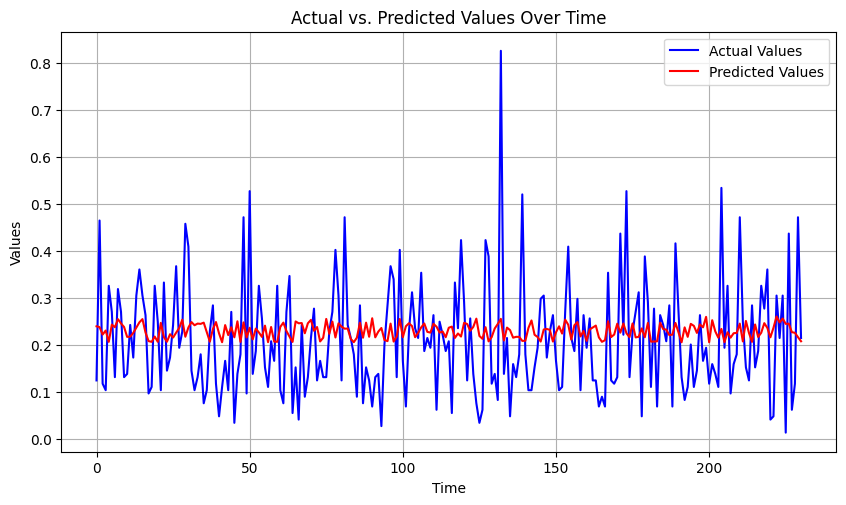

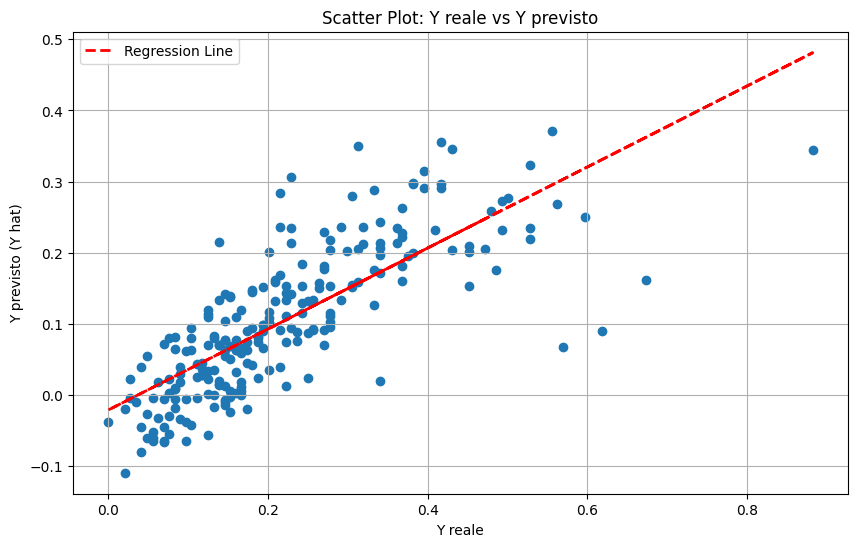

8/8 [==============================] - 0s 5ms/step

Model Completion: 154/144 (106.94%)
Saving data...
8/8 [==============================] - 0s 5ms/step
MAE (Iteration 25): 0.08
R-squared (R2) (Iteration 25): 0.46
RMSE (Iteration 25): 0.1


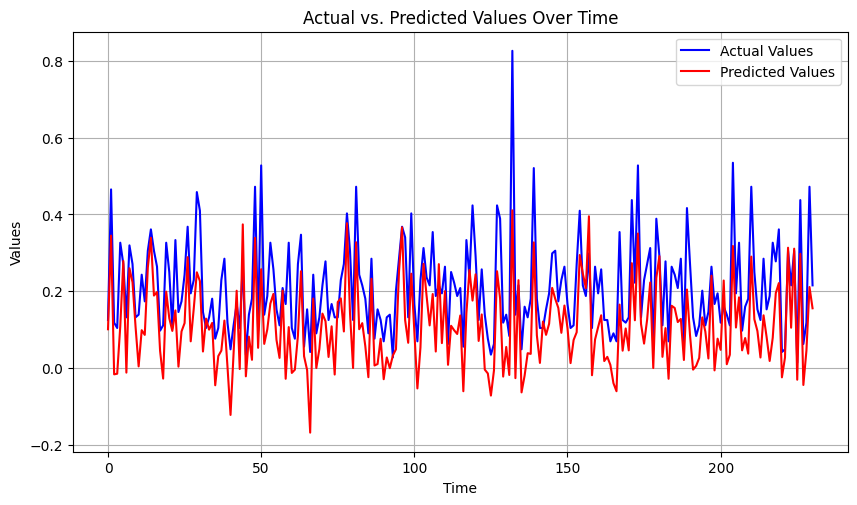

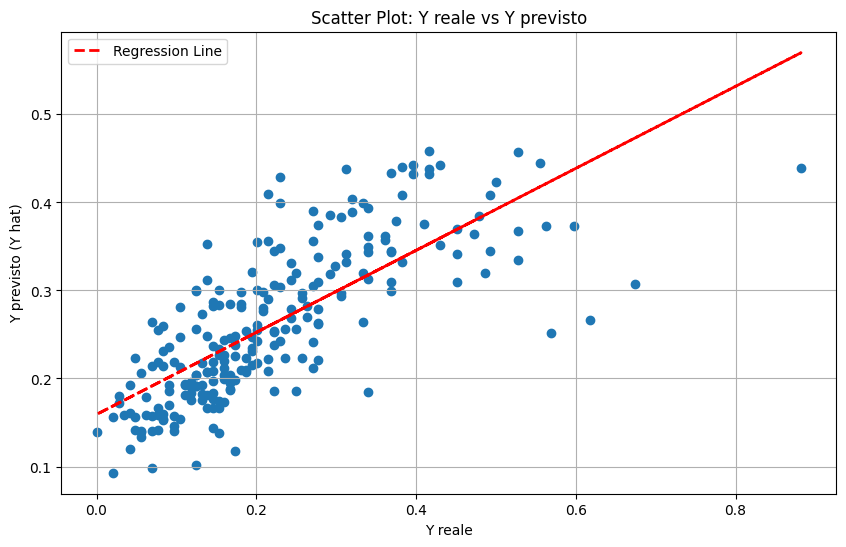

8/8 [==============================] - 0s 5ms/step

Model Completion: 155/144 (107.64%)
Saving data...
8/8 [==============================] - 0s 8ms/step
MAE (Iteration 26): 0.11
R-squared (R2) (Iteration 26): -0.02
RMSE (Iteration 26): 0.14


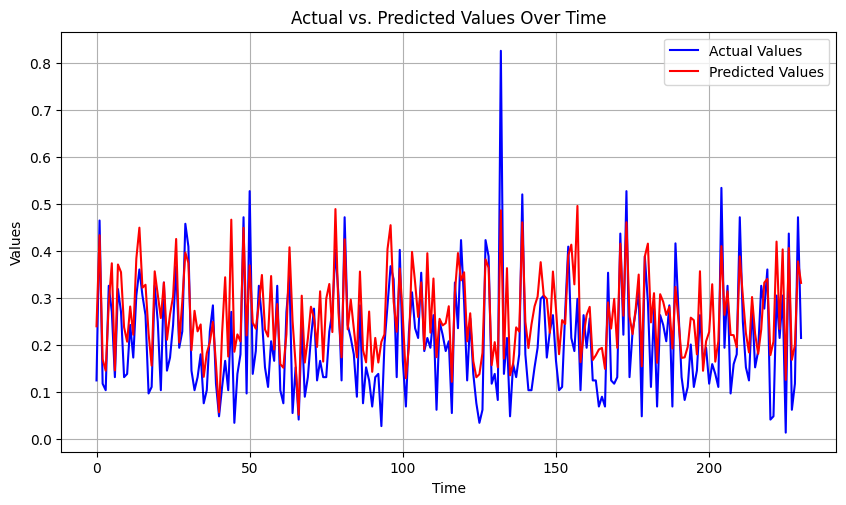

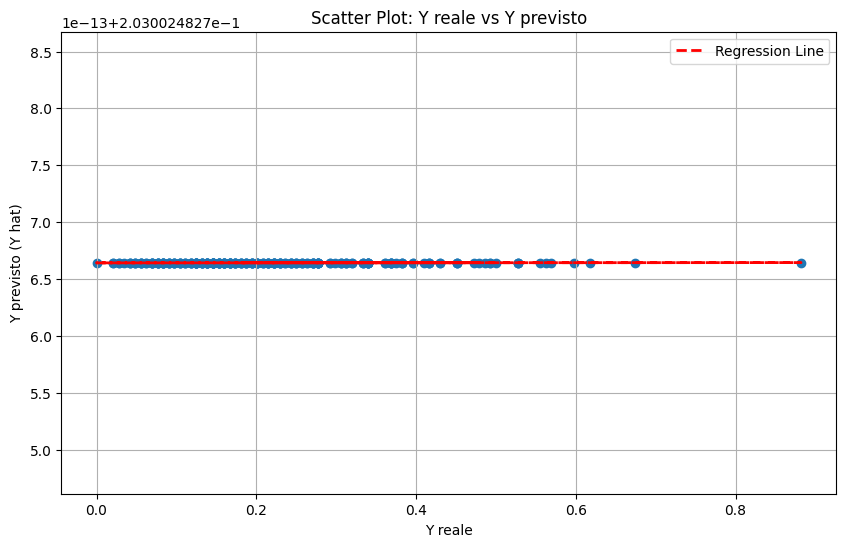

8/8 [==============================] - 0s 4ms/step

Model Completion: 156/144 (108.33%)
Saving data...
8/8 [==============================] - 0s 6ms/step
MAE (Iteration 27): 0.11
R-squared (R2) (Iteration 27): -0.01
RMSE (Iteration 27): 0.14


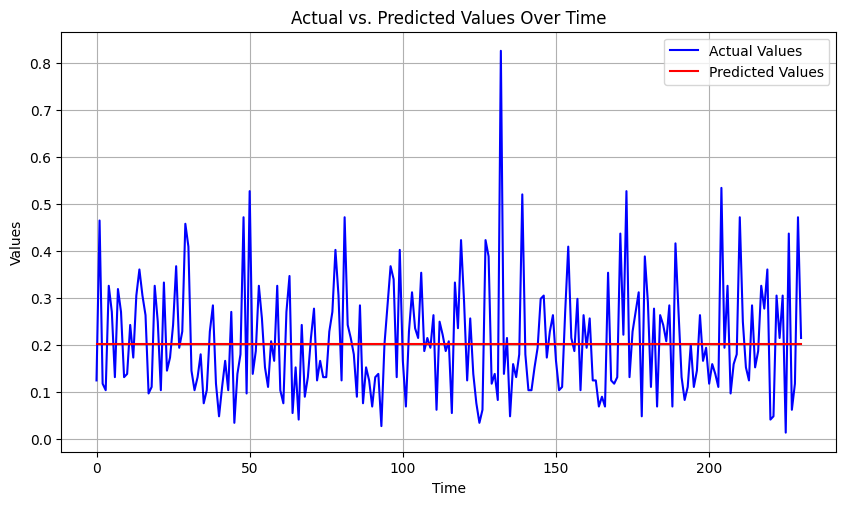

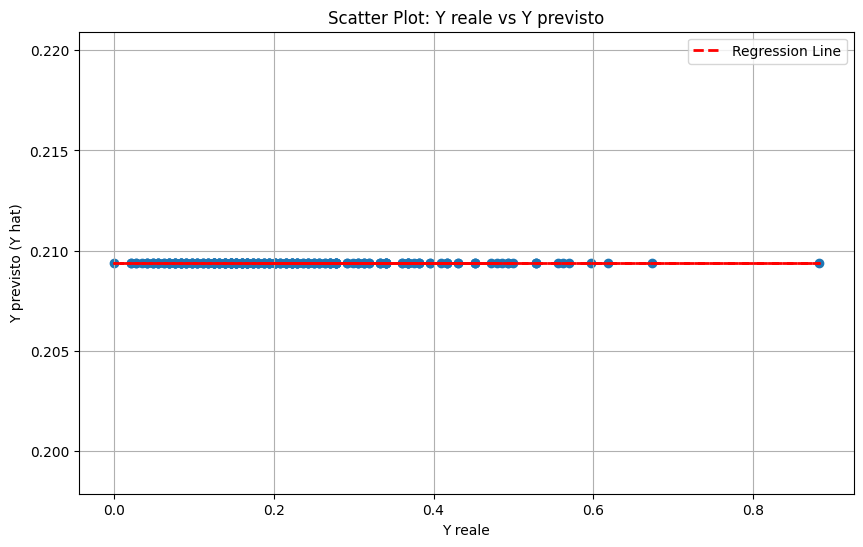

8/8 [==============================] - 0s 5ms/step

Model Completion: 157/144 (109.03%)
Saving data...
8/8 [==============================] - 0s 4ms/step
MAE (Iteration 28): 0.11
R-squared (R2) (Iteration 28): -0.0
RMSE (Iteration 28): 0.14


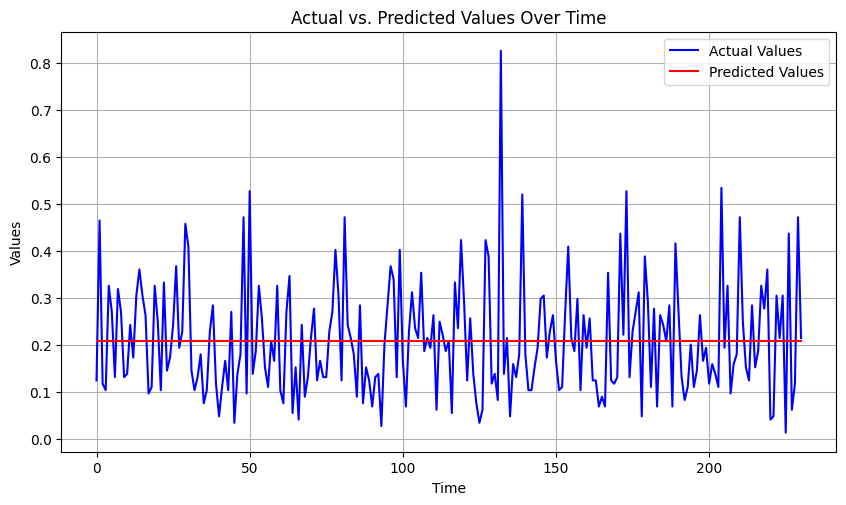

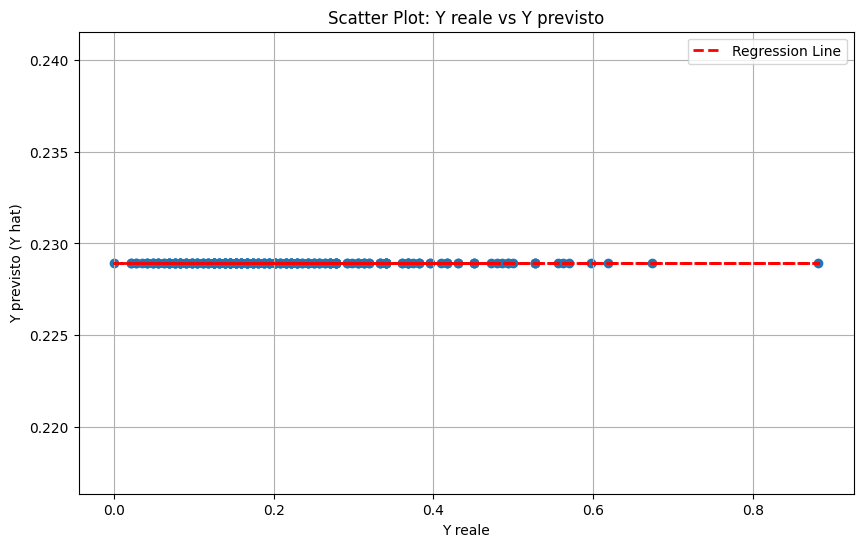

8/8 [==============================] - 0s 4ms/step

Model Completion: 158/144 (109.72%)
Saving data...
8/8 [==============================] - 0s 4ms/step
MAE (Iteration 29): 0.11
R-squared (R2) (Iteration 29): -0.01
RMSE (Iteration 29): 0.14


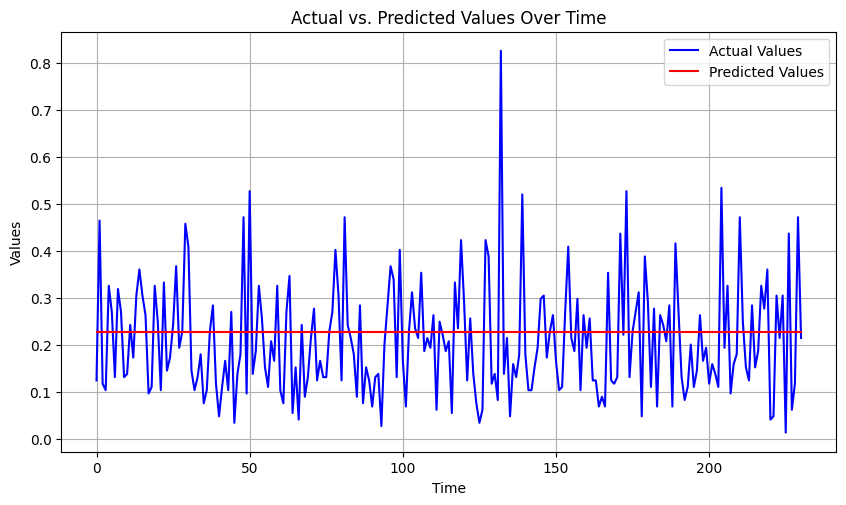

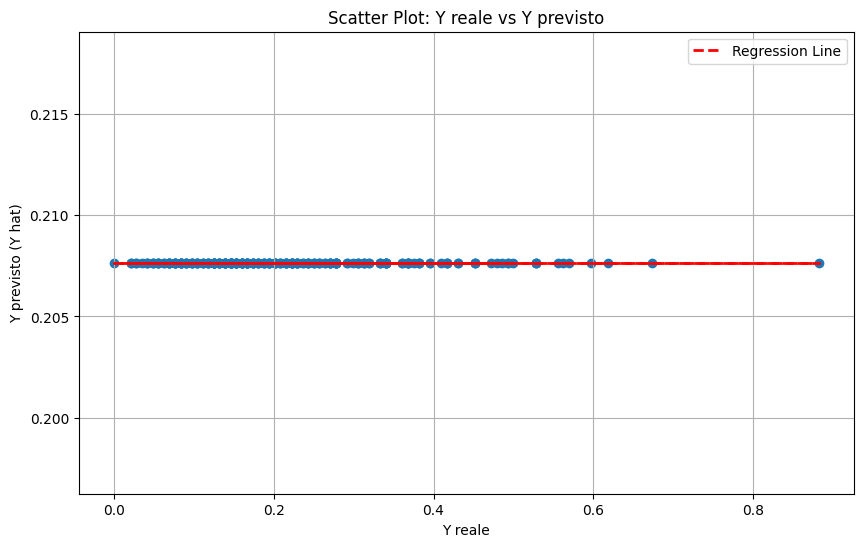

8/8 [==============================] - 0s 6ms/step

Model Completion: 159/144 (110.42%)
Saving data...
8/8 [==============================] - 0s 6ms/step
MAE (Iteration 30): 0.09
R-squared (R2) (Iteration 30): 0.19
RMSE (Iteration 30): 0.12


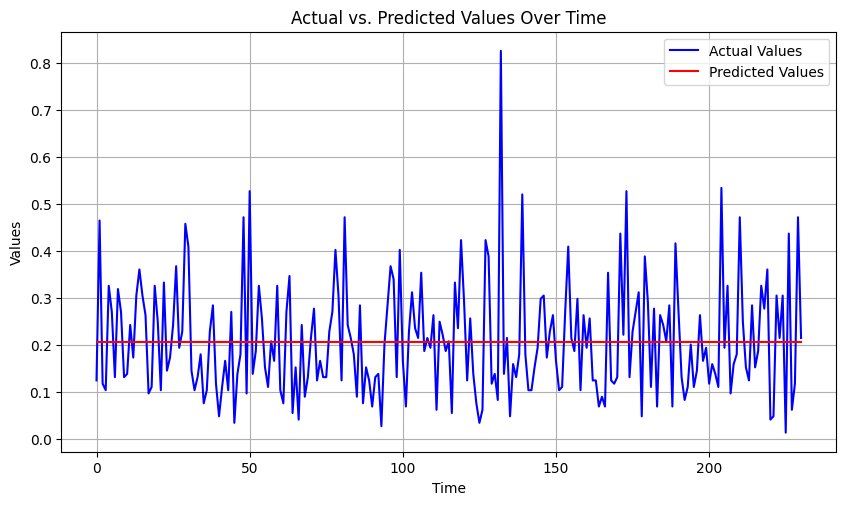

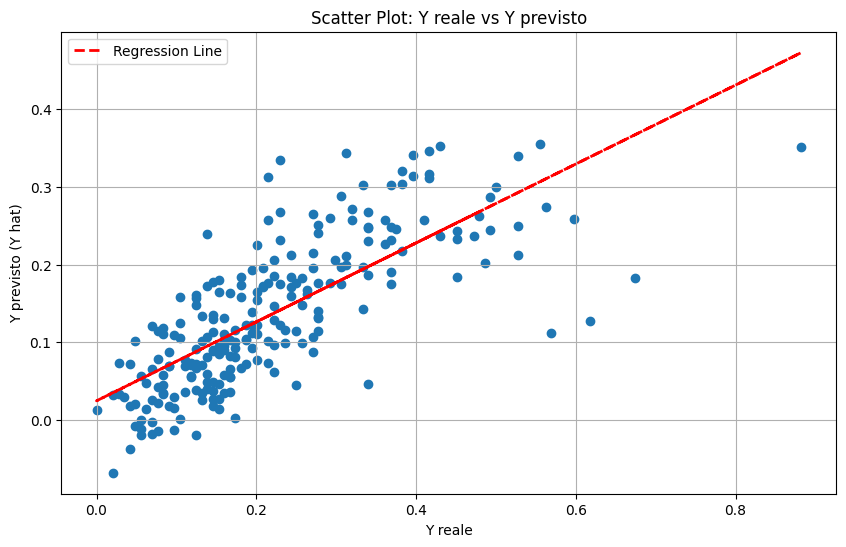

8/8 [==============================] - 0s 3ms/step

Model Completion: 160/144 (111.11%)
Saving data...
Number of Iterations: 40
8/8 [==============================] - 0s 4ms/step
MAE (Iteration 1): 0.11
R-squared (R2) (Iteration 1): -0.01
RMSE (Iteration 1): 0.14


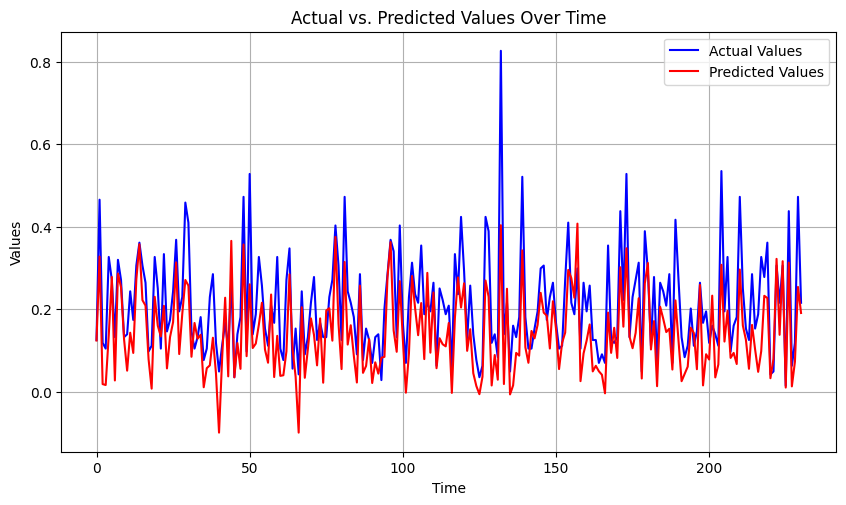

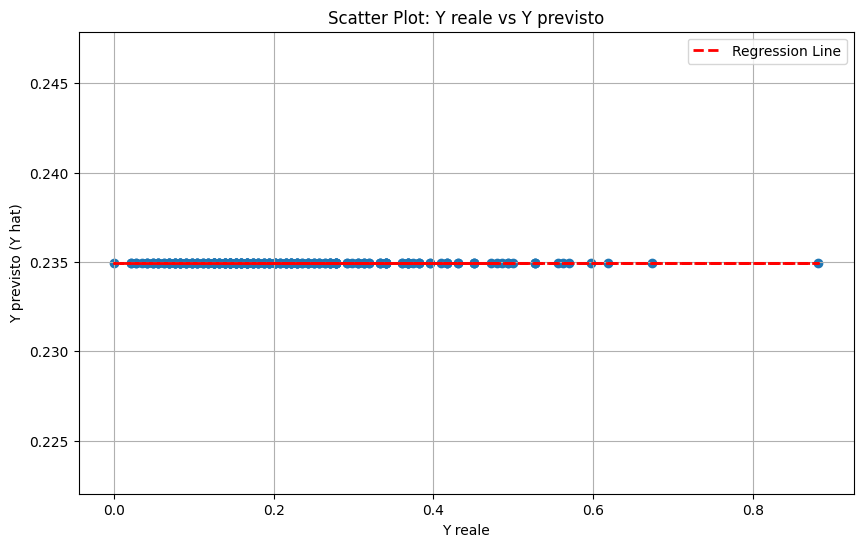

8/8 [==============================] - 0s 4ms/step

Model Completion: 161/144 (111.81%)
Saving data...
8/8 [==============================] - 0s 4ms/step
MAE (Iteration 2): 0.11
R-squared (R2) (Iteration 2): -0.01
RMSE (Iteration 2): 0.14


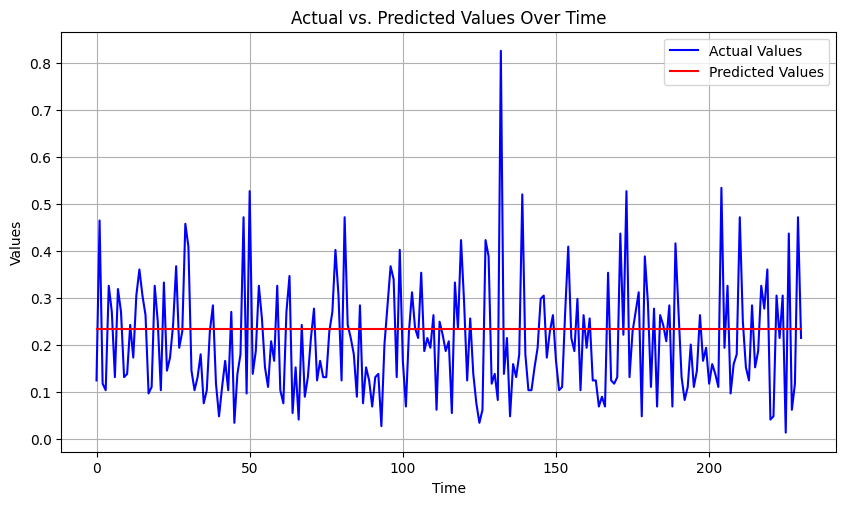

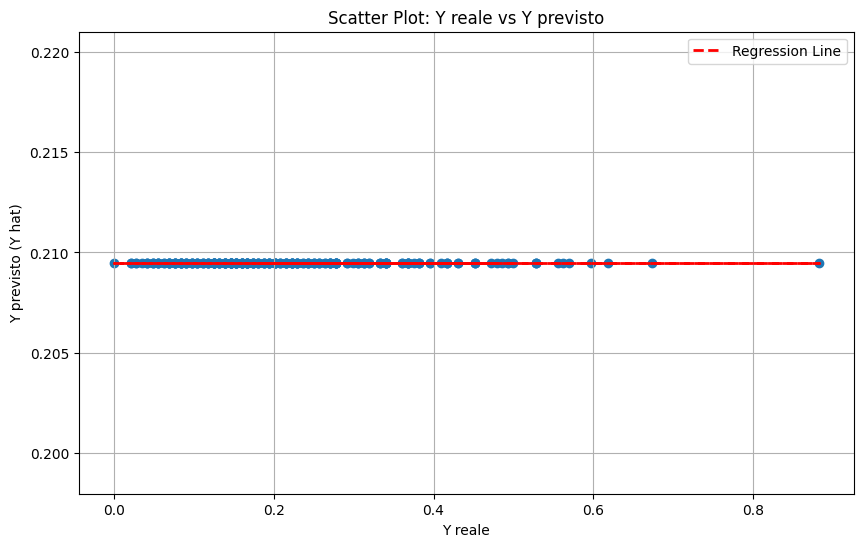

8/8 [==============================] - 0s 7ms/step

Model Completion: 162/144 (112.50%)
Saving data...
8/8 [==============================] - 0s 4ms/step
MAE (Iteration 3): 0.1
R-squared (R2) (Iteration 3): -0.02
RMSE (Iteration 3): 0.14


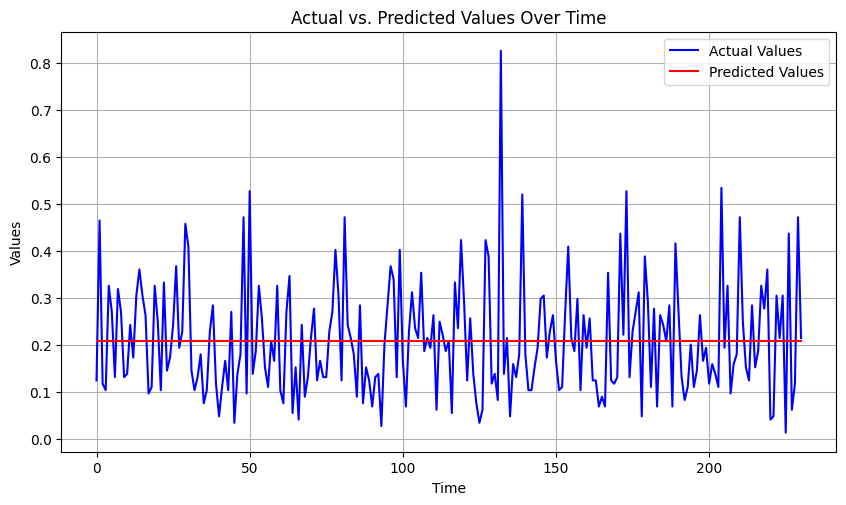

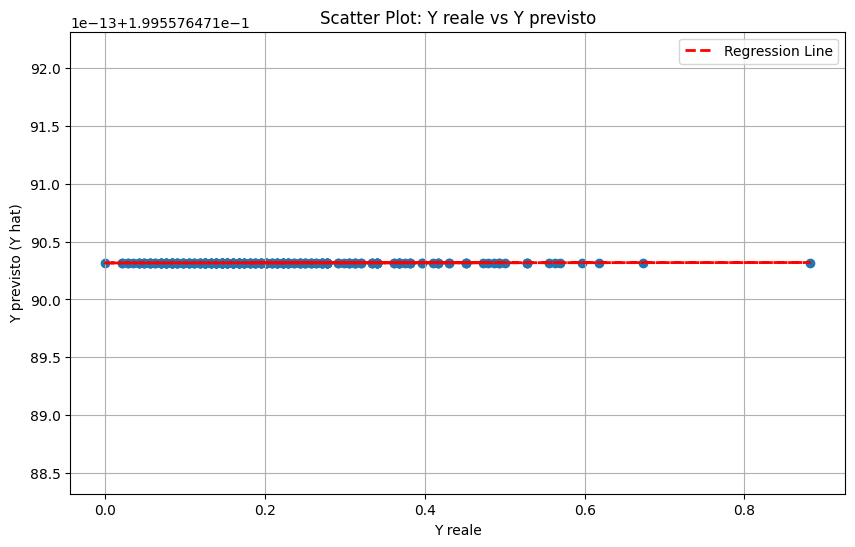

8/8 [==============================] - 0s 3ms/step

Model Completion: 163/144 (113.19%)
Saving data...
8/8 [==============================] - 0s 3ms/step
MAE (Iteration 4): 0.11
R-squared (R2) (Iteration 4): -0.02
RMSE (Iteration 4): 0.14


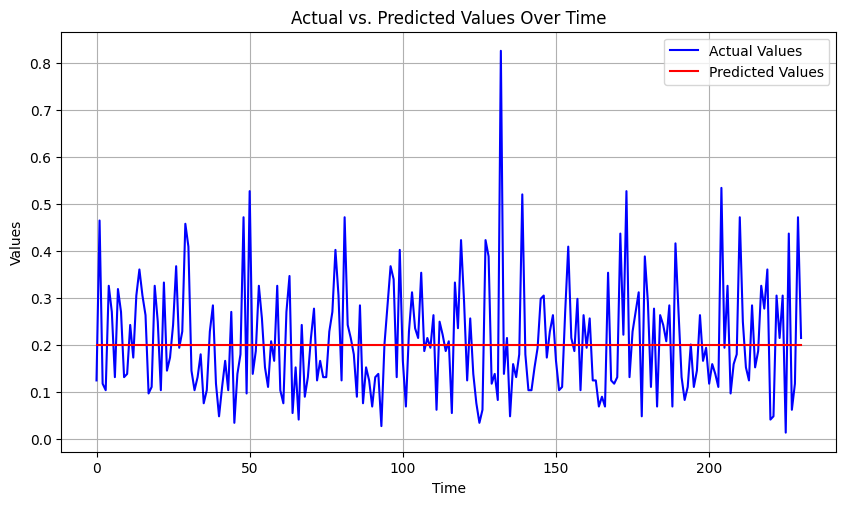

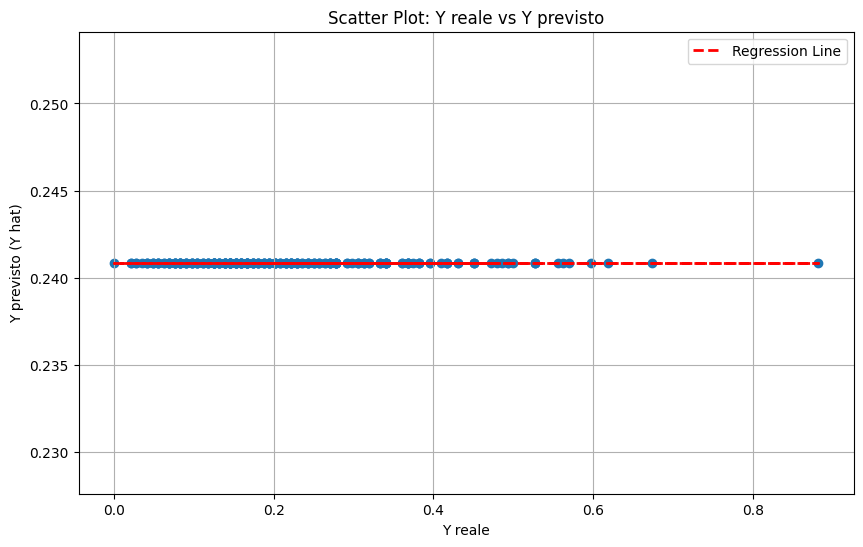

8/8 [==============================] - 0s 4ms/step

Model Completion: 164/144 (113.89%)
Saving data...
8/8 [==============================] - 0s 9ms/step
MAE (Iteration 5): 0.11
R-squared (R2) (Iteration 5): -0.0
RMSE (Iteration 5): 0.14


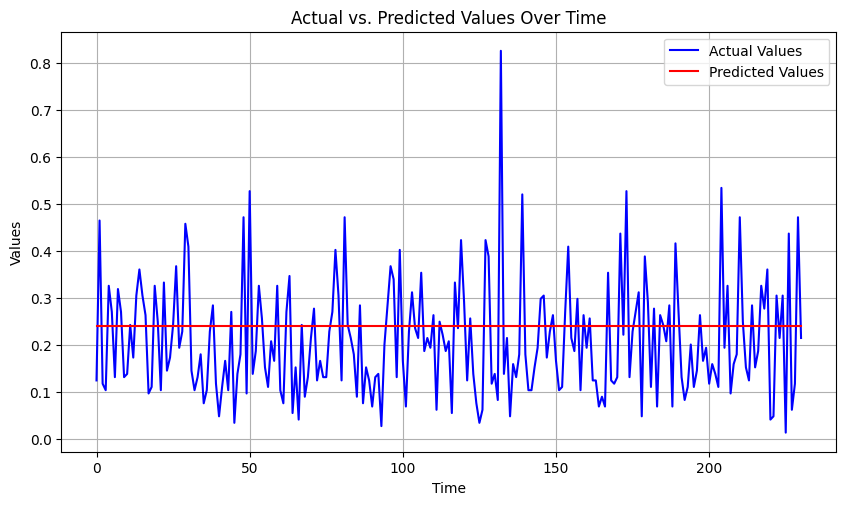

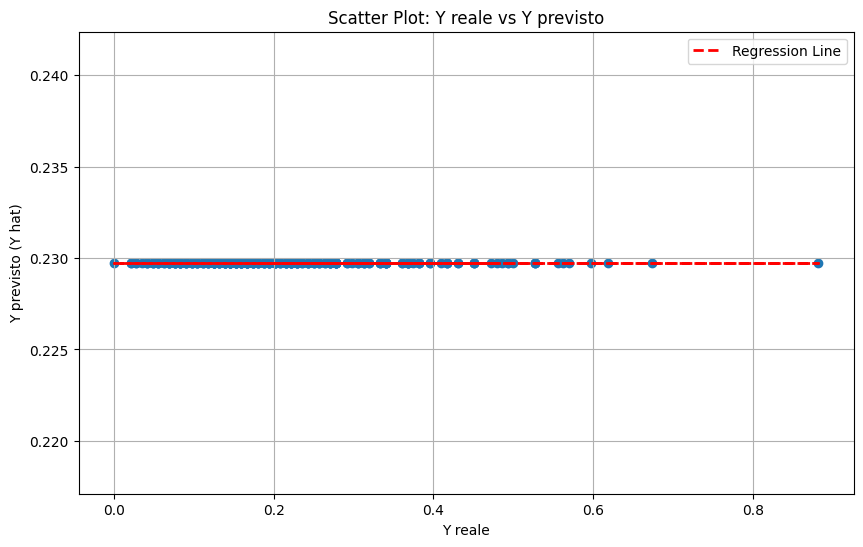

8/8 [==============================] - 0s 11ms/step

Model Completion: 165/144 (114.58%)
Saving data...
8/8 [==============================] - 0s 6ms/step
MAE (Iteration 6): 0.12
R-squared (R2) (Iteration 6): -0.13
RMSE (Iteration 6): 0.15


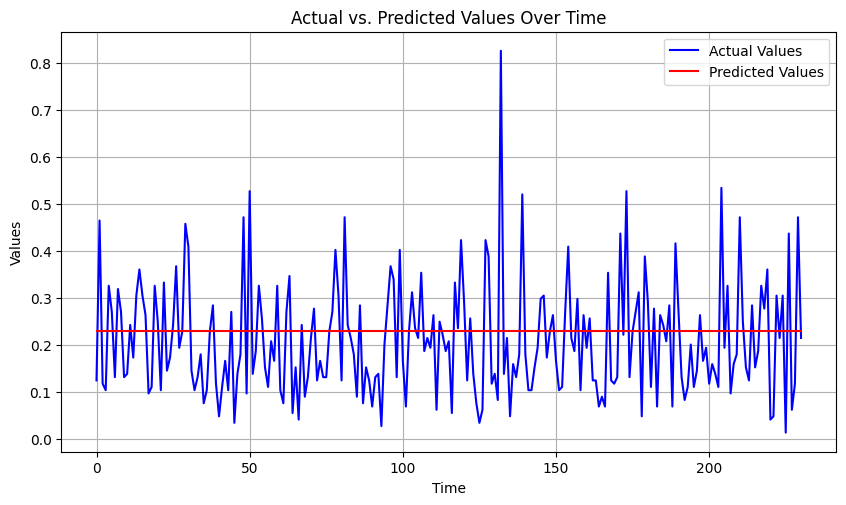

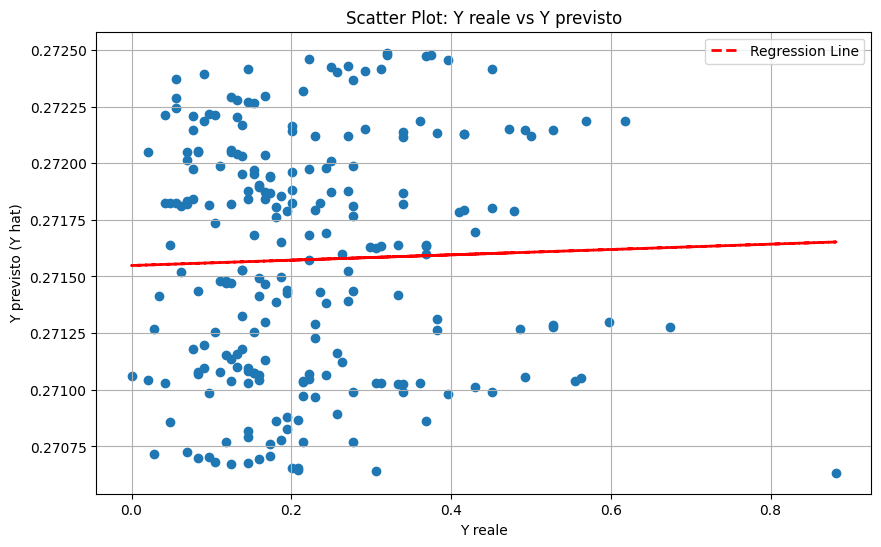

8/8 [==============================] - 0s 5ms/step

Model Completion: 166/144 (115.28%)
Saving data...
8/8 [==============================] - 0s 3ms/step
MAE (Iteration 7): 0.11
R-squared (R2) (Iteration 7): -0.0
RMSE (Iteration 7): 0.14


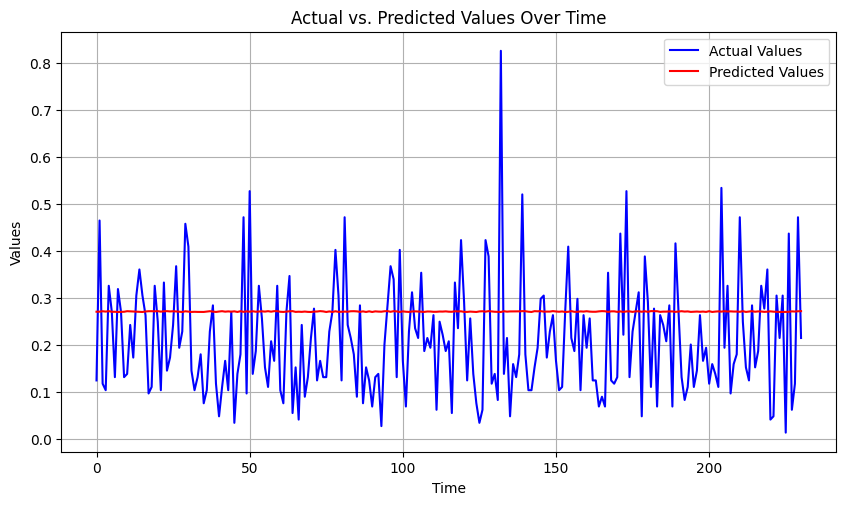

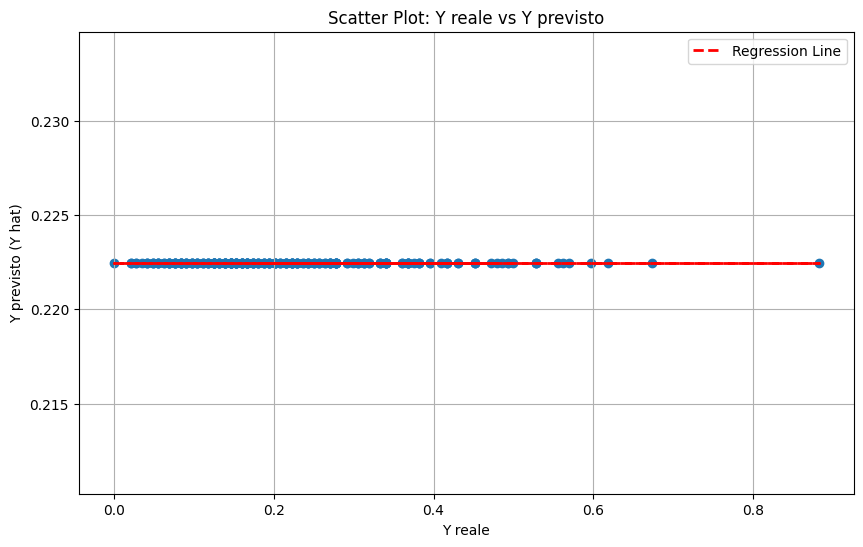

8/8 [==============================] - 0s 4ms/step

Model Completion: 167/144 (115.97%)
Saving data...
8/8 [==============================] - 0s 4ms/step
MAE (Iteration 8): 0.06
R-squared (R2) (Iteration 8): 0.59
RMSE (Iteration 8): 0.09


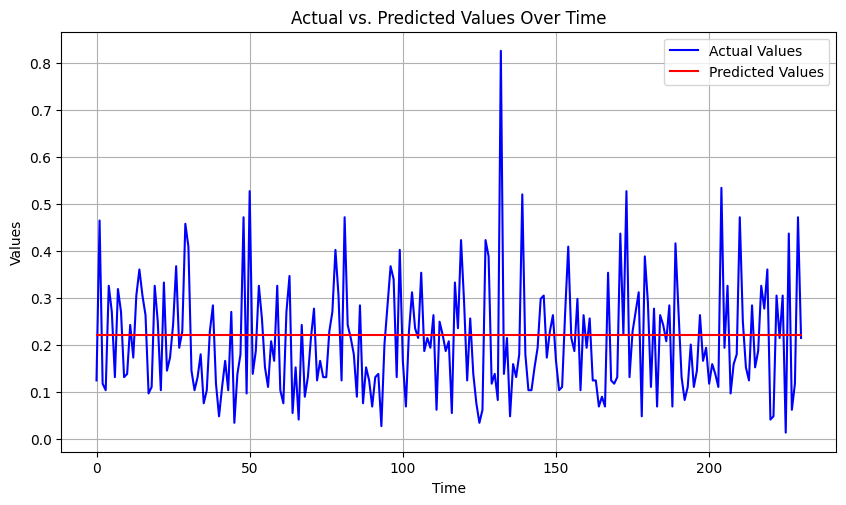

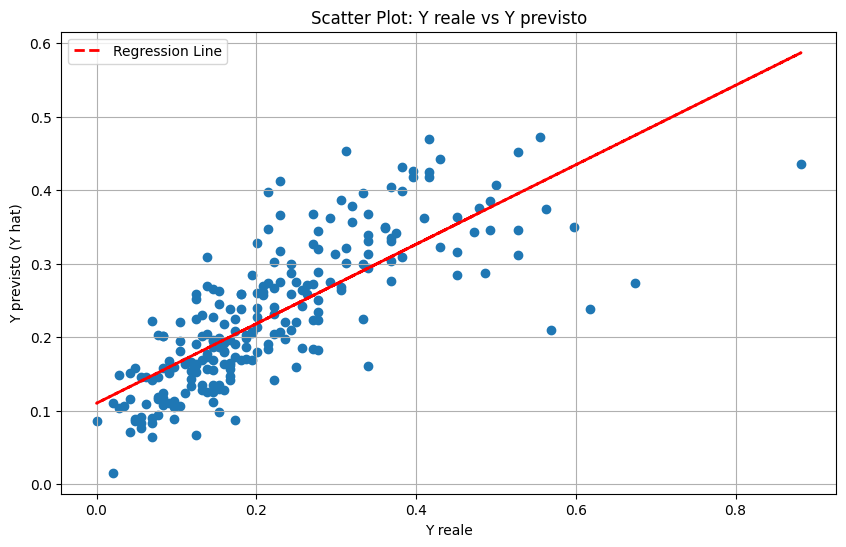

8/8 [==============================] - 0s 3ms/step

Model Completion: 168/144 (116.67%)
Saving data...
8/8 [==============================] - 0s 4ms/step
MAE (Iteration 9): 0.4
R-squared (R2) (Iteration 9): -7.76
RMSE (Iteration 9): 0.41


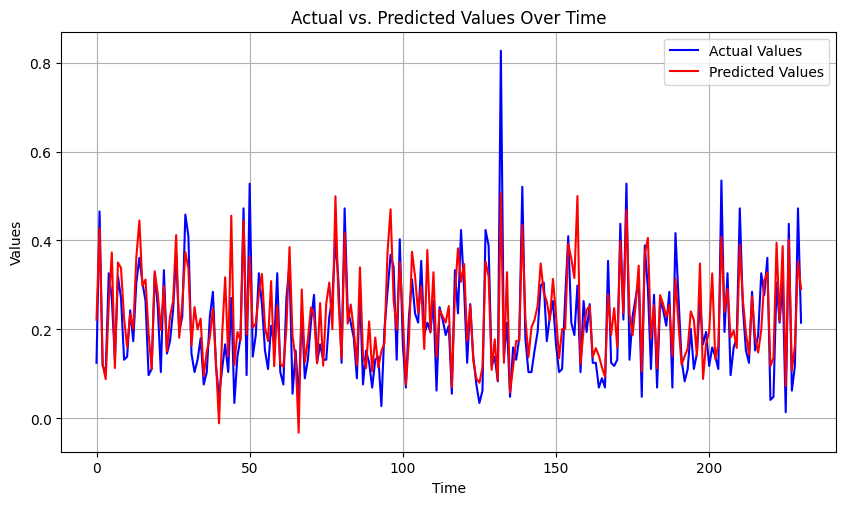

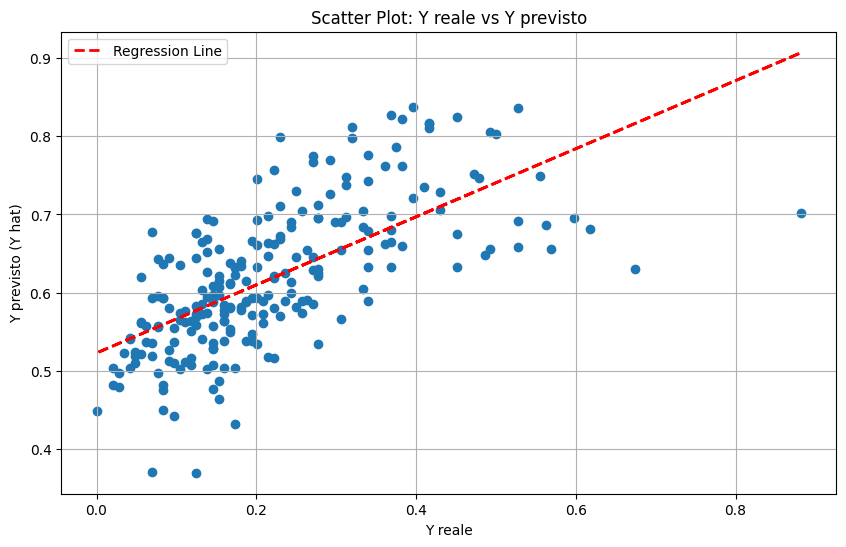

8/8 [==============================] - 0s 6ms/step

Model Completion: 169/144 (117.36%)
Saving data...
8/8 [==============================] - 0s 4ms/step
MAE (Iteration 10): 0.19
R-squared (R2) (Iteration 10): -1.17
RMSE (Iteration 10): 0.2


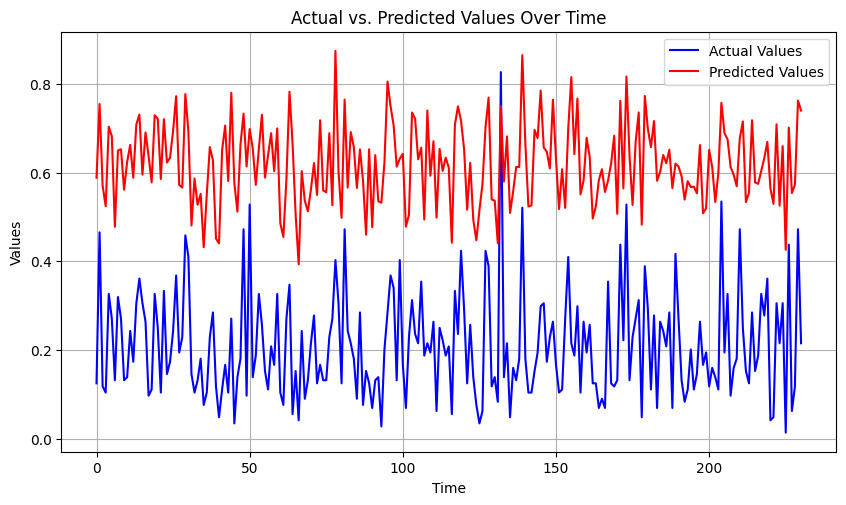

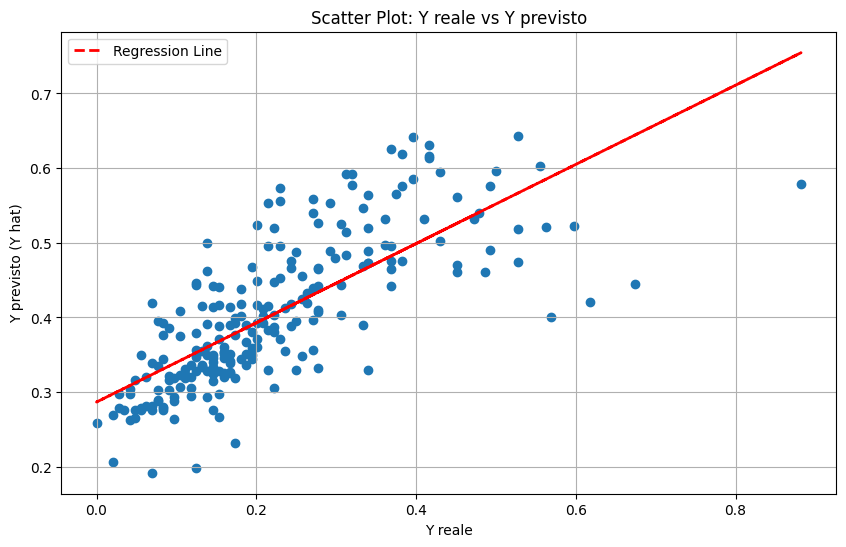

8/8 [==============================] - 0s 8ms/step

Model Completion: 170/144 (118.06%)
Saving data...
8/8 [==============================] - 0s 4ms/step
MAE (Iteration 11): 0.1
R-squared (R2) (Iteration 11): -0.02
RMSE (Iteration 11): 0.14


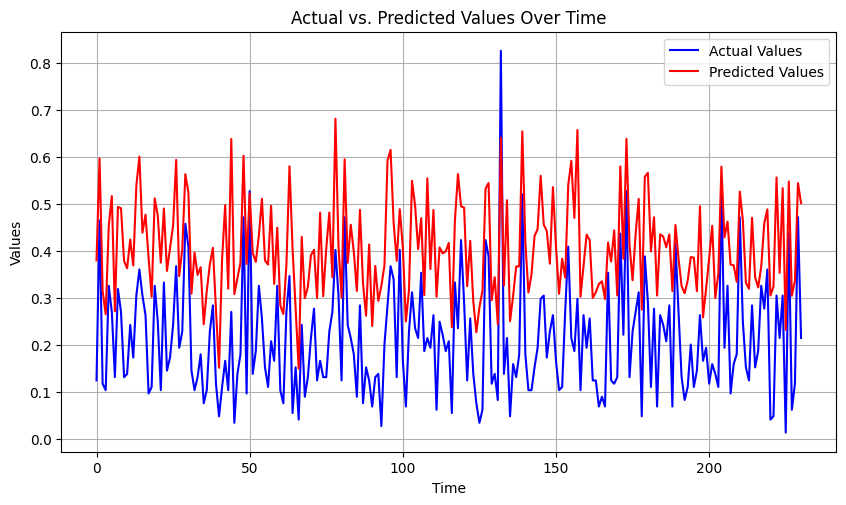

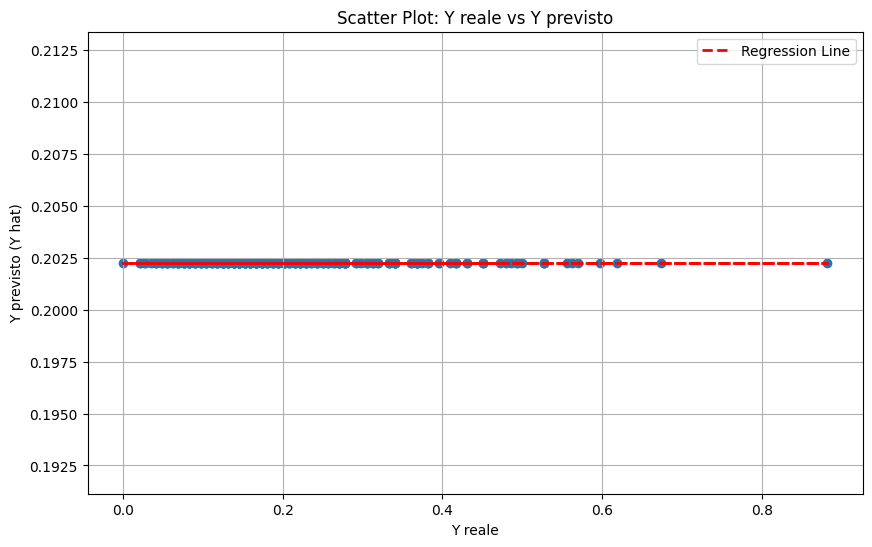

8/8 [==============================] - 0s 5ms/step

Model Completion: 171/144 (118.75%)
Saving data...
8/8 [==============================] - 0s 4ms/step
MAE (Iteration 12): 0.1
R-squared (R2) (Iteration 12): -0.02
RMSE (Iteration 12): 0.14


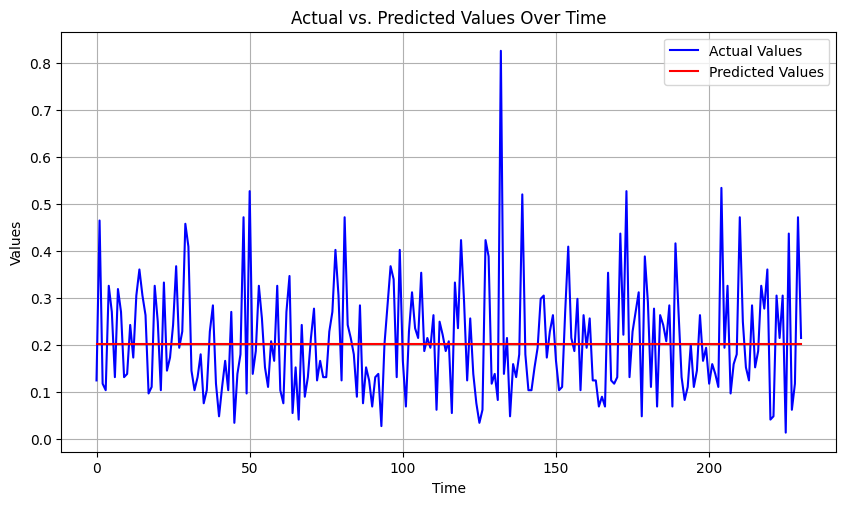

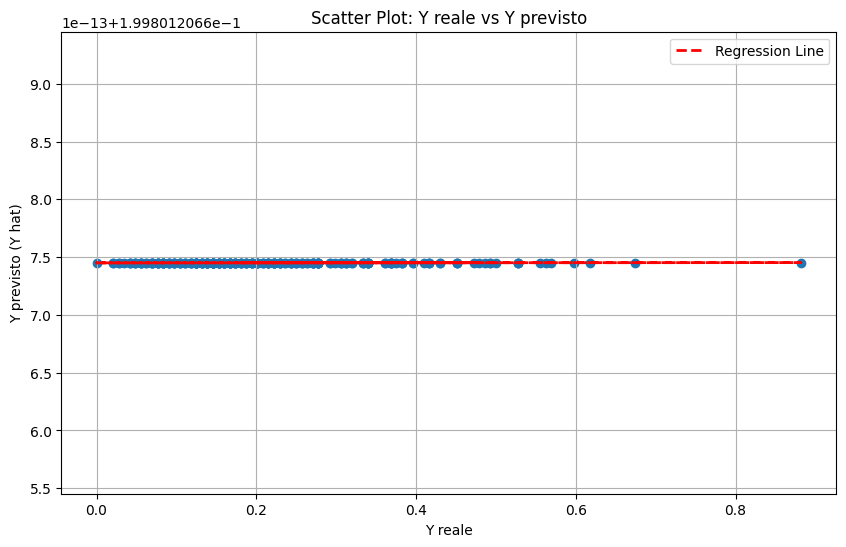

8/8 [==============================] - 0s 4ms/step

Model Completion: 172/144 (119.44%)
Saving data...
8/8 [==============================] - 0s 5ms/step
MAE (Iteration 13): 0.08
R-squared (R2) (Iteration 13): 0.48
RMSE (Iteration 13): 0.1


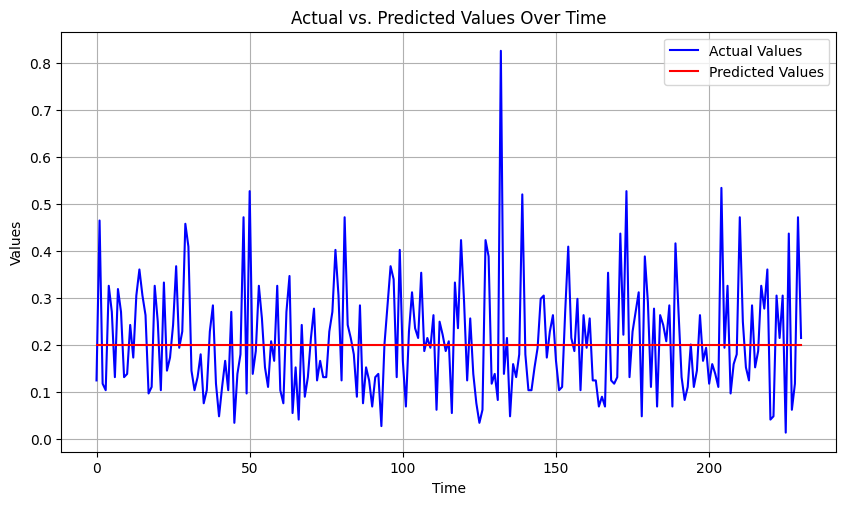

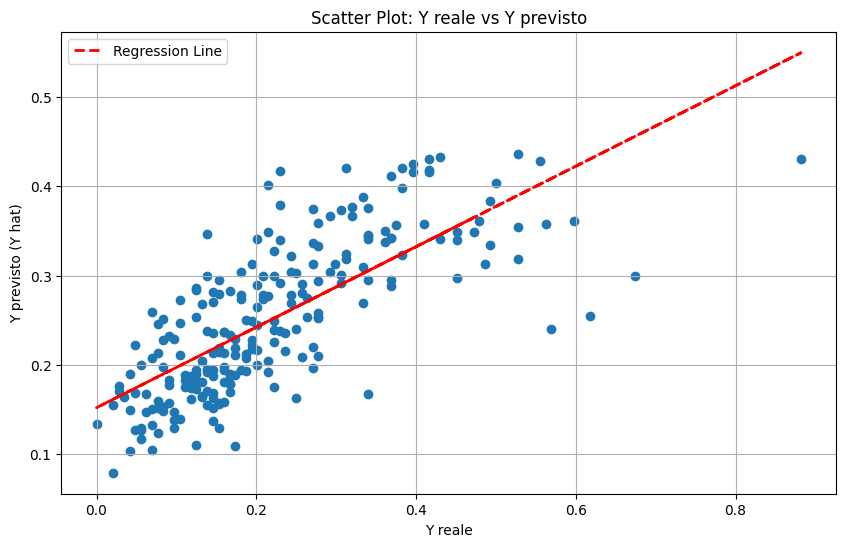

8/8 [==============================] - 0s 4ms/step

Model Completion: 173/144 (120.14%)
Saving data...
8/8 [==============================] - 0s 6ms/step
MAE (Iteration 14): 0.11
R-squared (R2) (Iteration 14): 0.16
RMSE (Iteration 14): 0.13


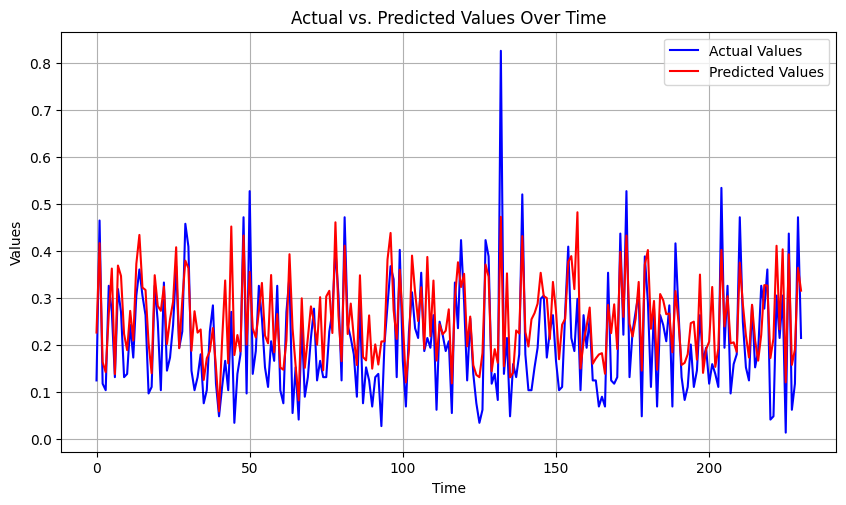

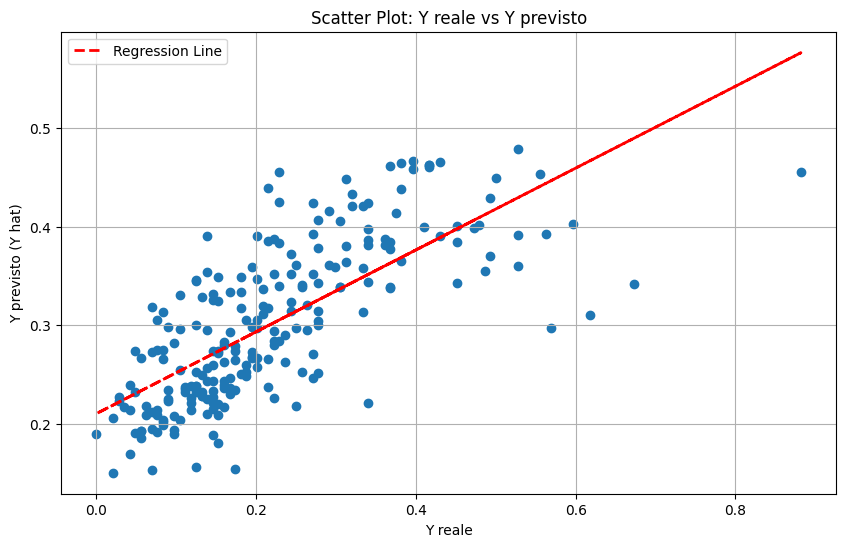

8/8 [==============================] - 0s 5ms/step

Model Completion: 174/144 (120.83%)
Saving data...
8/8 [==============================] - 0s 9ms/step
MAE (Iteration 15): 0.11
R-squared (R2) (Iteration 15): -0.01
RMSE (Iteration 15): 0.14


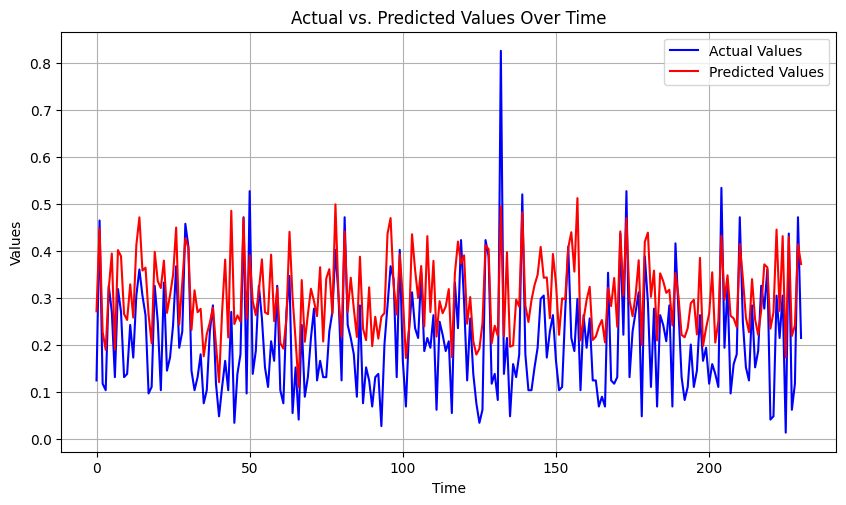

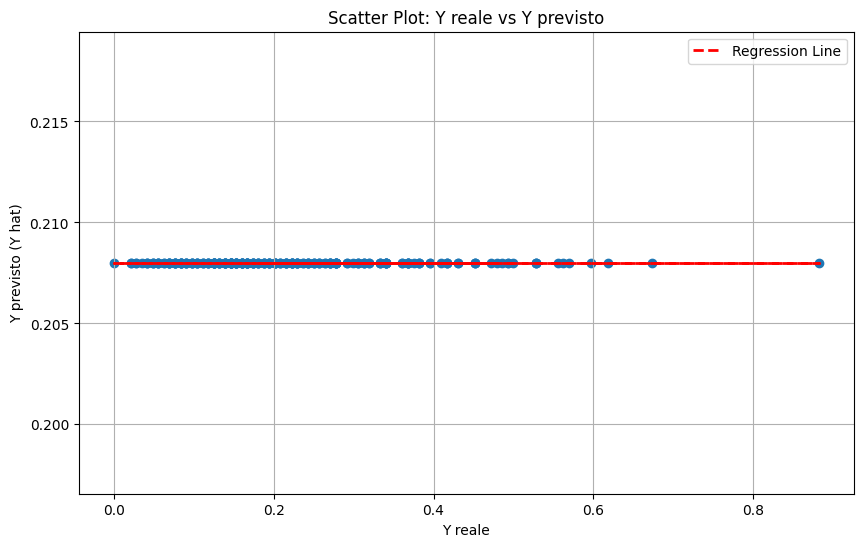

8/8 [==============================] - 0s 6ms/step

Model Completion: 175/144 (121.53%)
Saving data...
8/8 [==============================] - 0s 4ms/step
MAE (Iteration 16): 0.1
R-squared (R2) (Iteration 16): -0.02
RMSE (Iteration 16): 0.14


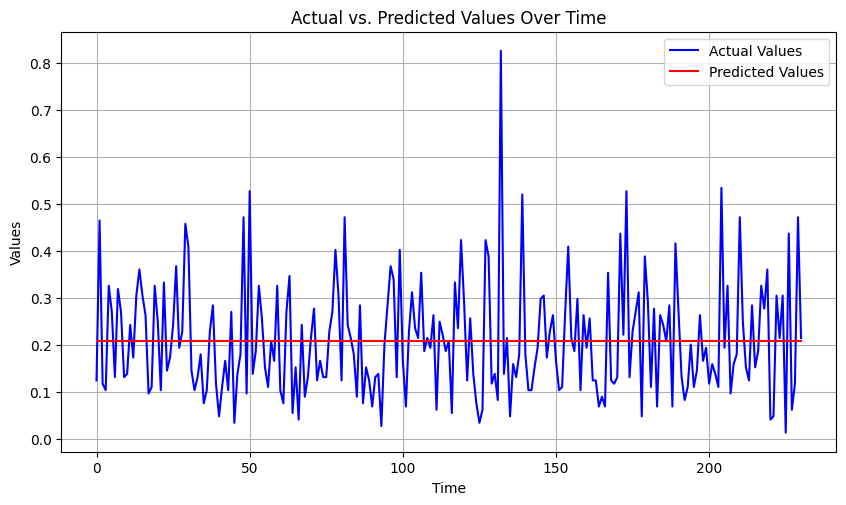

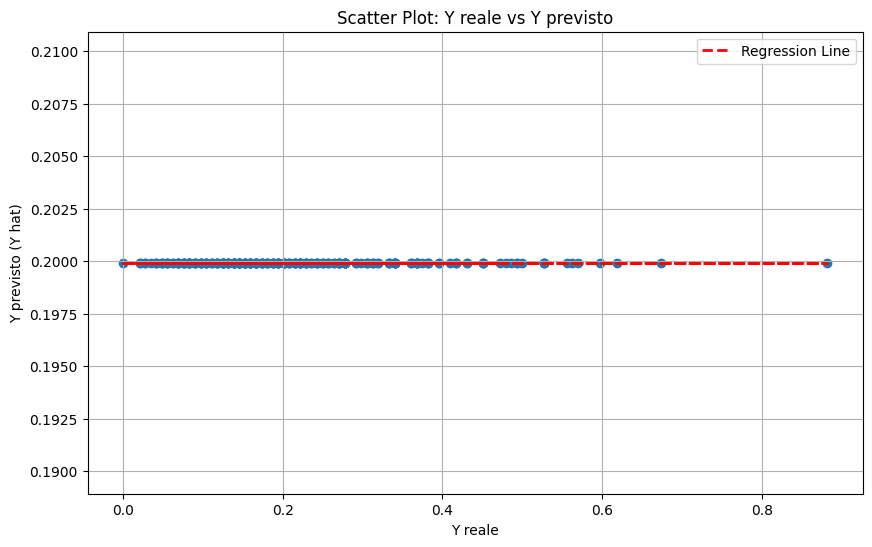

8/8 [==============================] - 0s 4ms/step

Model Completion: 176/144 (122.22%)
Saving data...
8/8 [==============================] - 0s 6ms/step
MAE (Iteration 17): 0.11
R-squared (R2) (Iteration 17): -0.02
RMSE (Iteration 17): 0.14


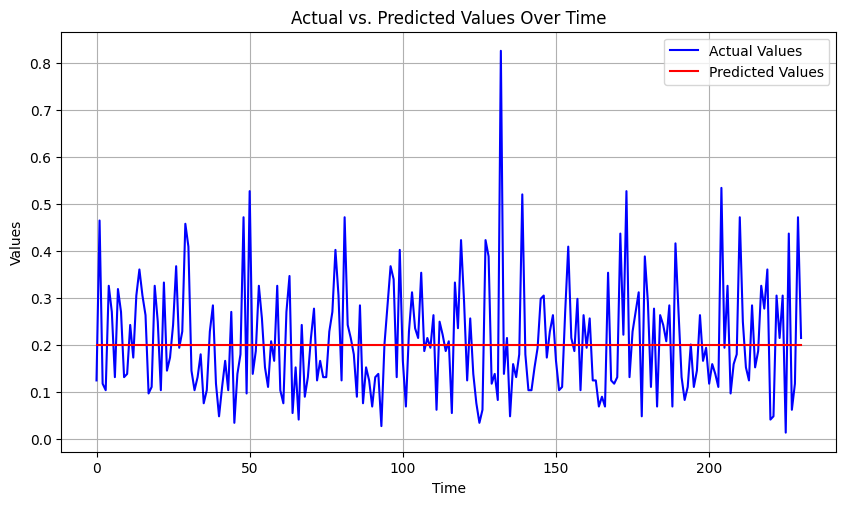

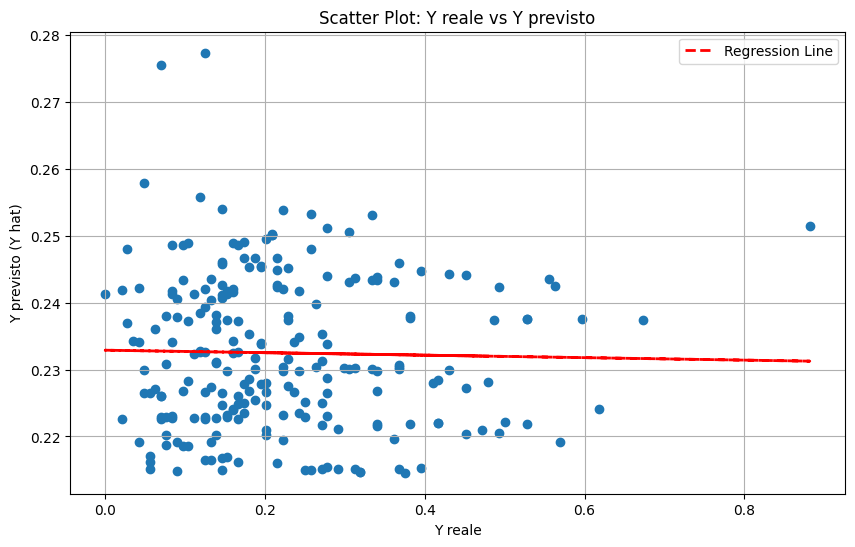

8/8 [==============================] - 0s 5ms/step

Model Completion: 177/144 (122.92%)
Saving data...
8/8 [==============================] - 0s 6ms/step
MAE (Iteration 18): 0.11
R-squared (R2) (Iteration 18): -0.0
RMSE (Iteration 18): 0.14


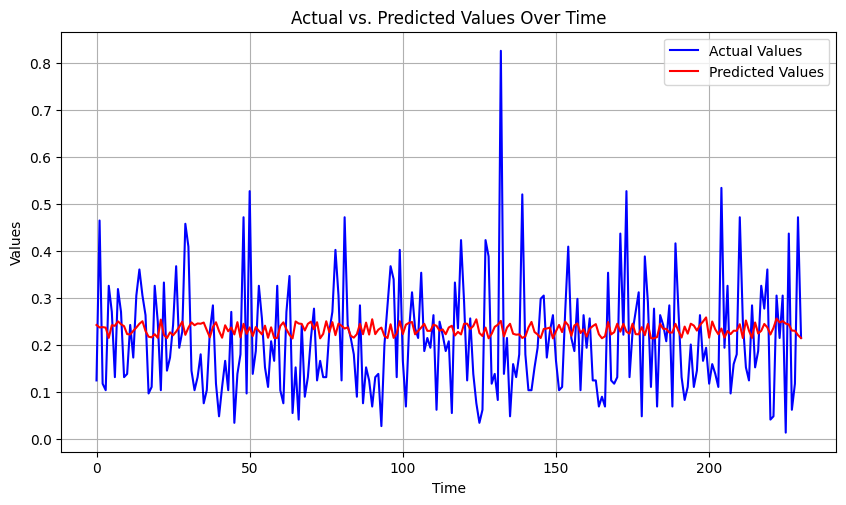

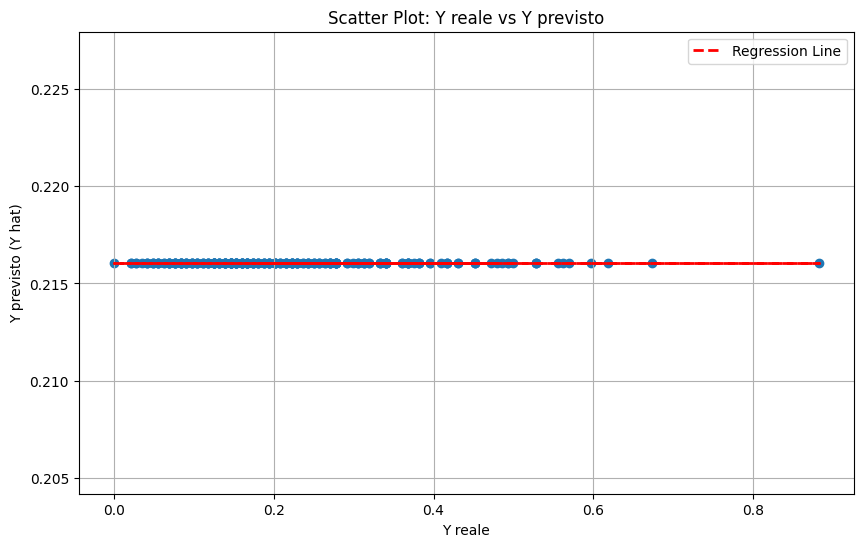

8/8 [==============================] - 0s 8ms/step

Model Completion: 178/144 (123.61%)
Saving data...
8/8 [==============================] - 0s 4ms/step
MAE (Iteration 19): 0.11
R-squared (R2) (Iteration 19): -0.01
RMSE (Iteration 19): 0.14


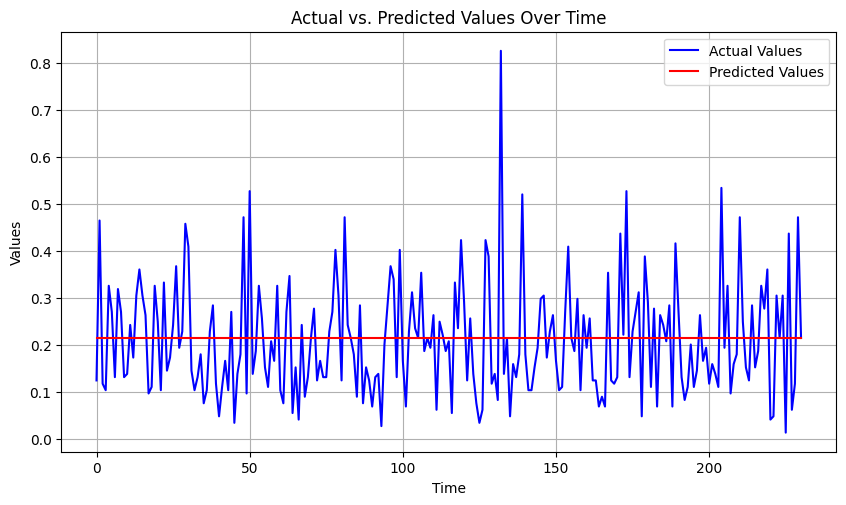

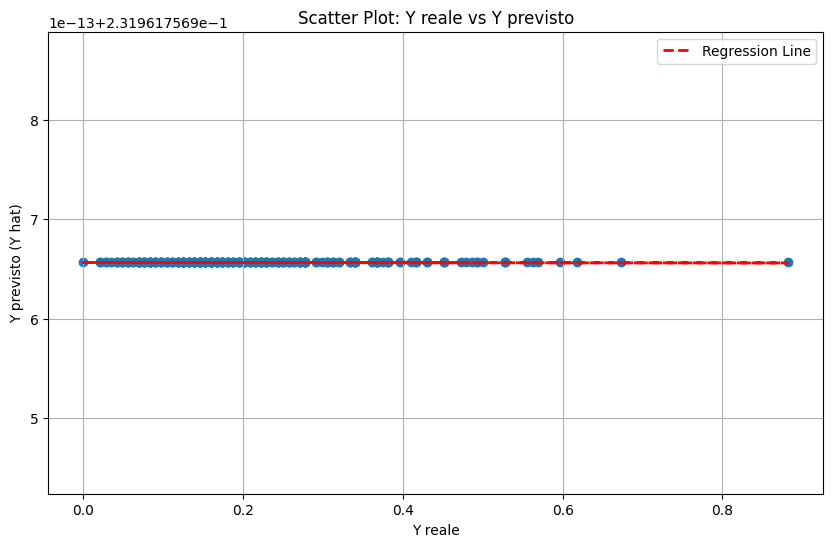

8/8 [==============================] - 0s 4ms/step

Model Completion: 179/144 (124.31%)
Saving data...
8/8 [==============================] - 0s 8ms/step
MAE (Iteration 20): 0.08
R-squared (R2) (Iteration 20): 0.46
RMSE (Iteration 20): 0.1


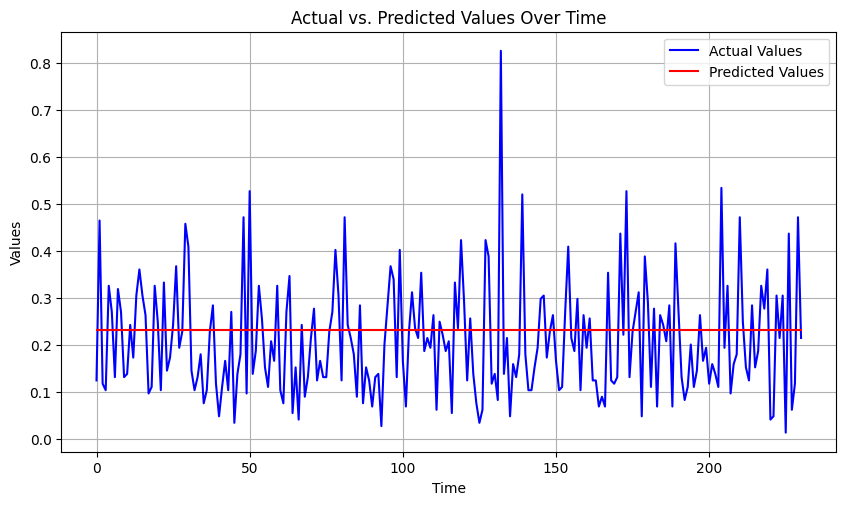

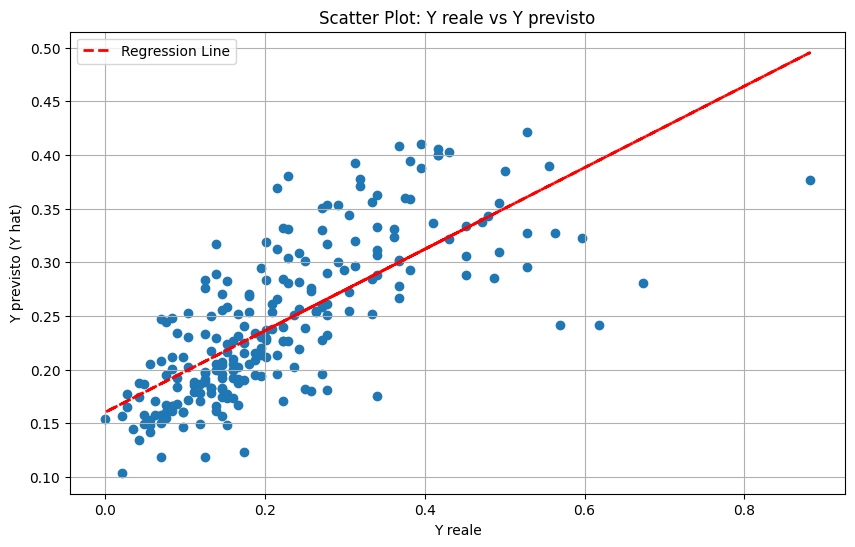

8/8 [==============================] - 0s 4ms/step

Model Completion: 180/144 (125.00%)
Saving data...
8/8 [==============================] - 0s 9ms/step
MAE (Iteration 21): 0.06
R-squared (R2) (Iteration 21): 0.59
RMSE (Iteration 21): 0.09


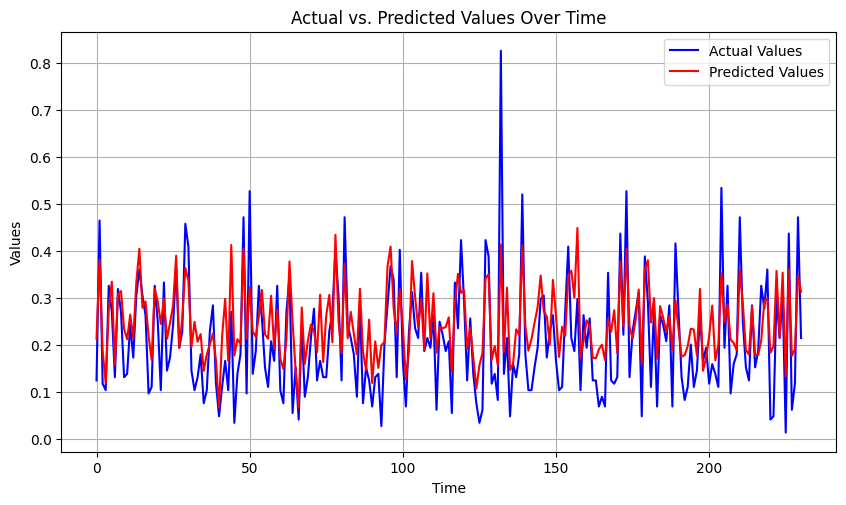

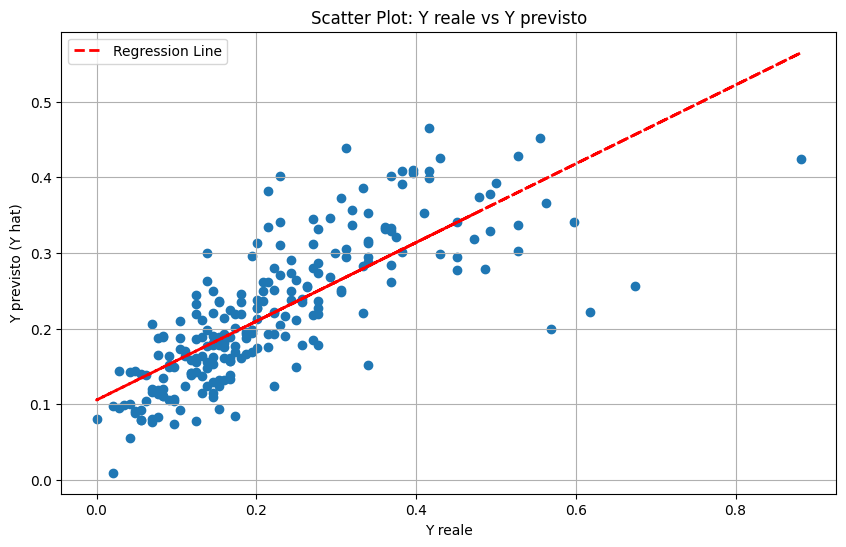

8/8 [==============================] - 0s 10ms/step

Model Completion: 181/144 (125.69%)
Saving data...
8/8 [==============================] - 0s 5ms/step
MAE (Iteration 22): 0.07
R-squared (R2) (Iteration 22): 0.56
RMSE (Iteration 22): 0.09


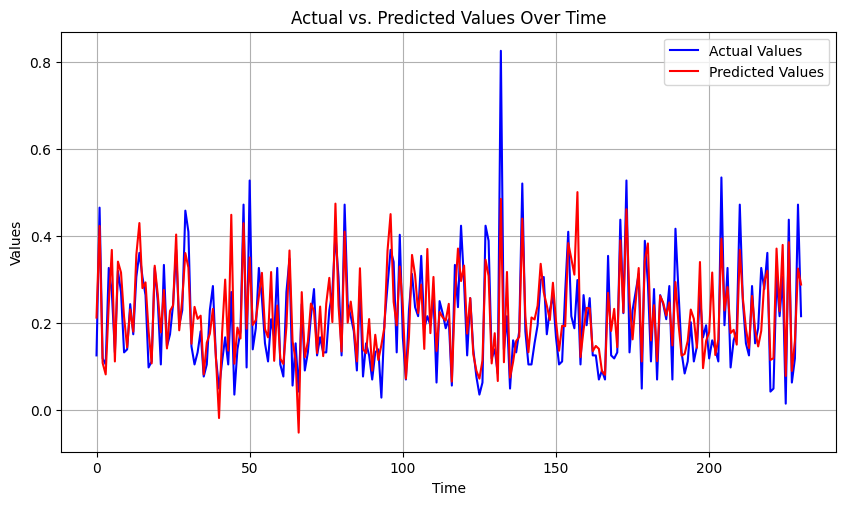

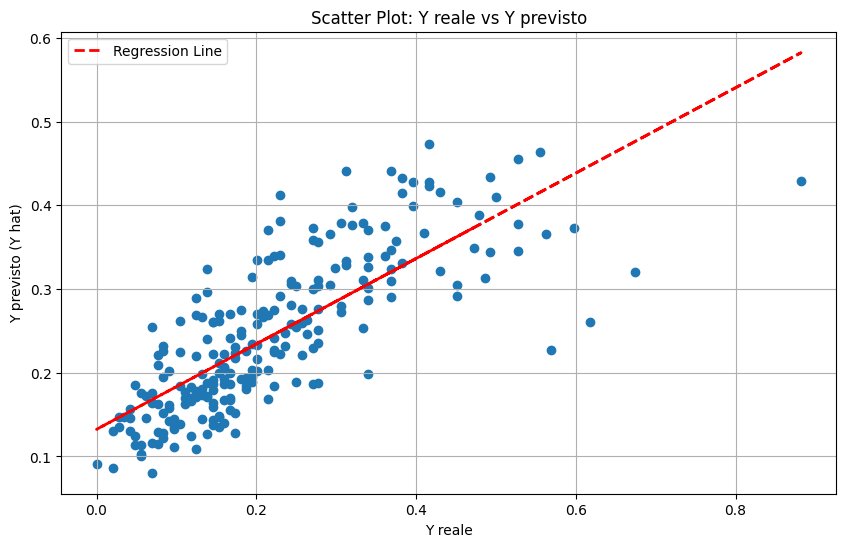

8/8 [==============================] - 0s 7ms/step

Model Completion: 182/144 (126.39%)
Saving data...
8/8 [==============================] - 0s 3ms/step
MAE (Iteration 23): 0.11
R-squared (R2) (Iteration 23): -0.01
RMSE (Iteration 23): 0.14


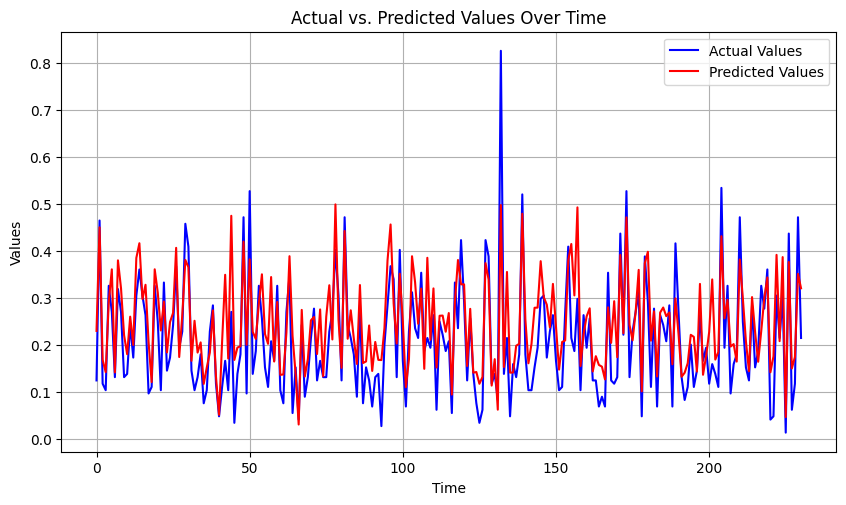

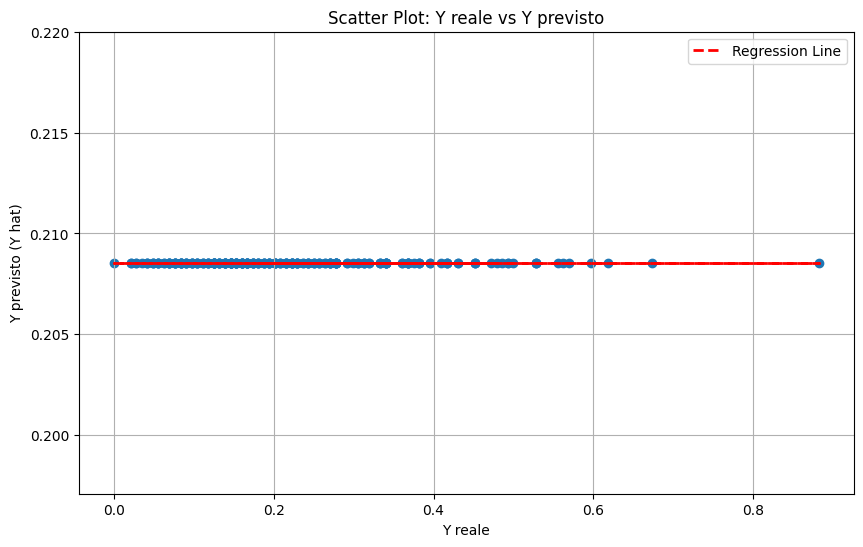

8/8 [==============================] - 0s 4ms/step

Model Completion: 183/144 (127.08%)
Saving data...
8/8 [==============================] - 0s 6ms/step
MAE (Iteration 24): 0.11
R-squared (R2) (Iteration 24): -0.0
RMSE (Iteration 24): 0.14


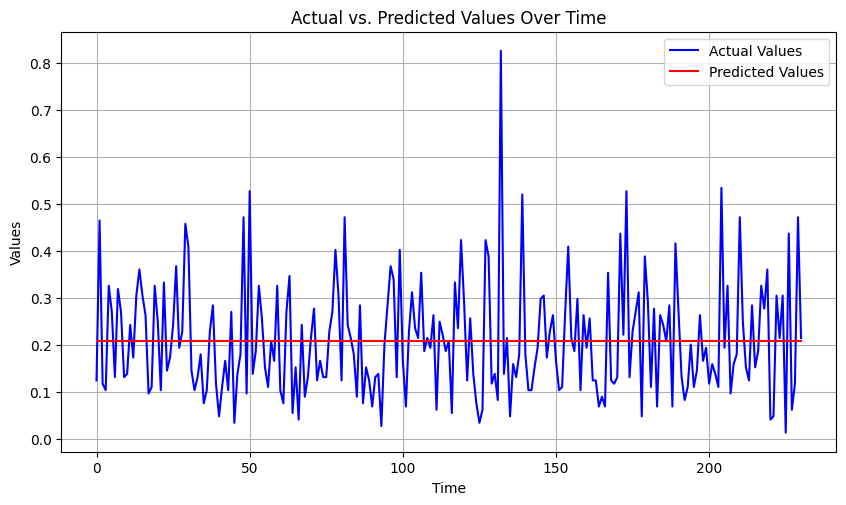

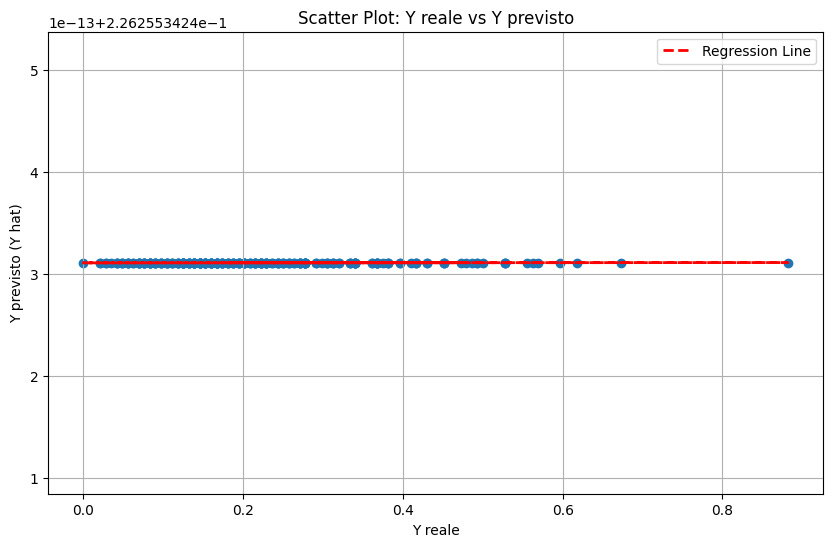

8/8 [==============================] - 0s 4ms/step

Model Completion: 184/144 (127.78%)
Saving data...
8/8 [==============================] - 0s 4ms/step
MAE (Iteration 25): 0.12
R-squared (R2) (Iteration 25): -0.11
RMSE (Iteration 25): 0.15


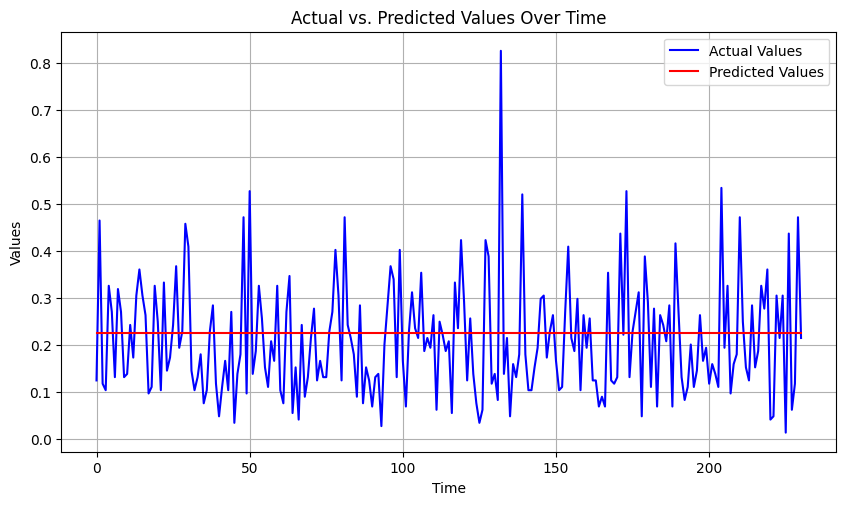

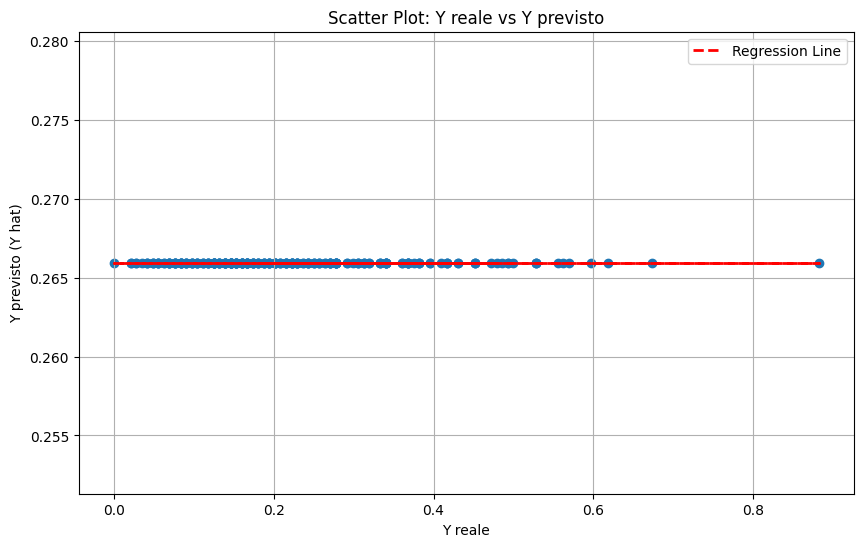

8/8 [==============================] - 0s 4ms/step

Model Completion: 185/144 (128.47%)
Saving data...
8/8 [==============================] - 0s 6ms/step
MAE (Iteration 26): 0.08
R-squared (R2) (Iteration 26): 0.35
RMSE (Iteration 26): 0.11


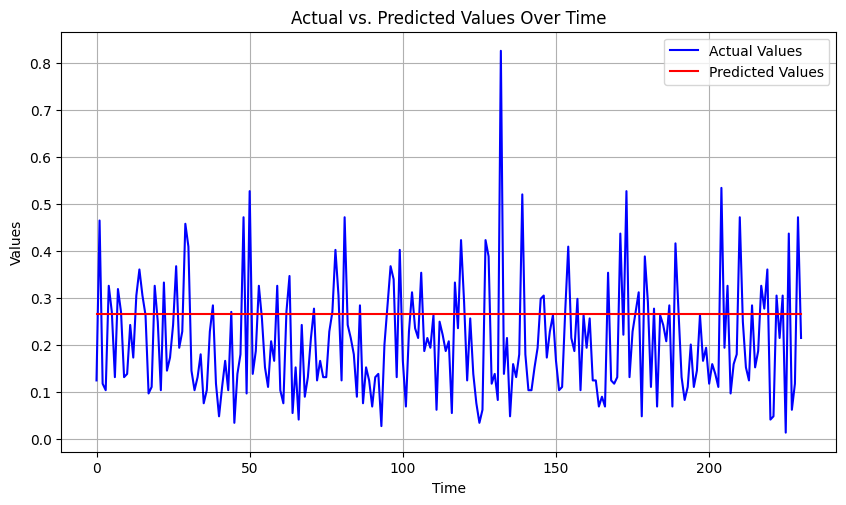

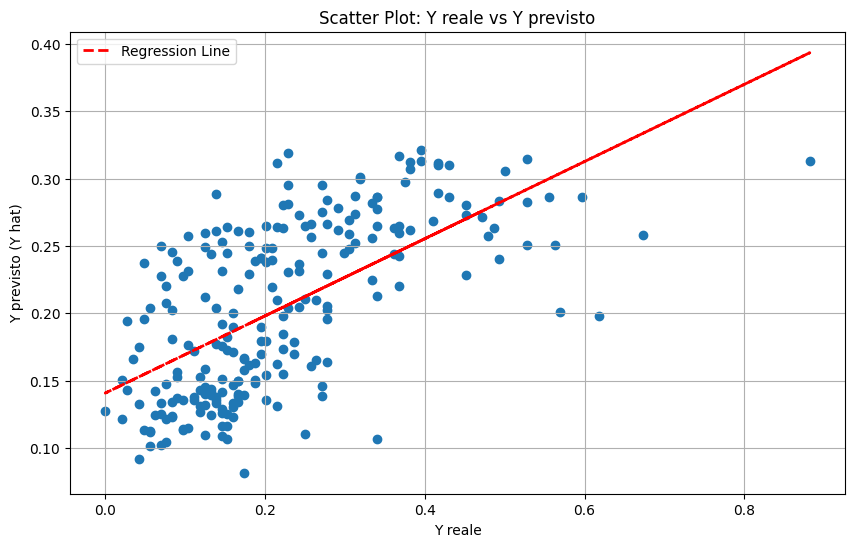

8/8 [==============================] - 0s 4ms/step

Model Completion: 186/144 (129.17%)
Saving data...
8/8 [==============================] - 0s 4ms/step
MAE (Iteration 27): 0.34
R-squared (R2) (Iteration 27): -5.21
RMSE (Iteration 27): 0.35


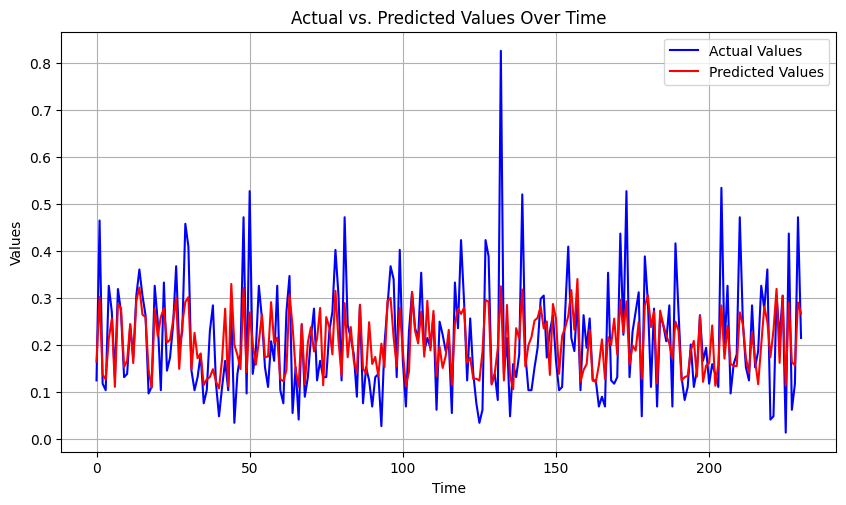

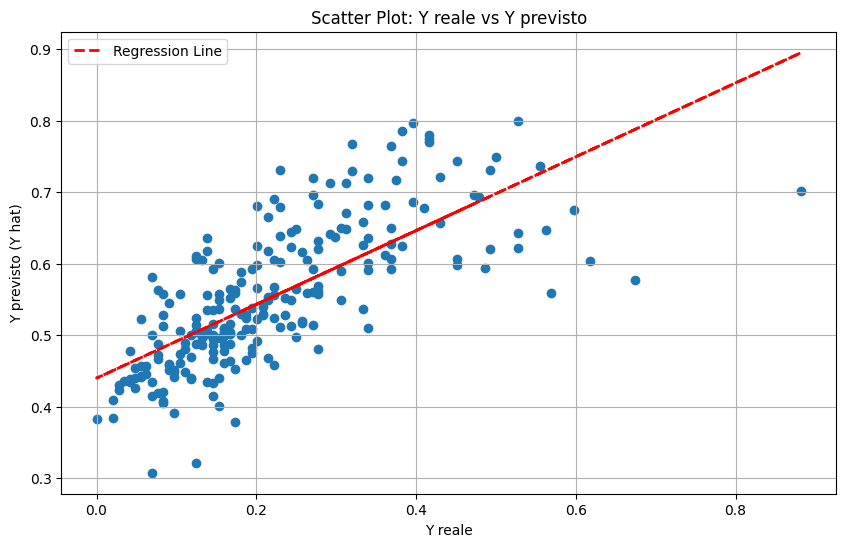

8/8 [==============================] - 0s 5ms/step

Model Completion: 187/144 (129.86%)
Saving data...
8/8 [==============================] - 0s 5ms/step
MAE (Iteration 28): 0.1
R-squared (R2) (Iteration 28): 0.21
RMSE (Iteration 28): 0.12


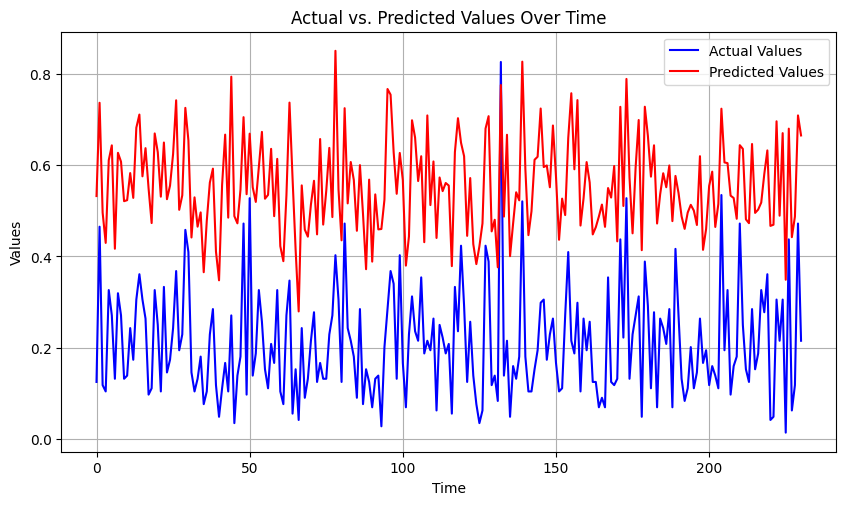

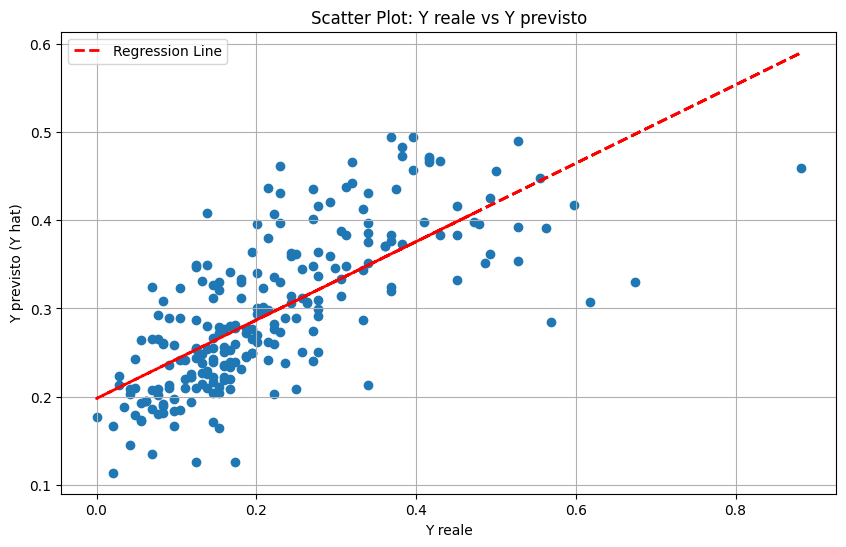

8/8 [==============================] - 0s 8ms/step

Model Completion: 188/144 (130.56%)
Saving data...
8/8 [==============================] - 0s 5ms/step
MAE (Iteration 29): 0.14
R-squared (R2) (Iteration 29): -0.26
RMSE (Iteration 29): 0.16


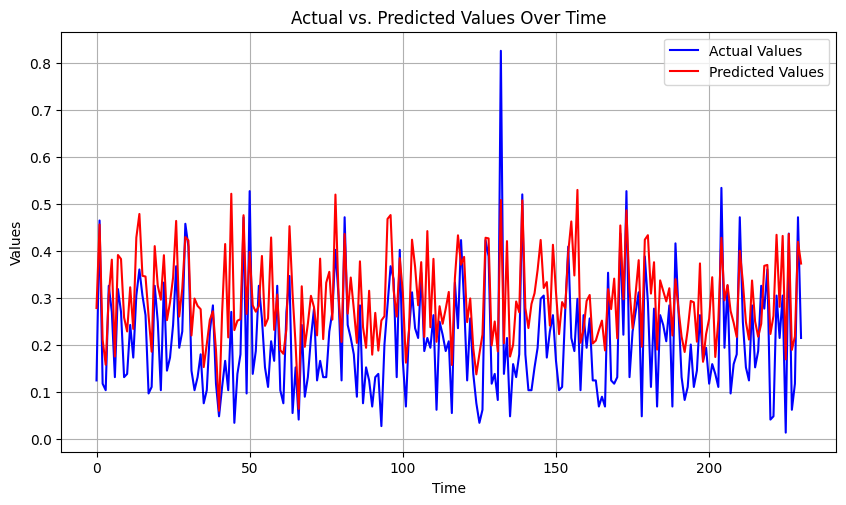

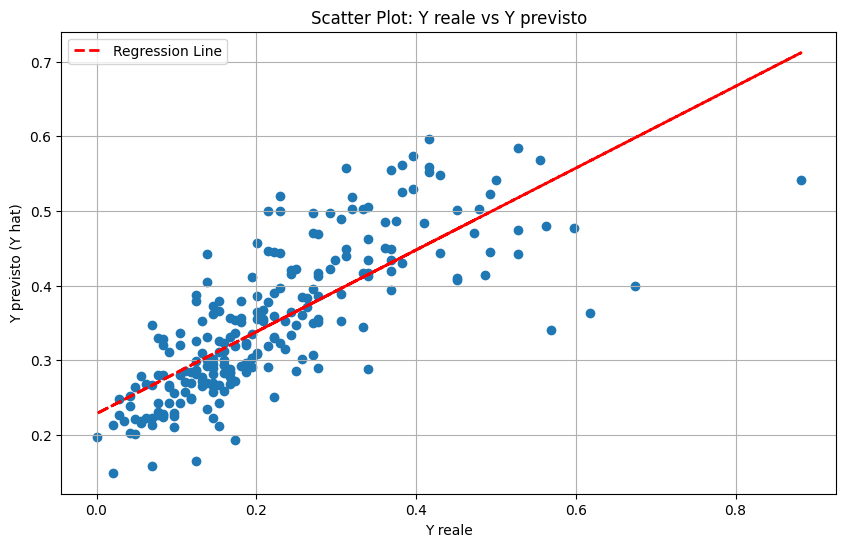

8/8 [==============================] - 0s 10ms/step

Model Completion: 189/144 (131.25%)
Saving data...
8/8 [==============================] - 0s 6ms/step
MAE (Iteration 30): 0.11
R-squared (R2) (Iteration 30): -0.01
RMSE (Iteration 30): 0.14


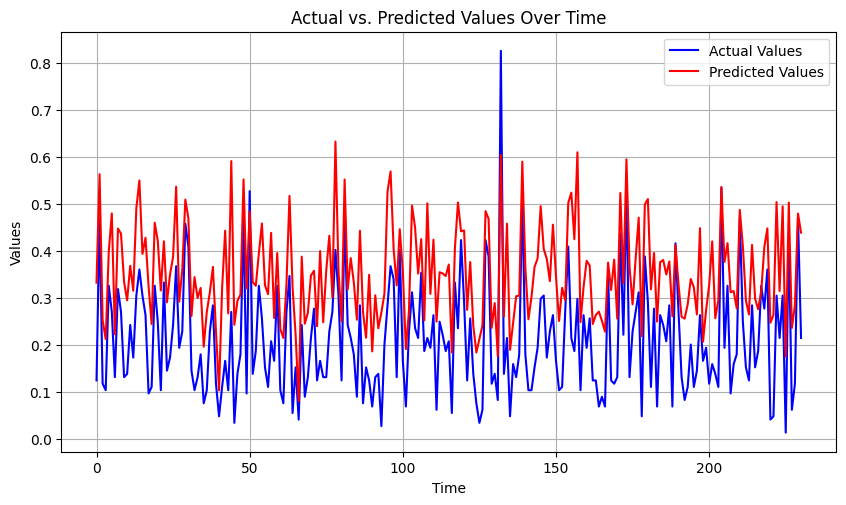

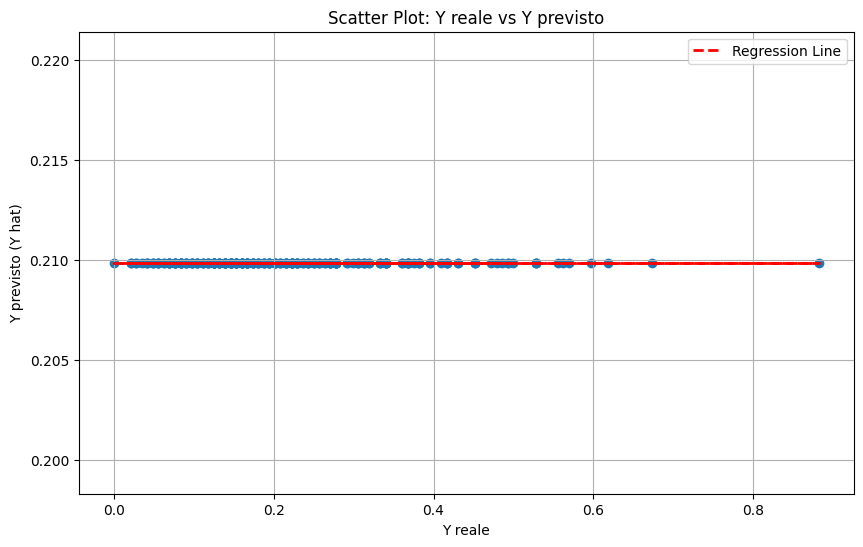

8/8 [==============================] - 0s 3ms/step

Model Completion: 190/144 (131.94%)
Saving data...
8/8 [==============================] - 0s 4ms/step
MAE (Iteration 31): 0.45
R-squared (R2) (Iteration 31): -9.78
RMSE (Iteration 31): 0.46


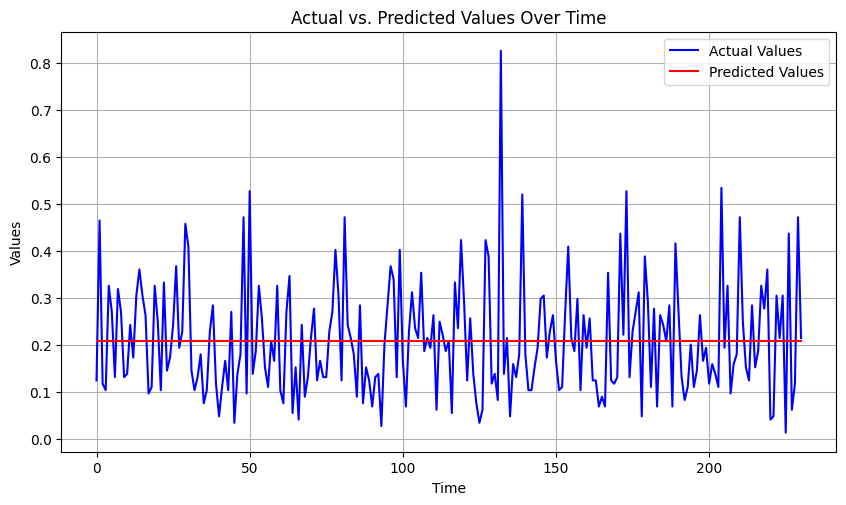

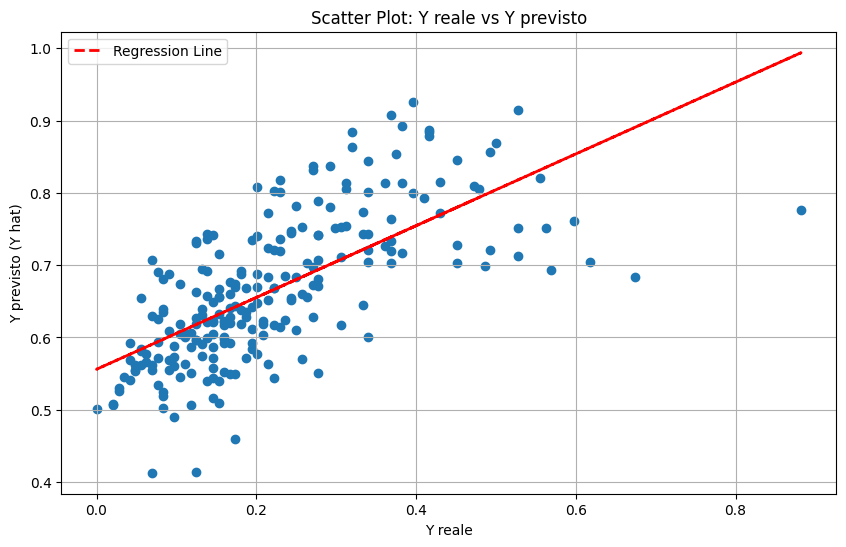

8/8 [==============================] - 0s 5ms/step

Model Completion: 191/144 (132.64%)
Saving data...
8/8 [==============================] - 0s 9ms/step
MAE (Iteration 32): 0.11
R-squared (R2) (Iteration 32): -0.01
RMSE (Iteration 32): 0.14


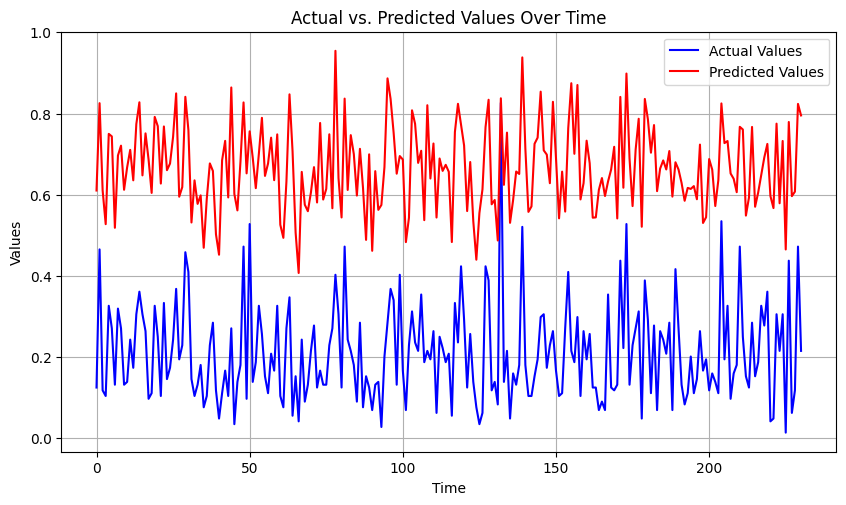

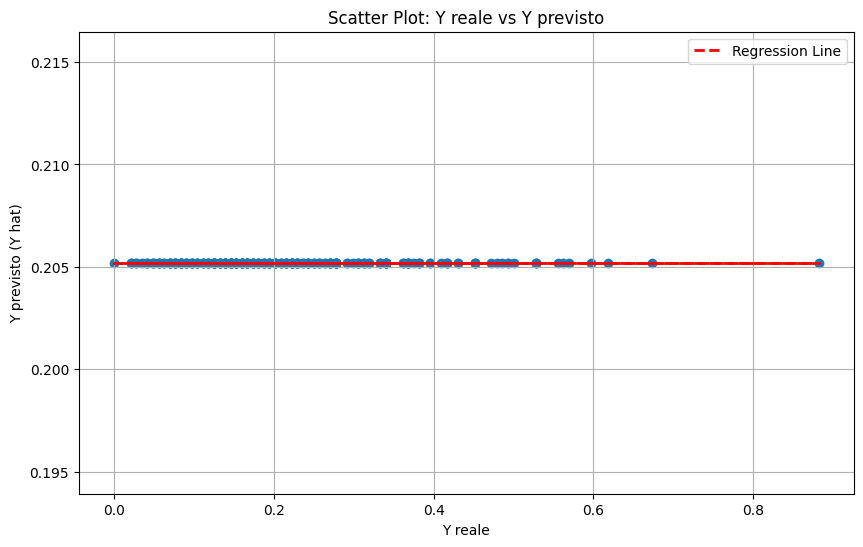

8/8 [==============================] - 0s 9ms/step

Model Completion: 192/144 (133.33%)
Saving data...
8/8 [==============================] - 0s 4ms/step
MAE (Iteration 33): 0.13
R-squared (R2) (Iteration 33): -0.09
RMSE (Iteration 33): 0.14


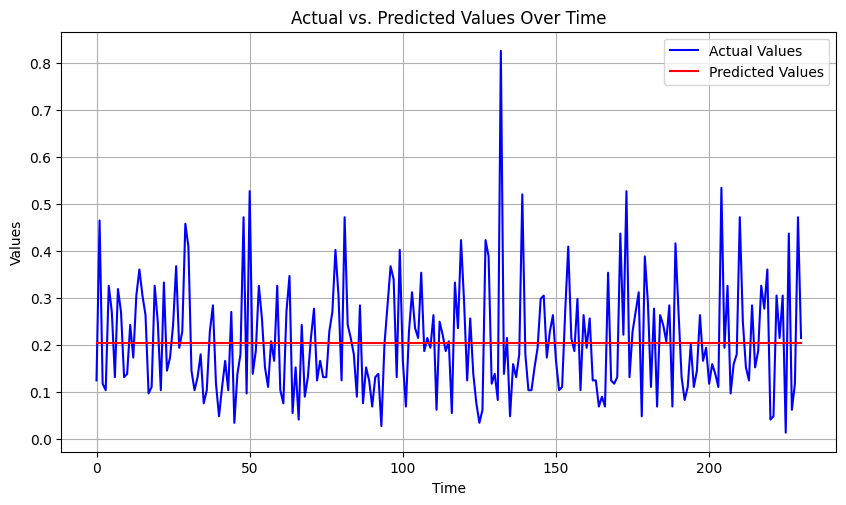

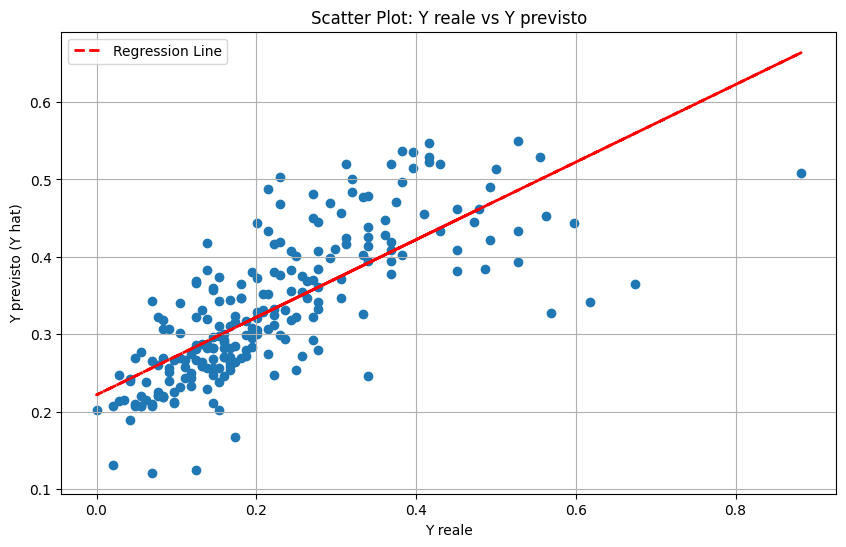

8/8 [==============================] - 0s 6ms/step

Model Completion: 193/144 (134.03%)
Saving data...
8/8 [==============================] - 0s 5ms/step
MAE (Iteration 34): 0.11
R-squared (R2) (Iteration 34): -0.01
RMSE (Iteration 34): 0.14


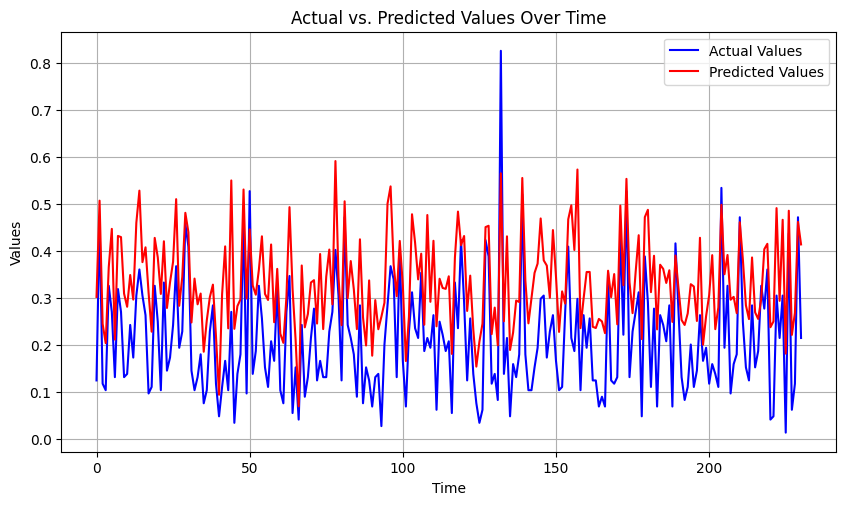

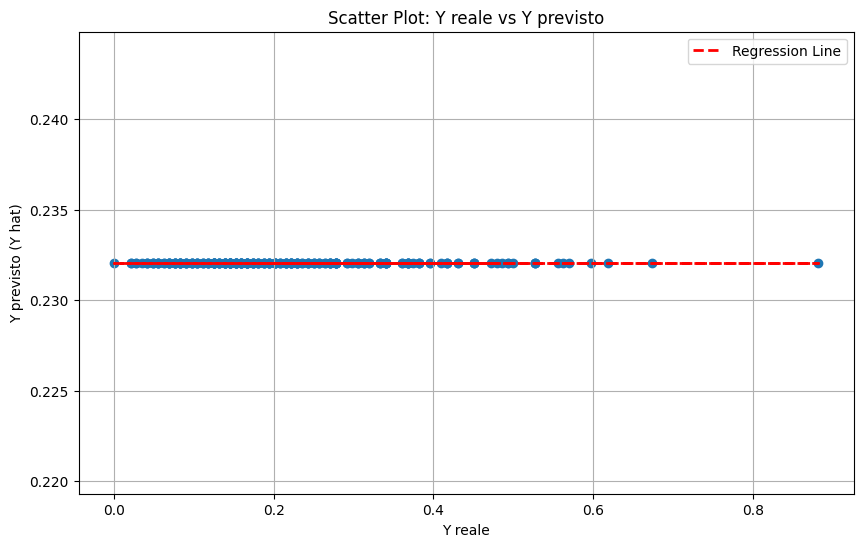

8/8 [==============================] - 0s 4ms/step

Model Completion: 194/144 (134.72%)
Saving data...
8/8 [==============================] - 0s 7ms/step
MAE (Iteration 35): 0.1
R-squared (R2) (Iteration 35): -0.02
RMSE (Iteration 35): 0.14


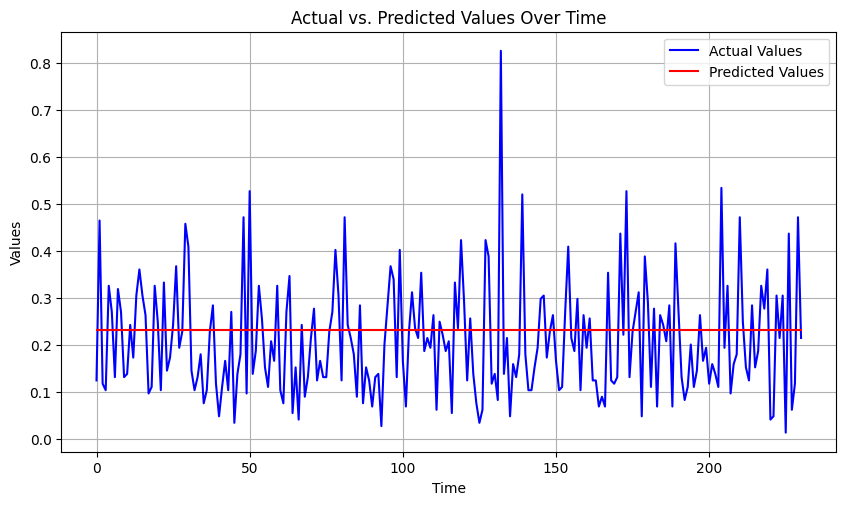

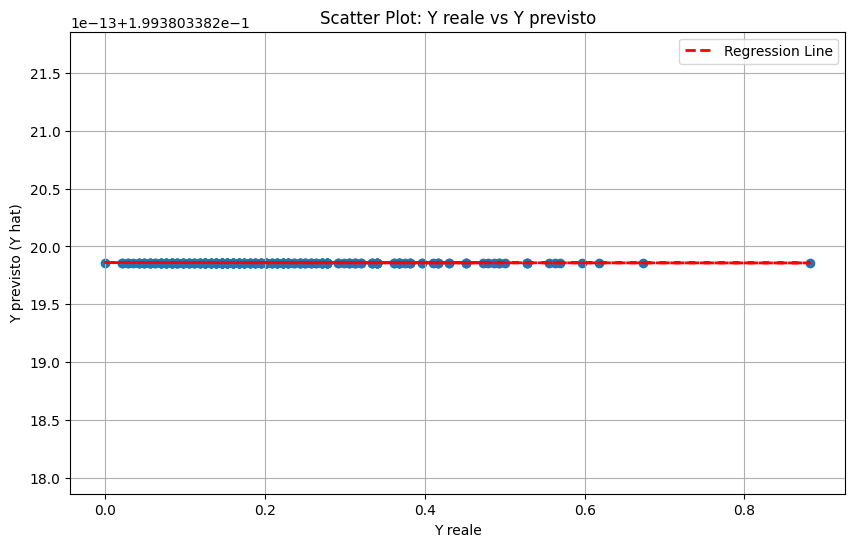

8/8 [==============================] - 0s 7ms/step

Model Completion: 195/144 (135.42%)
Saving data...
8/8 [==============================] - 0s 7ms/step
MAE (Iteration 36): 0.11
R-squared (R2) (Iteration 36): -0.0
RMSE (Iteration 36): 0.14


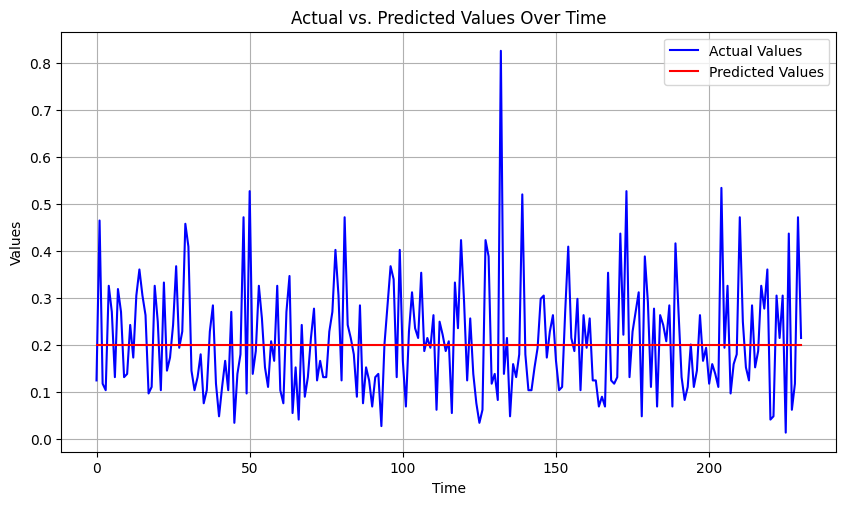

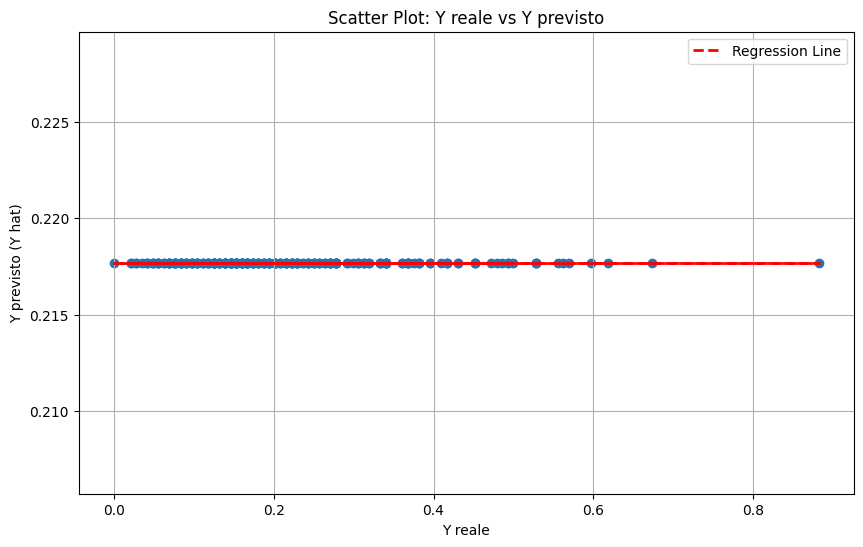

8/8 [==============================] - 0s 6ms/step

Model Completion: 196/144 (136.11%)
Saving data...
8/8 [==============================] - 0s 4ms/step
MAE (Iteration 37): 0.07
R-squared (R2) (Iteration 37): 0.49
RMSE (Iteration 37): 0.1


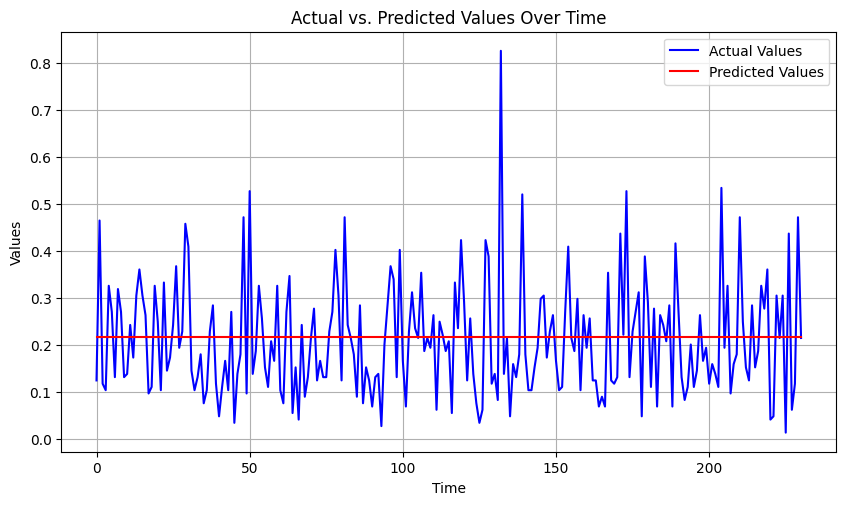

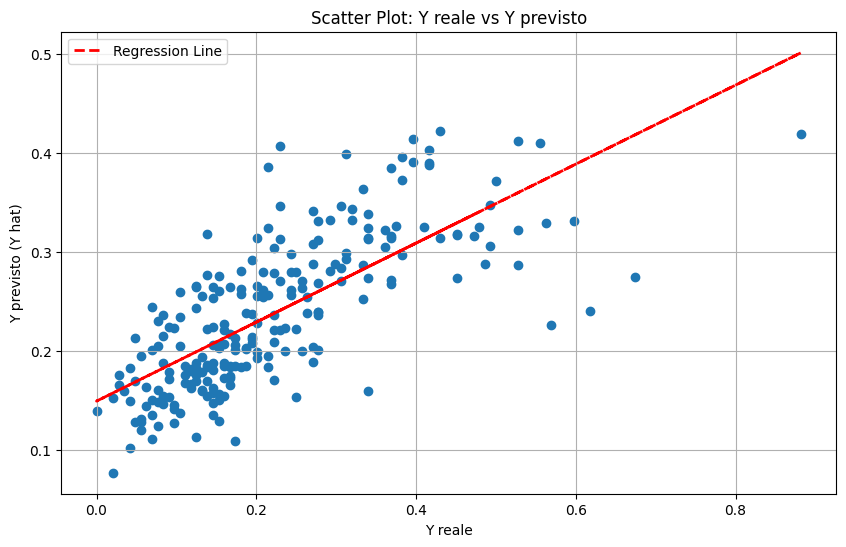

8/8 [==============================] - 0s 4ms/step

Model Completion: 197/144 (136.81%)
Saving data...
8/8 [==============================] - 0s 5ms/step
MAE (Iteration 38): 0.11
R-squared (R2) (Iteration 38): -0.01
RMSE (Iteration 38): 0.14


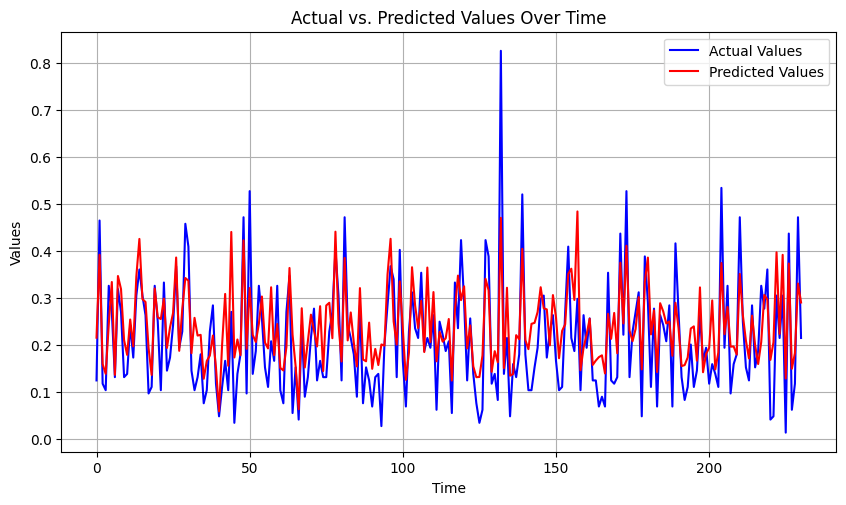

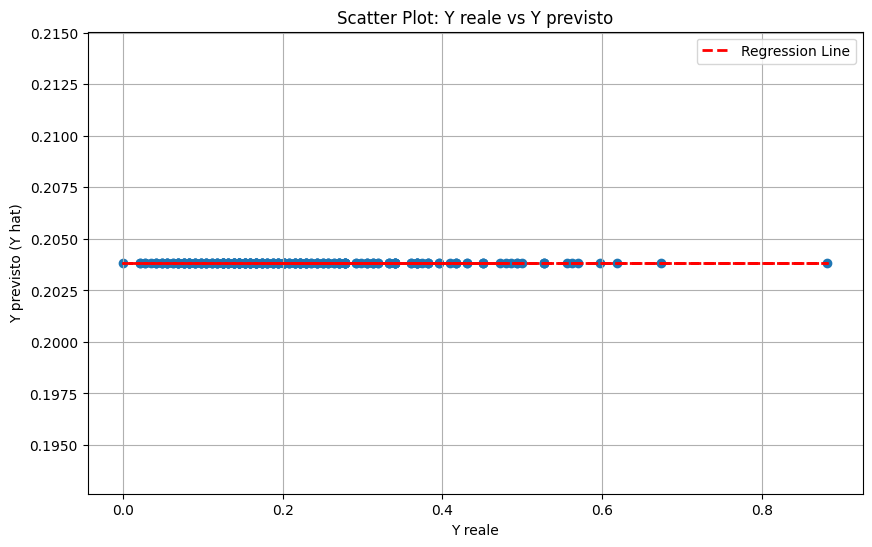

8/8 [==============================] - 0s 4ms/step

Model Completion: 198/144 (137.50%)
Saving data...
8/8 [==============================] - 0s 3ms/step
MAE (Iteration 39): 0.61
R-squared (R2) (Iteration 39): -19.08
RMSE (Iteration 39): 0.62


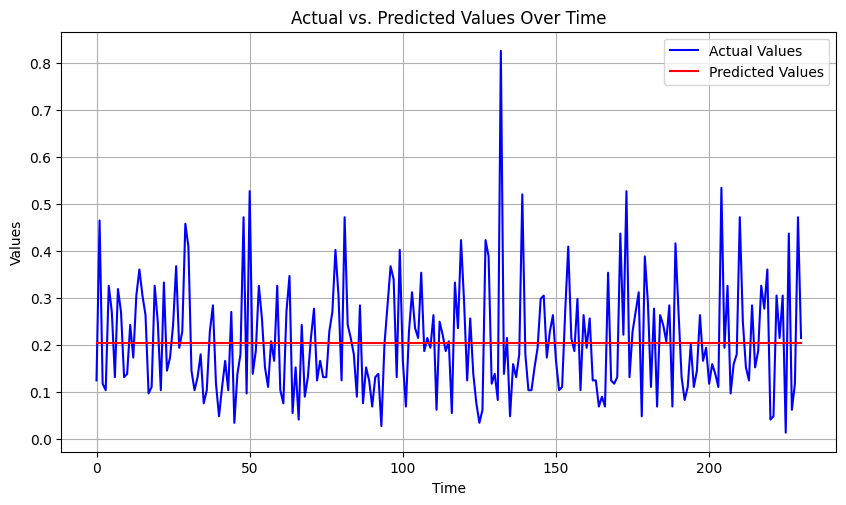

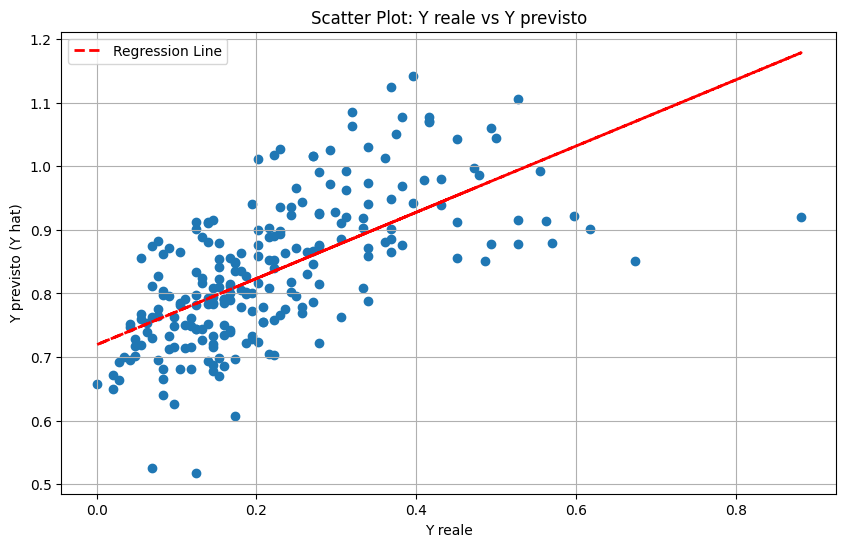

8/8 [==============================] - 0s 3ms/step

Model Completion: 199/144 (138.19%)
Saving data...
8/8 [==============================] - 0s 8ms/step
MAE (Iteration 40): 0.1
R-squared (R2) (Iteration 40): -0.02
RMSE (Iteration 40): 0.14


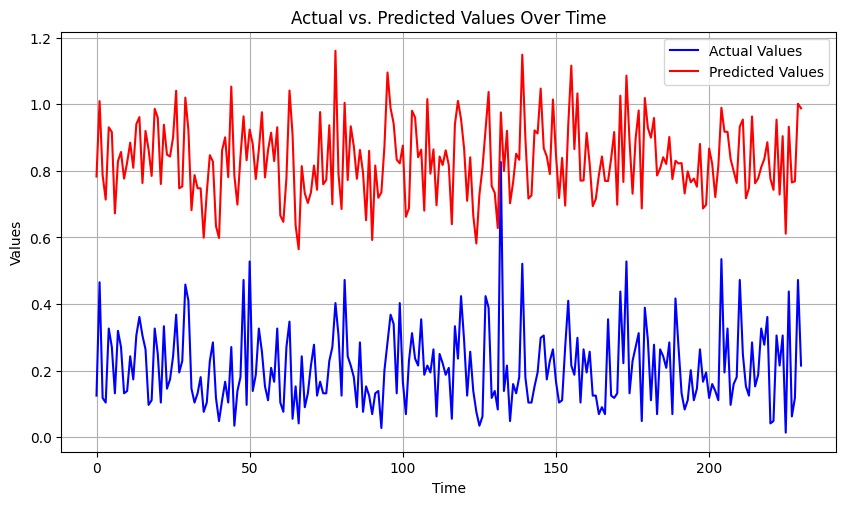

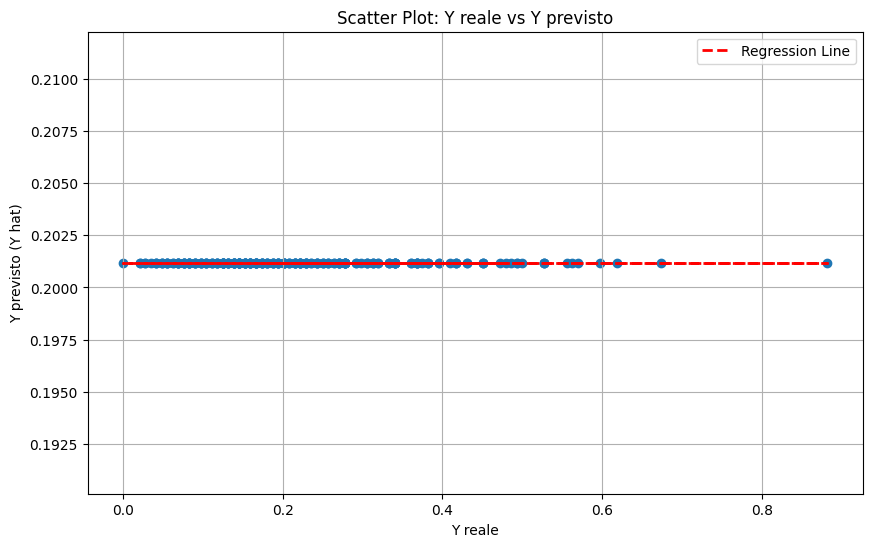

8/8 [==============================] - 0s 5ms/step

Model Completion: 200/144 (138.89%)
Saving data...

Best Model Metrics (Number of Epochs: 300 ):
Best MAE: inf
Best R-squared (R2): -inf
Best RMSE: inf
Number of Epochs: 400
Number of Iterations: 10
8/8 [==============================] - 0s 5ms/step
MAE (Iteration 1): 0.11
R-squared (R2) (Iteration 1): -0.0
RMSE (Iteration 1): 0.14


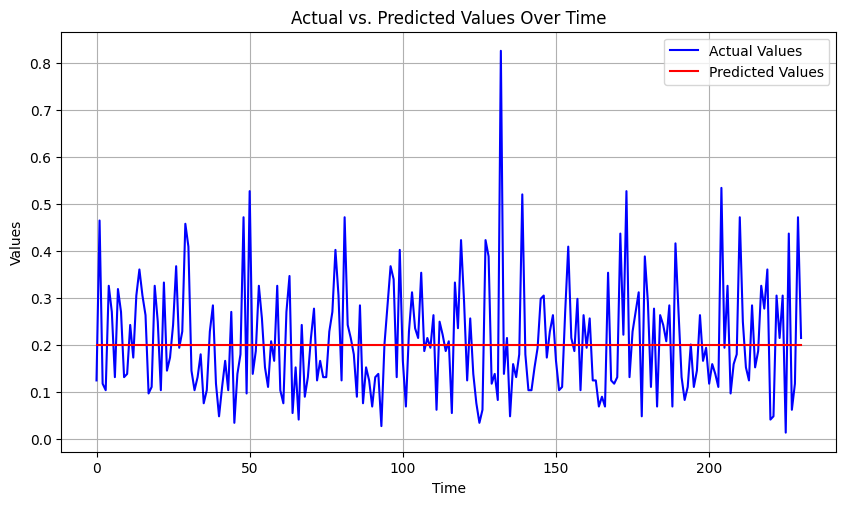

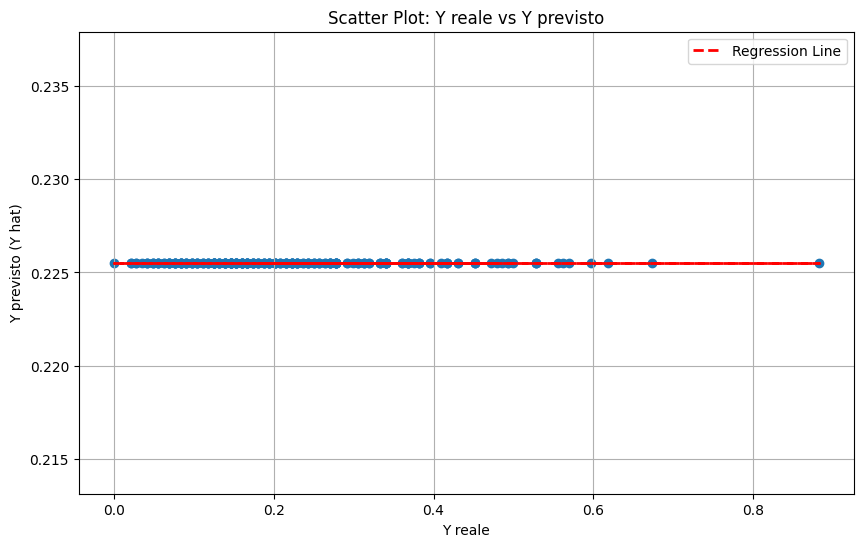

8/8 [==============================] - 0s 4ms/step

Model Completion: 201/144 (139.58%)
Saving data...
8/8 [==============================] - 0s 5ms/step
MAE (Iteration 2): 0.1
R-squared (R2) (Iteration 2): -0.06
RMSE (Iteration 2): 0.14


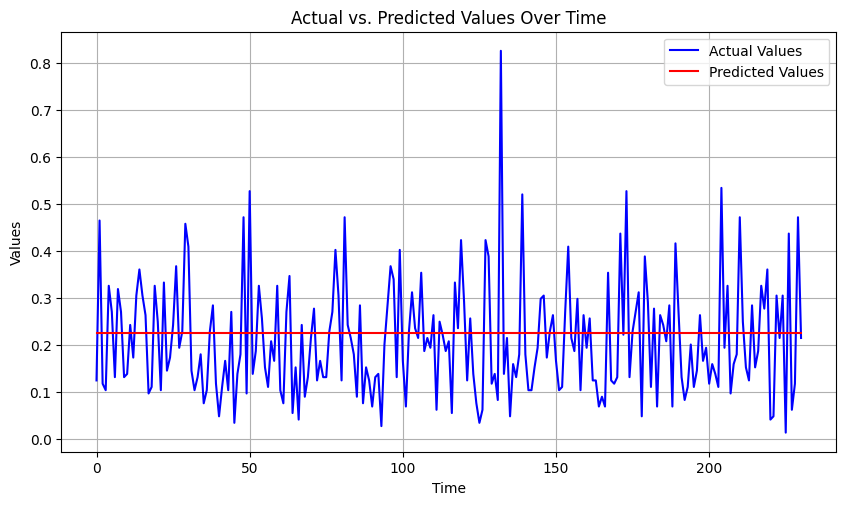

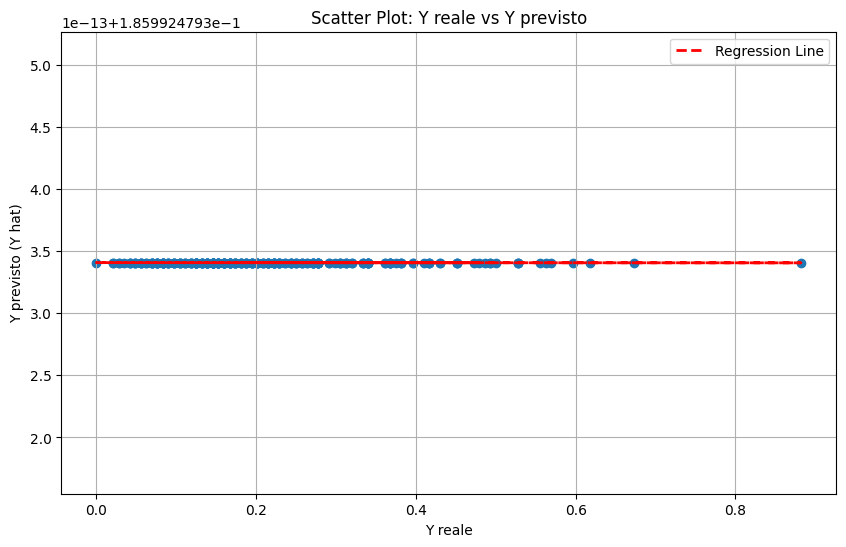

8/8 [==============================] - 0s 9ms/step

Model Completion: 202/144 (140.28%)
Saving data...
8/8 [==============================] - 0s 4ms/step
MAE (Iteration 3): 0.44
R-squared (R2) (Iteration 3): -9.36
RMSE (Iteration 3): 0.45


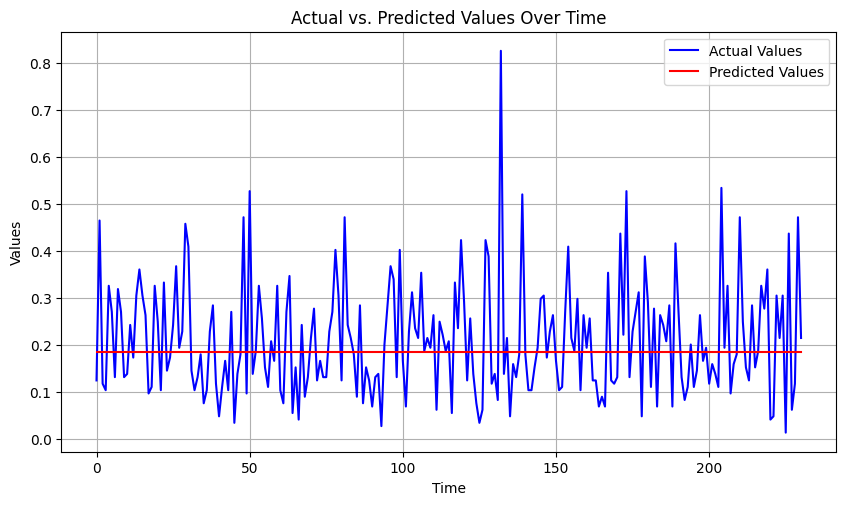

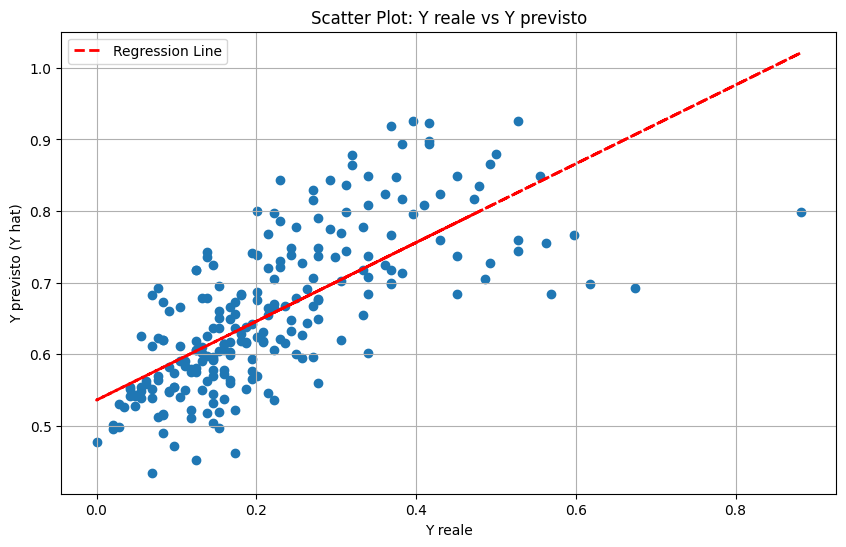

8/8 [==============================] - 0s 3ms/step

Model Completion: 203/144 (140.97%)
Saving data...
8/8 [==============================] - 0s 3ms/step
MAE (Iteration 4): 0.12
R-squared (R2) (Iteration 4): -0.05
RMSE (Iteration 4): 0.14


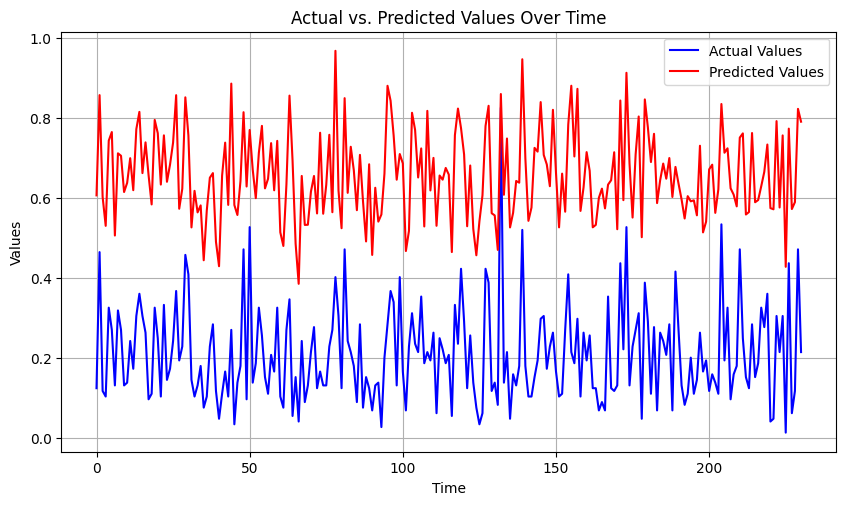

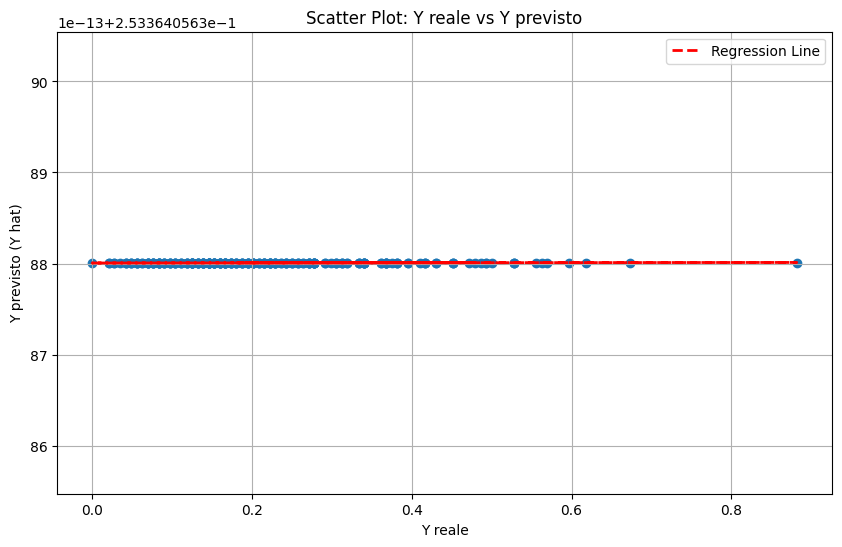

8/8 [==============================] - 0s 5ms/step

Model Completion: 204/144 (141.67%)
Saving data...
8/8 [==============================] - 0s 6ms/step
MAE (Iteration 5): 0.1
R-squared (R2) (Iteration 5): -0.02
RMSE (Iteration 5): 0.14


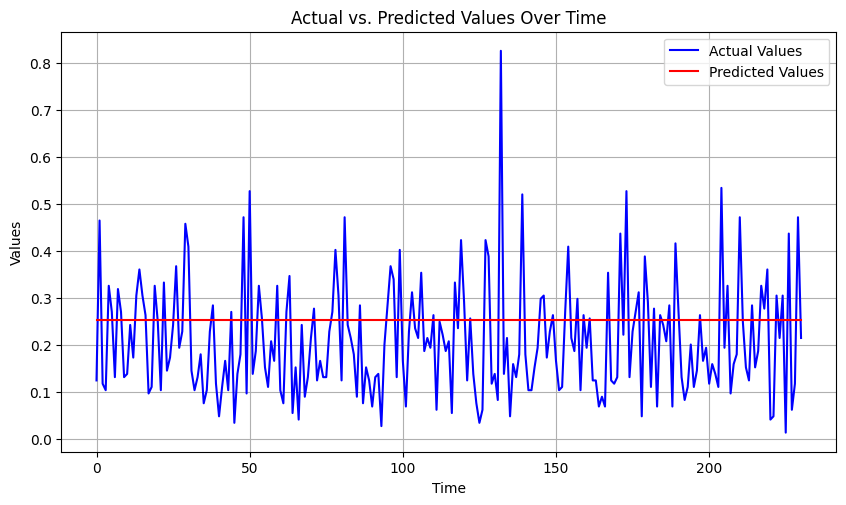

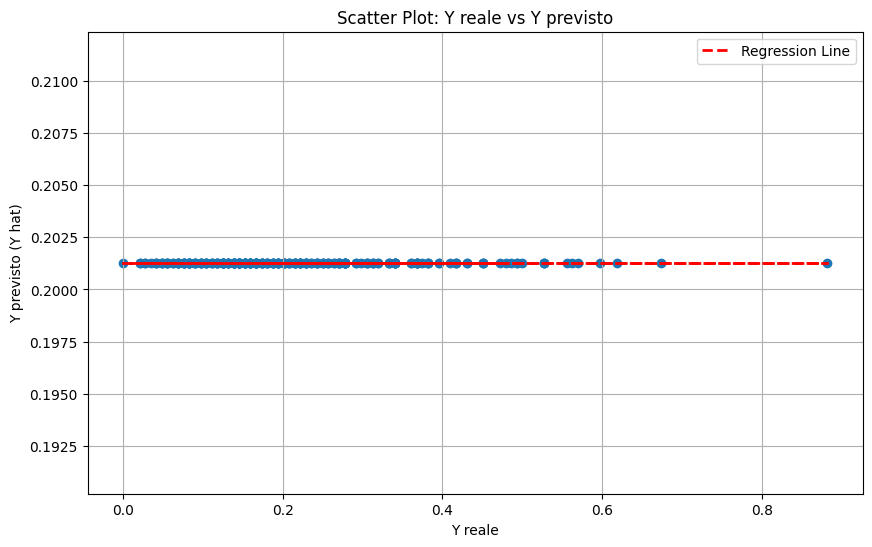

8/8 [==============================] - 0s 6ms/step

Model Completion: 205/144 (142.36%)
Saving data...
8/8 [==============================] - 0s 6ms/step
MAE (Iteration 6): 0.11
R-squared (R2) (Iteration 6): -0.01
RMSE (Iteration 6): 0.14


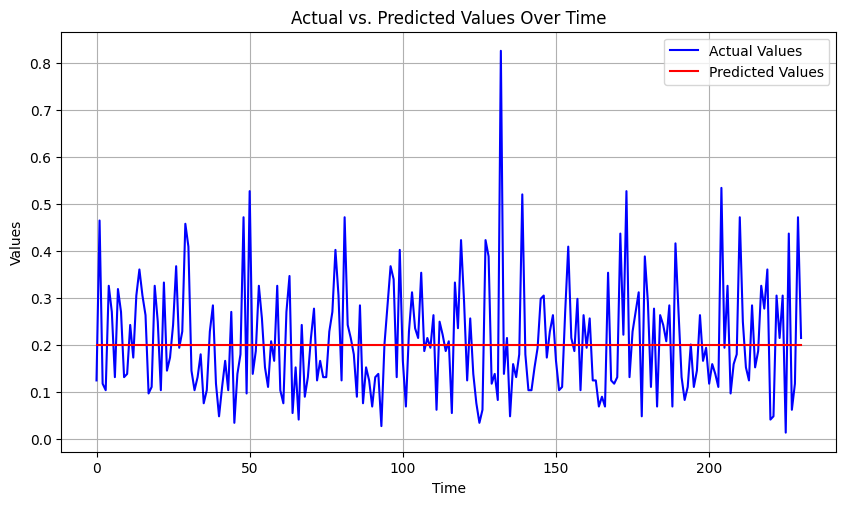

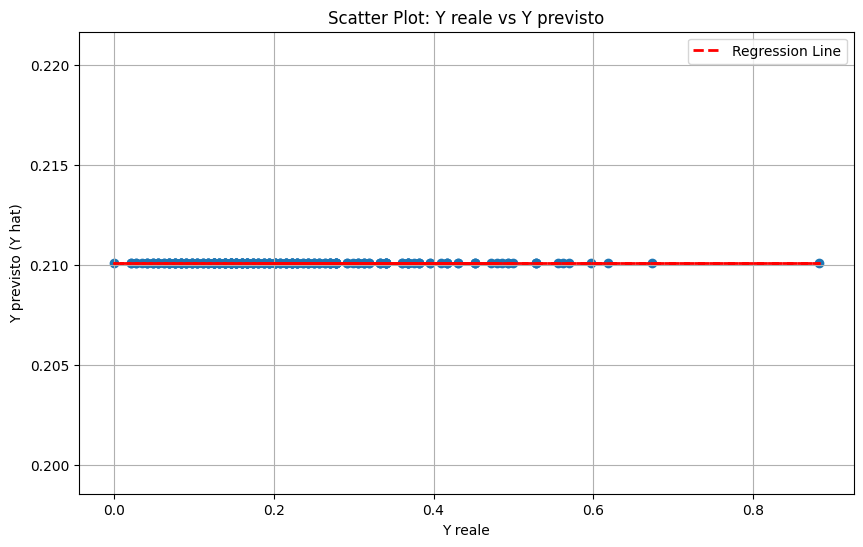

8/8 [==============================] - 0s 6ms/step

Model Completion: 206/144 (143.06%)
Saving data...
8/8 [==============================] - 0s 4ms/step
MAE (Iteration 7): 0.34
R-squared (R2) (Iteration 7): -5.39
RMSE (Iteration 7): 0.35


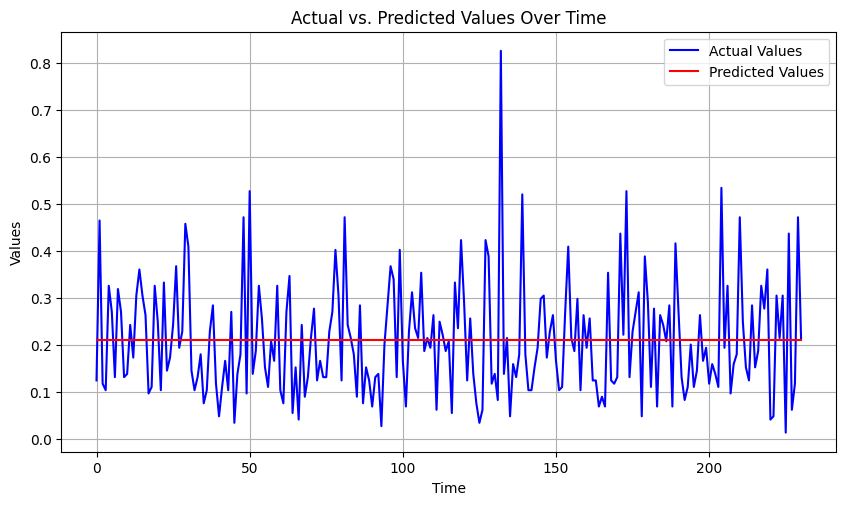

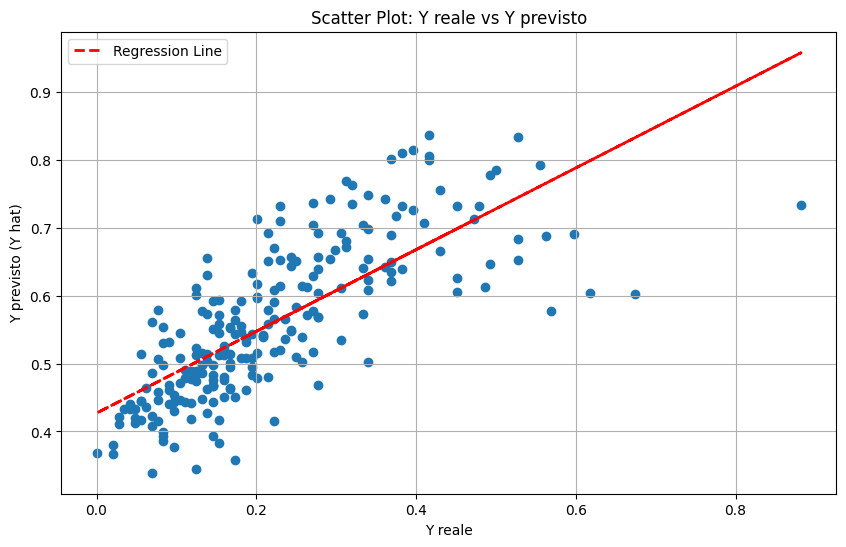

8/8 [==============================] - 0s 4ms/step

Model Completion: 207/144 (143.75%)
Saving data...
8/8 [==============================] - 0s 5ms/step
MAE (Iteration 8): 0.11
R-squared (R2) (Iteration 8): -0.0
RMSE (Iteration 8): 0.14


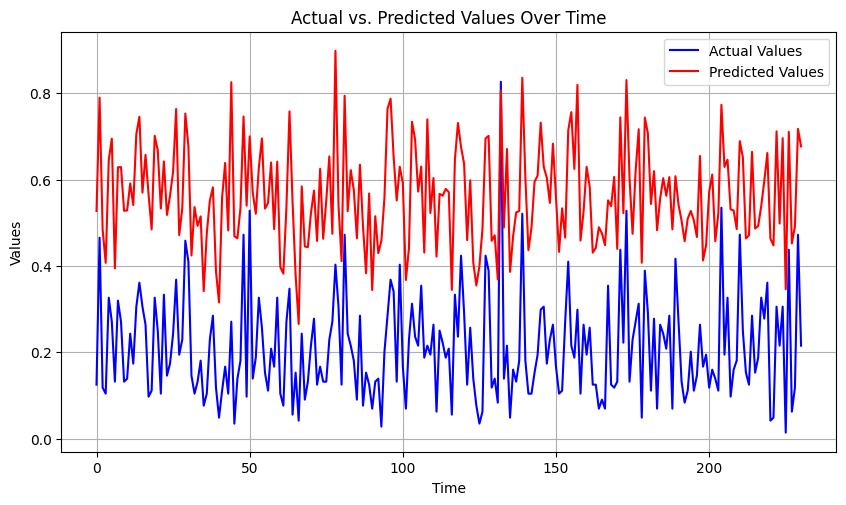

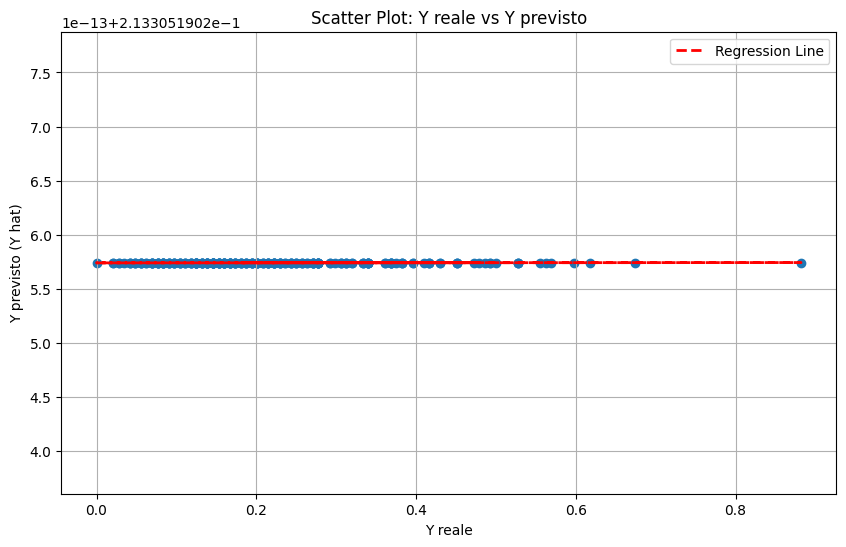

8/8 [==============================] - 0s 4ms/step

Model Completion: 208/144 (144.44%)
Saving data...
8/8 [==============================] - 0s 4ms/step
MAE (Iteration 9): 0.12
R-squared (R2) (Iteration 9): -0.06
RMSE (Iteration 9): 0.14


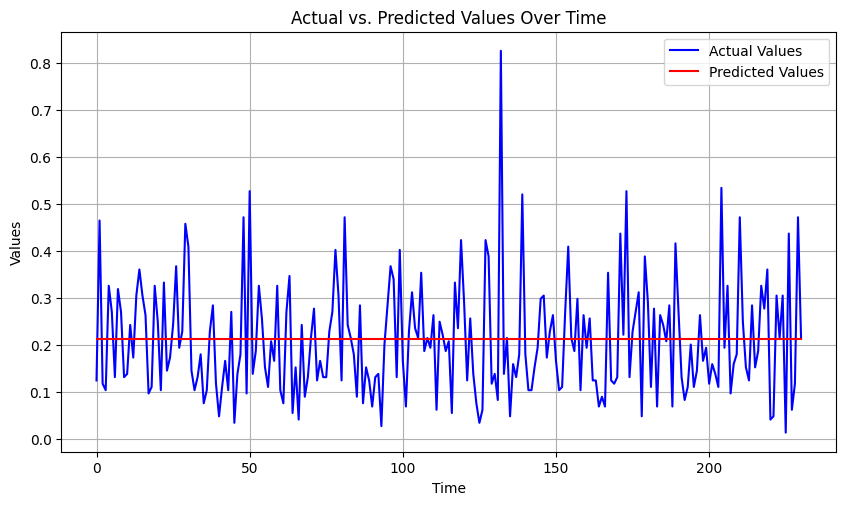

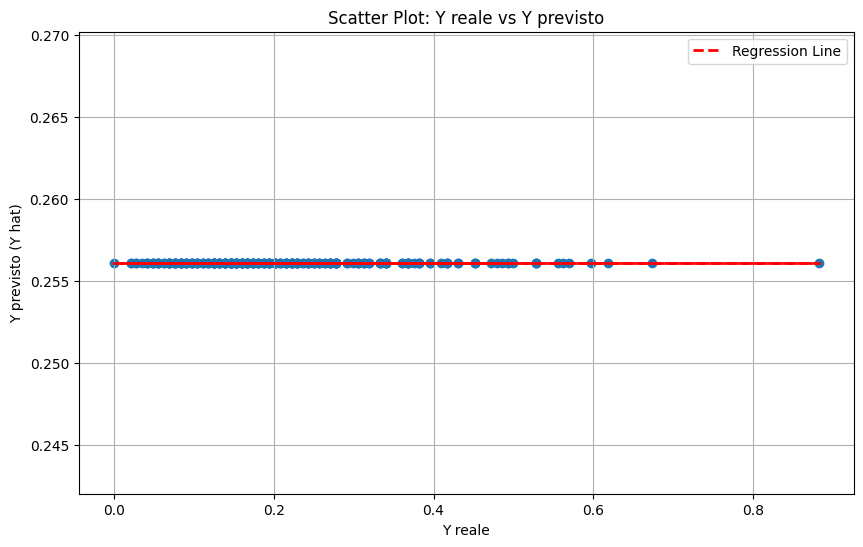

8/8 [==============================] - 0s 4ms/step

Model Completion: 209/144 (145.14%)
Saving data...
8/8 [==============================] - 0s 6ms/step
MAE (Iteration 10): 0.48
R-squared (R2) (Iteration 10): -11.52
RMSE (Iteration 10): 0.49


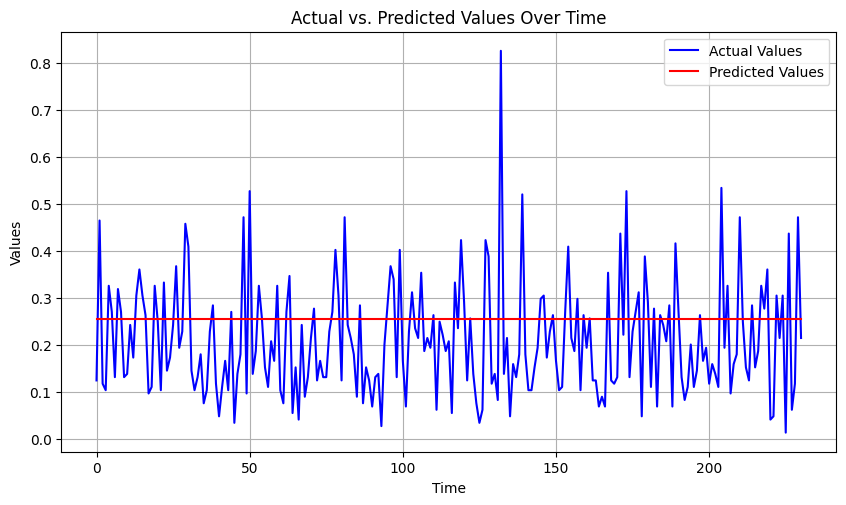

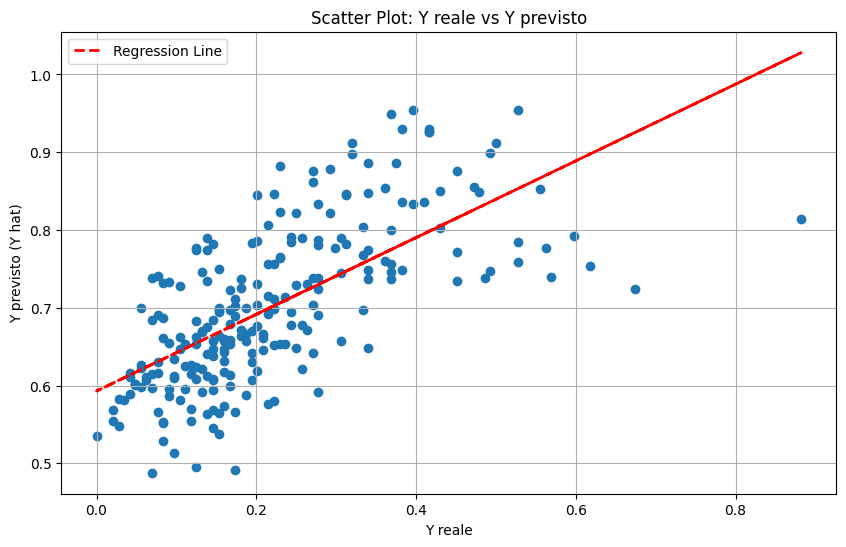

8/8 [==============================] - 0s 3ms/step

Model Completion: 210/144 (145.83%)
Saving data...
Number of Iterations: 20
8/8 [==============================] - 0s 4ms/step
MAE (Iteration 1): 0.1
R-squared (R2) (Iteration 1): -0.02
RMSE (Iteration 1): 0.14


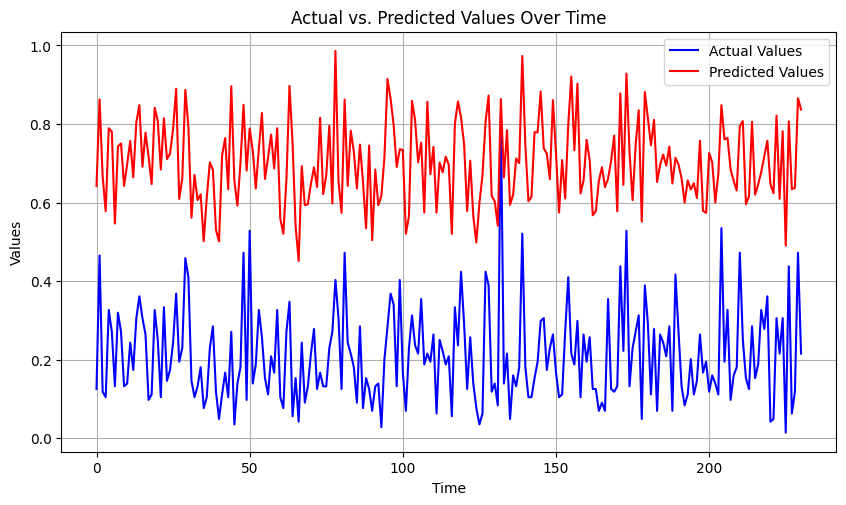

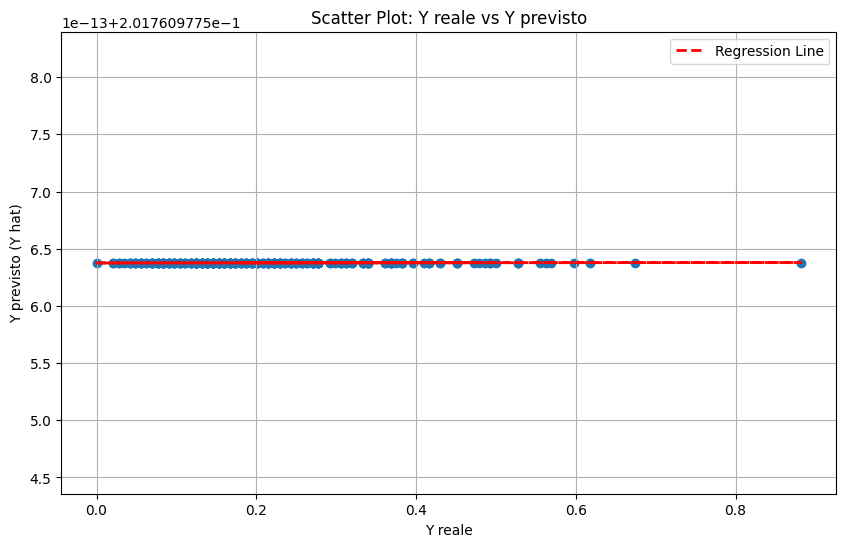

8/8 [==============================] - 0s 4ms/step

Model Completion: 211/144 (146.53%)
Saving data...
8/8 [==============================] - 0s 7ms/step
MAE (Iteration 2): 0.11
R-squared (R2) (Iteration 2): -0.02
RMSE (Iteration 2): 0.14


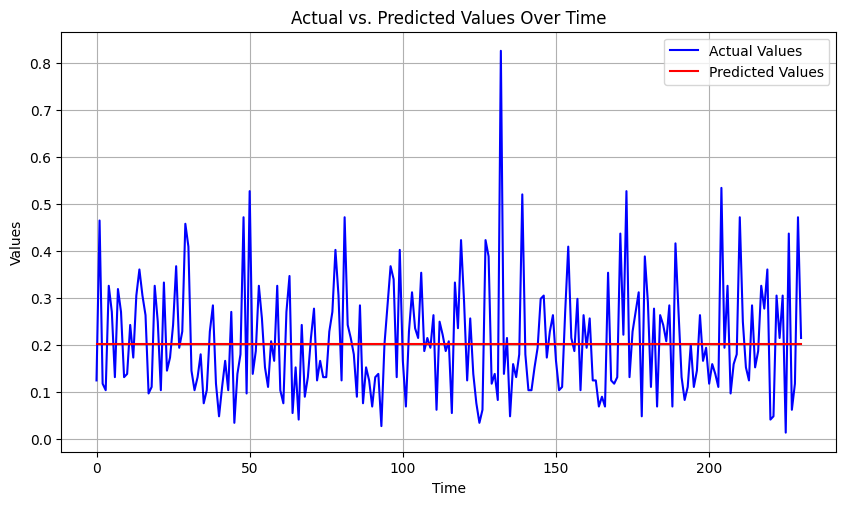

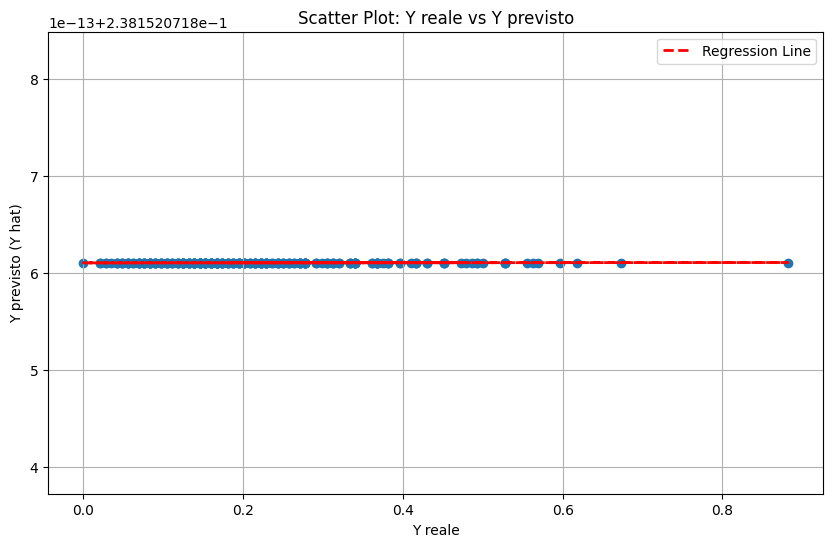

8/8 [==============================] - 0s 5ms/step

Model Completion: 212/144 (147.22%)
Saving data...
8/8 [==============================] - 0s 4ms/step
MAE (Iteration 3): 0.1
R-squared (R2) (Iteration 3): 0.34
RMSE (Iteration 3): 0.11


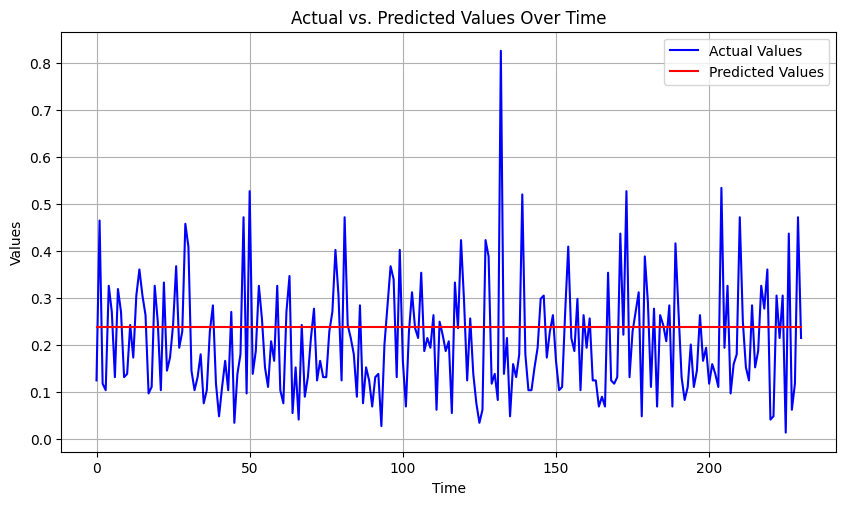

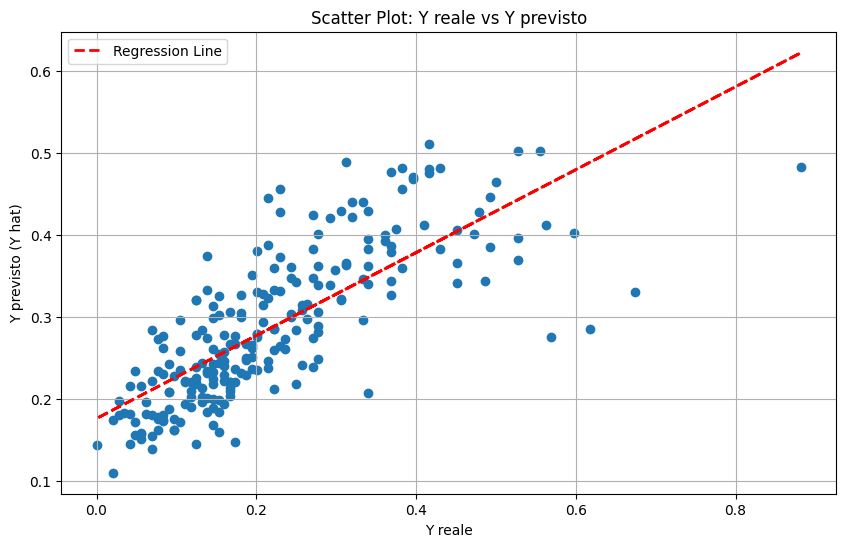

8/8 [==============================] - 0s 5ms/step

Model Completion: 213/144 (147.92%)
Saving data...
8/8 [==============================] - 0s 4ms/step
MAE (Iteration 4): 0.29
R-squared (R2) (Iteration 4): -3.58
RMSE (Iteration 4): 0.3


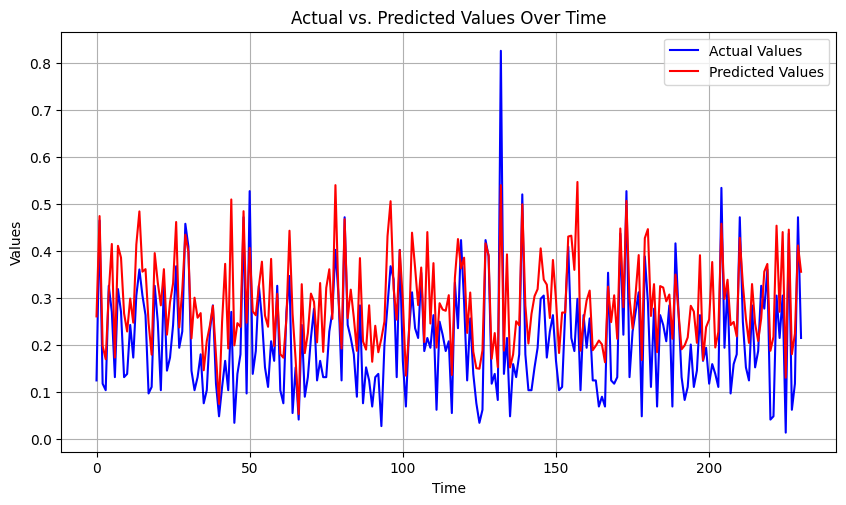

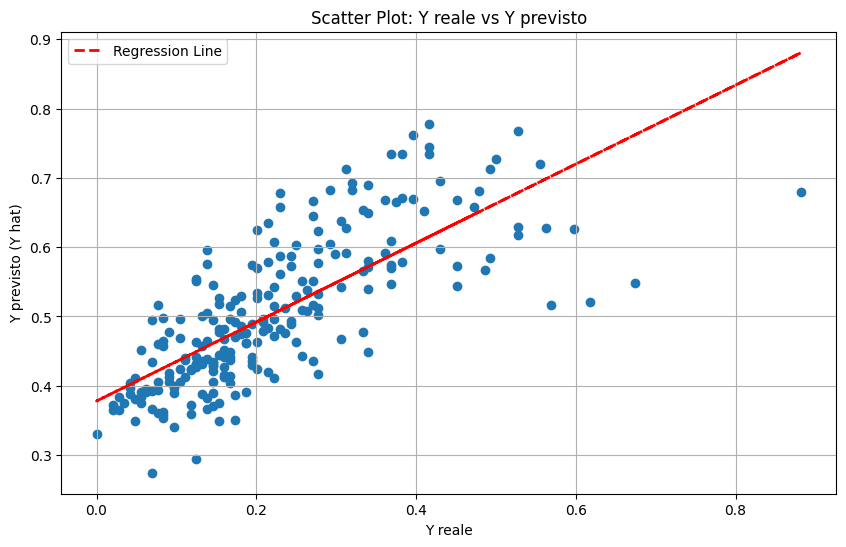

8/8 [==============================] - 0s 4ms/step

Model Completion: 214/144 (148.61%)
Saving data...
8/8 [==============================] - 0s 4ms/step
MAE (Iteration 5): 0.2
R-squared (R2) (Iteration 5): -1.41
RMSE (Iteration 5): 0.22


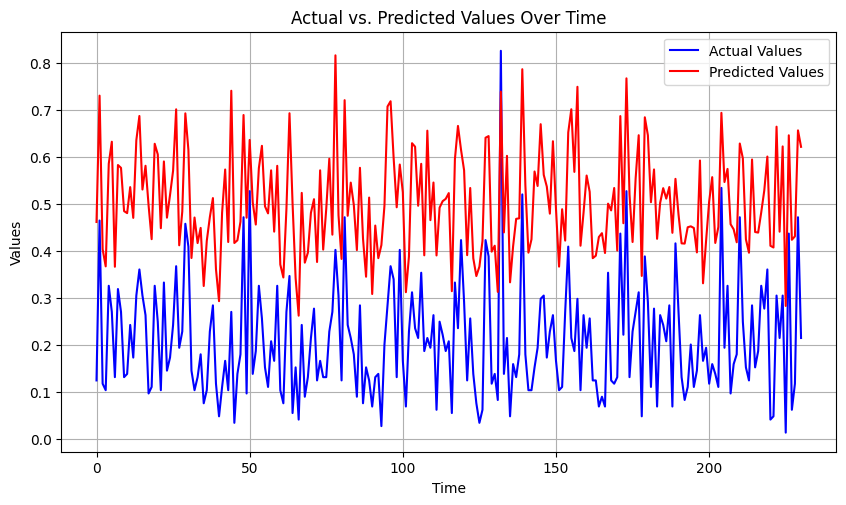

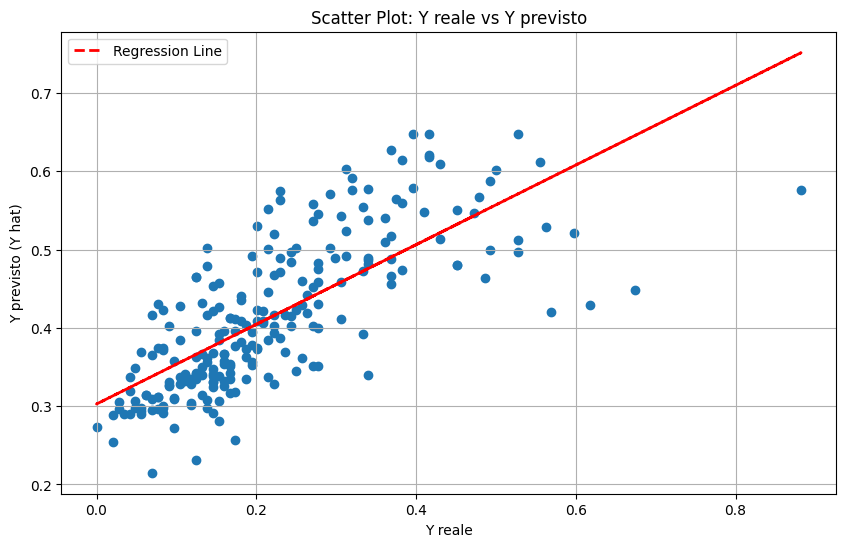

8/8 [==============================] - 0s 5ms/step

Model Completion: 215/144 (149.31%)
Saving data...
8/8 [==============================] - 0s 5ms/step
MAE (Iteration 6): 0.42
R-squared (R2) (Iteration 6): -8.58
RMSE (Iteration 6): 0.43


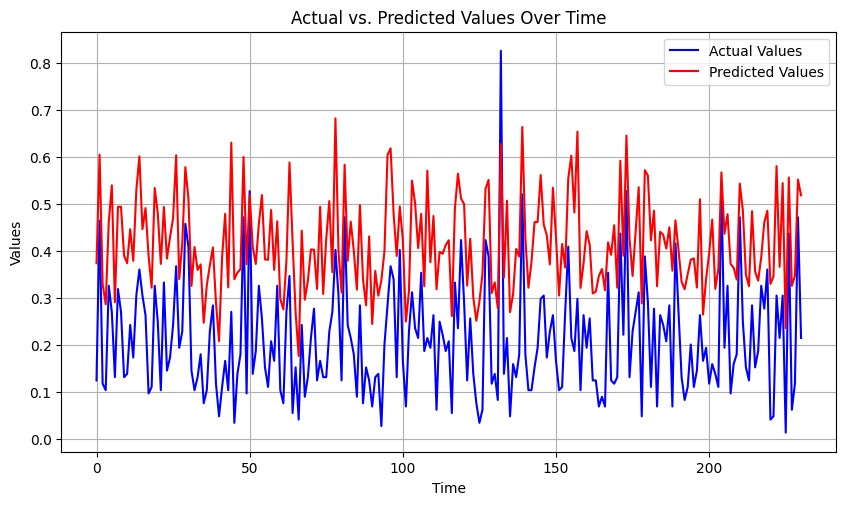

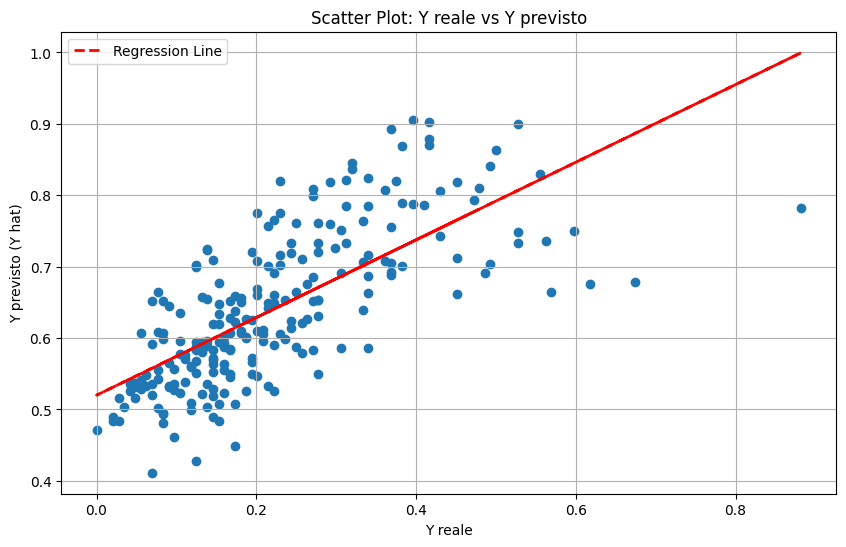

8/8 [==============================] - 0s 6ms/step

Model Completion: 216/144 (150.00%)
Saving data...
8/8 [==============================] - 0s 7ms/step
MAE (Iteration 7): 0.07
R-squared (R2) (Iteration 7): 0.46
RMSE (Iteration 7): 0.1


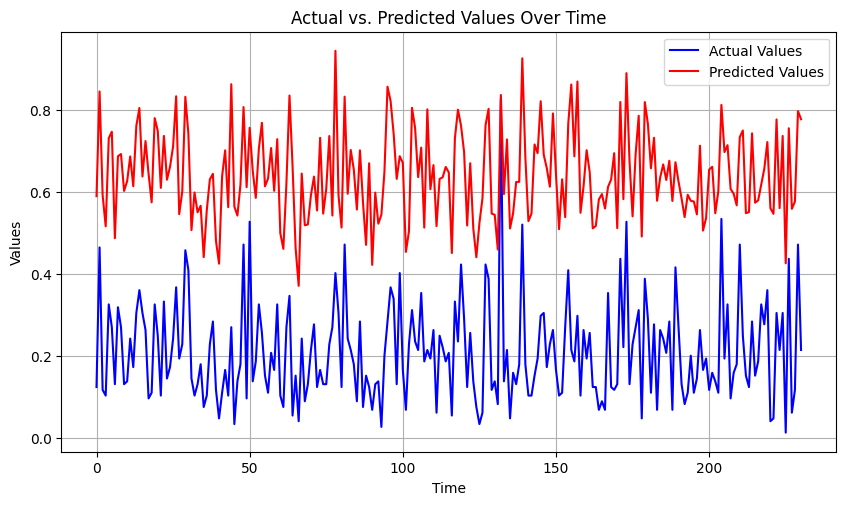

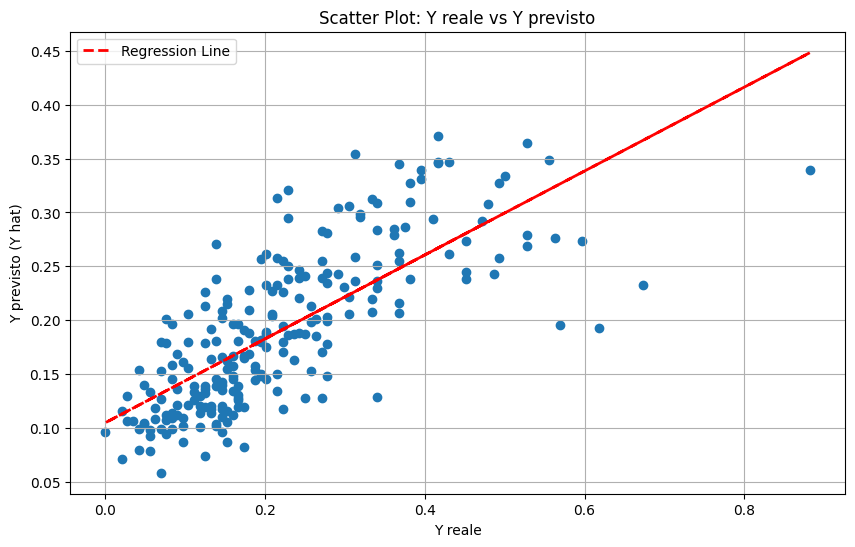

8/8 [==============================] - 0s 6ms/step

Model Completion: 217/144 (150.69%)
Saving data...
8/8 [==============================] - 0s 4ms/step
MAE (Iteration 8): 0.1
R-squared (R2) (Iteration 8): -0.02
RMSE (Iteration 8): 0.14


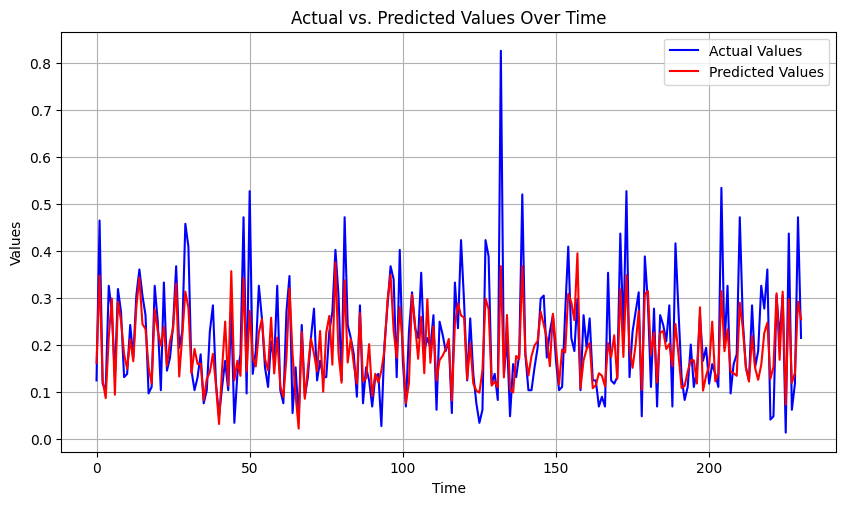

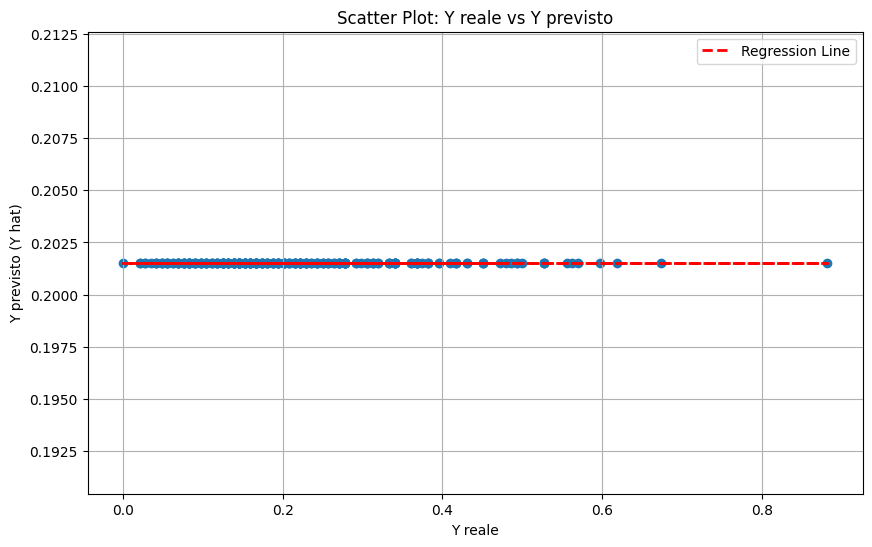

8/8 [==============================] - 0s 4ms/step

Model Completion: 218/144 (151.39%)
Saving data...
8/8 [==============================] - 0s 6ms/step
MAE (Iteration 9): 0.08
R-squared (R2) (Iteration 9): 0.32
RMSE (Iteration 9): 0.11


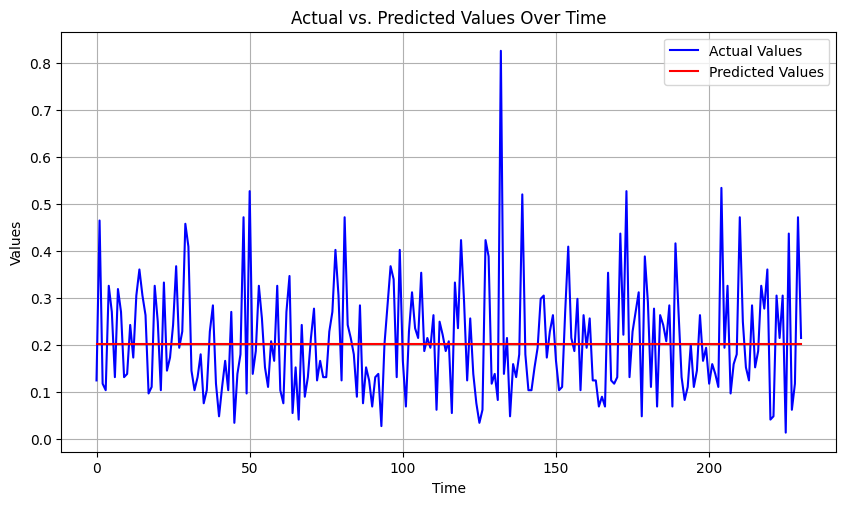

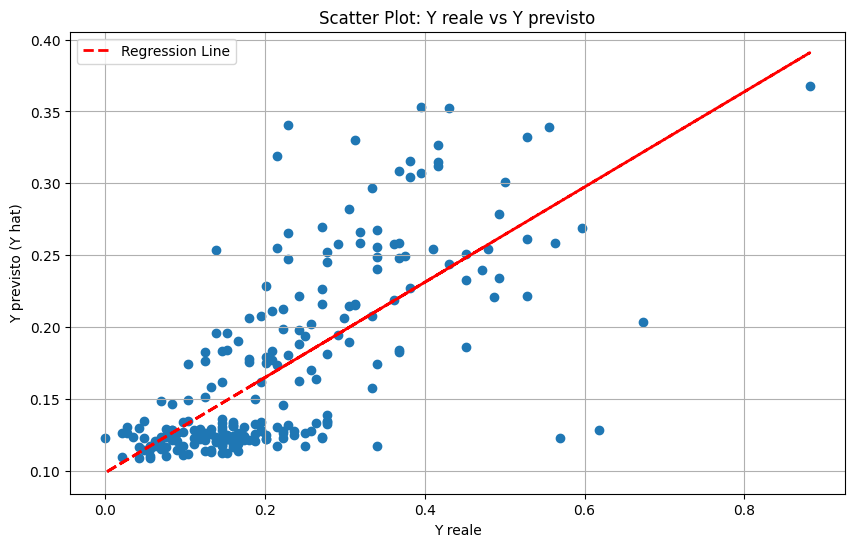

8/8 [==============================] - 0s 6ms/step

Model Completion: 219/144 (152.08%)
Saving data...
8/8 [==============================] - 0s 6ms/step
MAE (Iteration 10): 0.31
R-squared (R2) (Iteration 10): -4.43
RMSE (Iteration 10): 0.32


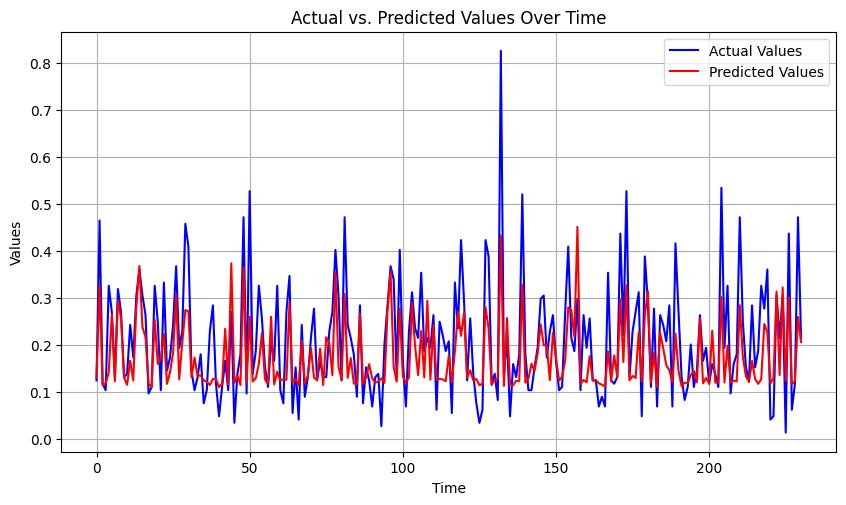

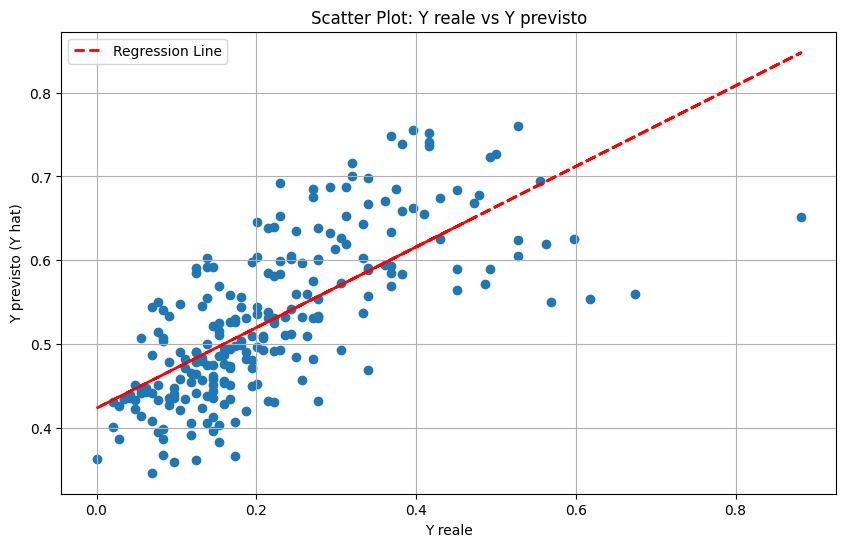

8/8 [==============================] - 0s 4ms/step

Model Completion: 220/144 (152.78%)
Saving data...
8/8 [==============================] - 0s 4ms/step
MAE (Iteration 11): 0.24
R-squared (R2) (Iteration 11): -2.24
RMSE (Iteration 11): 0.25


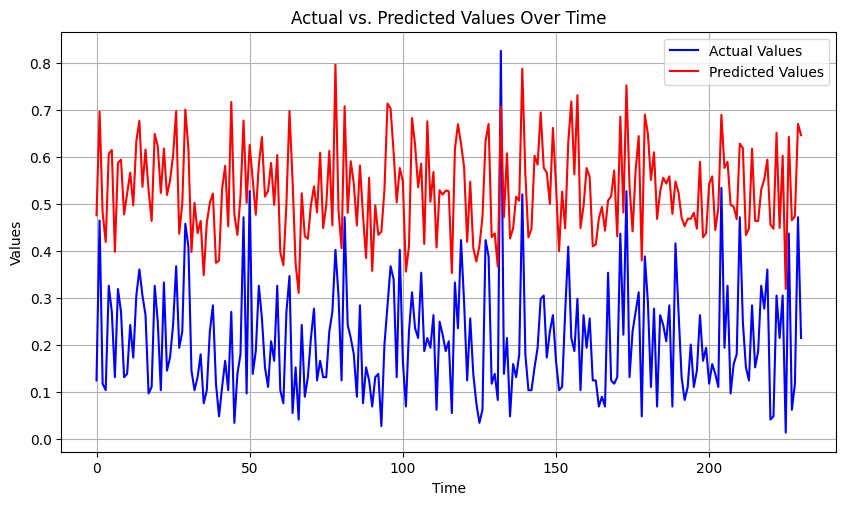

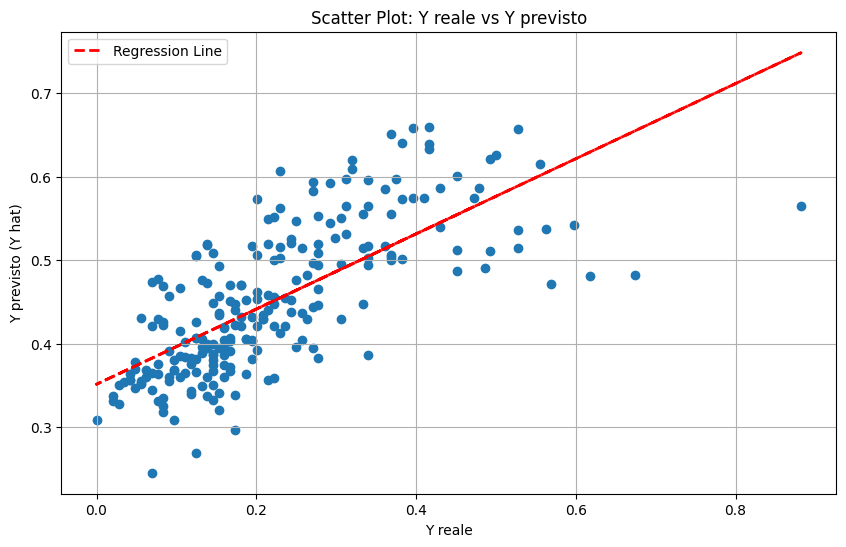

8/8 [==============================] - 0s 4ms/step

Model Completion: 221/144 (153.47%)
Saving data...
8/8 [==============================] - 0s 4ms/step
MAE (Iteration 12): 0.27
R-squared (R2) (Iteration 12): -3.06
RMSE (Iteration 12): 0.28


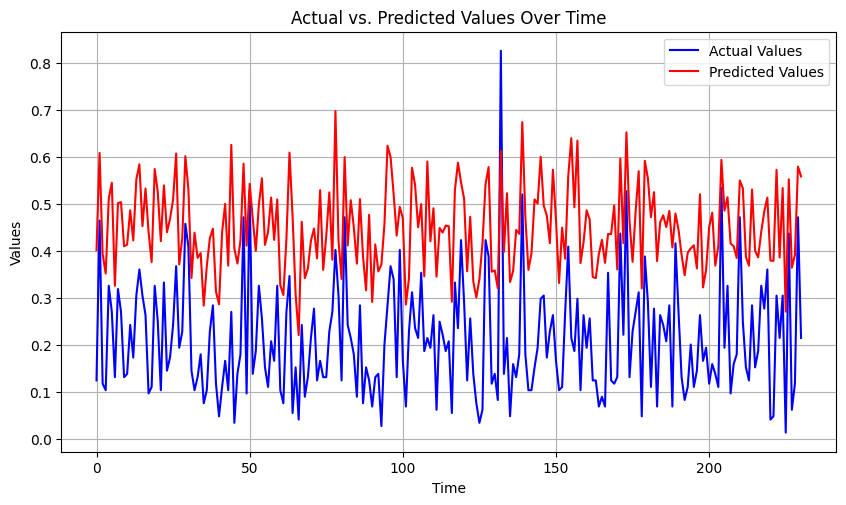

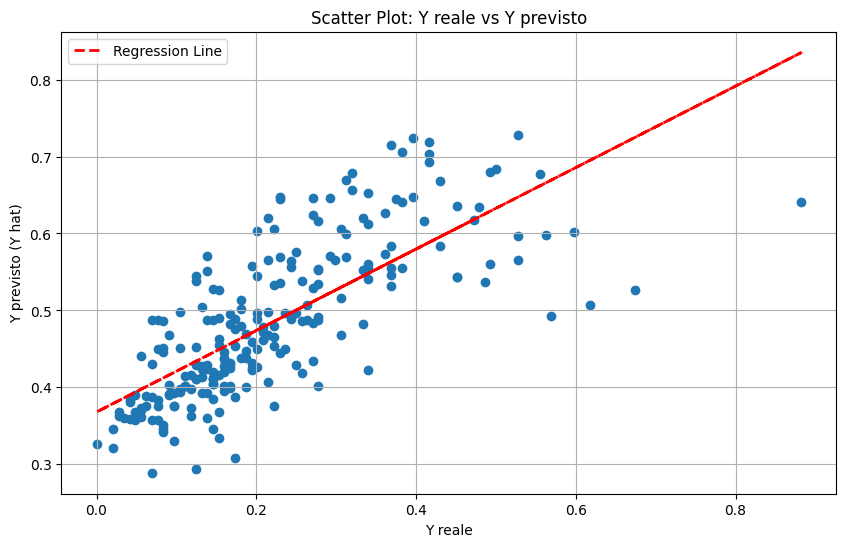

8/8 [==============================] - 0s 7ms/step

Model Completion: 222/144 (154.17%)
Saving data...
8/8 [==============================] - 0s 3ms/step
MAE (Iteration 13): 0.11
R-squared (R2) (Iteration 13): -0.0
RMSE (Iteration 13): 0.14


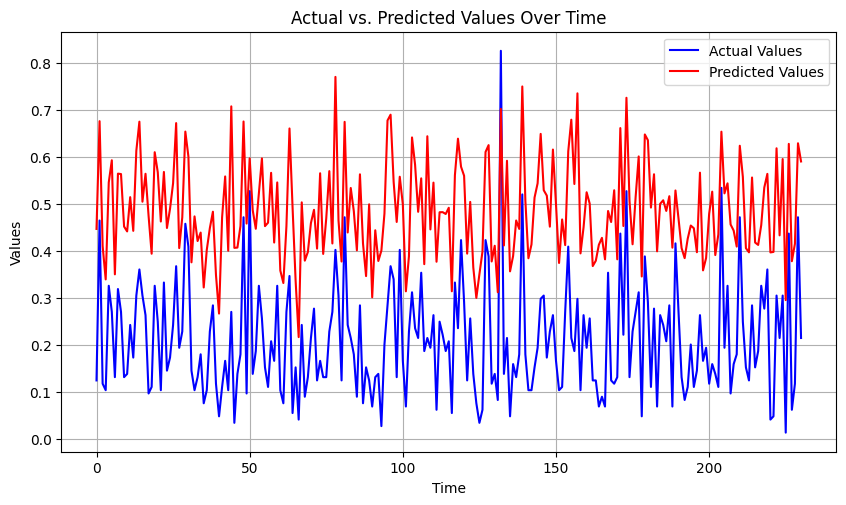

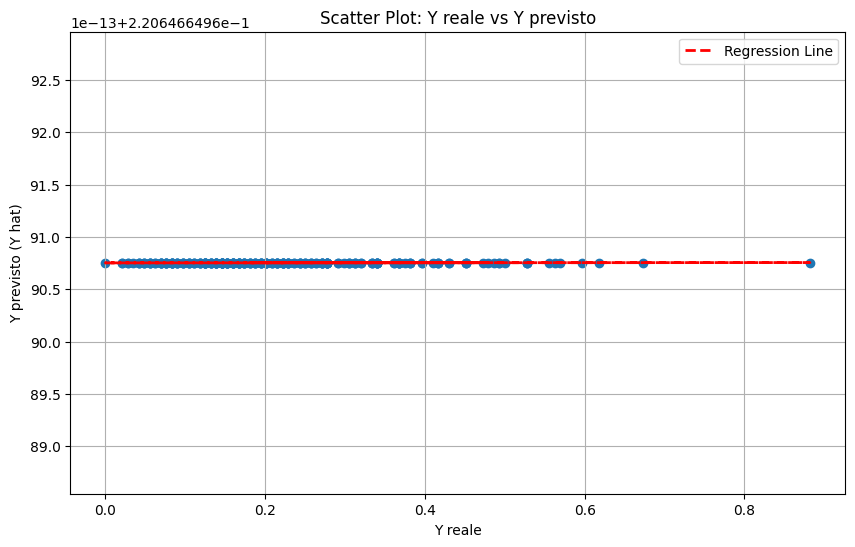

8/8 [==============================] - 0s 4ms/step

Model Completion: 223/144 (154.86%)
Saving data...
8/8 [==============================] - 0s 4ms/step
MAE (Iteration 14): 0.11
R-squared (R2) (Iteration 14): -0.04
RMSE (Iteration 14): 0.14


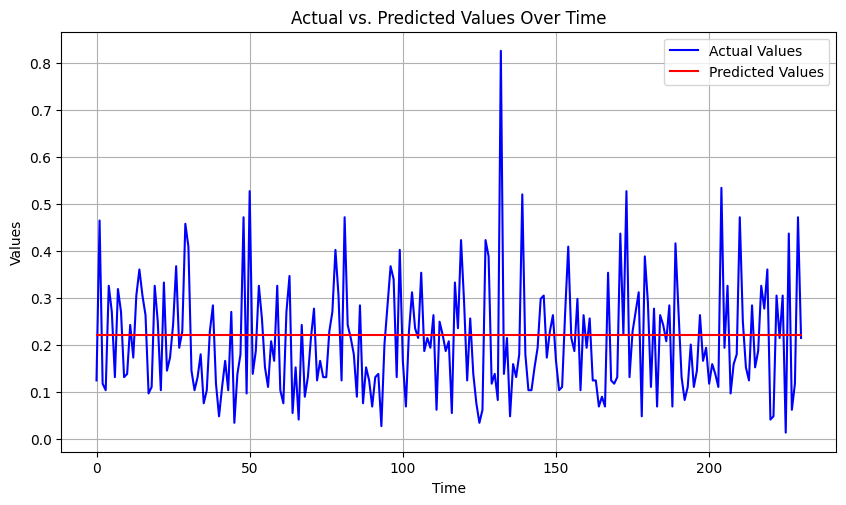

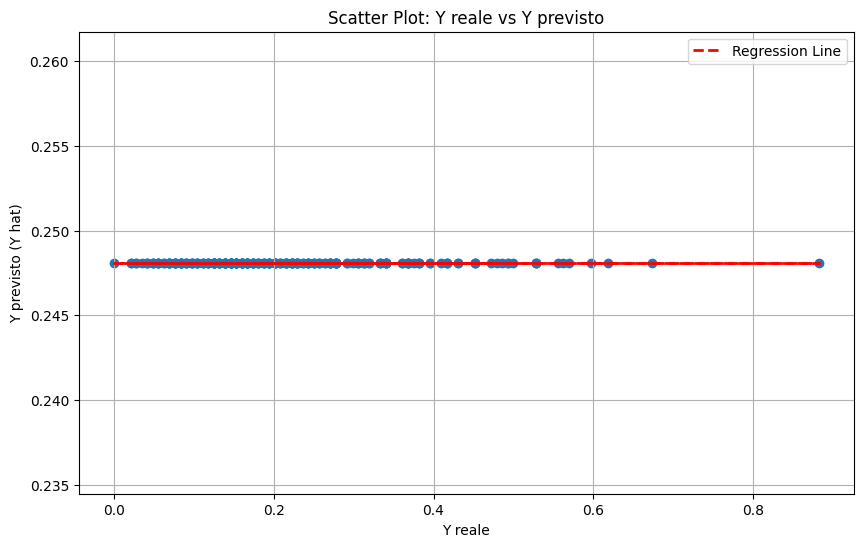

8/8 [==============================] - 0s 5ms/step

Model Completion: 224/144 (155.56%)
Saving data...
8/8 [==============================] - 0s 6ms/step
MAE (Iteration 15): 0.11
R-squared (R2) (Iteration 15): -0.0
RMSE (Iteration 15): 0.14


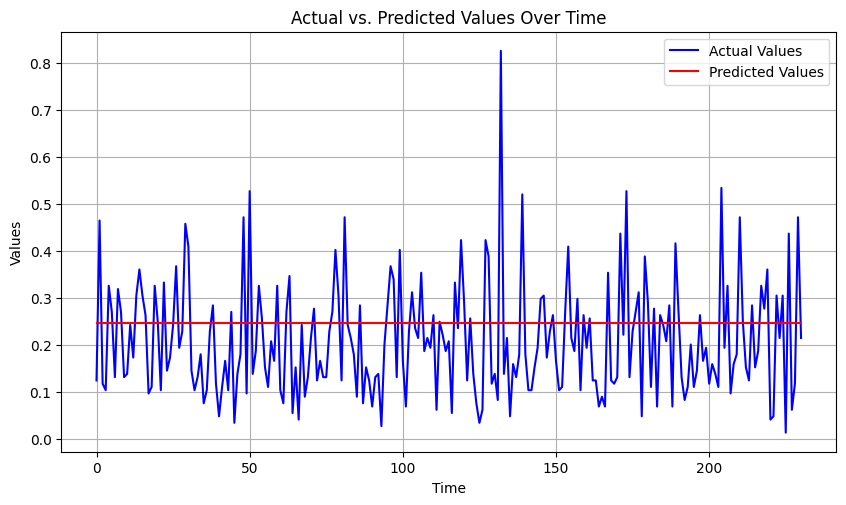

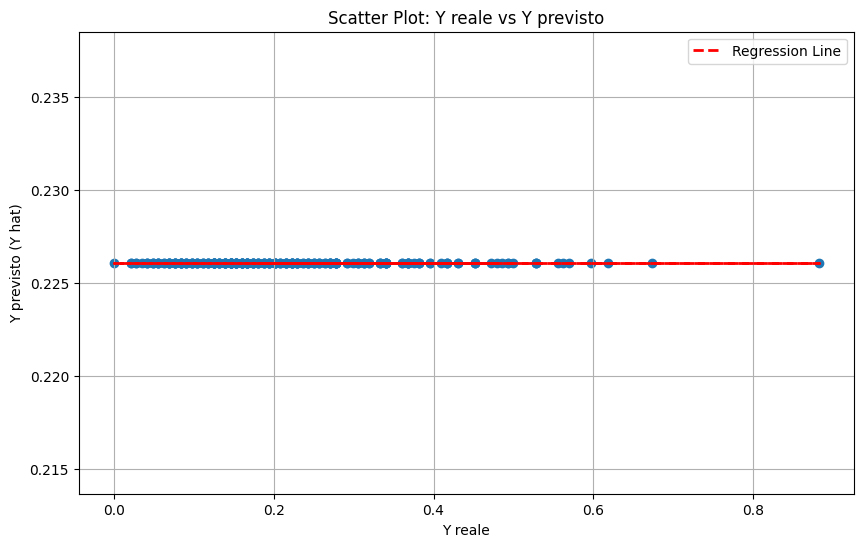

8/8 [==============================] - 0s 6ms/step

Model Completion: 225/144 (156.25%)
Saving data...
8/8 [==============================] - 0s 3ms/step
MAE (Iteration 16): 0.11
R-squared (R2) (Iteration 16): -0.03
RMSE (Iteration 16): 0.14


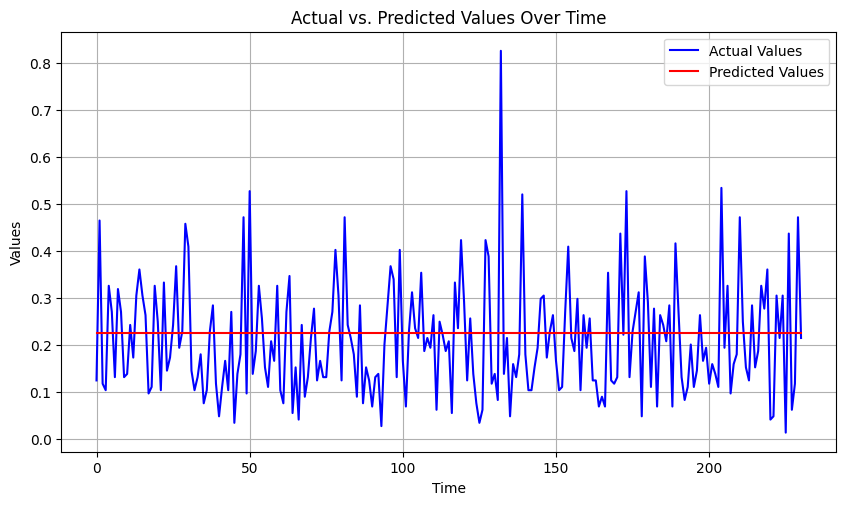

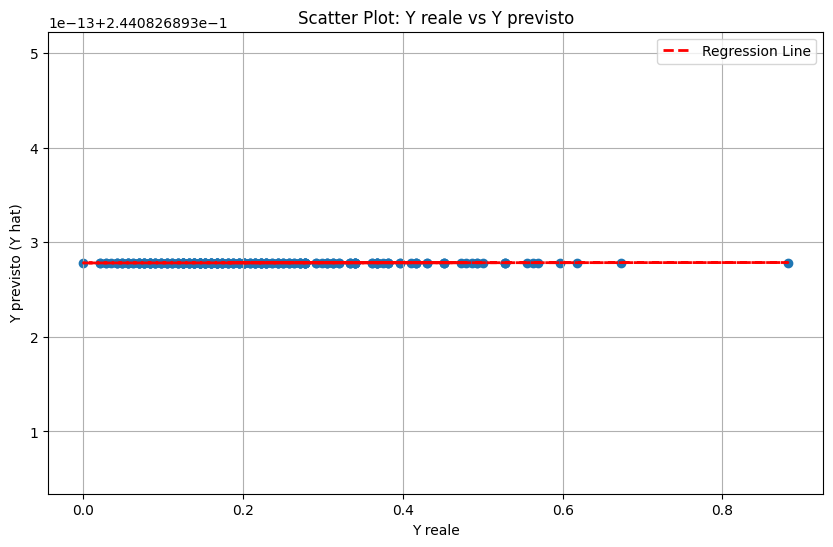

8/8 [==============================] - 0s 3ms/step

Model Completion: 226/144 (156.94%)
Saving data...
8/8 [==============================] - 0s 9ms/step
MAE (Iteration 17): 0.12
R-squared (R2) (Iteration 17): -0.05
RMSE (Iteration 17): 0.14


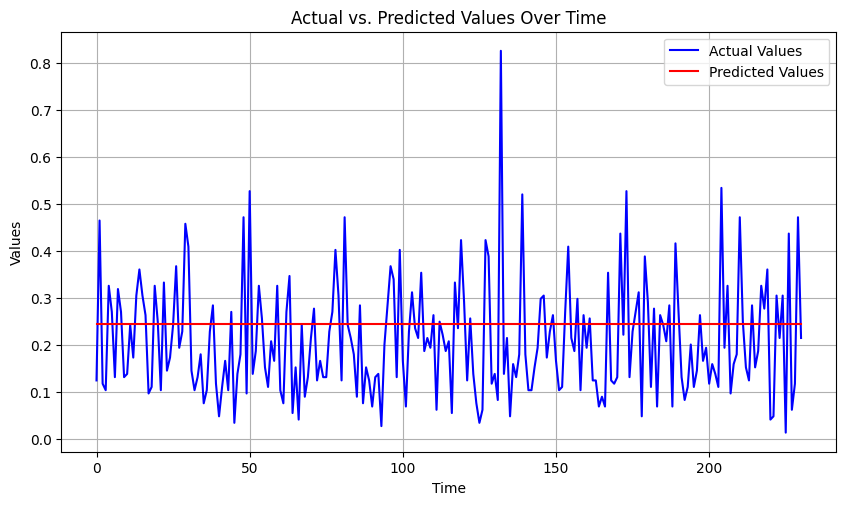

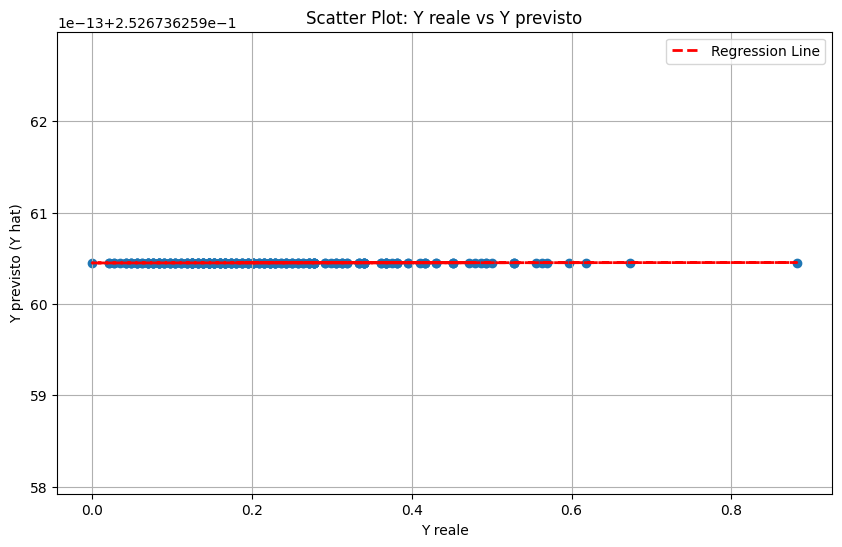

8/8 [==============================] - 0s 7ms/step

Model Completion: 227/144 (157.64%)
Saving data...
8/8 [==============================] - 0s 5ms/step
MAE (Iteration 18): 0.38
R-squared (R2) (Iteration 18): -6.95
RMSE (Iteration 18): 0.39


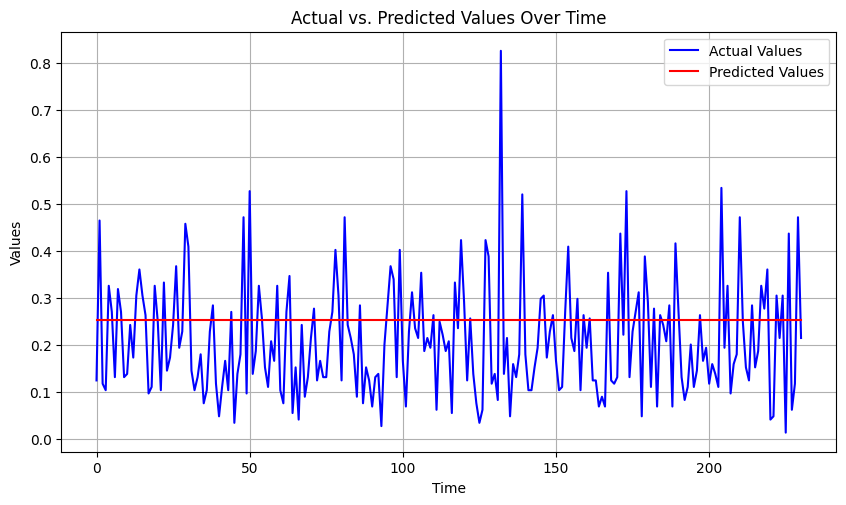

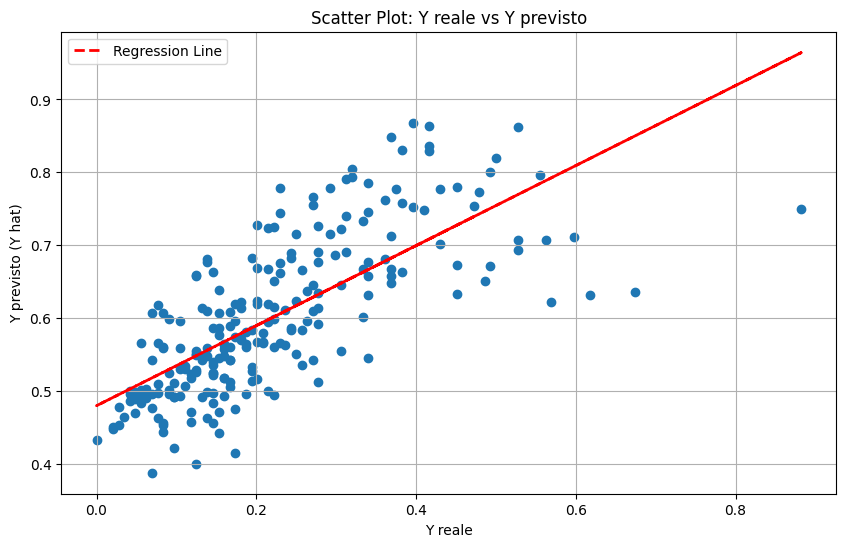

8/8 [==============================] - 0s 6ms/step

Model Completion: 228/144 (158.33%)
Saving data...
8/8 [==============================] - 0s 7ms/step
MAE (Iteration 19): 0.23
R-squared (R2) (Iteration 19): -2.09
RMSE (Iteration 19): 0.24


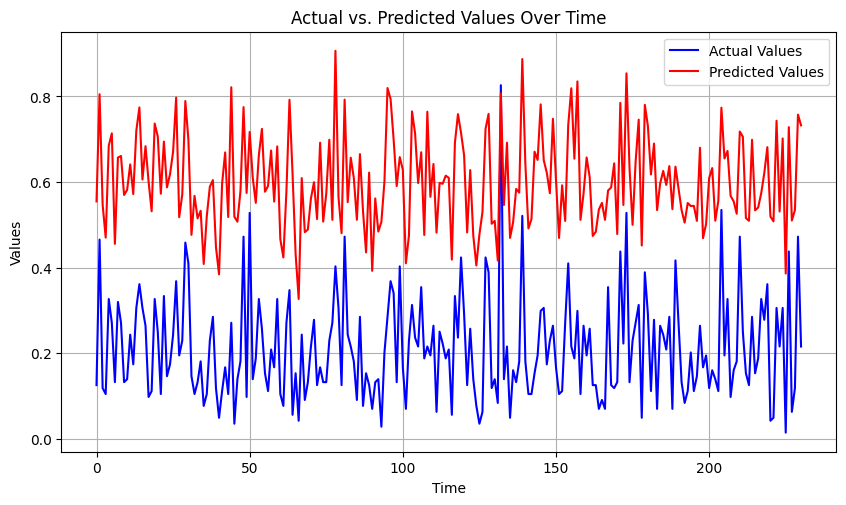

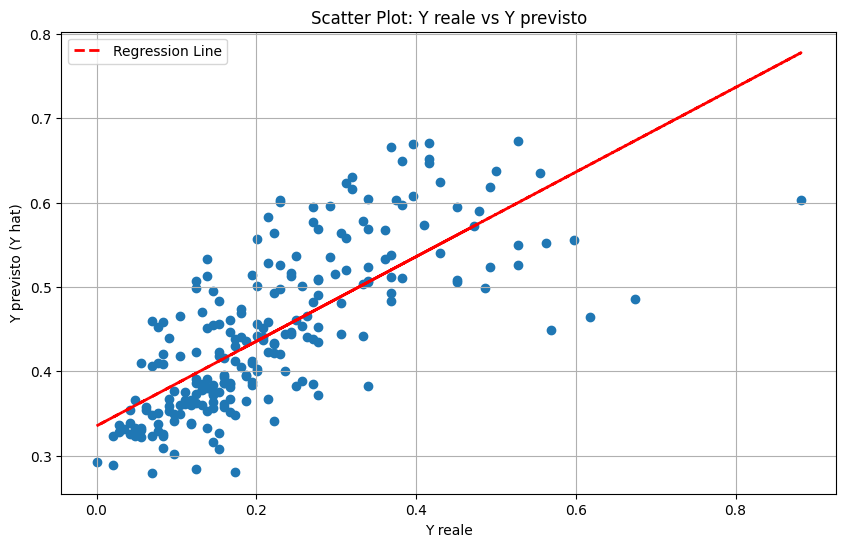

8/8 [==============================] - 0s 5ms/step

Model Completion: 229/144 (159.03%)
Saving data...
8/8 [==============================] - 0s 5ms/step
MAE (Iteration 20): 0.11
R-squared (R2) (Iteration 20): -0.0
RMSE (Iteration 20): 0.14


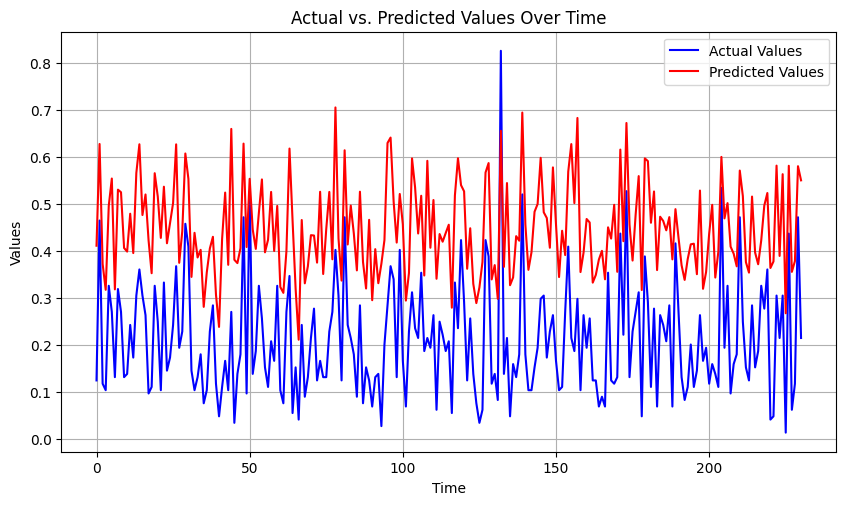

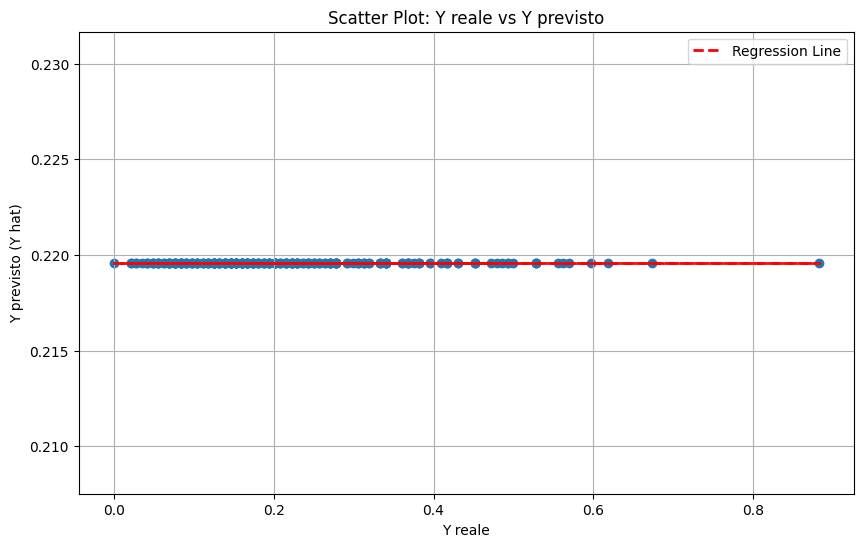

8/8 [==============================] - 0s 6ms/step

Model Completion: 230/144 (159.72%)
Saving data...
Number of Iterations: 30
8/8 [==============================] - 0s 7ms/step
MAE (Iteration 1): 0.32
R-squared (R2) (Iteration 1): -4.55
RMSE (Iteration 1): 0.33


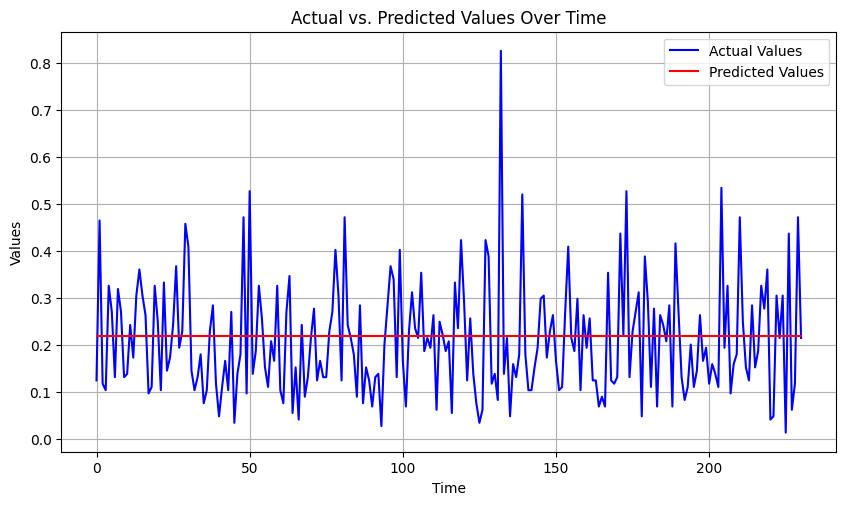

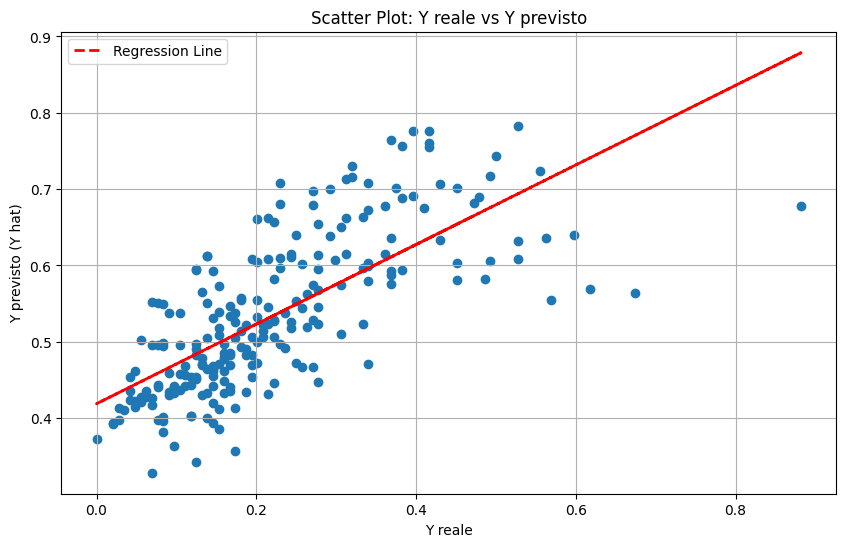

8/8 [==============================] - 0s 7ms/step

Model Completion: 231/144 (160.42%)
Saving data...
8/8 [==============================] - 0s 6ms/step
MAE (Iteration 2): 0.1
R-squared (R2) (Iteration 2): -0.02
RMSE (Iteration 2): 0.14


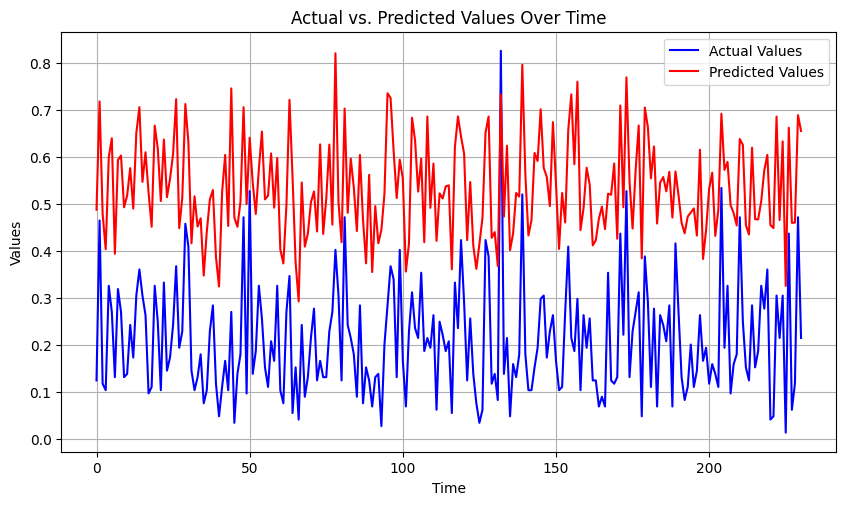

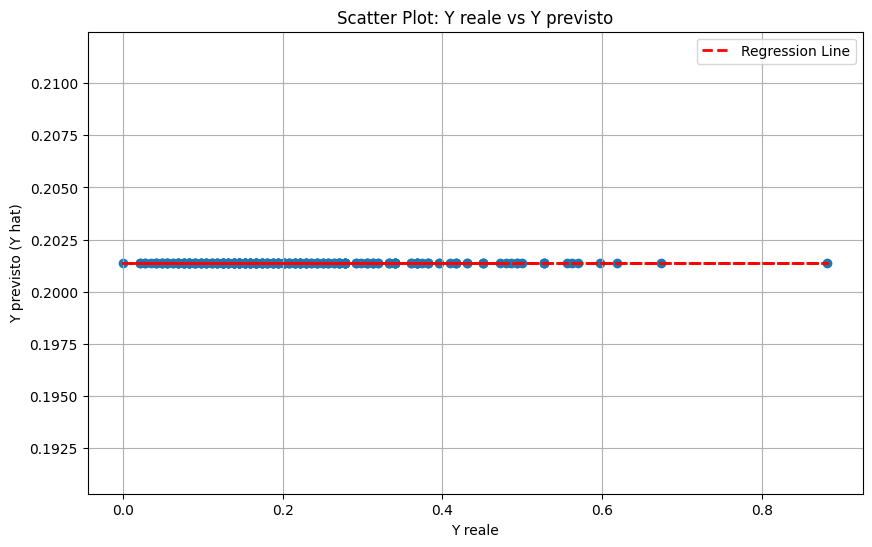

8/8 [==============================] - 0s 6ms/step

Model Completion: 232/144 (161.11%)
Saving data...
8/8 [==============================] - 0s 4ms/step
MAE (Iteration 3): 0.11
R-squared (R2) (Iteration 3): -0.01
RMSE (Iteration 3): 0.14


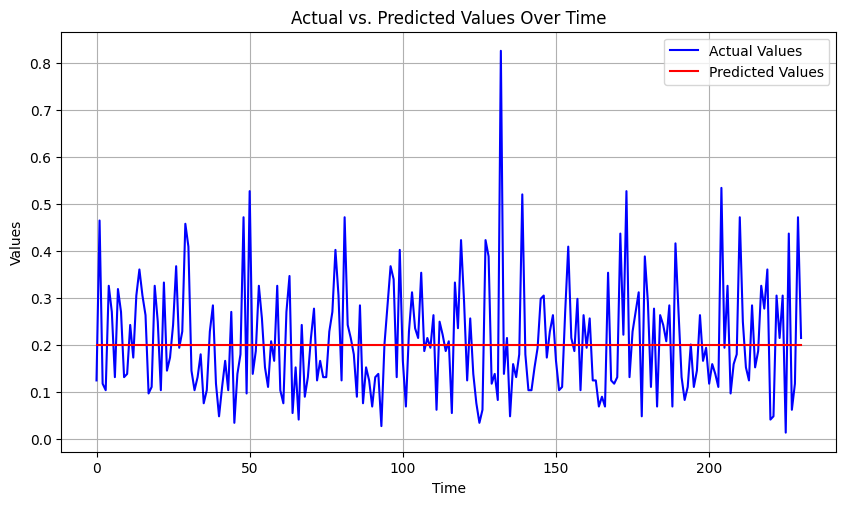

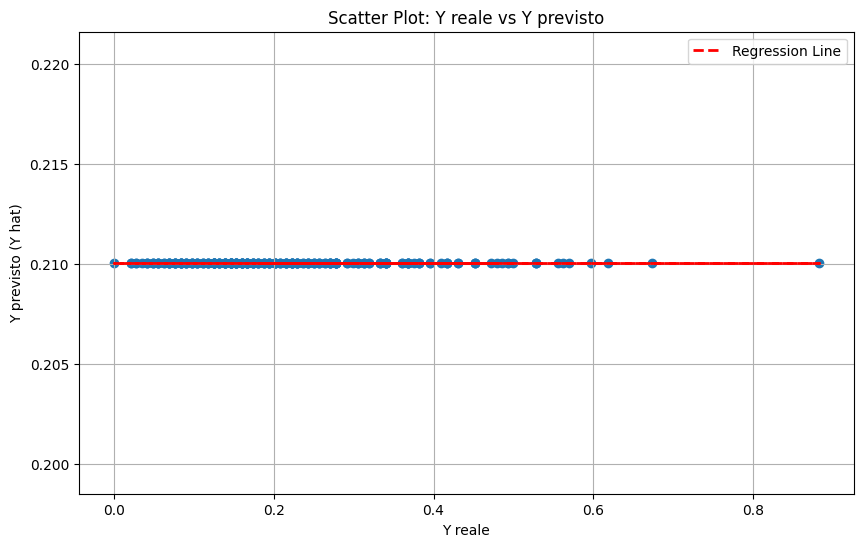

8/8 [==============================] - 0s 4ms/step

Model Completion: 233/144 (161.81%)
Saving data...
8/8 [==============================] - 0s 5ms/step
MAE (Iteration 4): 0.11
R-squared (R2) (Iteration 4): -0.07
RMSE (Iteration 4): 0.14


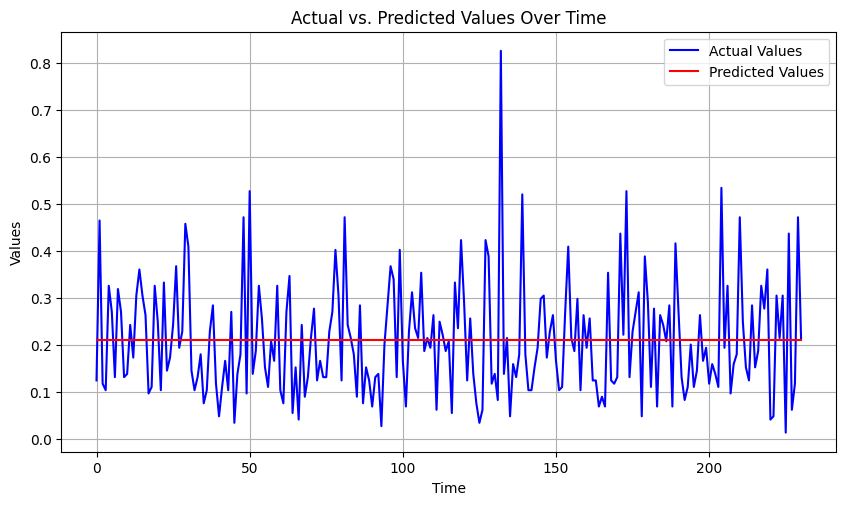

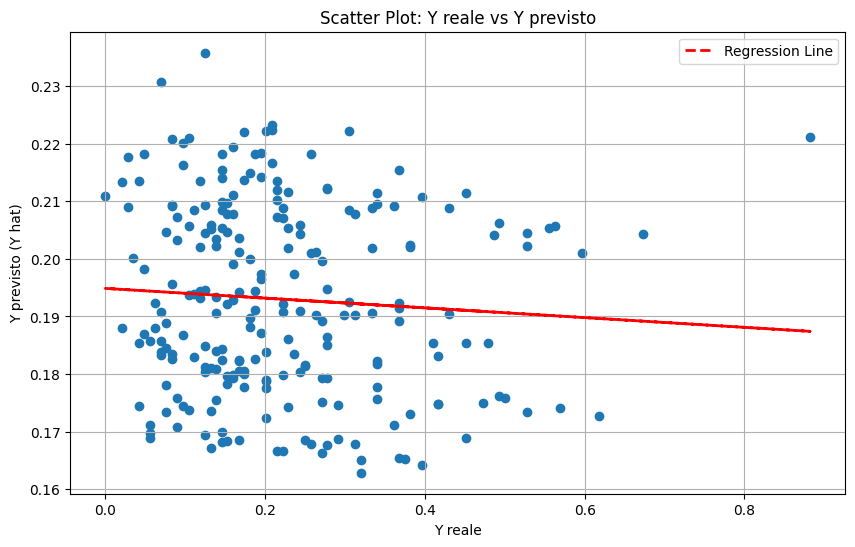

8/8 [==============================] - 0s 8ms/step

Model Completion: 234/144 (162.50%)
Saving data...
8/8 [==============================] - 0s 6ms/step
MAE (Iteration 5): 0.12
R-squared (R2) (Iteration 5): -0.06
RMSE (Iteration 5): 0.14


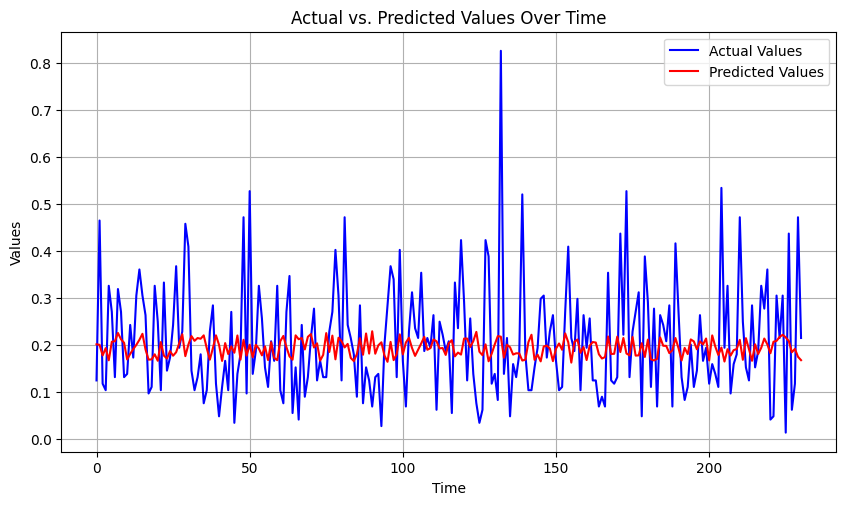

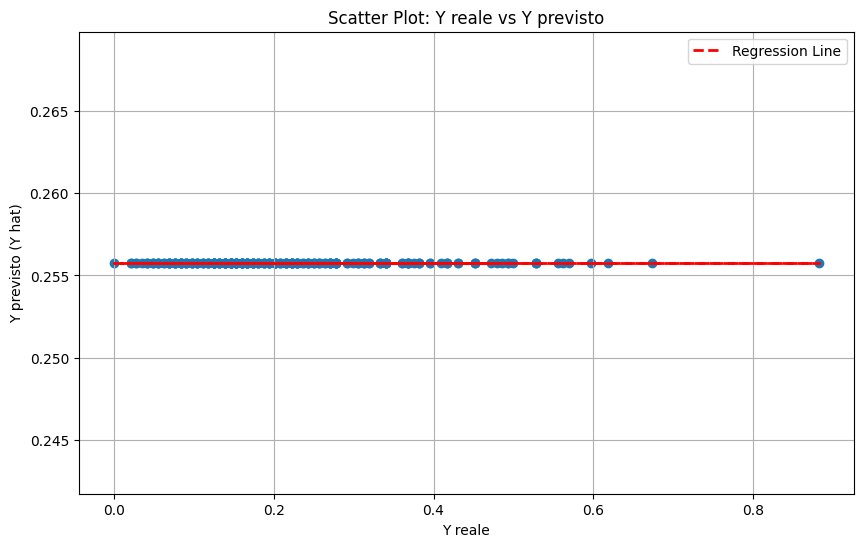

8/8 [==============================] - 0s 8ms/step

Model Completion: 235/144 (163.19%)
Saving data...
8/8 [==============================] - 0s 4ms/step
MAE (Iteration 6): 0.21
R-squared (R2) (Iteration 6): -1.82
RMSE (Iteration 6): 0.23


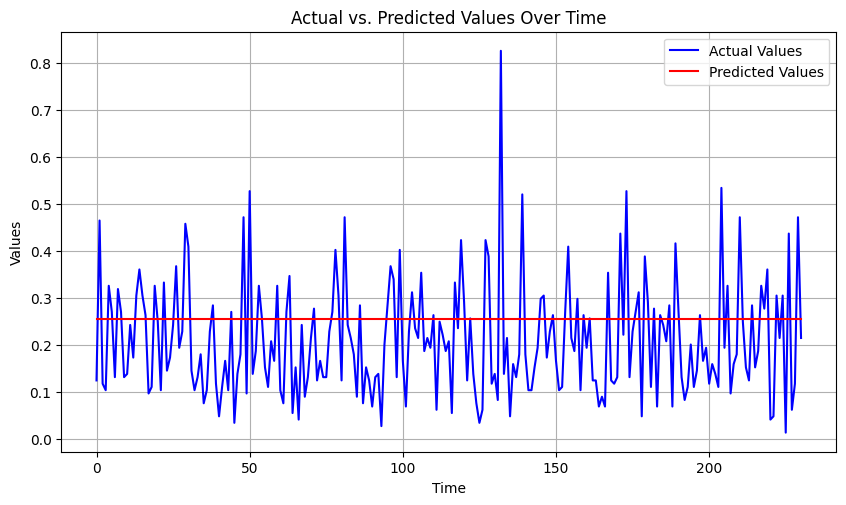

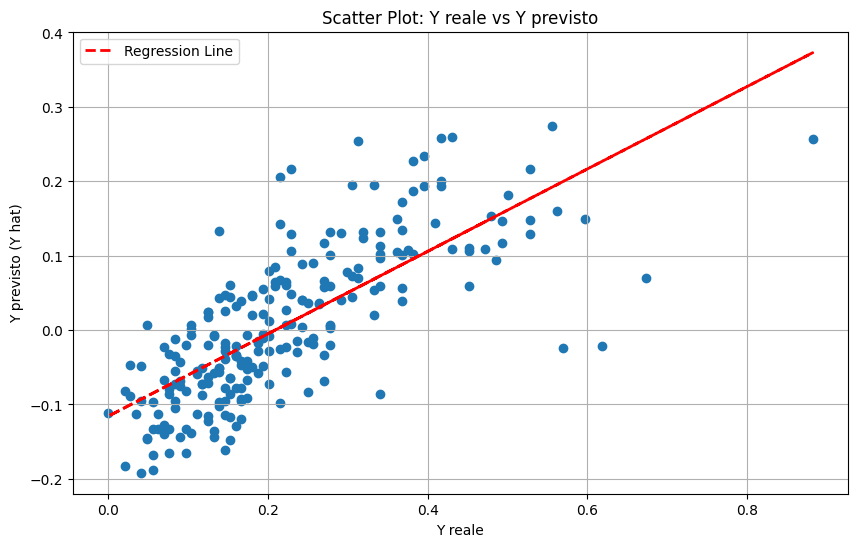

8/8 [==============================] - 0s 5ms/step

Model Completion: 236/144 (163.89%)
Saving data...
8/8 [==============================] - 0s 4ms/step
MAE (Iteration 7): 0.11
R-squared (R2) (Iteration 7): -0.01
RMSE (Iteration 7): 0.14


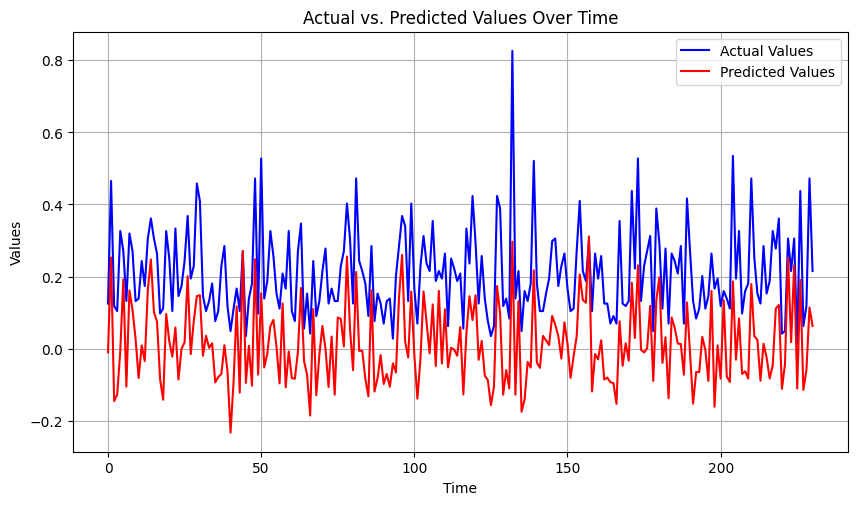

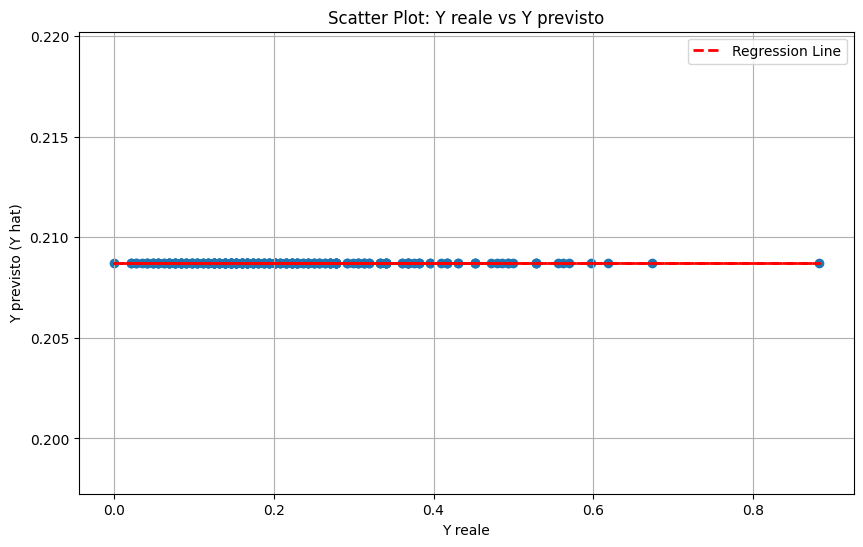

8/8 [==============================] - 0s 5ms/step

Model Completion: 237/144 (164.58%)
Saving data...
8/8 [==============================] - 0s 5ms/step
MAE (Iteration 8): 0.07
R-squared (R2) (Iteration 8): 0.5
RMSE (Iteration 8): 0.1


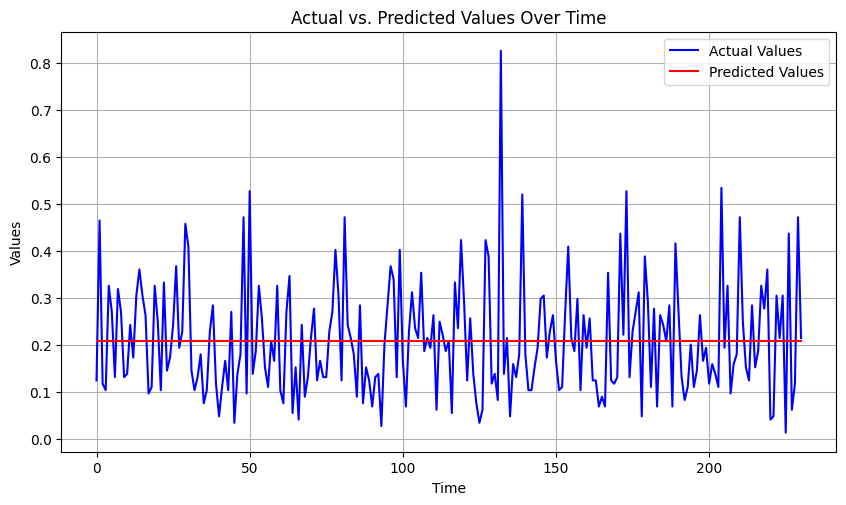

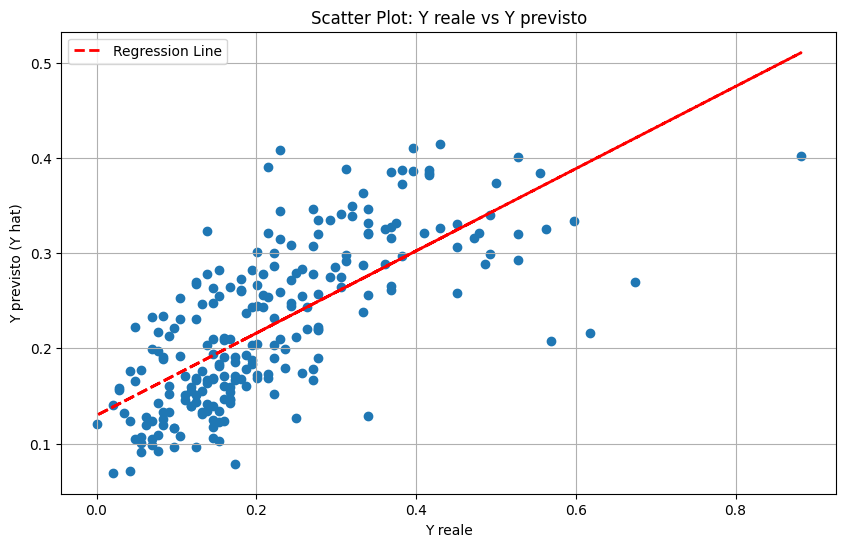

8/8 [==============================] - 0s 4ms/step

Model Completion: 238/144 (165.28%)
Saving data...
8/8 [==============================] - 0s 5ms/step
MAE (Iteration 9): 0.11
R-squared (R2) (Iteration 9): -0.01
RMSE (Iteration 9): 0.14


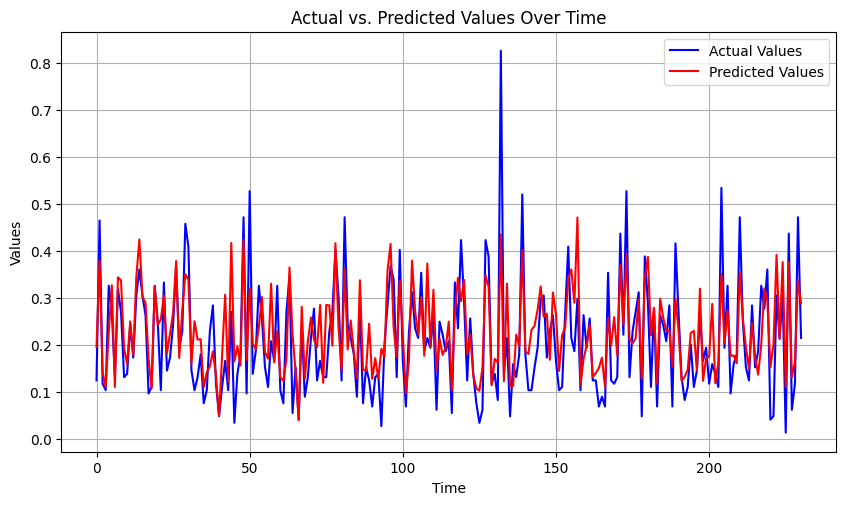

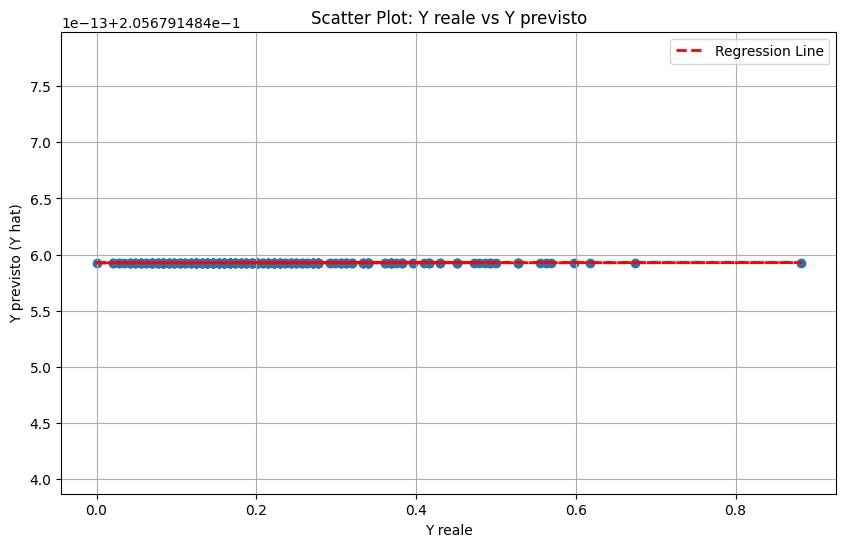

8/8 [==============================] - 0s 4ms/step

Model Completion: 239/144 (165.97%)
Saving data...
8/8 [==============================] - 0s 4ms/step
MAE (Iteration 10): 0.36
R-squared (R2) (Iteration 10): -6.22
RMSE (Iteration 10): 0.37


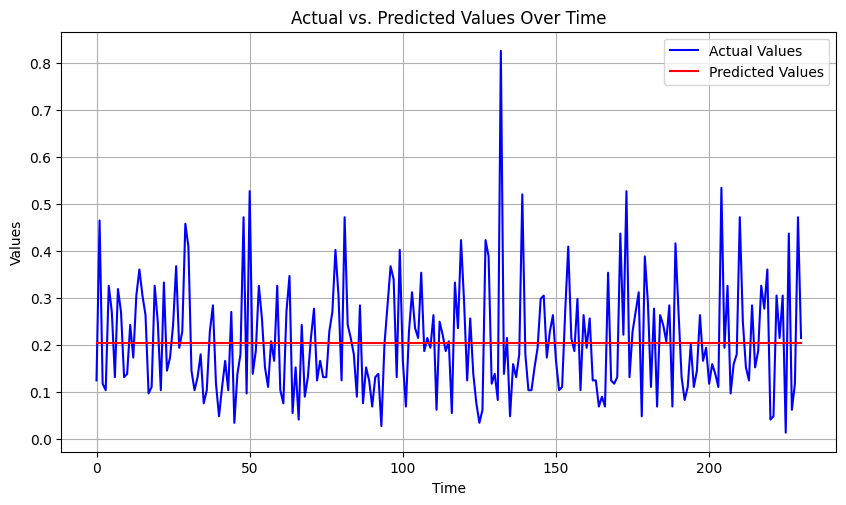

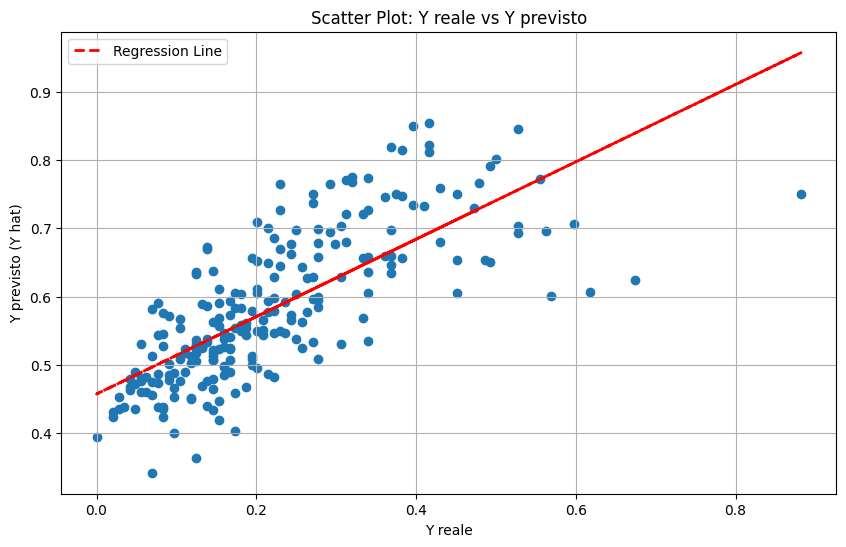

8/8 [==============================] - 0s 7ms/step

Model Completion: 240/144 (166.67%)
Saving data...
8/8 [==============================] - 0s 7ms/step
MAE (Iteration 11): 0.11
R-squared (R2) (Iteration 11): -0.0
RMSE (Iteration 11): 0.14


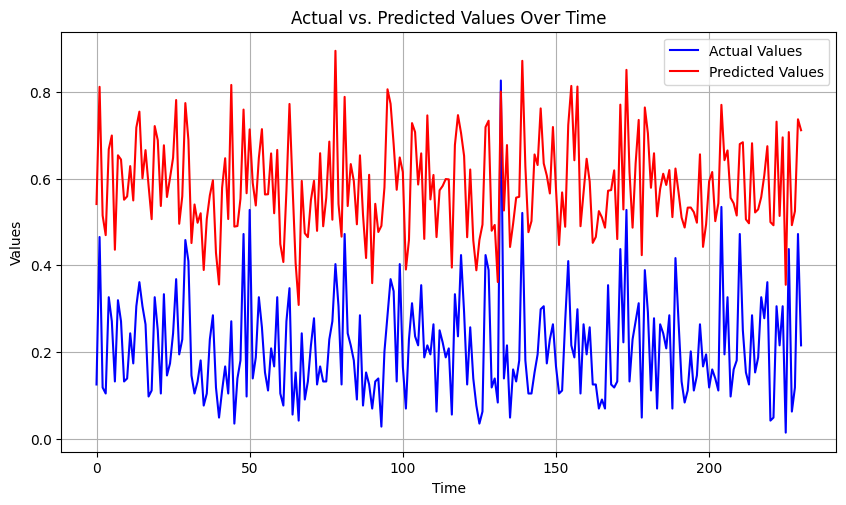

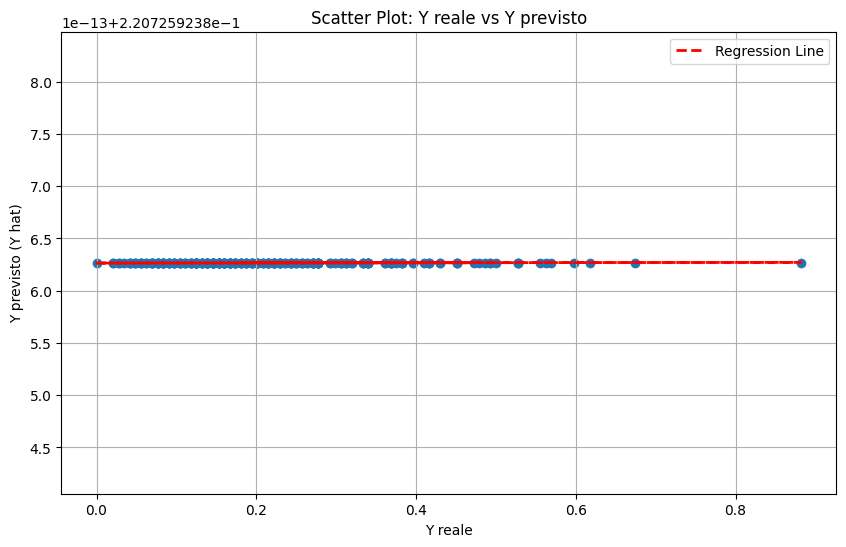

8/8 [==============================] - 0s 4ms/step

Model Completion: 241/144 (167.36%)
Saving data...
8/8 [==============================] - 0s 4ms/step
MAE (Iteration 12): 0.37
R-squared (R2) (Iteration 12): -6.34
RMSE (Iteration 12): 0.38


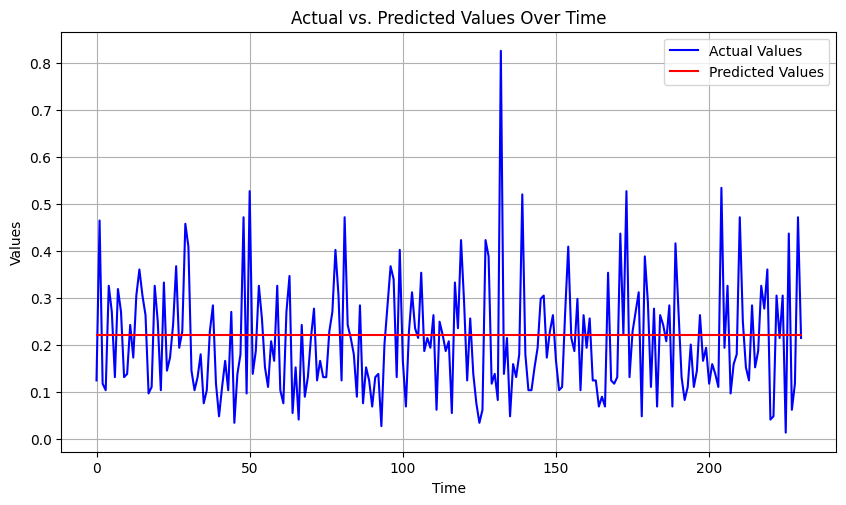

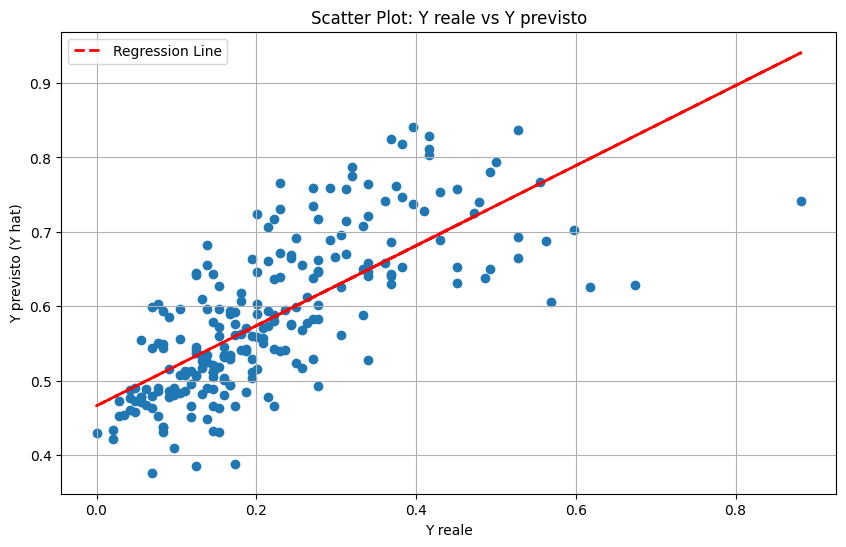

8/8 [==============================] - 0s 3ms/step

Model Completion: 242/144 (168.06%)
Saving data...
8/8 [==============================] - 0s 7ms/step
MAE (Iteration 13): 0.11
R-squared (R2) (Iteration 13): -0.0
RMSE (Iteration 13): 0.14


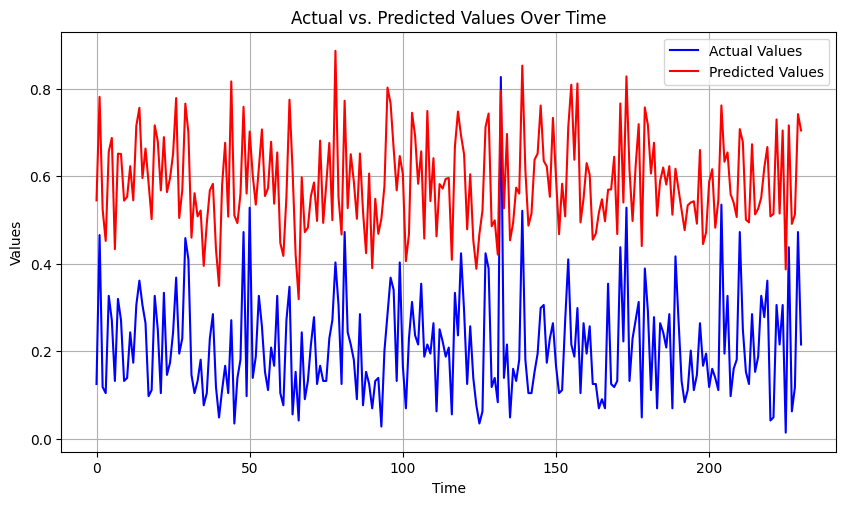

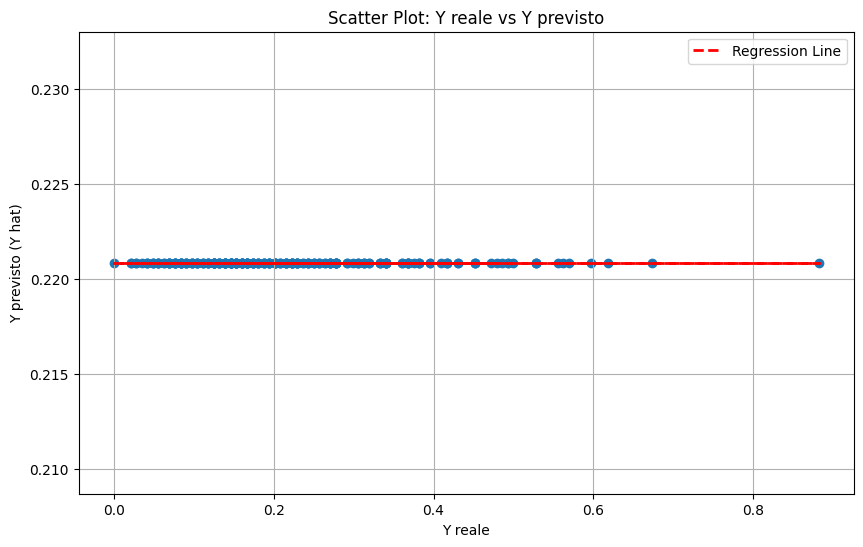

8/8 [==============================] - 0s 5ms/step

Model Completion: 243/144 (168.75%)
Saving data...
8/8 [==============================] - 0s 5ms/step
MAE (Iteration 14): 0.46
R-squared (R2) (Iteration 14): -10.38
RMSE (Iteration 14): 0.47


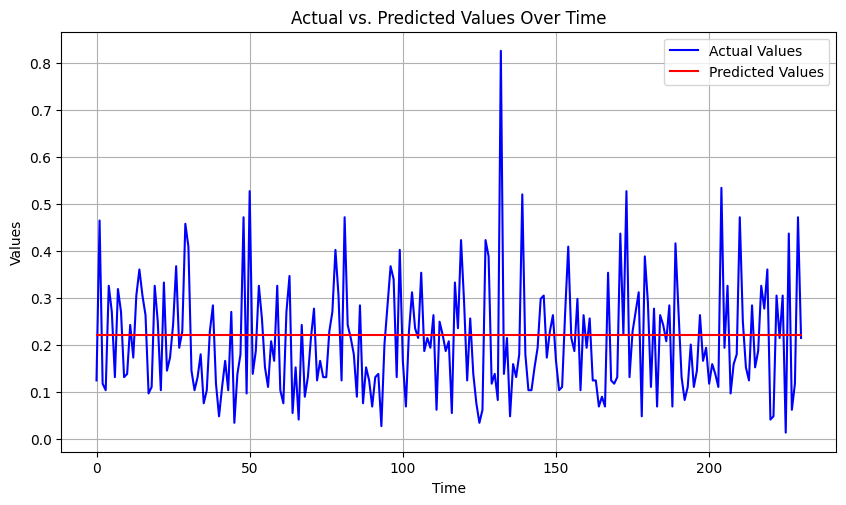

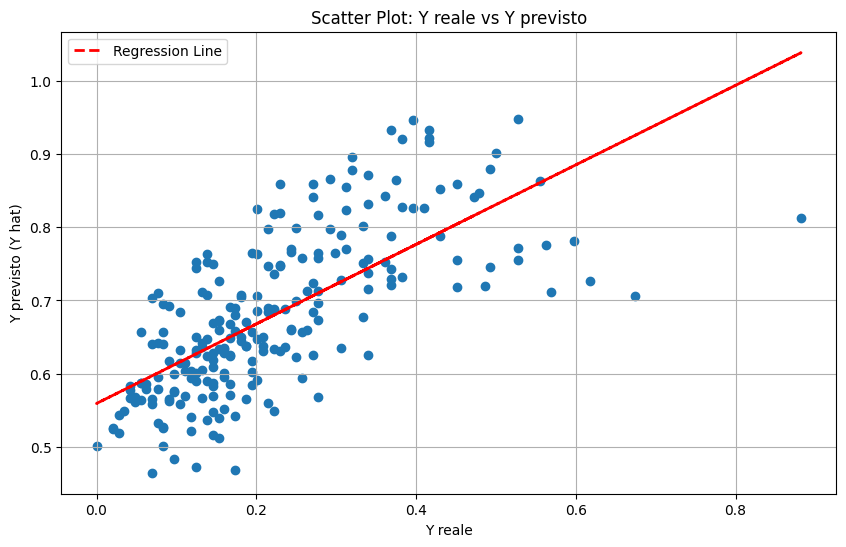

8/8 [==============================] - 0s 5ms/step

Model Completion: 244/144 (169.44%)
Saving data...
8/8 [==============================] - 0s 8ms/step
MAE (Iteration 15): 0.1
R-squared (R2) (Iteration 15): -0.02
RMSE (Iteration 15): 0.14


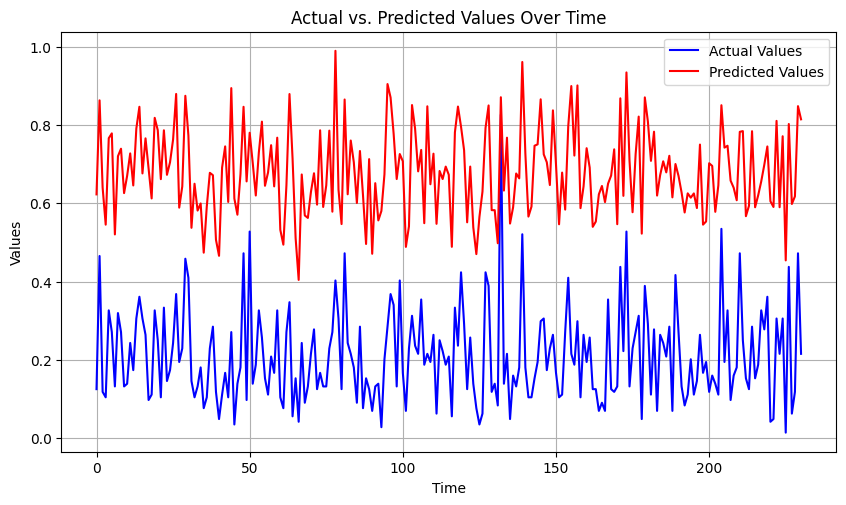

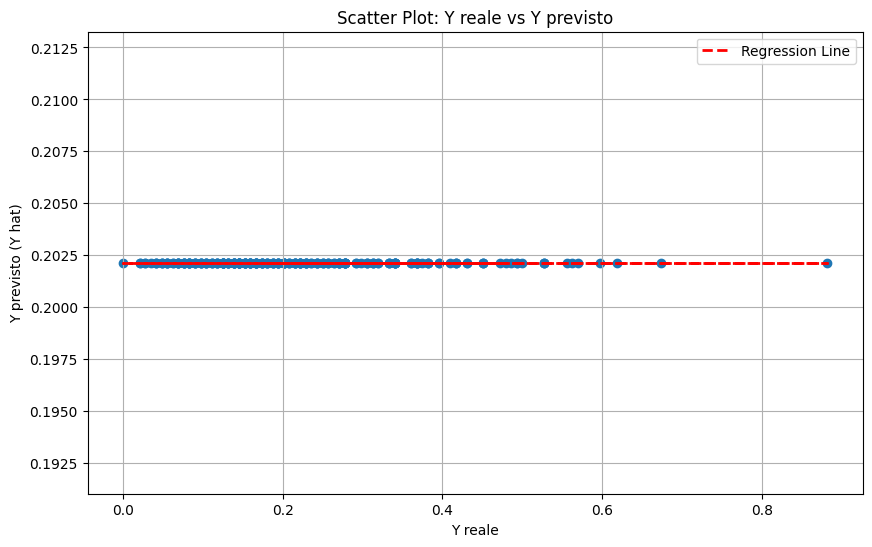

8/8 [==============================] - 0s 5ms/step

Model Completion: 245/144 (170.14%)
Saving data...
8/8 [==============================] - 0s 4ms/step
MAE (Iteration 16): 0.11
R-squared (R2) (Iteration 16): -0.01
RMSE (Iteration 16): 0.14


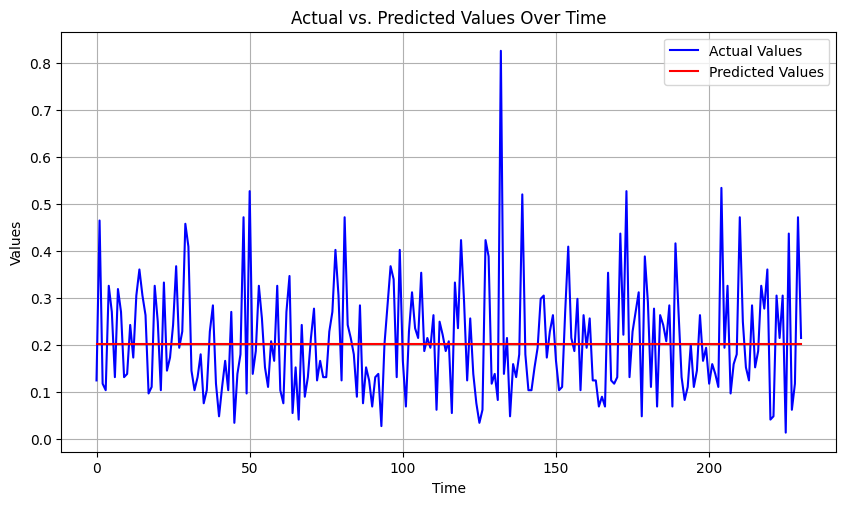

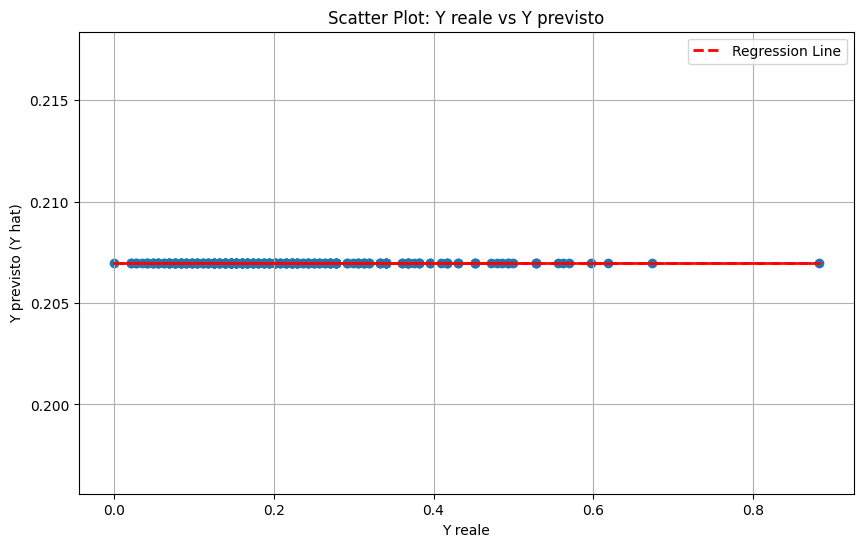

8/8 [==============================] - 0s 4ms/step

Model Completion: 246/144 (170.83%)
Saving data...
8/8 [==============================] - 0s 5ms/step
MAE (Iteration 17): 0.11
R-squared (R2) (Iteration 17): -0.01
RMSE (Iteration 17): 0.14


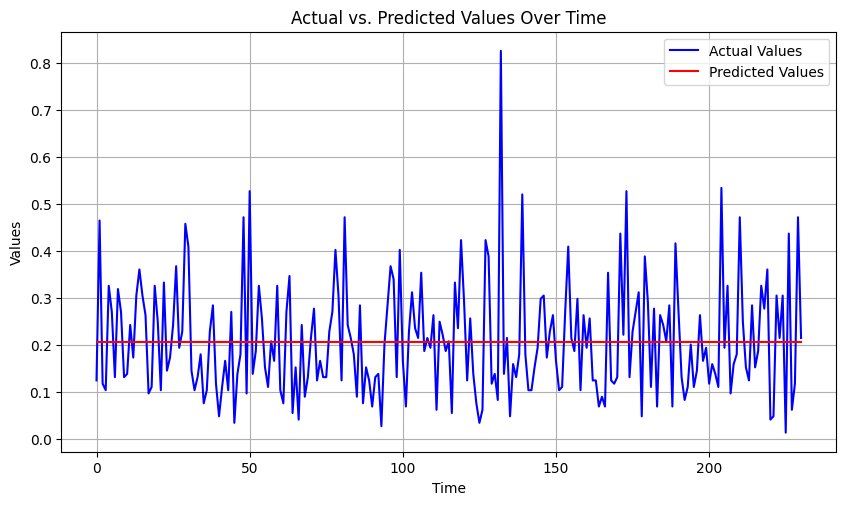

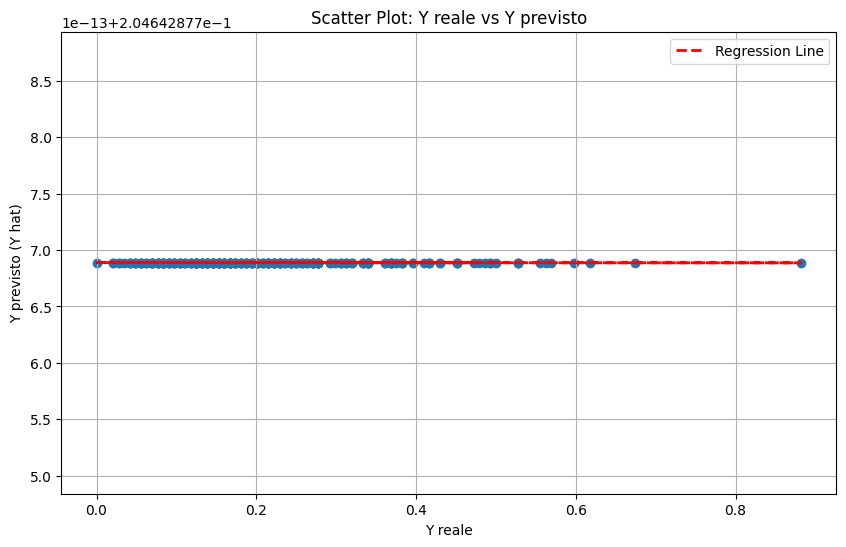

8/8 [==============================] - 0s 6ms/step

Model Completion: 247/144 (171.53%)
Saving data...
8/8 [==============================] - 0s 4ms/step
MAE (Iteration 18): 0.11
R-squared (R2) (Iteration 18): -0.02
RMSE (Iteration 18): 0.14


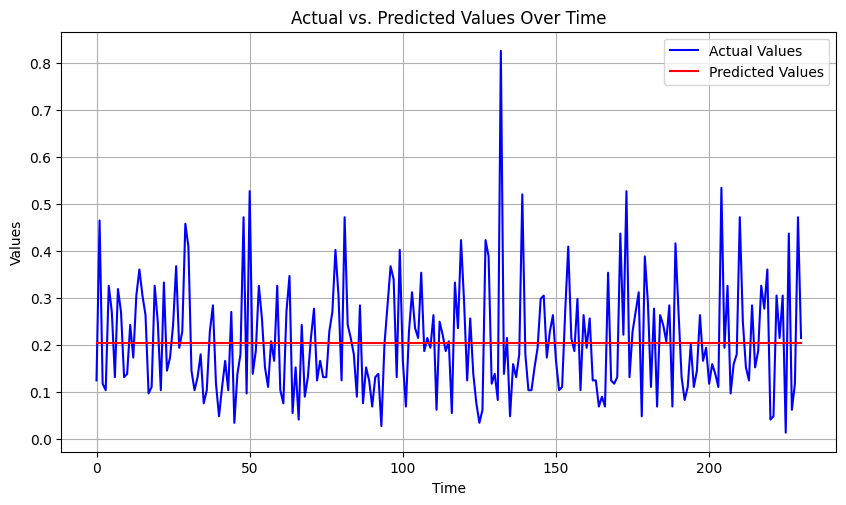

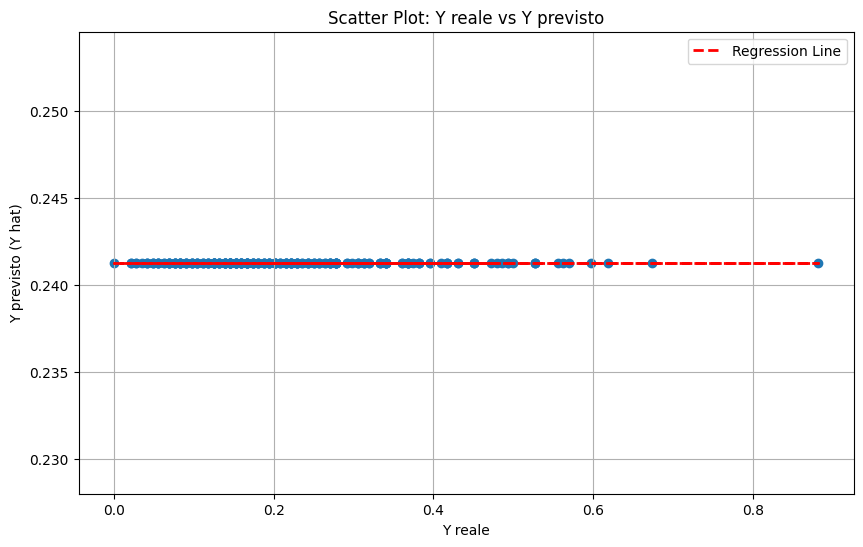

8/8 [==============================] - 0s 4ms/step

Model Completion: 248/144 (172.22%)
Saving data...
8/8 [==============================] - 0s 7ms/step
MAE (Iteration 19): 0.37
R-squared (R2) (Iteration 19): -6.47
RMSE (Iteration 19): 0.38


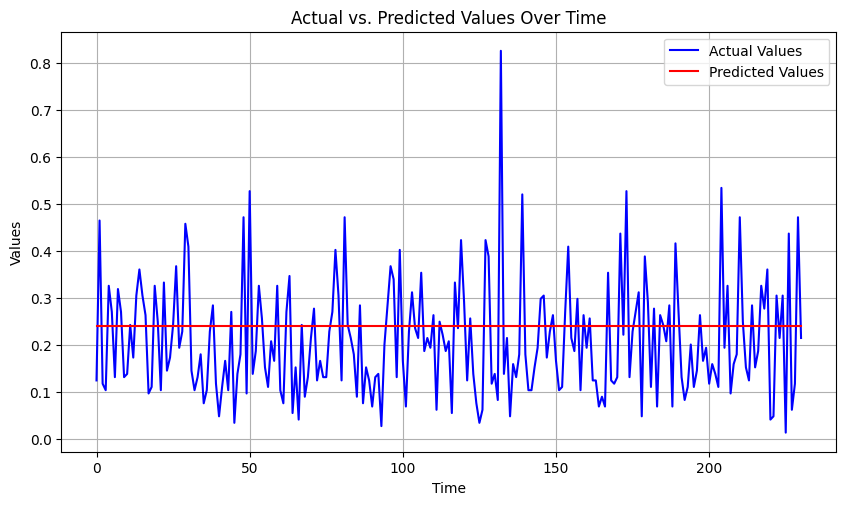

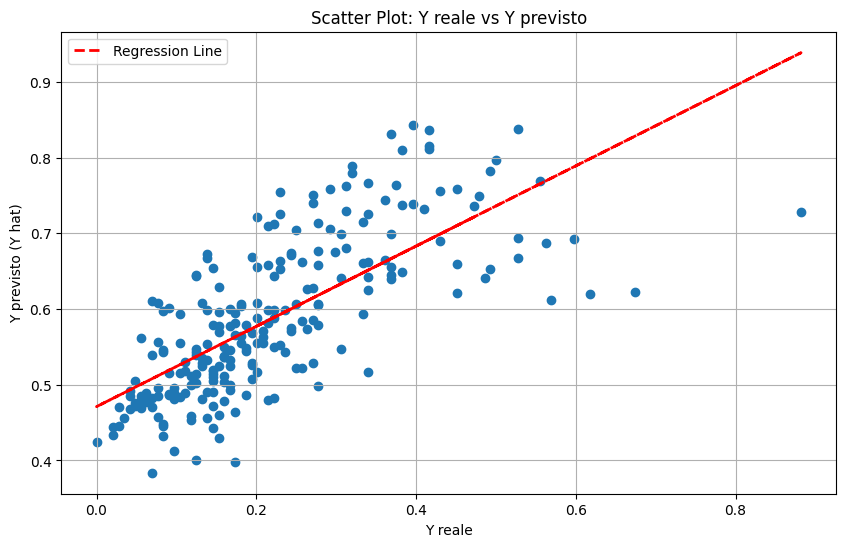

8/8 [==============================] - 0s 6ms/step

Model Completion: 249/144 (172.92%)
Saving data...
8/8 [==============================] - 0s 4ms/step
MAE (Iteration 20): 0.27
R-squared (R2) (Iteration 20): -3.09
RMSE (Iteration 20): 0.28


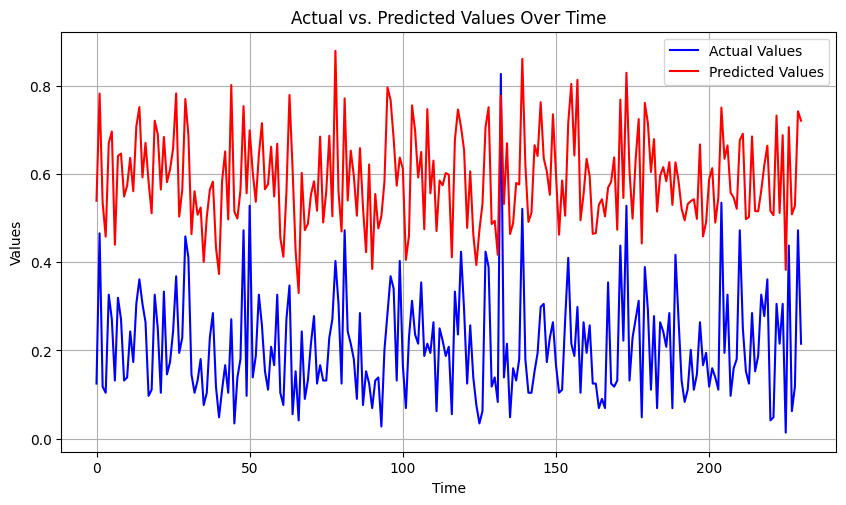

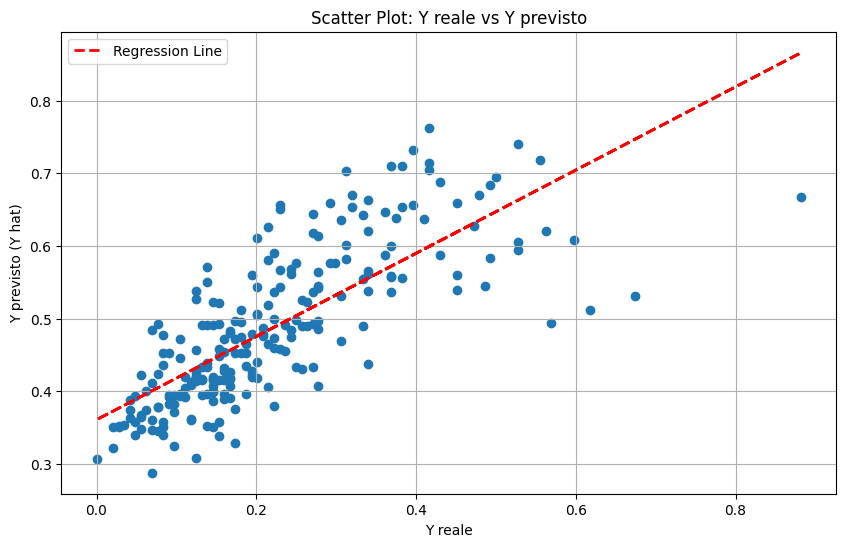

8/8 [==============================] - 0s 4ms/step

Model Completion: 250/144 (173.61%)
Saving data...
8/8 [==============================] - 0s 5ms/step
MAE (Iteration 21): 0.25
R-squared (R2) (Iteration 21): -2.54
RMSE (Iteration 21): 0.26


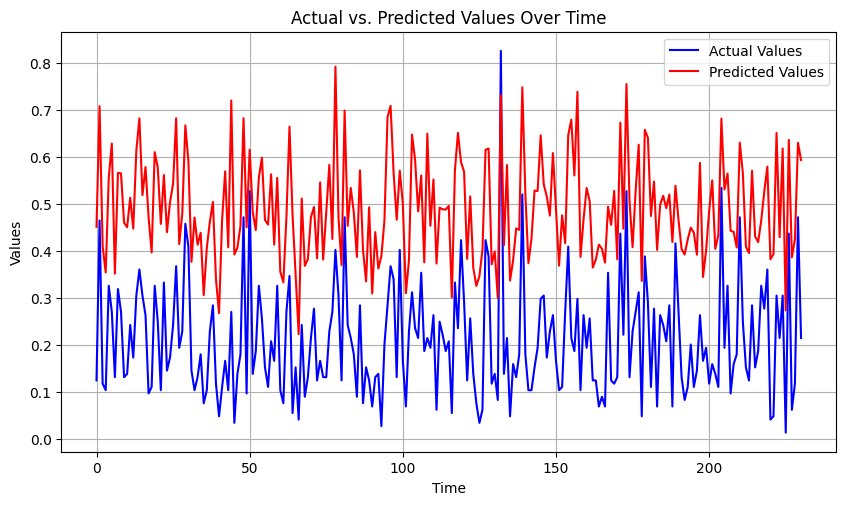

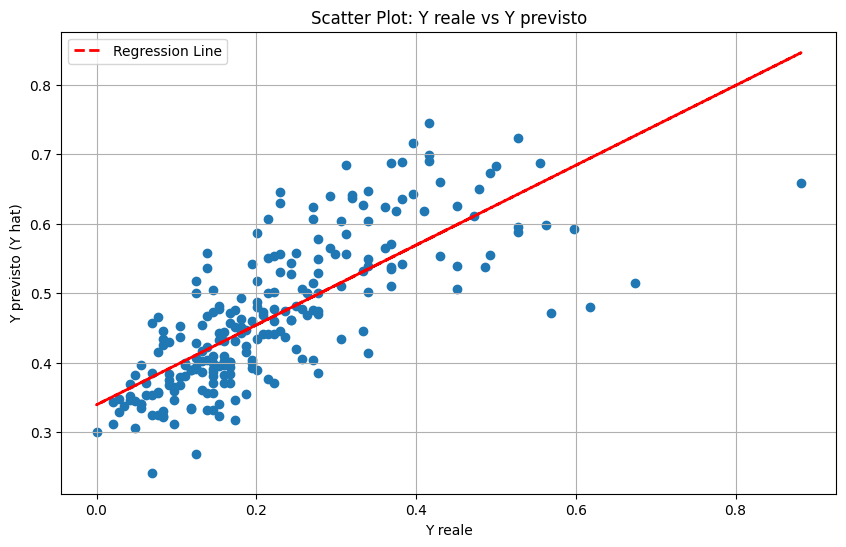

8/8 [==============================] - 0s 5ms/step

Model Completion: 251/144 (174.31%)
Saving data...
8/8 [==============================] - 0s 5ms/step
MAE (Iteration 22): 0.11
R-squared (R2) (Iteration 22): -0.0
RMSE (Iteration 22): 0.14


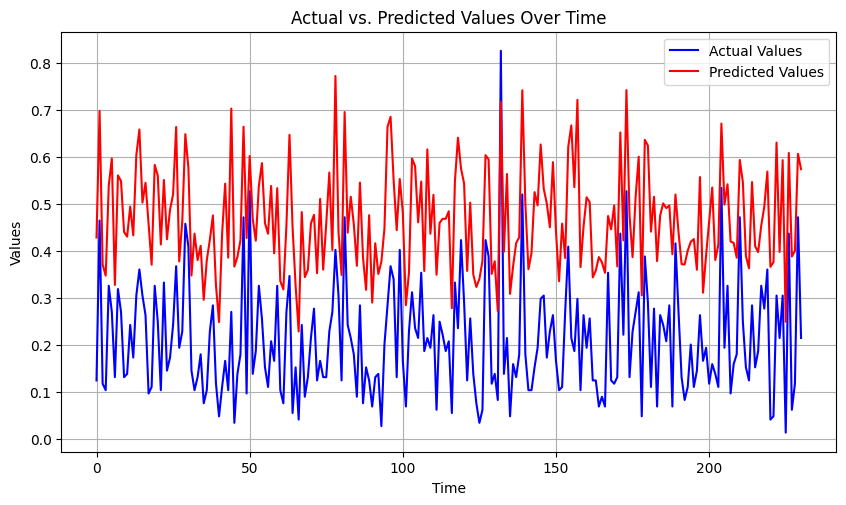

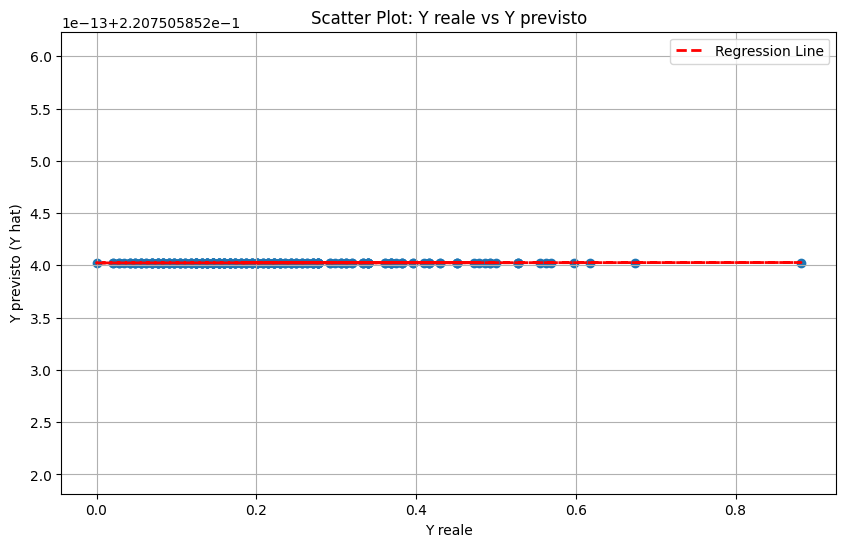

8/8 [==============================] - 0s 5ms/step

Model Completion: 252/144 (175.00%)
Saving data...
8/8 [==============================] - 0s 4ms/step
MAE (Iteration 23): 0.21
R-squared (R2) (Iteration 23): -1.5
RMSE (Iteration 23): 0.22


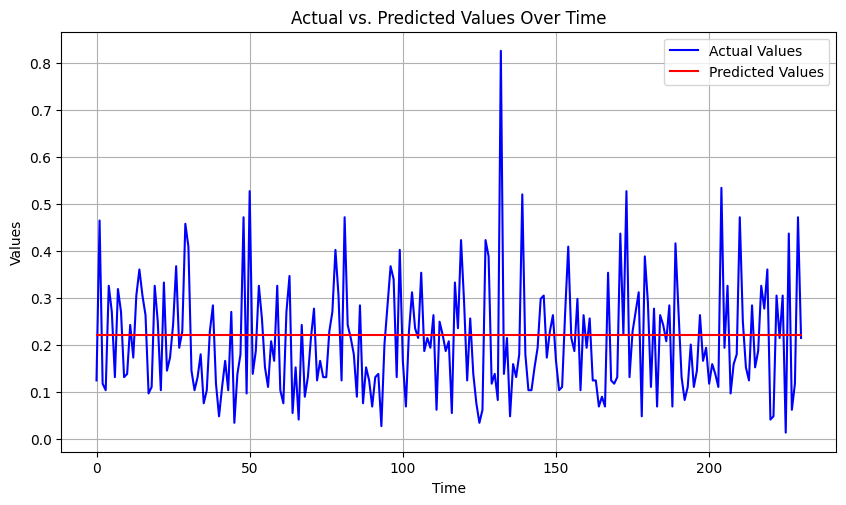

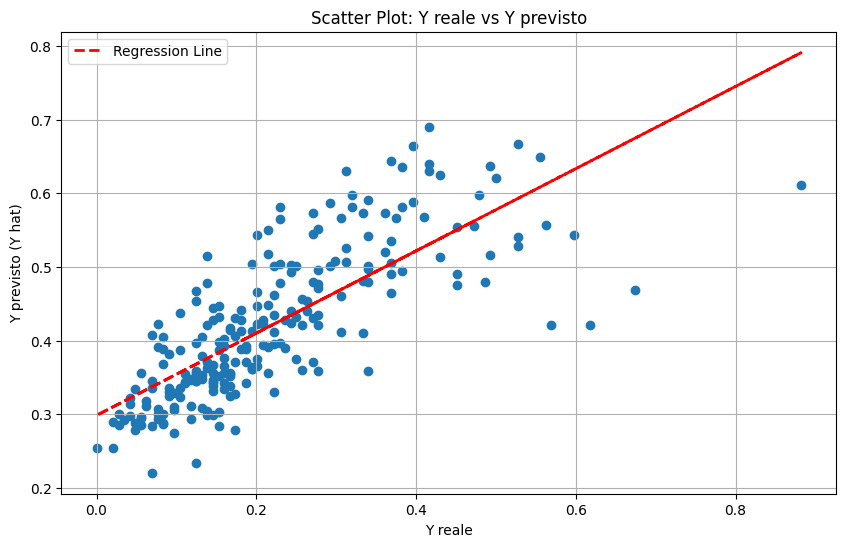

8/8 [==============================] - 0s 4ms/step

Model Completion: 253/144 (175.69%)
Saving data...
8/8 [==============================] - 0s 6ms/step
MAE (Iteration 24): 0.08
R-squared (R2) (Iteration 24): 0.36
RMSE (Iteration 24): 0.11


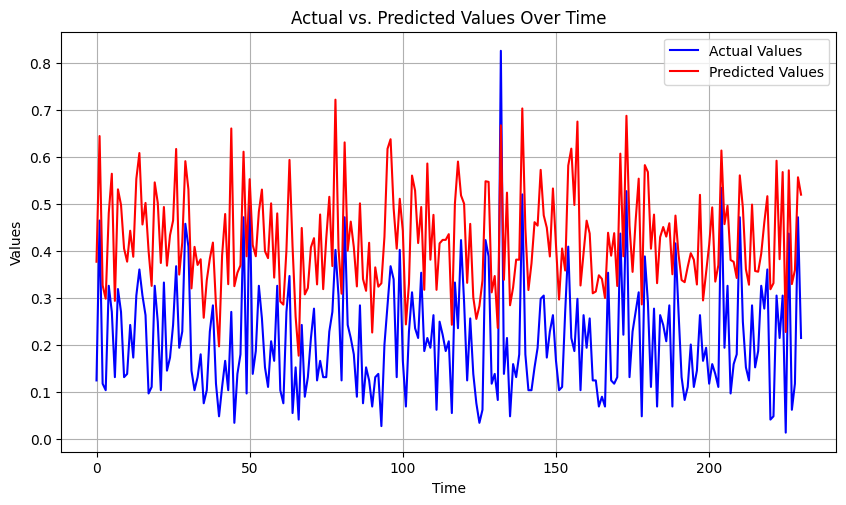

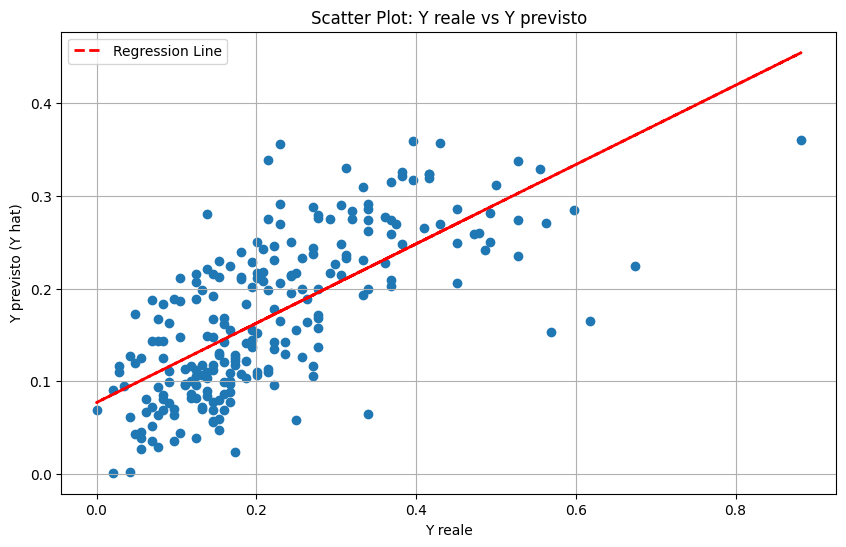

8/8 [==============================] - 0s 5ms/step

Model Completion: 254/144 (176.39%)
Saving data...


In [ ]:
import time
import json
import random
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_absolute_error, r2_score, mean_squared_error
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.layers import LSTM
import matplotlib.pyplot as plt

# Inizializza una lista vuota per salvare i risultati
results = []

# Imposta i range di iperparametri
units_hidden_layer = [64, 128, 256]
learning_rates = [0.001, 0.01, 0.1]
num_iterations_range = [10, 20, 30, 40]
num_epochs_range = [200, 300, 400, 500]

# Inizializza le variabili per i risultati migliori
best_mae_valid = float('inf')
best_r2_valid = -float('inf')
best_rmse_valid = float('inf')
best_model = None
best_hyperparameters = {}

# Creazione del dizionario per i modelli e i loro dati
models_data = []

total_models = len(units_hidden_layer) * len(learning_rates) * len(num_iterations_range) * len(num_epochs_range)

model_count = 0  # Contatore dei modelli completati

# Variare il numero di epoche
for num_epochs in num_epochs_range:
    print(f"Number of Epochs: {num_epochs}")

    for num_iterations in num_iterations_range:
        print(f"Number of Iterations: {num_iterations}")

        for iteration in range(num_iterations):
            # Dividi nuovamente i dati in set di addestramento, validazione e test
            X_train, X_temp, y_train, y_temp = train_test_split(X, y, test_size=0.3, random_state=42)
            X_valid, X_test, y_valid, y_test = train_test_split(X_temp, y_temp, test_size=0.5, random_state=42)

            # Reshape the data for LSTM
            n_time_steps = 1
            n_features = X_train.shape[1]
            X_train = X_train.values.reshape(-1, n_time_steps, n_features)
            X_valid = X_valid.values.reshape(-1, n_time_steps, n_features)
            X_test = X_test.values.reshape(-1, n_time_steps, n_features)

            # Variare gli iperparametri del modello
            hidden_units = random.choice(units_hidden_layer)
            learning_rate = random.choice(learning_rates)

            # Aggiungi gli iperparametri correnti al dizionario
            current_hyperparameters = {
                "Hidden Units": hidden_units,
                "Learning Rate": learning_rate,
                "Number of Epochs": num_epochs,
                "Number of Iterations": num_iterations
            }

            # Imposta il tasso di apprendimento
            optimizer = tf.keras.optimizers.Adam(learning_rate=learning_rate)

            model = keras.Sequential([
                LSTM(hidden_units, activation='relu', input_shape=(n_time_steps, n_features)),
                keras.layers.Dense(32, activation='relu'),
                keras.layers.Dense(1)
            ])

            # Compile the Model
            model.compile(optimizer=optimizer, loss='mean_squared_error')

            # Train the Model
            history = model.fit(X_train, y_train, epochs=num_epochs, validation_data=(X_valid, y_valid), verbose=0)

            # Calcola le metriche per il set di validazione
            y_valid_pred = model.predict(X_valid)
            mae_valid = mean_absolute_error(y_valid, y_valid_pred)
            r2_valid = r2_score(y_valid, y_valid_pred)
            rmse_valid = mean_squared_error(y_valid, y_valid_pred, squared=False)

            # Controlla se le metriche sono le migliori finora
            if r2_valid < best_r2_valid:
                best_mae_valid = mae_valid
                best_r2_valid = r2_valid
                best_rmse_valid = rmse_valid
                best_model = model  # Salva il modello migliore
                best_hyperparameters = current_hyperparameters  # Aggiorna gli iperparametri migliori

            # Salva il modello e i dati in un dizionario
            model_data = {
                'epoch': num_epochs,
                'iterations': iteration + 1,
                'hidden_layer': hidden_units,
                'learning_rate': learning_rate,
                'model': model
            }
            models_data.append(model_data)

            model_count += 1  # Incrementa il contatore dei modelli completati

            # Stampa le metriche parziali per questa iterazione
            print(f"MAE (Iteration {iteration + 1}): {round(mae_valid, 2)}")
            print(f"R-squared (R2) (Iteration {iteration + 1}): {round(r2_valid, 2)}")
            print(f"RMSE (Iteration {iteration + 1}): {round(rmse_valid, 2)}")

            # Plot dei risultati per questa iterazione
            plt.figure(figsize=(10, 6))
            plt.scatter(y_valid, y_valid_pred)
            plt.xlabel("Y reale")
            plt.ylabel("Y previsto (Y hat)")
            plt.title("Scatter Plot: Y reale vs Y previsto")

            # Aggiungi la retta di regressione lineare
            fit = np.polyfit(y_valid.to_numpy().flatten(), y_valid_pred.flatten(), 1)
            fit_fn = np.poly1d(fit)
            plt.plot(y_valid.to_numpy().flatten(), fit_fn(y_valid.to_numpy().flatten()), color='red', linestyle='--', linewidth=2, label='Regression Line')

            plt.legend()
            plt.grid(True)
            plt.show()

            # Plot dei risultati per questa iterazione
            plt.figure(figsize=(10, 12))  # Adjust the figure size as needed
            time_index = range(len(y_test))

            y_test_pred = model.predict(X_test)
            # Plot the actual vs. predicted values
            plt.subplot(2, 1, 1)  # Create a 2x1 grid of subplots and select the first subplot
            plt.plot(time_index, y_test, label='Actual Values', color='blue')
            plt.plot(time_index, y_test_pred, label='Predicted Values', color='red')
            plt.xlabel("Time")
            plt.ylabel("Values")
            plt.title("Actual vs. Predicted Values Over Time")
            plt.legend()
            plt.grid(True)

            # Aggiungi i risultati di questa iterazione alla lista
            result = {
                "R2": r2_valid,
                "MAE": mae_valid,
                "RMSE": rmse_valid,
                "Hidden Units": hidden_units,
                "Learning Rate": learning_rate,
                "Number of Epochs": num_epochs,
                "Number of Iterations": num_iterations
            }
            results.append(result)

            # Stampa la percentuale di modelli completati
            completion_percentage = (model_count / total_models) * 100
            print(f"\nModel Completion: {model_count}/{total_models} ({completion_percentage:.2f}%)")

            print("Saving data...")

            # Salva i risultati in un file JSON
            with open("/content/drive/MyDrive/Colab Notebooks/Tesi/Iteration improvement/Results/Filter2/resultsLSTM.json", "w") as json_file:
                json.dump(results, json_file, indent=4)

    # Stampa le metriche del modello migliore per questo numero di epoche
    print("\nBest Model Metrics (Number of Epochs:", num_epochs, "):")
    print(f"Best MAE: {round(best_mae_valid, 2)}")
    print(f"Best R-squared (R2): {round(best_r2_valid, 2)}")
    print(f"Best RMSE: {round(best_rmse_valid, 2)}")

# Stampa le metriche del modello migliore
print("\nBest Model Metrics:")
print(f"Best MAE: {round(best_mae_valid, 2)}")
print(f"Best R-squared (R2): {round(best_r2_valid, 2)}")
print(f"Best RMSE: {round(best_rmse_valid, 2)}")

# Stampa gli iperparametri del modello migliore
print("\nBest Hyperparameters for the Best Model:")
print(f"Hidden Units: {best_hyperparameters['hidden_layer']}")
print(f"Initial Learning Rate: {best_hyperparameters['learning_rate']}")
print(f"Number of Epochs: {best_hyperparameters['Number of Epochs']}")